In [1]:
#to do:
#TEST do a level clear indicator with deaths, if below a certain value then it is a 1
#MEH add key for the rolling plots
#MEH, broke it up by dataframe mod have the rolling plots go full length for the longer episodes

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

In [2]:
#/home/jim/projects/td3/logs/log_1541869275_1.monitor.csv

def get_results(time_id,base_dir='logs',df_mod=1):
    df_list = []
    env_name_list = []
    for i in range(100):
        file_str = '{}/log_{}_{}.monitor.csv'.format(base_dir,time_id,i)
        file_exists_check = Path(file_str)
        if file_exists_check.is_file():
            print(file_str)
            df = get_df(file_str,i)
            df_list.append(df)
            env_name = "env {}".format(i)
            env_name_list.append(env_name)
        else:
            break
    
    #get_scatter_plots(df_list)
    #get_rolling_plots(df_list)
    if len(df_list) > 0:
        describe_df_array(df_list,df_mod)
        get_rolling_comparison(df_list,env_name_list)
        if df_mod > 1:
            #rolling comparisons by df_slice too
            start_index = -1
            for i in range(0,df_mod):
                start_index += 1
                env_name_sublist = [start_index]
                base_df_list = [df_list[start_index]]
                for j in range(df_mod,len(df_list)):
                    if j % df_mod == start_index:
                        #base_df = pd.concat([base_df,df_list[j]])
                        base_df_list.append(df_list[j])
                        env_name_sublist.append(j)
                print("Doing rolling comparison for df mod {}".format(start_index))
                get_rolling_comparison(base_df_list,env_name_sublist)   
                
    else:
        print("no files found, perhaps incorrect id?")


#contra:
#first two decimal points are number of deaths with 0.01 subtracted for each death
#if you clear the level 0.5 added to deaths, have to move this out (can't lose more than 50 lives so this won't overlap)
#next 4 decimal points are number of scrolls

def get_df(file_str,i):
    mf = pd.read_csv(file_str)
    mf['t_diff'] = mf.t.diff()
    mf['deaths'] = 100 - np.floor(mf.r*100 % 100)
    mf['success'] = (mf.deaths >= 50)*1.
    mf['scrolls'] = mf.r*1000000 % 10000
    mf['deaths'][mf.deaths >= 50] = mf.deaths - 50
    mf['sc_per_d'] = mf['scrolls'] / (mf['deaths']+1)
    mf['env'] = i       
    
    return mf

def describe_df_array(df_array,df_mod=1):
    
    for i in df_array:
        print("Mean Reward last 100 Episodes per env: {}".format(np.mean(i.r.iloc[-100:])))
        
    def describe_df(mf,description=""):
        print(description)
        print(mf.describe())
        print("Max reward values:")
        print(mf.r.sort_values(ascending=False)[0:10])
        print("Max l values:")
        print(mf.l.sort_values(ascending=False)[0:10])
        print("Max score to deaths values")
        print(mf.sc_per_d.sort_values(ascending=False)[0:10])
        print("Total success {} % success {} ".format(np.sum(mf.success), np.sum(mf.success)/len(mf.success)))
    
    if df_mod <= 1:
        mf = pd.concat(df_array)
        describe_df(mf,"Combined DataFrame Description")
    else:
        start_index = -1
        for i in range(0,df_mod):
            start_index += 1
            base_df = df_array[start_index]
            for j in range(df_mod,len(df_array)):
                if j % df_mod == start_index:
                    base_df = pd.concat([base_df,df_array[j]])
                    
            describe_df(base_df,"Mod DataFrame Descriptions {}".format(start_index))
                    
                    

def get_scatter_plots(df):
    a4_dims = (11.7, 8.27)
    fig, ax = plt.subplots(figsize=a4_dims)
    plt.scatter(df.index,df.r,marker='.')
    plt.ylabel('reward')
    plt.xlabel('episode')
    plt.show()
    
    a4_dims = (11.7, 8.27)
    fig, ax = plt.subplots(figsize=a4_dims)
    plt.scatter(df.index,df.l,marker='.')
    plt.ylabel('timesteps per episode')
    plt.xlabel('episode')
    plt.show()
    
#     a4_dims = (11.7, 8.27)
#     fig, ax = plt.subplots(figsize=a4_dims)
#     plt.scatter(df.index,df.t_diff,marker='.')
#     plt.ylabel('time per episode')
#     plt.xlabel('episode')
#     plt.show()
    
    a4_dims = (11.7, 8.27)
    fig, ax = plt.subplots(figsize=a4_dims)
    plt.scatter(df.index,df.success,marker='.')
    plt.ylabel('success')
    plt.xlabel('episode')
    plt.show()
    
    a4_dims = (11.7, 8.27)
    fig, ax = plt.subplots(figsize=a4_dims)
    plt.scatter(df.index,df.sc_per_d,marker='.')
    plt.ylabel('scrolls per death')
    plt.xlabel('episode')
    plt.show()
    

def get_rolling_plots(df):
    rolling_window_size = 100
    if len(df.r) < 1000:
        rolling_window_size = 50
        
    a4_dims = (11.7, 8.27)
    fig, ax = plt.subplots(figsize=a4_dims)
    sns.tsplot(df.r.rolling(rolling_window_size).mean())
    plt.ylabel('reward')
    plt.xlabel('mean of last {} episodes'.format(rolling_window_size))
    plt.show()
    
    a4_dims = (11.7, 8.27)
    fig, ax = plt.subplots(figsize=a4_dims)
    sns.tsplot(df.l.rolling(rolling_window_size).mean())
    plt.ylabel('timesteps')
    plt.xlabel('mean of last {} episodes'.format(rolling_window_size))
    plt.show()
    
#     a4_dims = (11.7, 8.27)
#     fig, ax = plt.subplots(figsize=a4_dims)
#     sns.tsplot(df.t_diff.rolling(rolling_window_size).mean())
#     plt.ylabel('time')
#     plt.xlabel('mean of last {} episodes'.format(rolling_window_size))
#     plt.show()
    
    a4_dims = (11.7, 8.27)
    fig, ax = plt.subplots(figsize=a4_dims)
    sns.tsplot(df.success.rolling(rolling_window_size).mean())
    plt.ylabel('success')
    plt.xlabel('mean of last {} episodes'.format(rolling_window_size))
    plt.show()
    
    a4_dims = (11.7, 8.27)
    fig, ax = plt.subplots(figsize=a4_dims)
    sns.tsplot(df.sc_per_d.rolling(rolling_window_size).mean())
    plt.ylabel('scrolls per death')
    plt.xlabel('mean of last {} episodes'.format(rolling_window_size))
    plt.show()
    

        
# def get_level_comparison(lvl_array):
#     df_array = []
#     for i in range(len(lvl_array)):
#         file_str = '{}/monitor.csv'.format(lvl_array[i])
#         df_array.append(pd.read_csv(file_str))
#         df_array[i]['t_diff'] = df_array[i].t.diff()
#         df_array[i]['success'] = (df_array[i].r > 9000)*1.
#         print(lvl_array[i])
#         print(df_array[i].describe())
        
#     get_rolling_comparison(df_array,lvl_array)

    
def plot_rolling_mean(df,col_name,rolling_window_size=100):
    a4_dims = (11.7, 8.27)
    fig, ax = plt.subplots(figsize=a4_dims)
    sns.tsplot(df[col_name].rolling(rolling_window_size).mean())
    plt.ylabel(col_name)
    plt.xlabel('mean of last {} episodes'.format(rolling_window_size))
    plt.legend(loc='upper left');
    plt.show()
    
def plot_rolling_mean_array(df_list,col_name,rolling_window_size=100):
    color_dict = {0:'red', 1:'blue', 2:'green', 3:'black', 4:'grey', 5:'yellow', 6:'purple', 7:'orange'}
    color_range = len(color_dict)

    a4_dims = (14.7, 8.27)
    fig, ax1 = plt.subplots(figsize=a4_dims)
    print("Rolling Plot {}".format(col_name))
    i_range = 0;
    for i in df_list:
        sns.tsplot(i[col_name].rolling(rolling_window_size).mean(),color=color_dict[i_range%color_range])
        i_range += 1
    plt.ylabel(col_name)
    plt.xlabel('episode') 
    plt.legend(loc='upper left');
    plt.show()
    
    
def get_rolling_comparison(df_array, lvl_array):
    rolling_window_size = 100
    if len(df_array[0]) < 1000:
        rolling_window_size = 50
        
    plot_rolling_mean_array(df_array,'r',rolling_window_size)
    plot_rolling_mean_array(df_array,'l',rolling_window_size)
    plot_rolling_mean_array(df_array,'success',rolling_window_size)
    plot_rolling_mean_array(df_array,'sc_per_d',rolling_window_size)
        
    a4_dims = (14.7, 8.27)
    fig, ax1 = plt.subplots(figsize=a4_dims)
    print("Reward Scatter Plot")
    i_range = 0;
    for i in df_array:
        ax1.scatter(i.index,i.r,marker='.',label=i_range)
        i_range += 1
    plt.ylabel('reward')
    plt.xlabel('episode') 
    plt.legend(loc='upper left');
    plt.show()
    
    a4_dims = (14.7, 8.27)
    fig, ax1 = plt.subplots(figsize=a4_dims)
    print("Timesteps Scatter Plot")
    i_range = 0;
    for i in df_array:
        ax1.scatter(i.index,i.l,marker='.',label=i_range)
        i_range += 1
    plt.ylabel('Timesteps')
    plt.xlabel('episode') 
    plt.legend(loc='upper left');
    plt.show()
    
    a4_dims = (14.7, 8.27)
    fig, ax1 = plt.subplots(figsize=a4_dims)
    print("Success Scatter Plot")
    i_range = 0;
    for i in df_array:
        ax1.scatter(i.index,i.success,marker='.',label=i_range)
        i_range += 1
    plt.ylabel('Success')
    plt.xlabel('episode') 
    plt.legend(loc='upper left');
    plt.show()
    
#     temp_index = 0
#     for i in df_array:
#         print(lvl_array[temp_index], " reward")
#         temp_index += 1
#         plot_rolling_mean(i,'r',rolling_window_size)
        
#     temp_index = 0
#     for i in df_array:
#         print(lvl_array[temp_index], " success")
#         temp_index += 1
#         plot_rolling_mean(i,'success',rolling_window_size)
        
# #     temp_index = 0
# #     for i in df_array:
# #         print(lvl_array[temp_index], " timesteps")
# #         temp_index += 1
# #         plot_rolling_mean(i,'l',rolling_window_size)

#     temp_index = 0
#     for i in df_array:
#         print(lvl_array[temp_index], "Scrolls Per Death")
#         temp_index += 1
#         plot_rolling_mean(i,'sc_per_d',rolling_window_size)

#     temp_index = 0
#     for i in df_array:
#         a4_dims = (11.7, 8.27)
#         fig, ax = plt.subplots(figsize=a4_dims)
#         print(lvl_array[temp_index], " reward")
#         plt.scatter(i.index,i.r,marker='.')
#         plt.ylabel('reward')
#         plt.xlabel('episode')
#         plt.show()    
#         temp_index += 1
        
#     temp_index = 0
#     for i in df_array:
#         a4_dims = (11.7, 8.27)
#         fig, ax = plt.subplots(figsize=a4_dims)
#         print(lvl_array[temp_index], " success")
#         plt.scatter(i.index,i.success,marker='.')
#         plt.ylabel('success')
#         plt.xlabel('episode')
#         plt.show()    
#         temp_index += 1


logs/log_1542738976_0.monitor.csv
logs/log_1542738976_1.monitor.csv
logs/log_1542738976_2.monitor.csv
logs/log_1542738976_3.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542738976_4.monitor.csv
logs/log_1542738976_5.monitor.csv
logs/log_1542738976_6.monitor.csv
logs/log_1542738976_7.monitor.csv
logs/log_1542738976_8.monitor.csv
logs/log_1542738976_9.monitor.csv
logs/log_1542738976_10.monitor.csv
logs/log_1542738976_11.monitor.csv
logs/log_1542738976_12.monitor.csv
logs/log_1542738976_13.monitor.csv
logs/log_1542738976_14.monitor.csv
logs/log_1542738976_15.monitor.csv
logs/log_1542738976_16.monitor.csv
logs/log_1542738976_17.monitor.csv
logs/log_1542738976_18.monitor.csv
logs/log_1542738976_19.monitor.csv
logs/log_1542738976_20.monitor.csv
Mean Reward last 100 Episodes per env: 4610.6399532
Mean Reward last 100 Episodes per env: 7925.162905500001
Mean Reward last 100 Episodes per env: 5035.74255442
Mean Reward last 100 Episodes per env: 5809.58979216
Mean Reward last 100 Episodes per env: 8799.324710481482
Mean Reward last 100 Episodes per env: 5093.30235569
Mean Reward last 100 Episodes per env: 4078.43980615
Mean Reward last 100 Episodes per

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


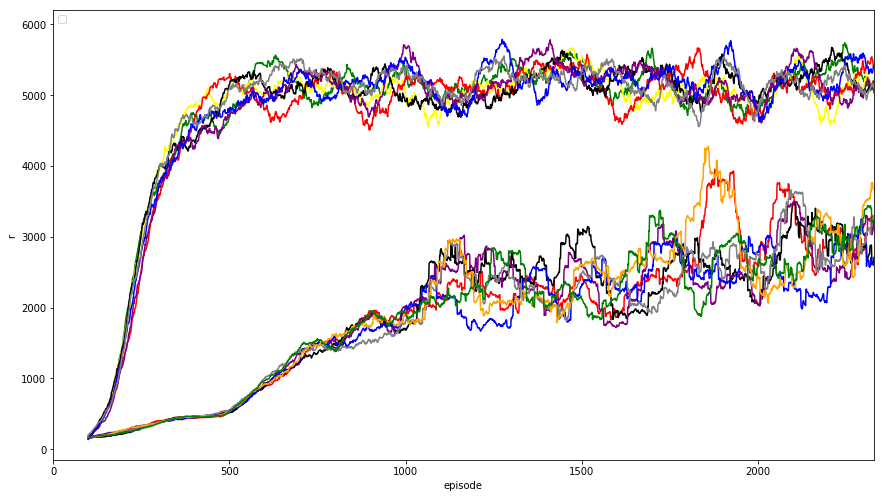

Rolling Plot l


No handles with labels found to put in legend.


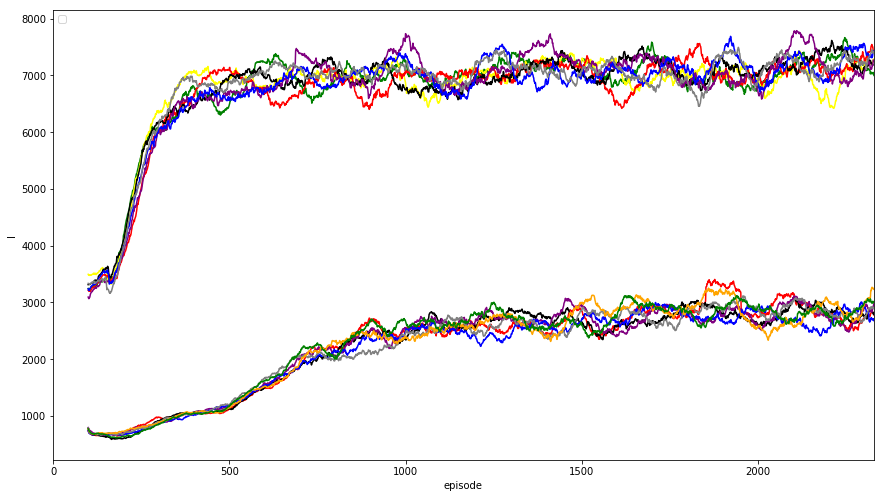

Rolling Plot success


No handles with labels found to put in legend.


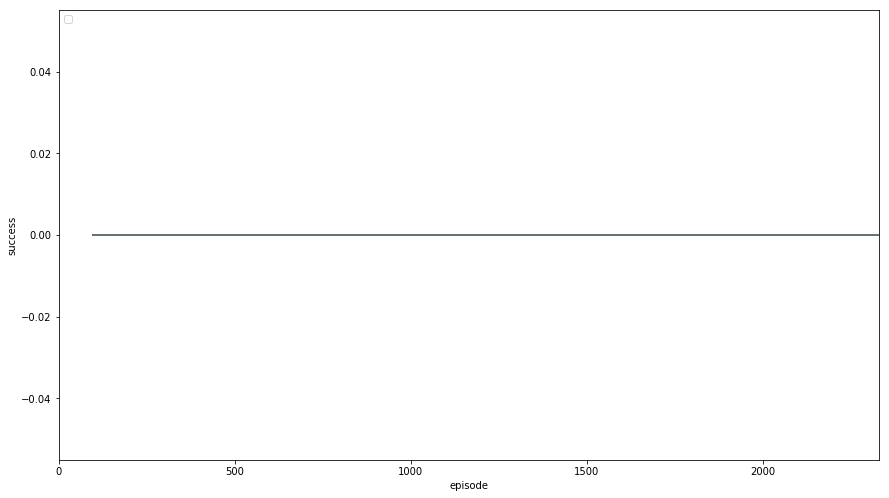

Rolling Plot sc_per_d


No handles with labels found to put in legend.


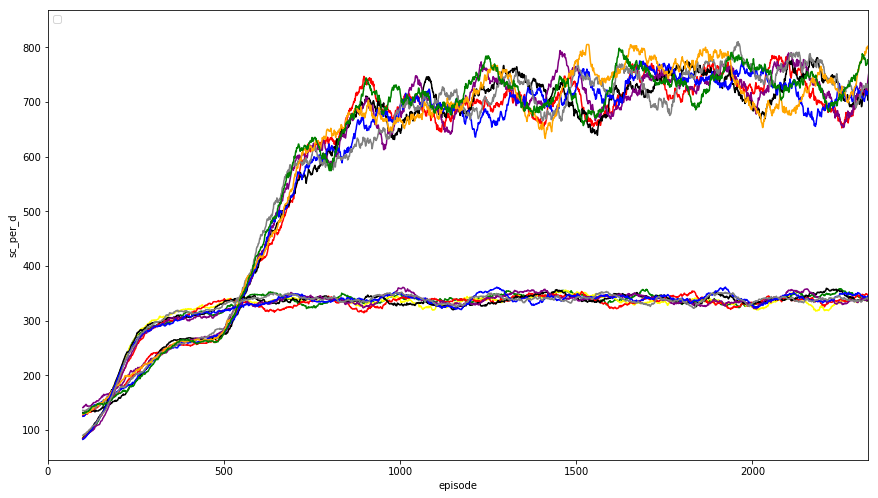

Reward Scatter Plot


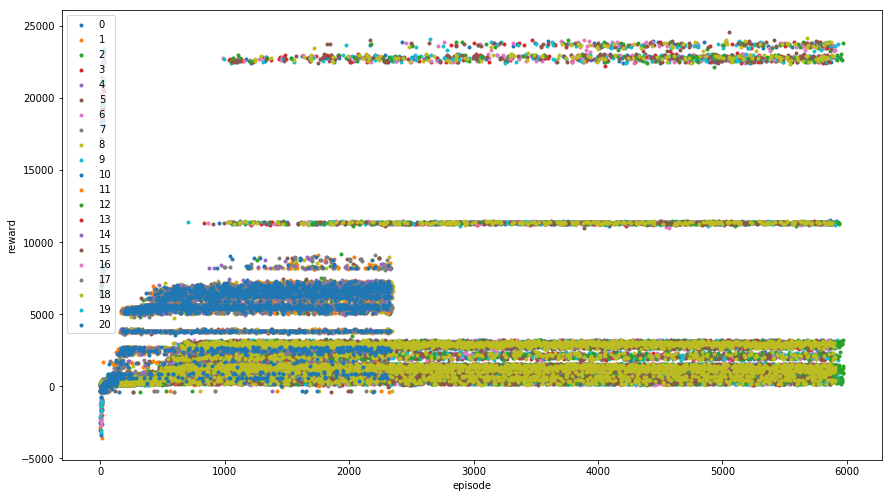

Timesteps Scatter Plot


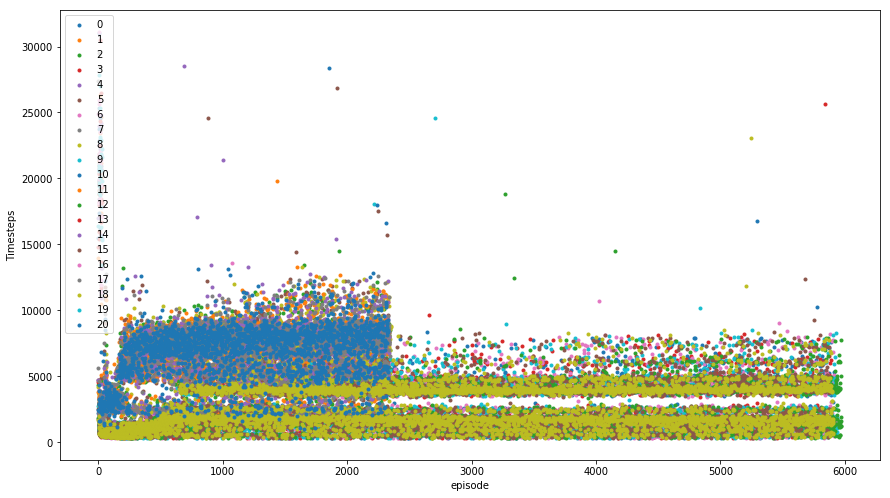

Success Scatter Plot


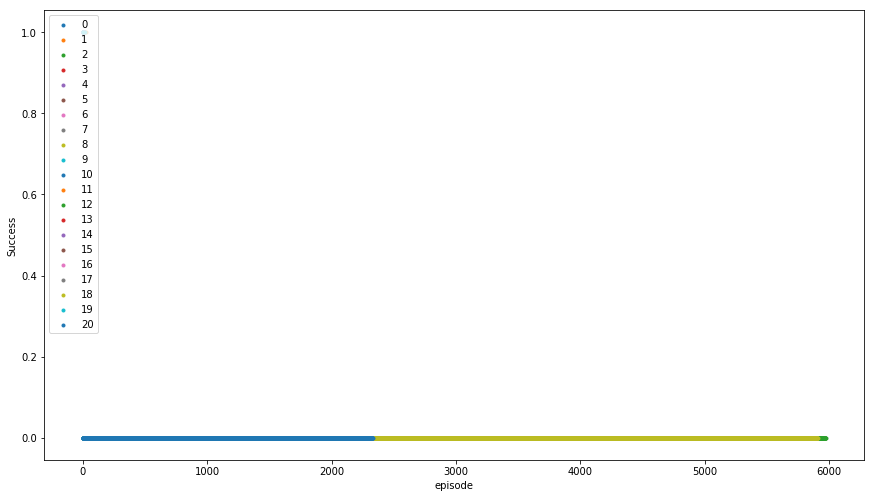

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


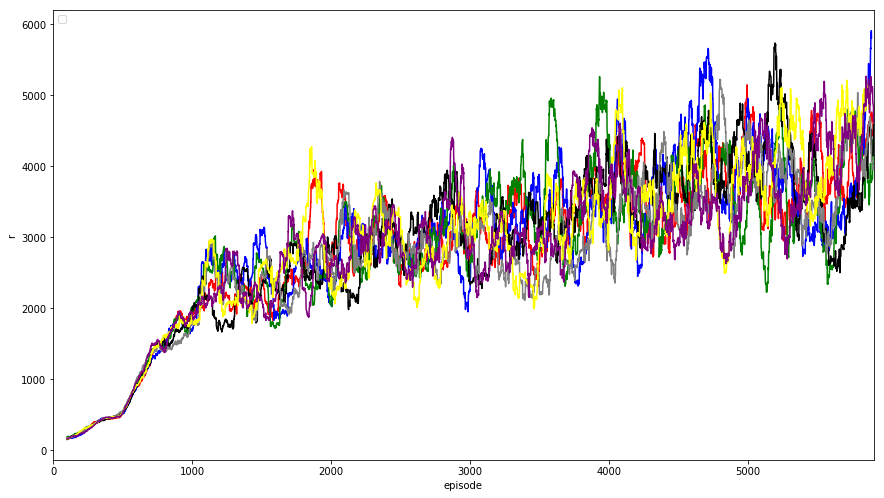

Rolling Plot l


No handles with labels found to put in legend.


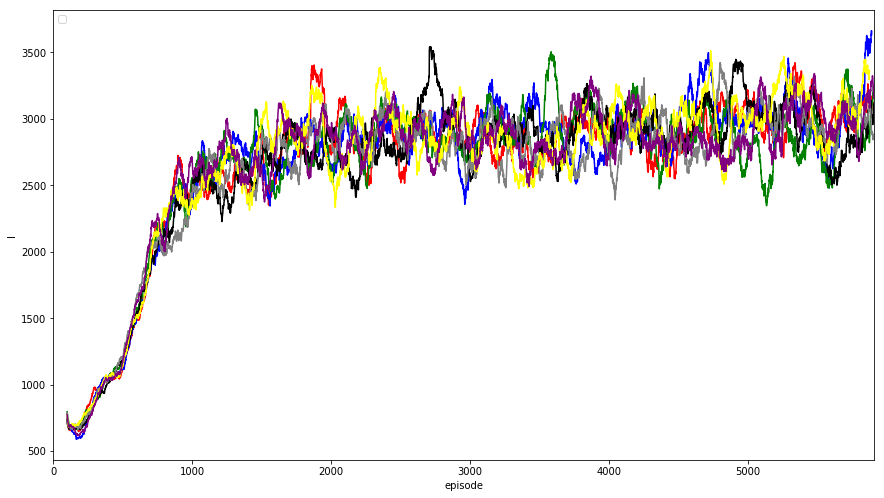

Rolling Plot success


No handles with labels found to put in legend.


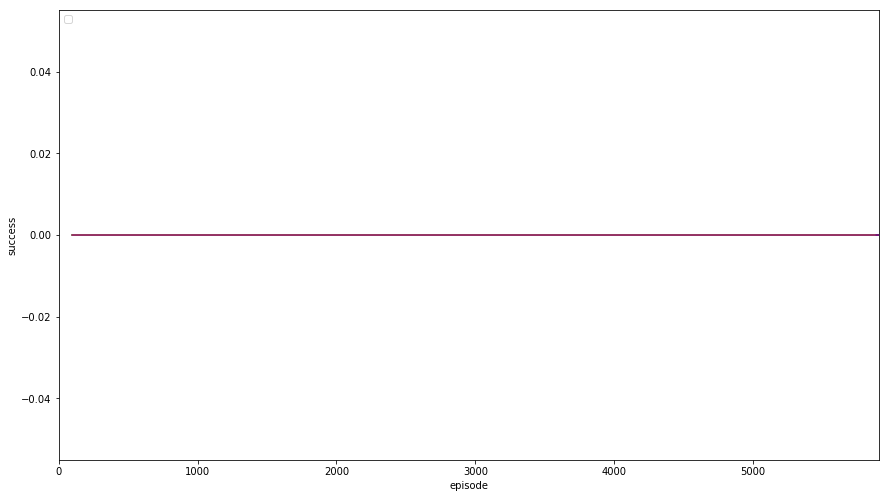

Rolling Plot sc_per_d


No handles with labels found to put in legend.


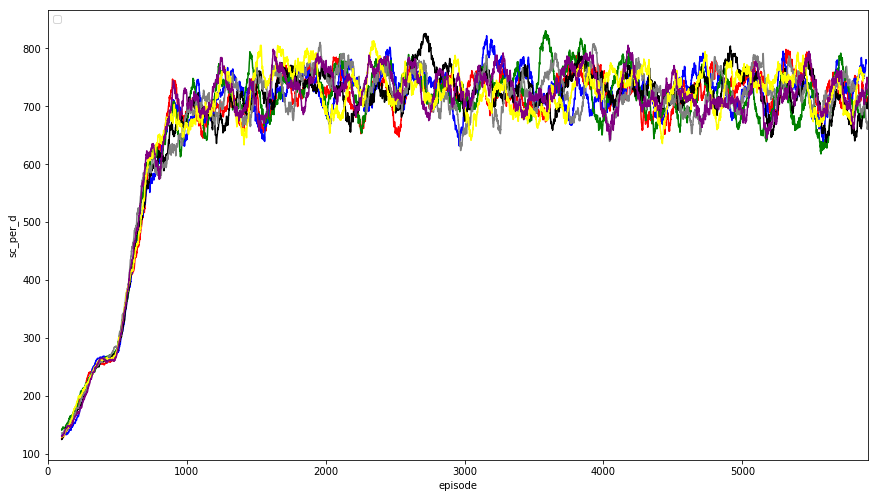

Reward Scatter Plot


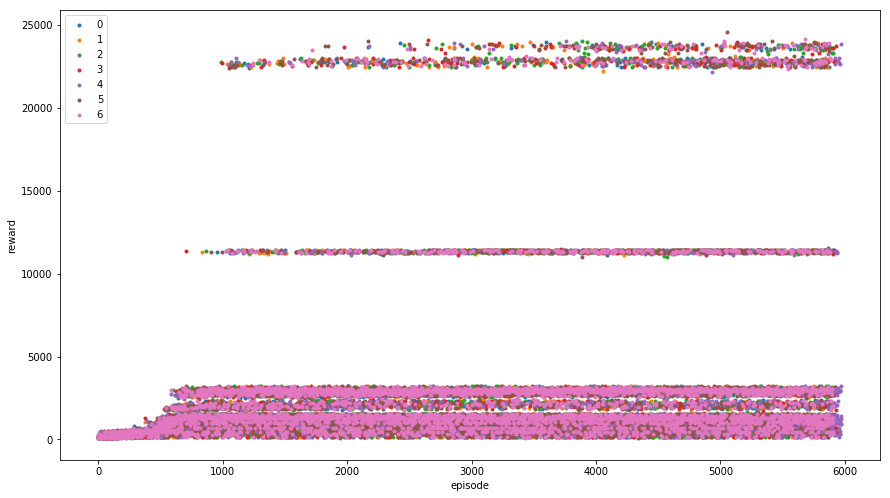

Timesteps Scatter Plot


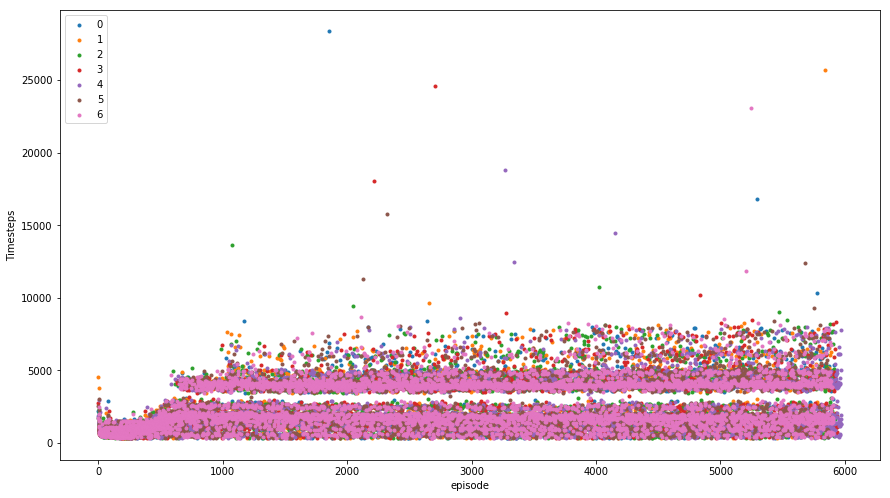

Success Scatter Plot


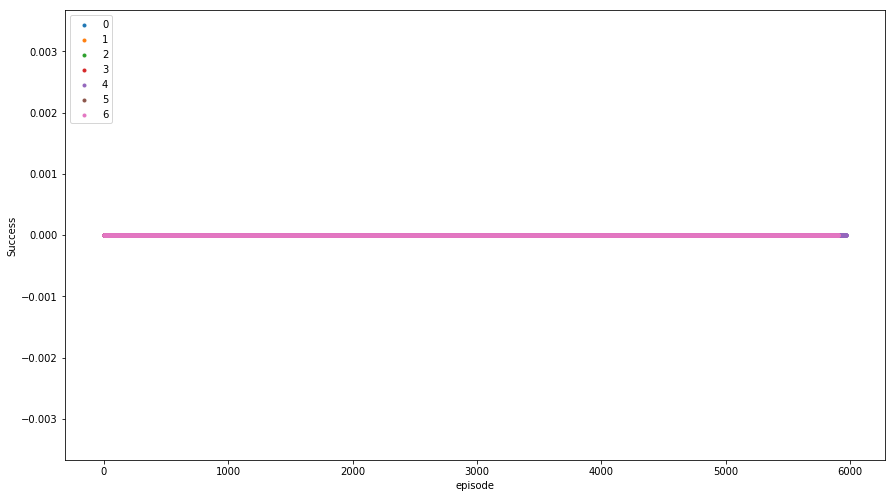

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


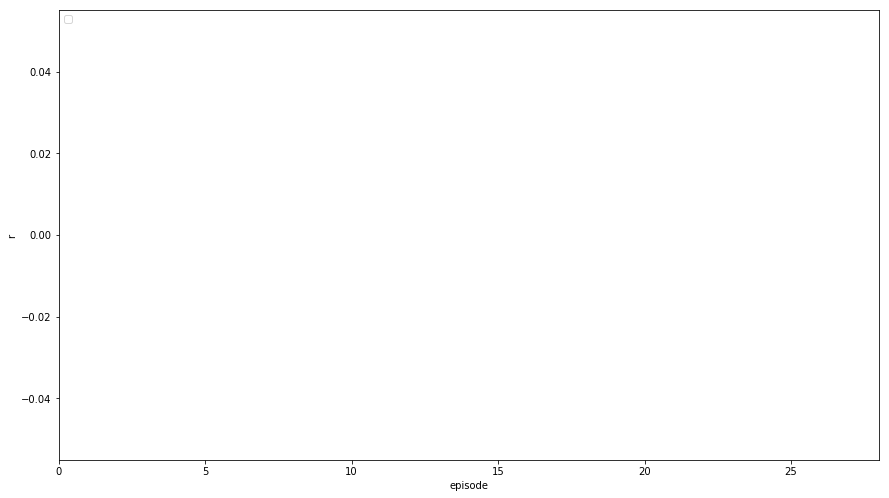

Rolling Plot l


No handles with labels found to put in legend.


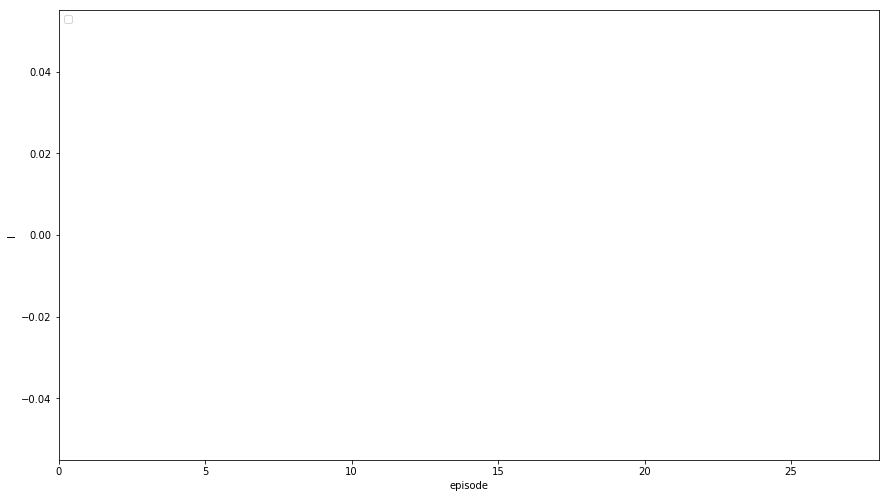

Rolling Plot success


No handles with labels found to put in legend.


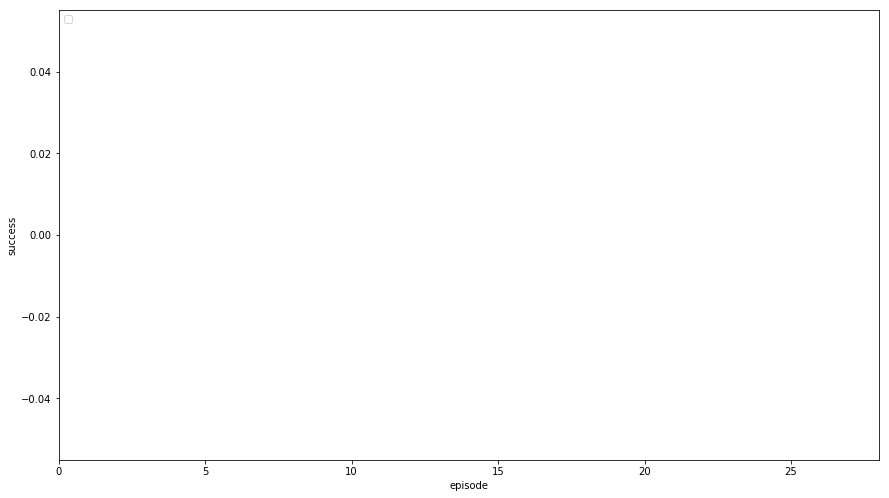

Rolling Plot sc_per_d


No handles with labels found to put in legend.


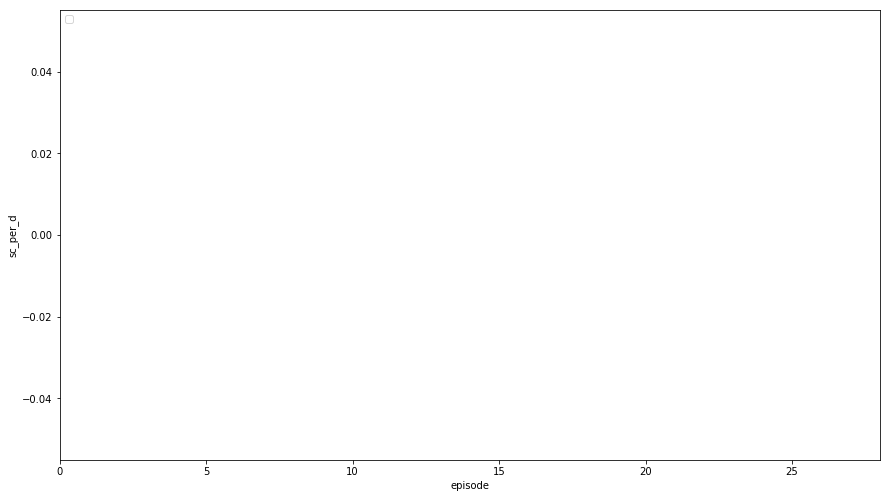

Reward Scatter Plot


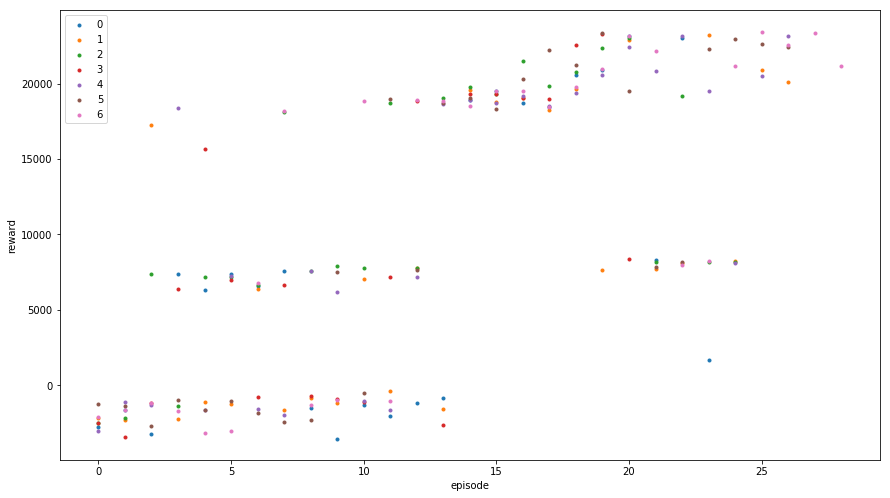

Timesteps Scatter Plot


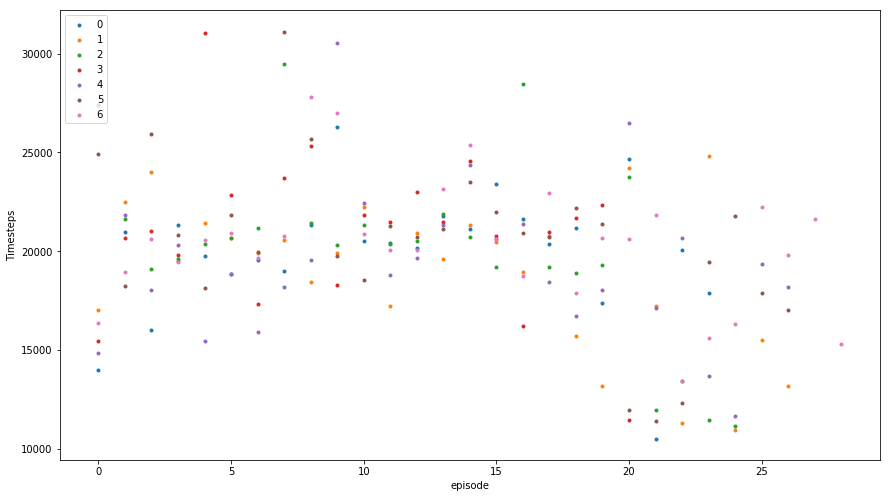

Success Scatter Plot


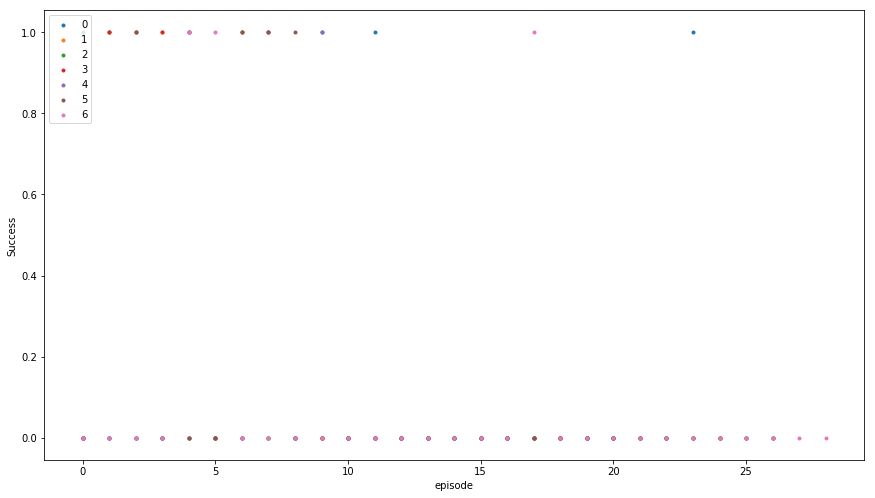

Doing rolling comparison for df mod 2
Rolling Plot r


No handles with labels found to put in legend.


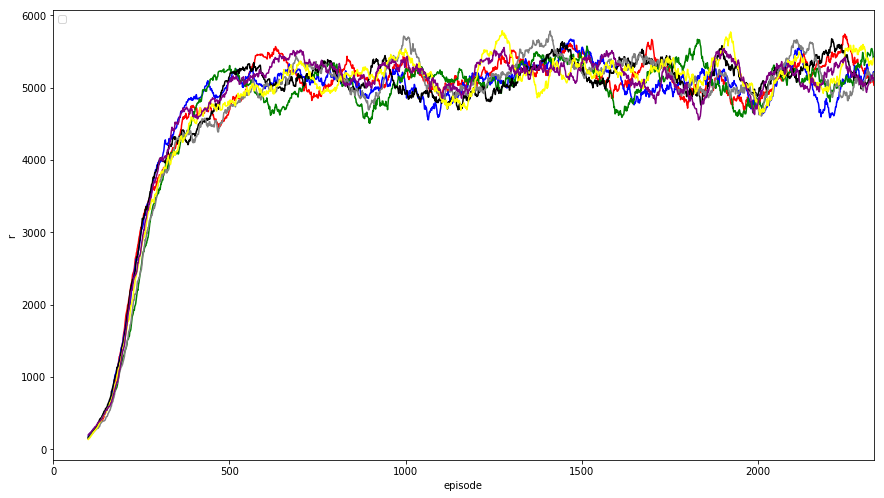

Rolling Plot l


No handles with labels found to put in legend.


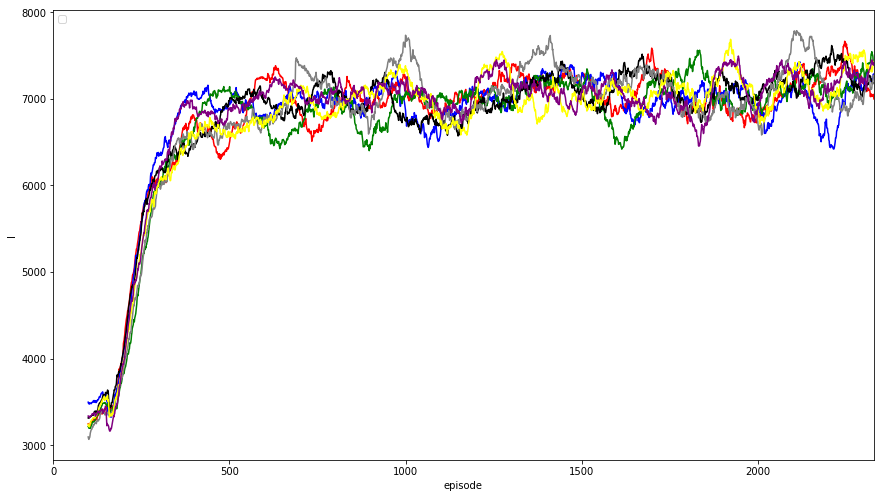

Rolling Plot success


No handles with labels found to put in legend.


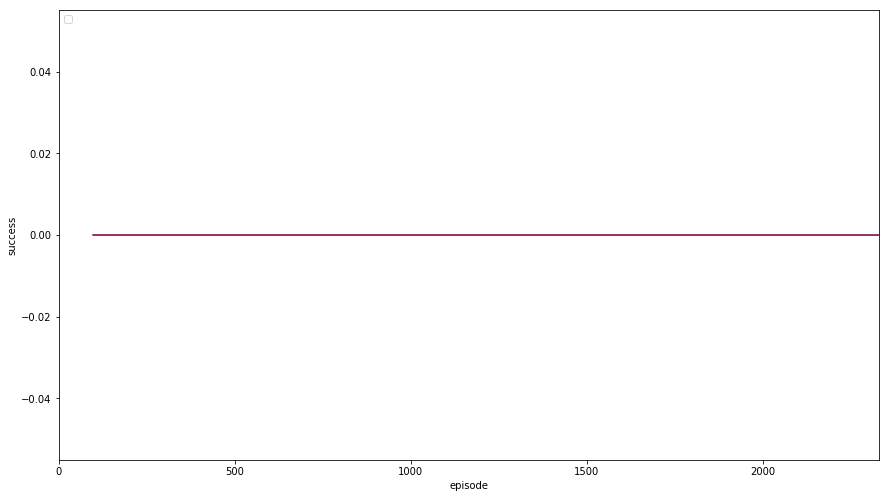

Rolling Plot sc_per_d


No handles with labels found to put in legend.


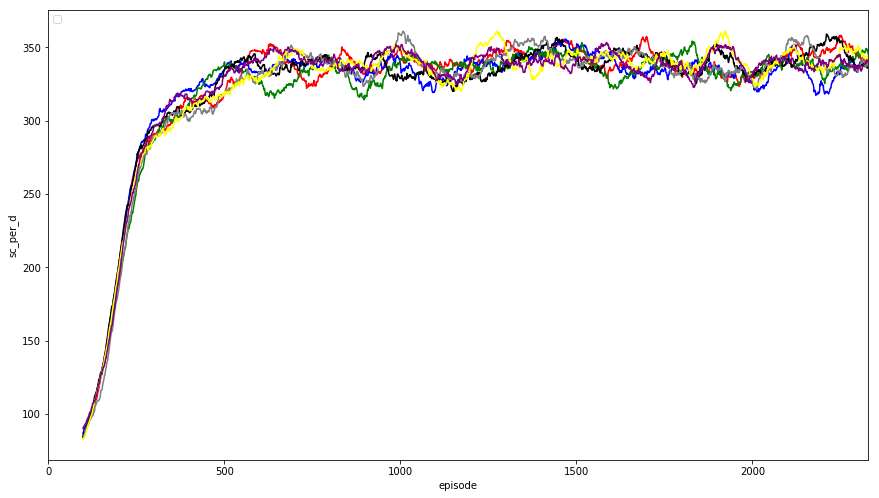

Reward Scatter Plot


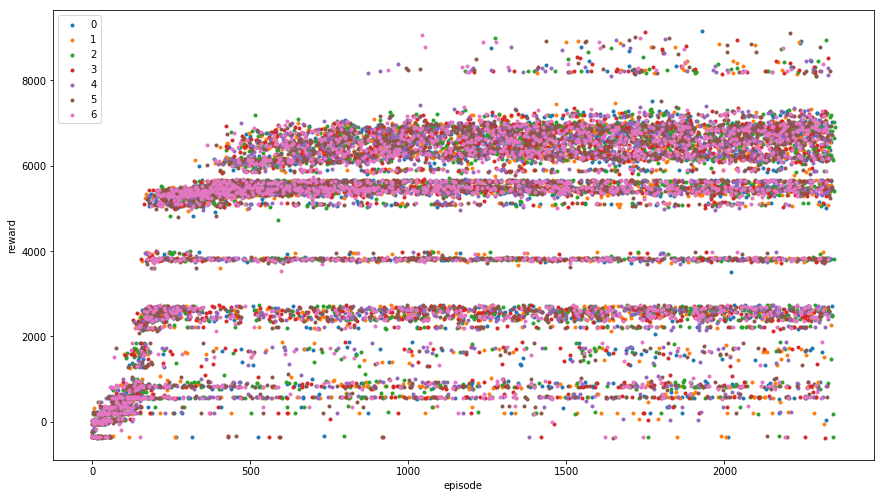

Timesteps Scatter Plot


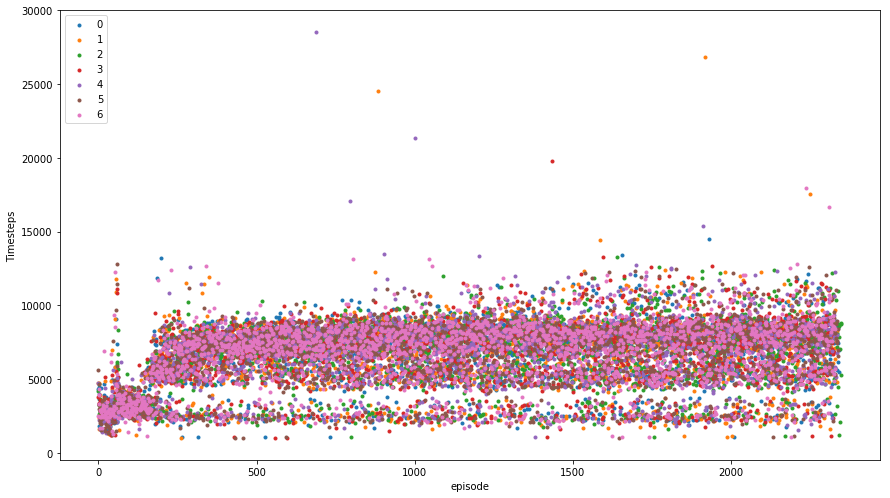

Success Scatter Plot


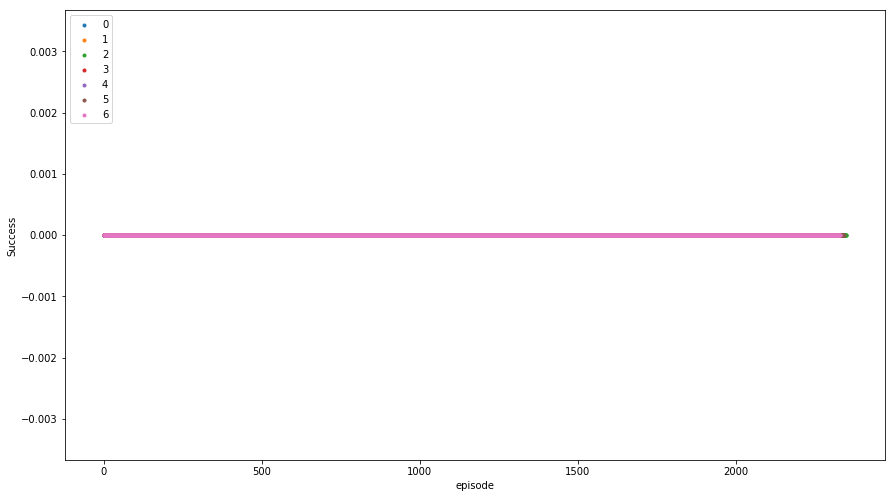

In [6]:
#run 19 1542738976
get_results(time_id=1542738976,base_dir='logs',df_mod=3)

logs/log_1542660557_0.monitor.csv
logs/log_1542660557_1.monitor.csv
logs/log_1542660557_2.monitor.csv
logs/log_1542660557_3.monitor.csv
logs/log_1542660557_4.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542660557_5.monitor.csv
logs/log_1542660557_6.monitor.csv
logs/log_1542660557_7.monitor.csv
logs/log_1542660557_8.monitor.csv
logs/log_1542660557_9.monitor.csv
logs/log_1542660557_10.monitor.csv
logs/log_1542660557_11.monitor.csv
logs/log_1542660557_12.monitor.csv
logs/log_1542660557_13.monitor.csv
logs/log_1542660557_14.monitor.csv
logs/log_1542660557_15.monitor.csv
logs/log_1542660557_16.monitor.csv
logs/log_1542660557_17.monitor.csv
logs/log_1542660557_18.monitor.csv
logs/log_1542660557_19.monitor.csv
logs/log_1542660557_20.monitor.csv
Mean Reward last 100 Episodes per env: 3975.45464623
Mean Reward last 100 Episodes per env: 7890.3480996
Mean Reward last 100 Episodes per env: 7340.526877159999
Mean Reward last 100 Episodes per env: 3833.88002785
Mean Reward last 100 Episodes per env: 7864.39549911
Mean Reward last 100 Episodes per env: 6995.099466539999
Mean Reward last 100 Episodes per env: 3793.3247183000003
Mean Reward last 100 Episodes per env: 7895.618600029999
Mean 

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


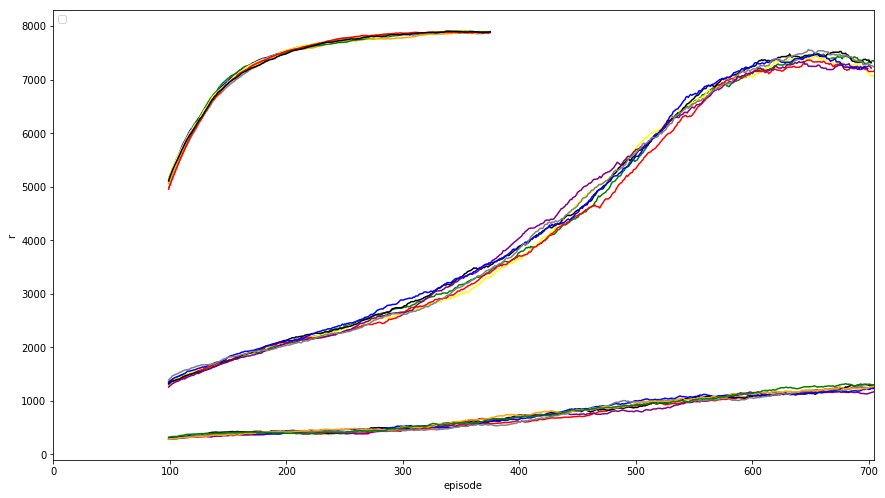

Rolling Plot l


No handles with labels found to put in legend.


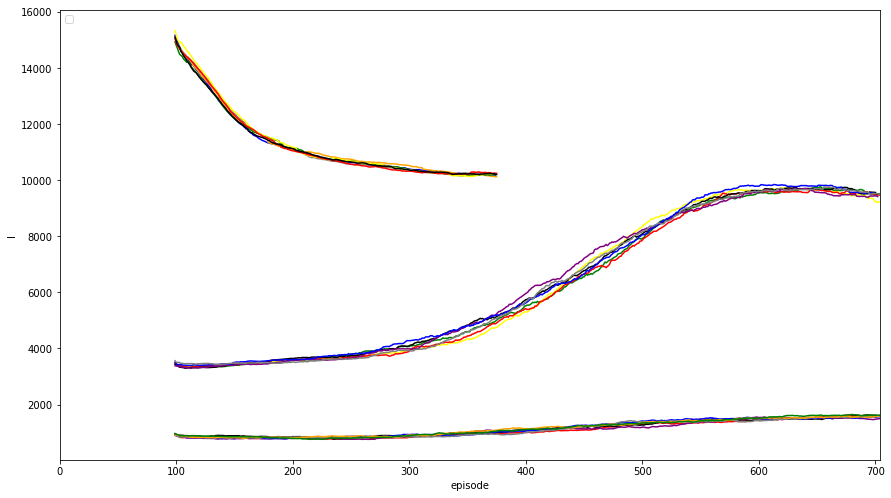

Rolling Plot success


No handles with labels found to put in legend.


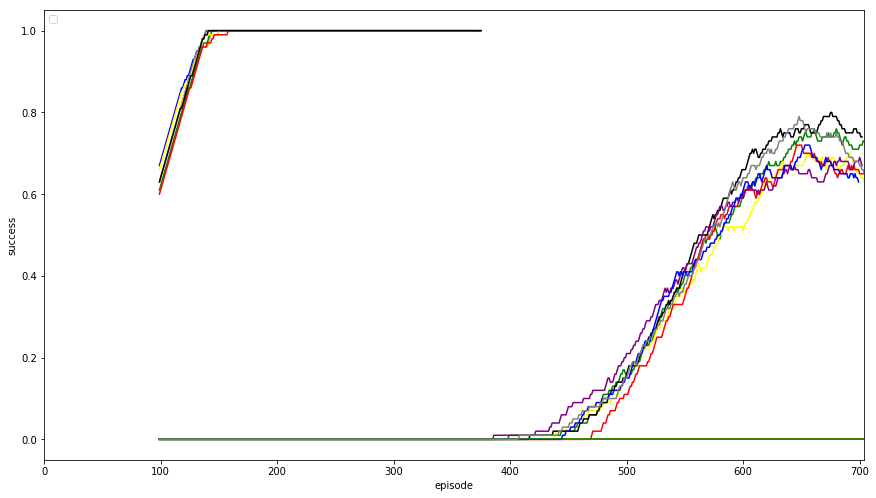

Rolling Plot sc_per_d


No handles with labels found to put in legend.


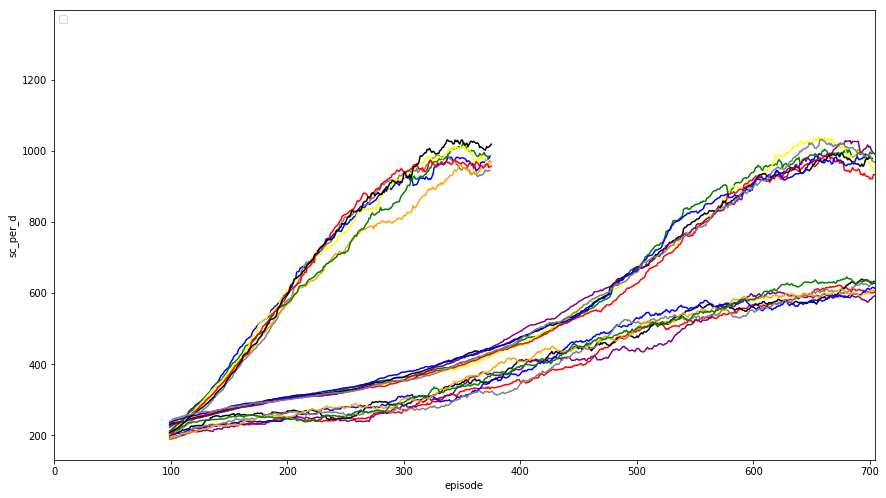

Reward Scatter Plot


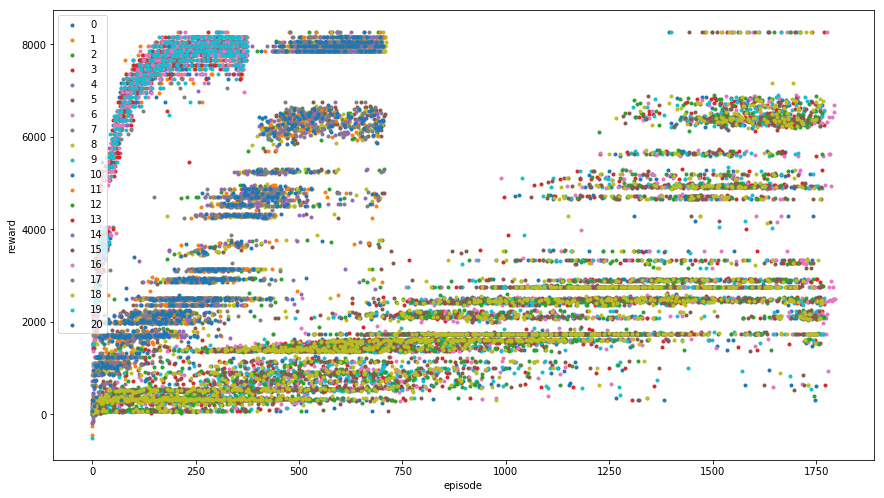

Timesteps Scatter Plot


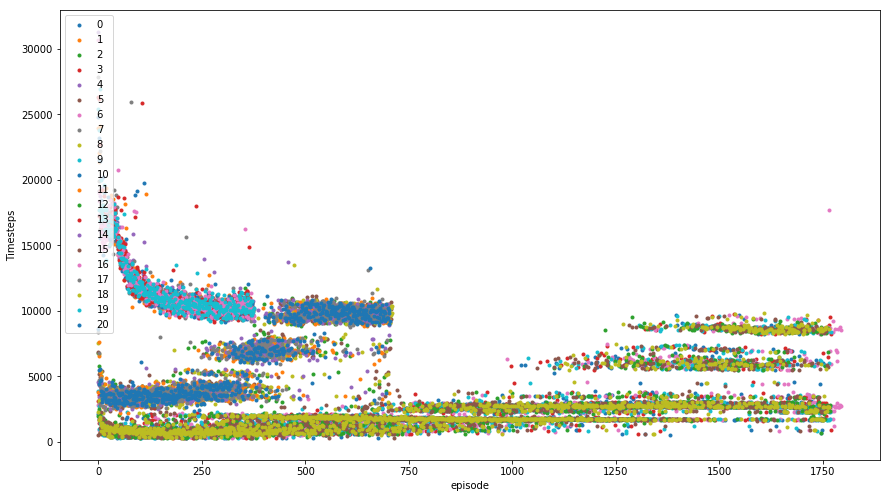

Success Scatter Plot


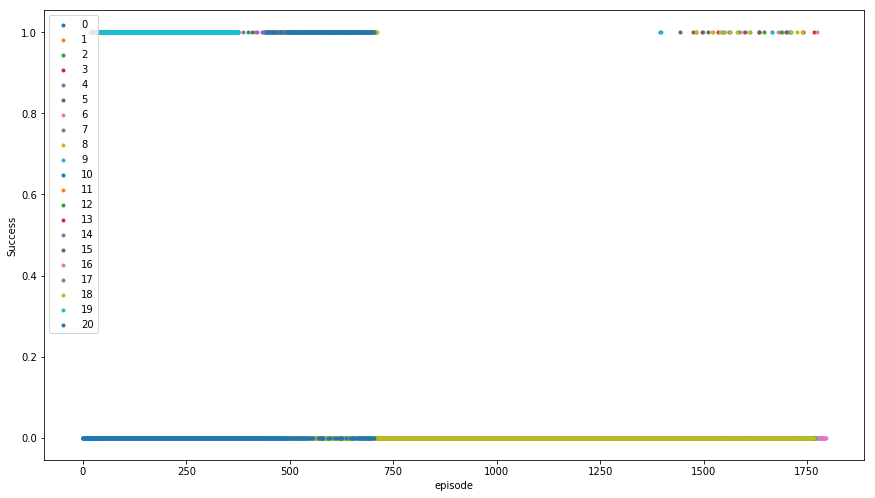

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


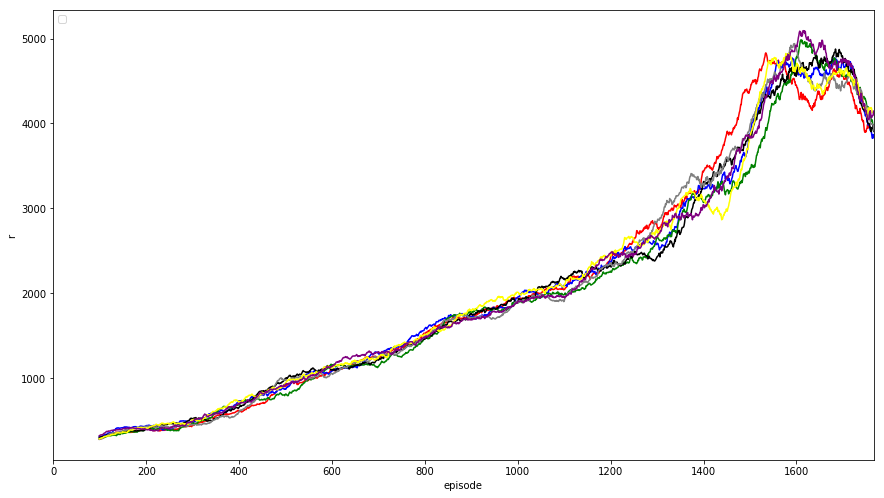

Rolling Plot l


No handles with labels found to put in legend.


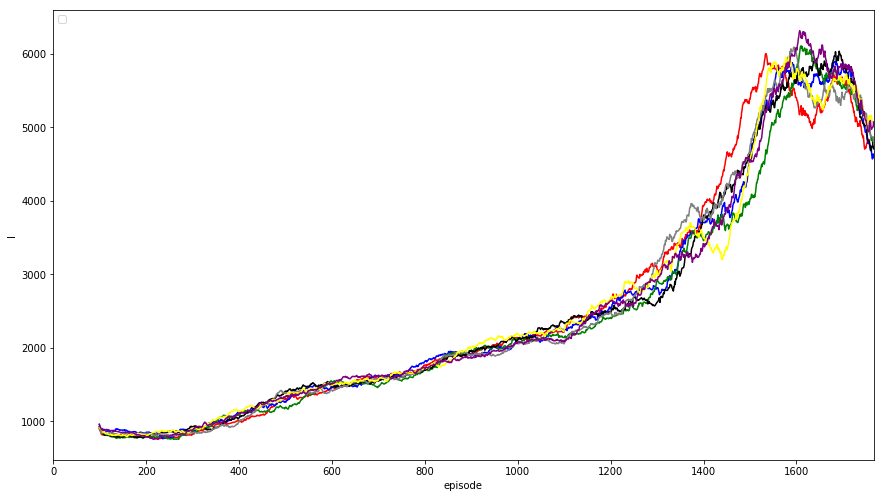

Rolling Plot success


No handles with labels found to put in legend.


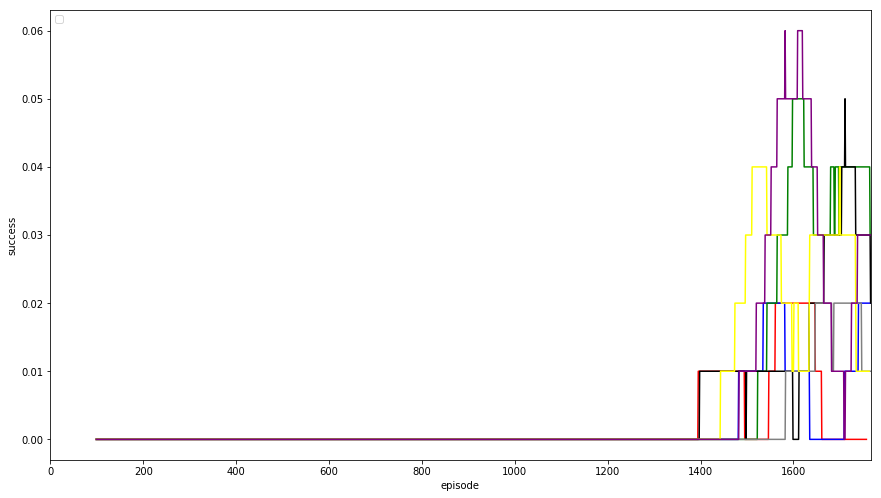

Rolling Plot sc_per_d


No handles with labels found to put in legend.


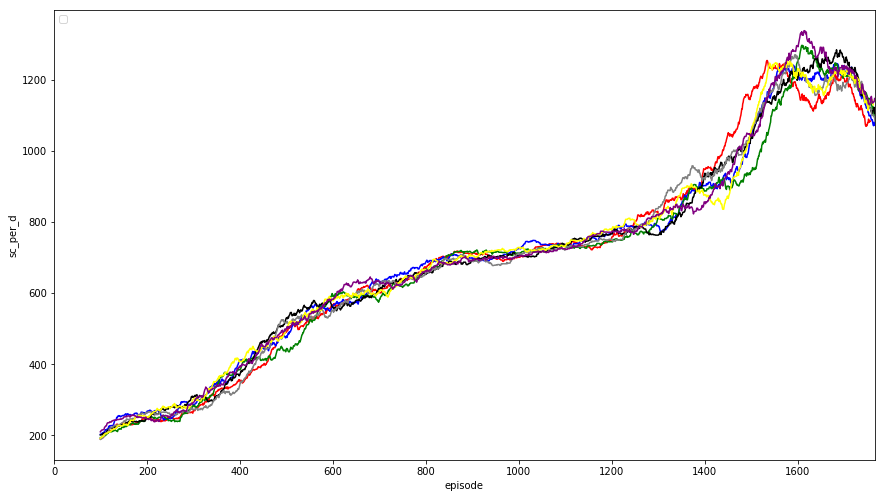

Reward Scatter Plot


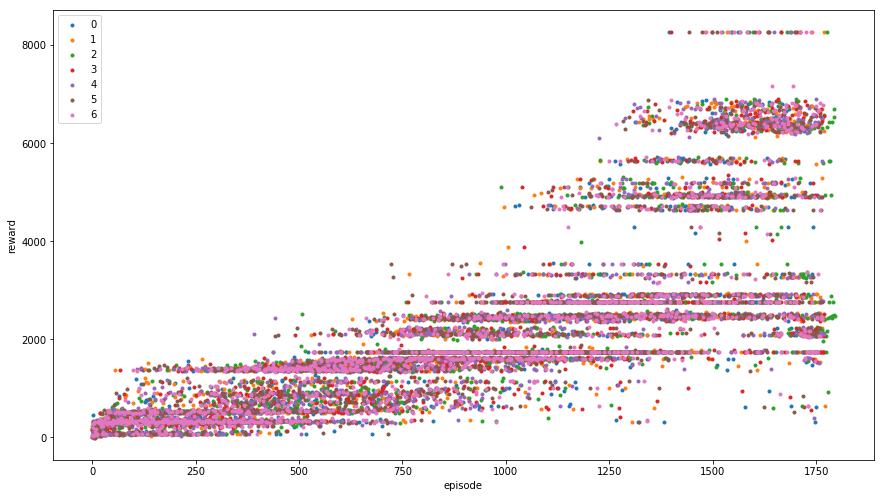

Timesteps Scatter Plot


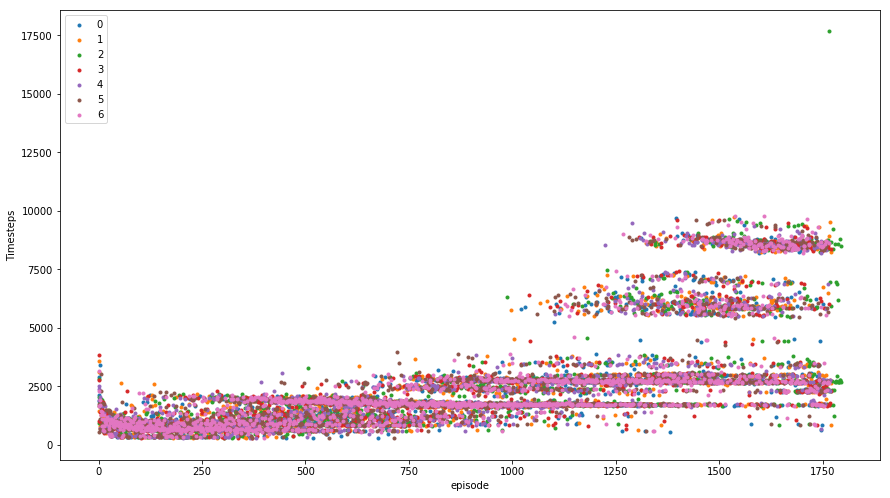

Success Scatter Plot


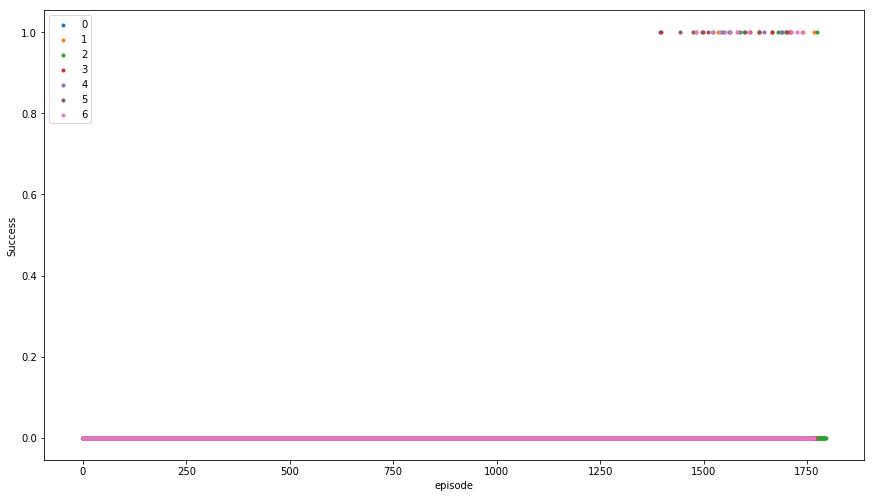

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


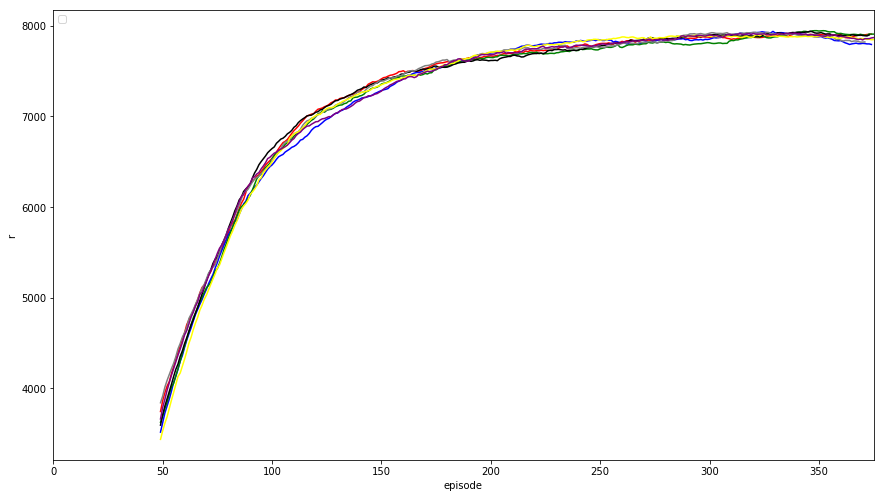

Rolling Plot l


No handles with labels found to put in legend.


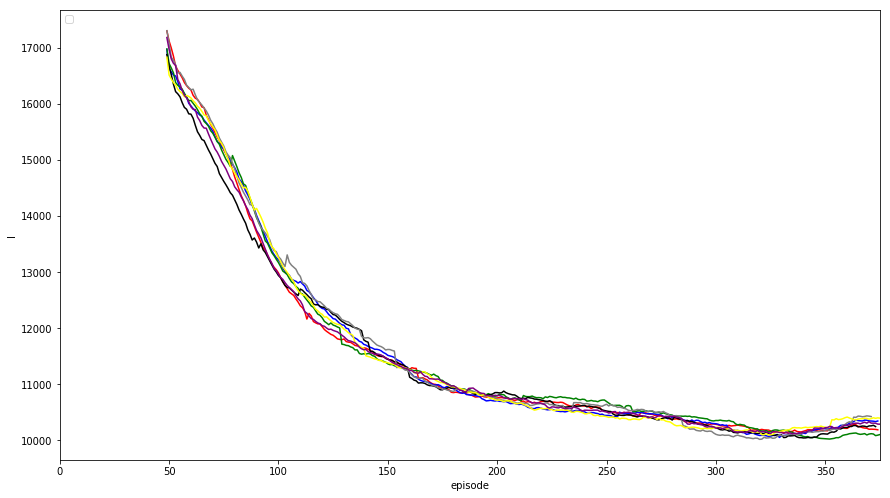

Rolling Plot success


No handles with labels found to put in legend.


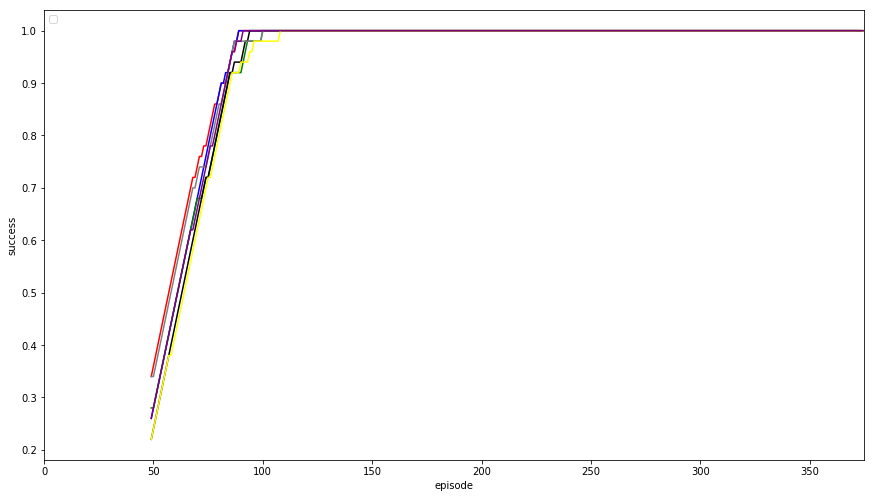

Rolling Plot sc_per_d


No handles with labels found to put in legend.


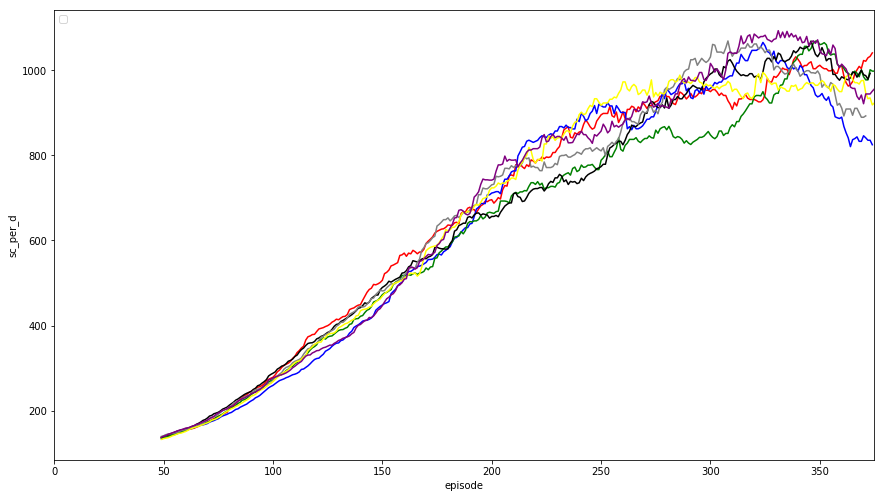

Reward Scatter Plot


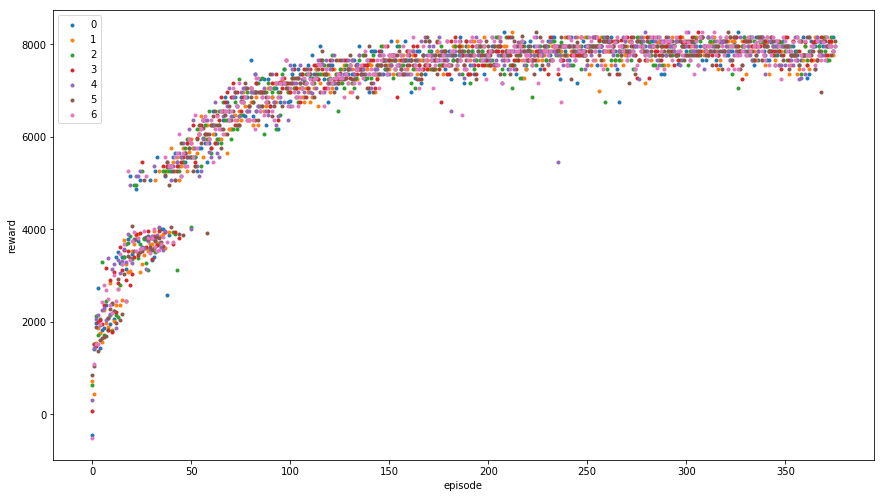

Timesteps Scatter Plot


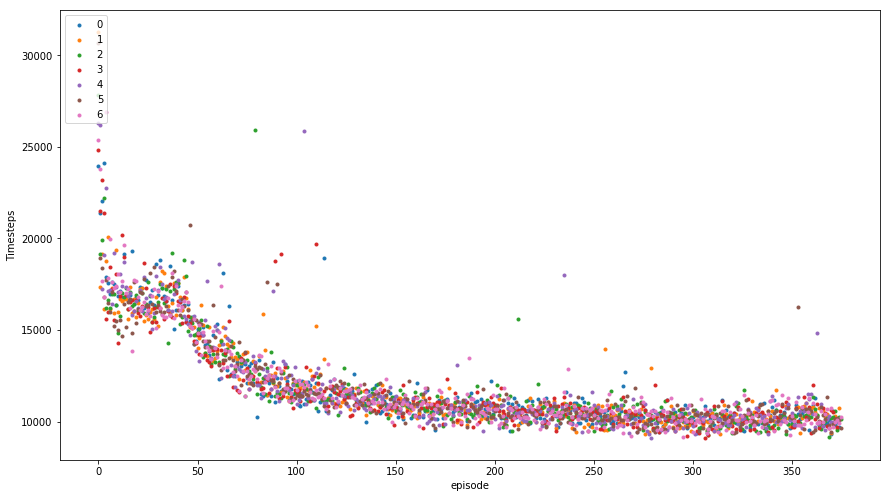

Success Scatter Plot


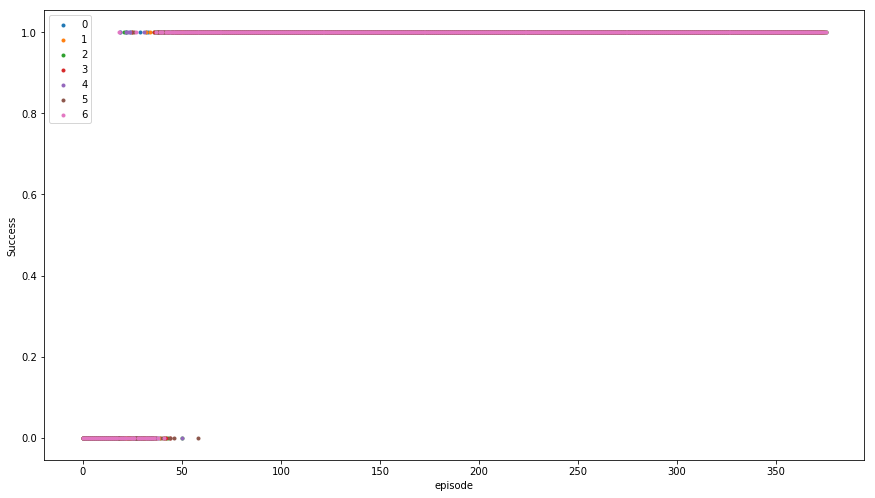

Doing rolling comparison for df mod 2
Rolling Plot r


No handles with labels found to put in legend.


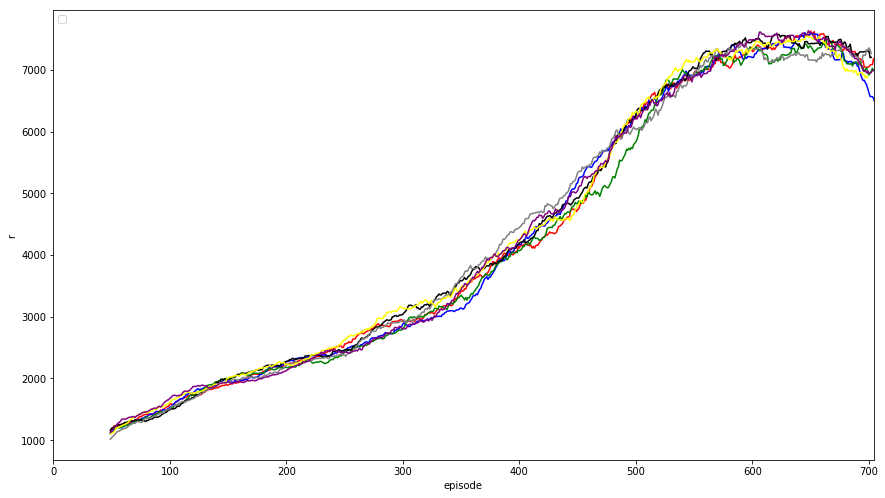

Rolling Plot l


No handles with labels found to put in legend.


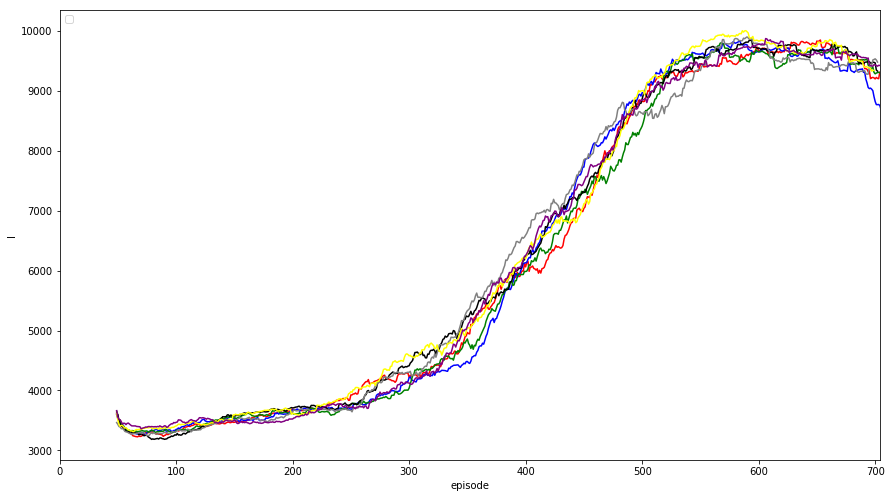

Rolling Plot success


No handles with labels found to put in legend.


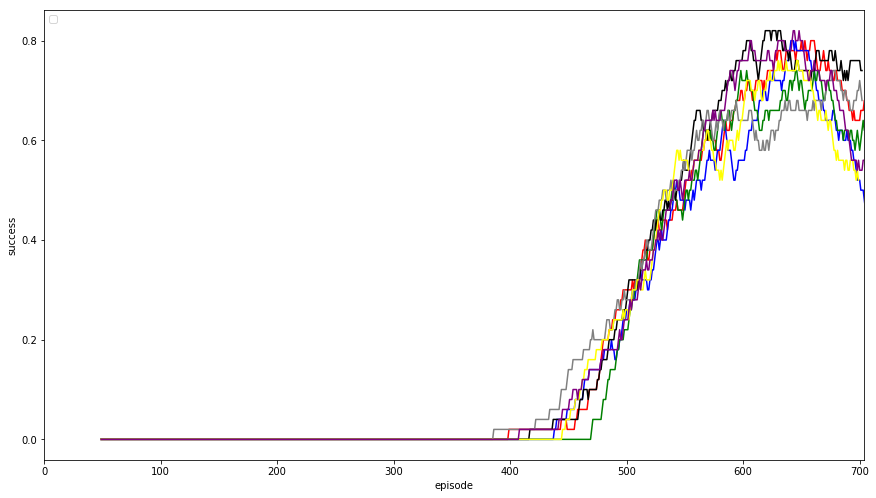

Rolling Plot sc_per_d


No handles with labels found to put in legend.


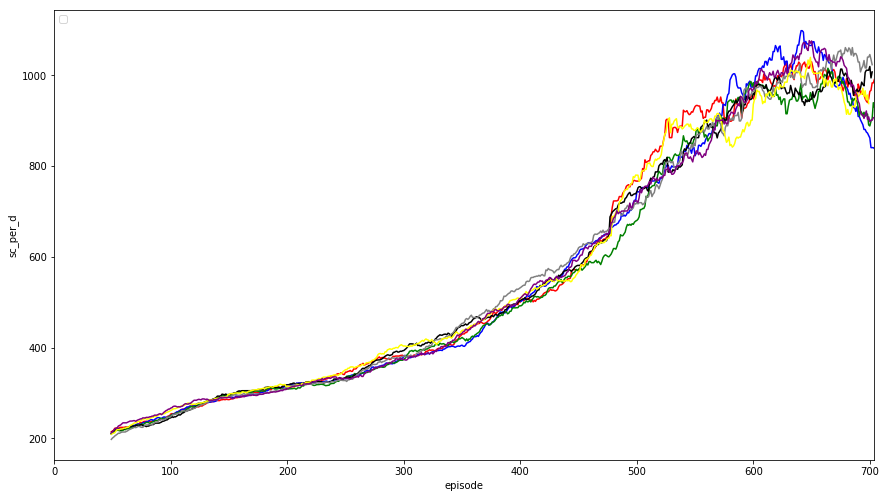

Reward Scatter Plot


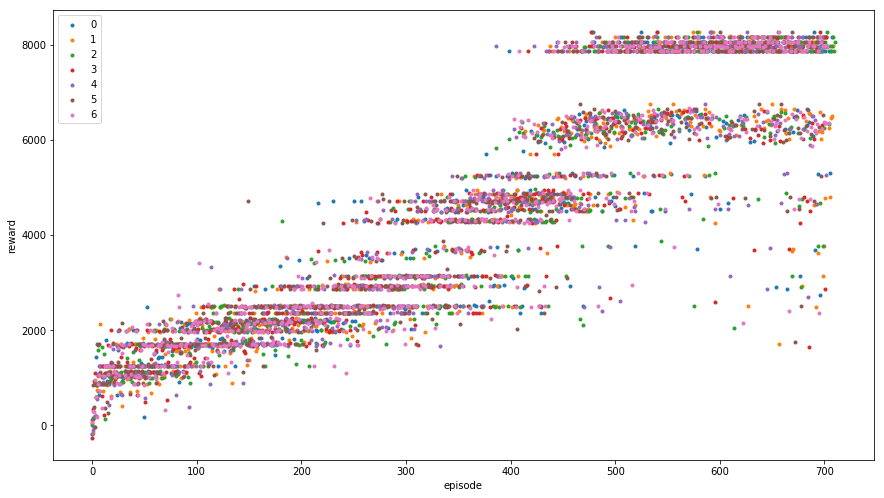

Timesteps Scatter Plot


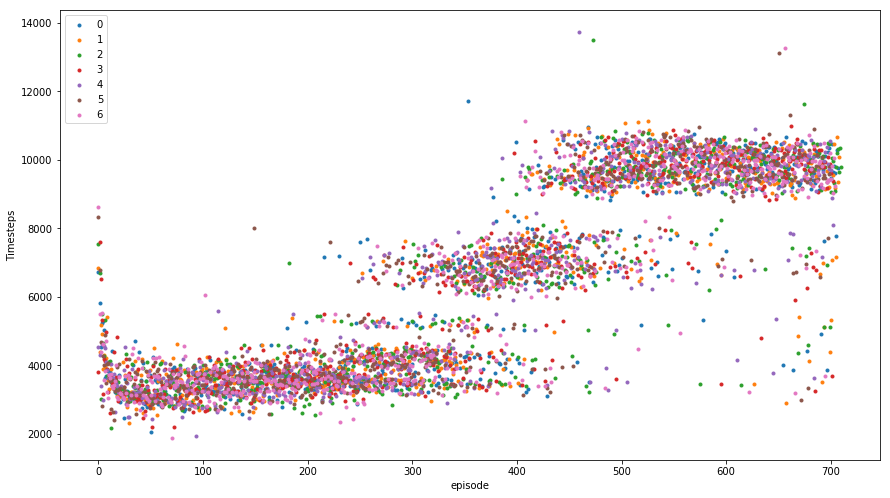

Success Scatter Plot


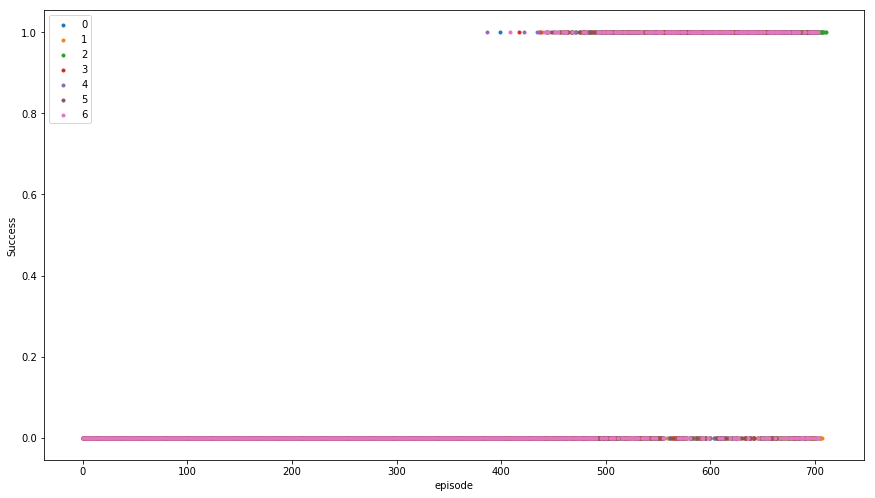

In [4]:
#test run 17
#/home/jim/projects/contra/logs/log_1542660557_19.monitor.csv
#WOOT BEAT LEVEL 1!
get_results(time_id=1542660557,base_dir='logs',df_mod=3)

logs/log_1542641711_0.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542641711_1.monitor.csv
logs/log_1542641711_2.monitor.csv
logs/log_1542641711_3.monitor.csv
logs/log_1542641711_4.monitor.csv
logs/log_1542641711_5.monitor.csv
logs/log_1542641711_6.monitor.csv
logs/log_1542641711_7.monitor.csv
logs/log_1542641711_8.monitor.csv
logs/log_1542641711_9.monitor.csv
logs/log_1542641711_10.monitor.csv
logs/log_1542641711_11.monitor.csv
logs/log_1542641711_12.monitor.csv
logs/log_1542641711_13.monitor.csv
logs/log_1542641711_14.monitor.csv
logs/log_1542641711_15.monitor.csv
logs/log_1542641711_16.monitor.csv
logs/log_1542641711_17.monitor.csv
logs/log_1542641711_18.monitor.csv
logs/log_1542641711_19.monitor.csv
logs/log_1542641711_20.monitor.csv
Mean Reward last 100 Episodes per env: -758.7098588000001
Mean Reward last 100 Episodes per env: -37946.9126385
Mean Reward last 100 Episodes per env: -5490.627455592592
Mean Reward last 100 Episodes per env: -765.47977547
Mean Reward last 100 Episodes per env: -35680.890890999995
Mean Reward last 100 Episod

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


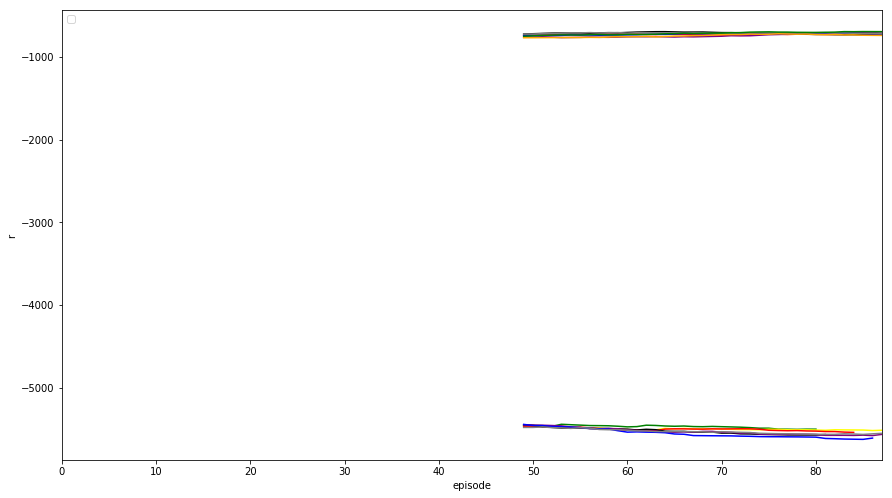

Rolling Plot l


No handles with labels found to put in legend.


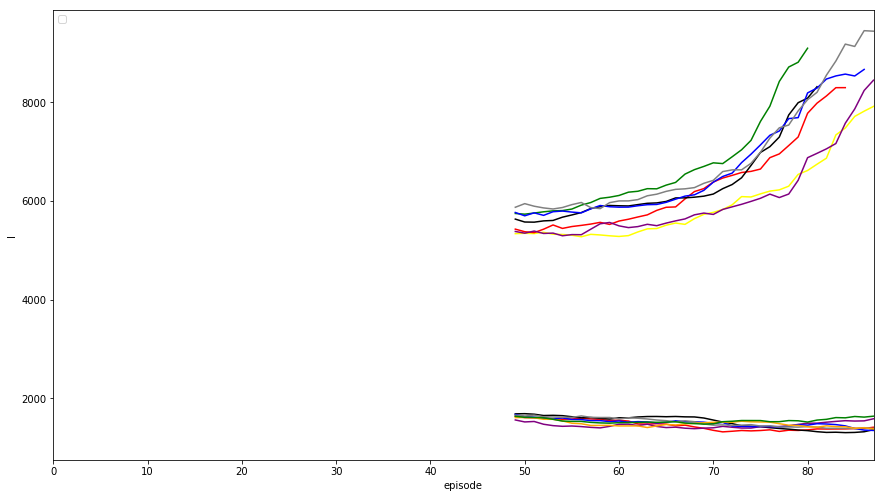

Rolling Plot success


No handles with labels found to put in legend.


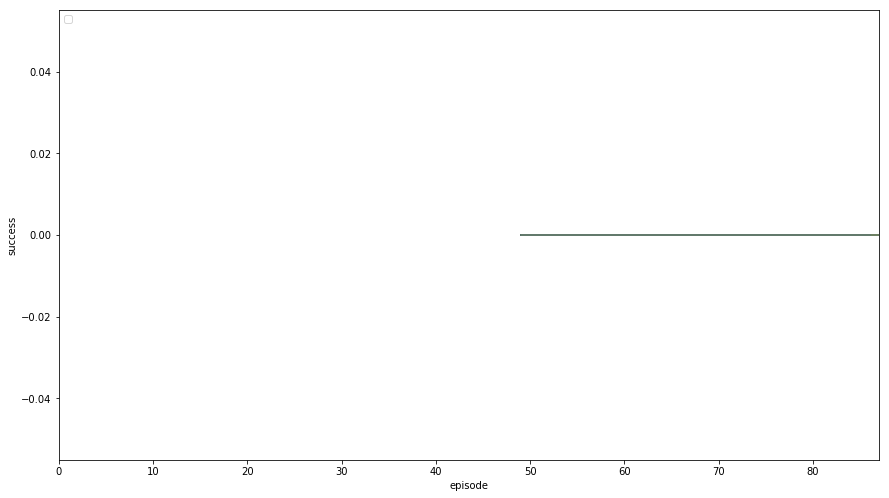

Rolling Plot sc_per_d


No handles with labels found to put in legend.


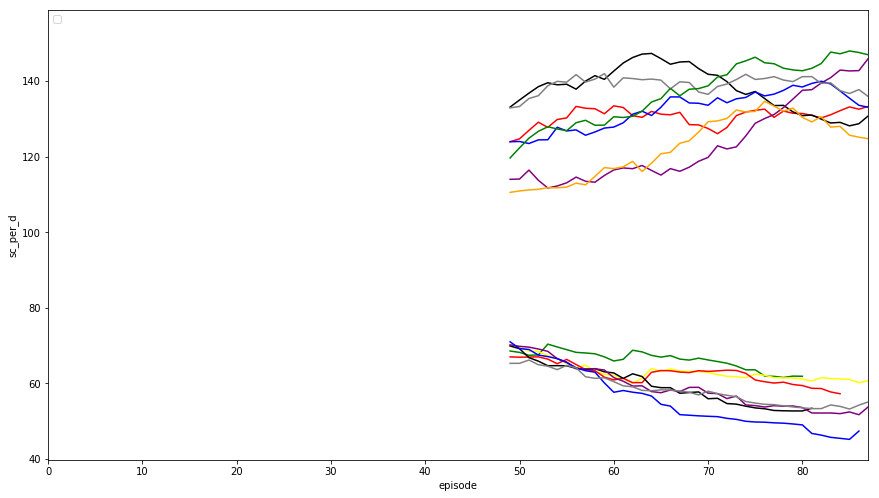

Reward Scatter Plot


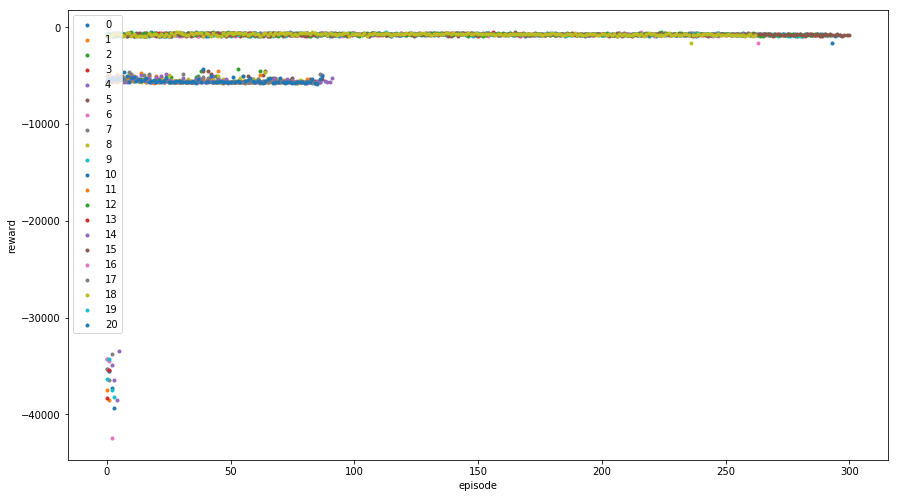

Timesteps Scatter Plot


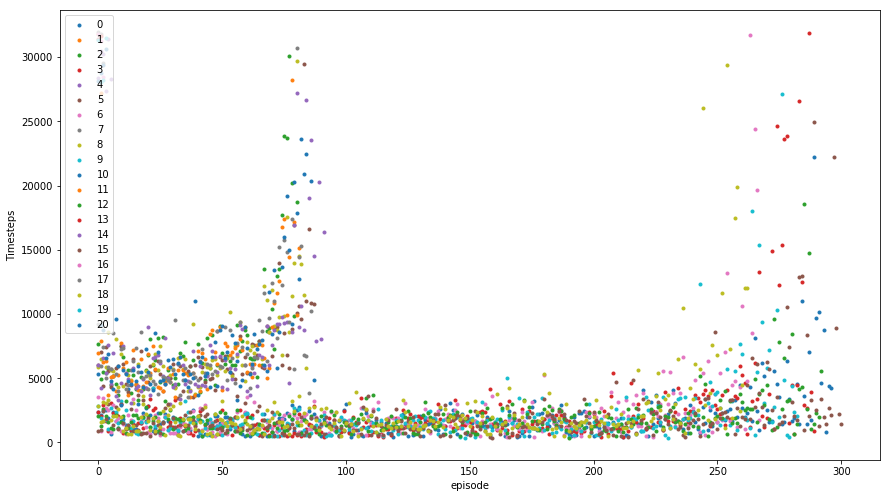

Success Scatter Plot


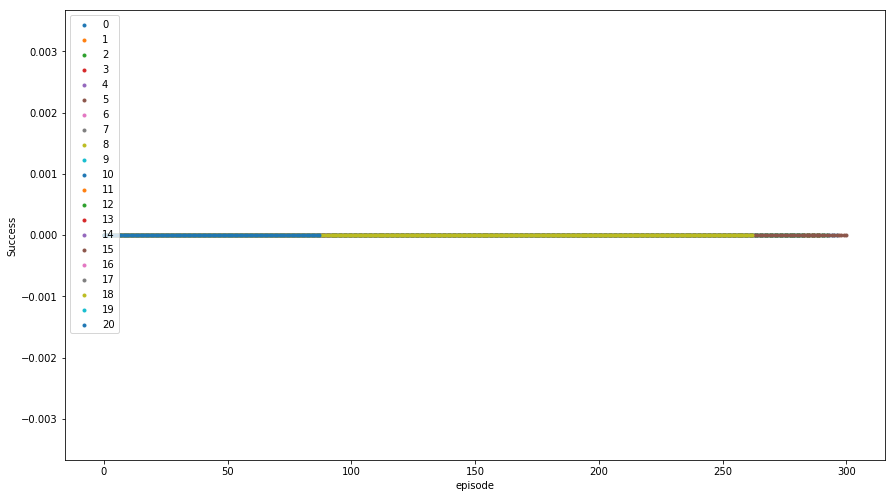

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


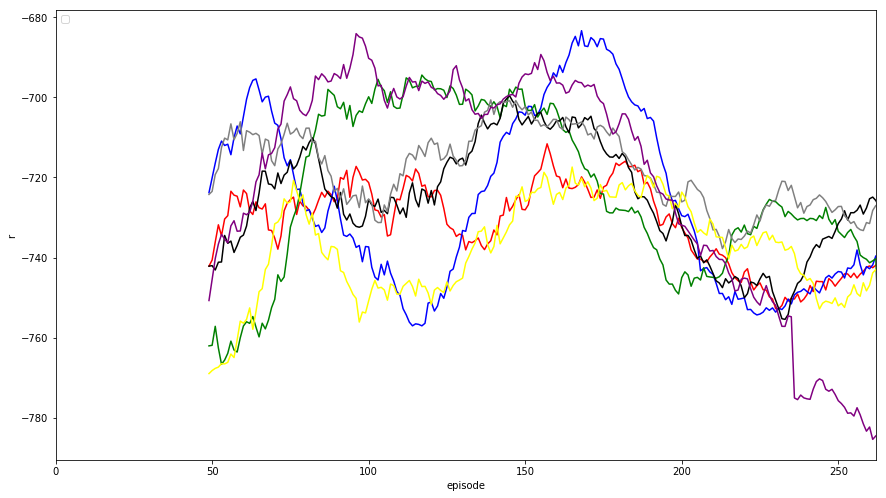

Rolling Plot l


No handles with labels found to put in legend.


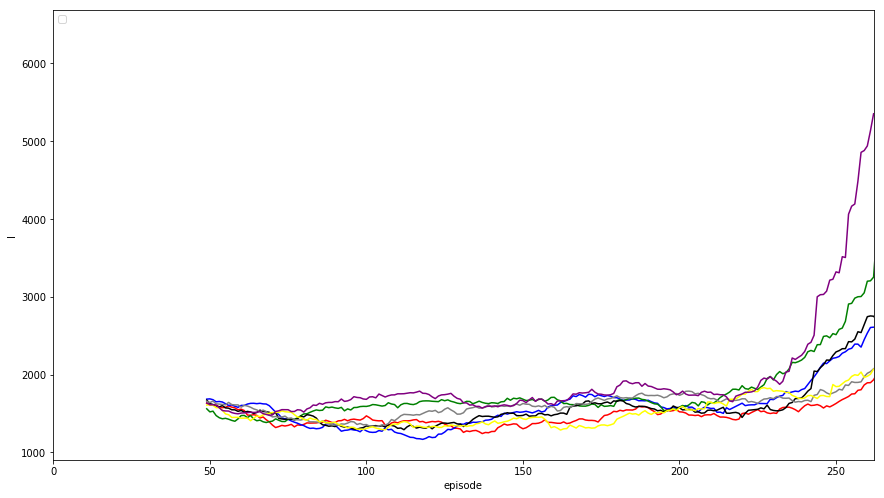

Rolling Plot success


No handles with labels found to put in legend.


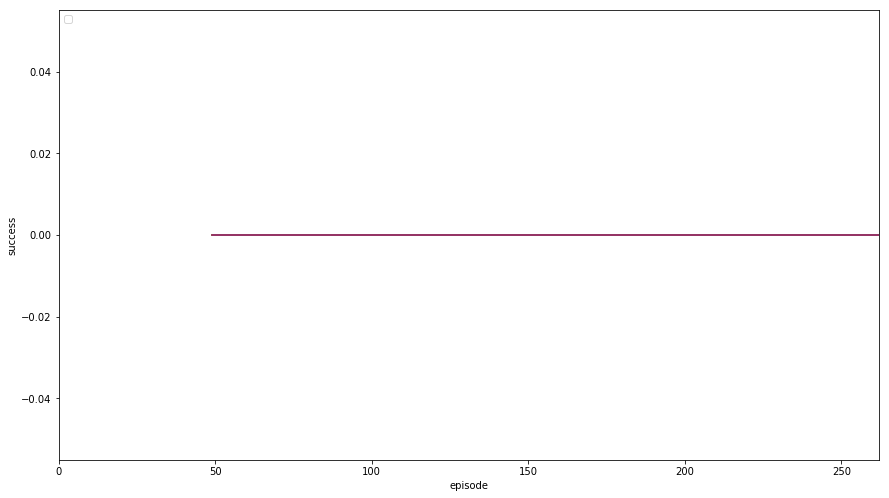

Rolling Plot sc_per_d


No handles with labels found to put in legend.


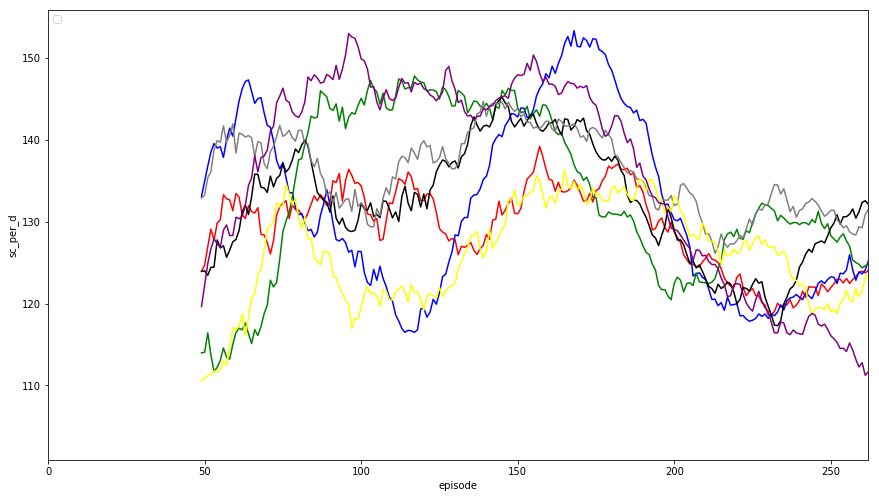

Reward Scatter Plot


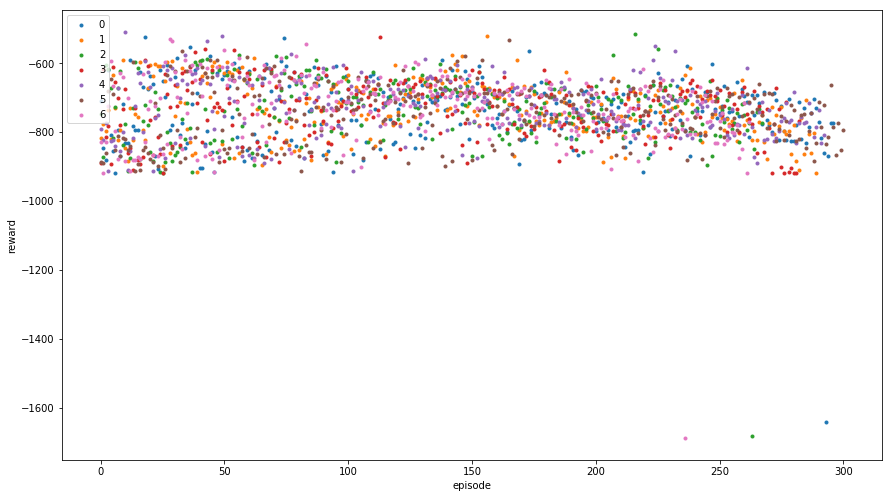

Timesteps Scatter Plot


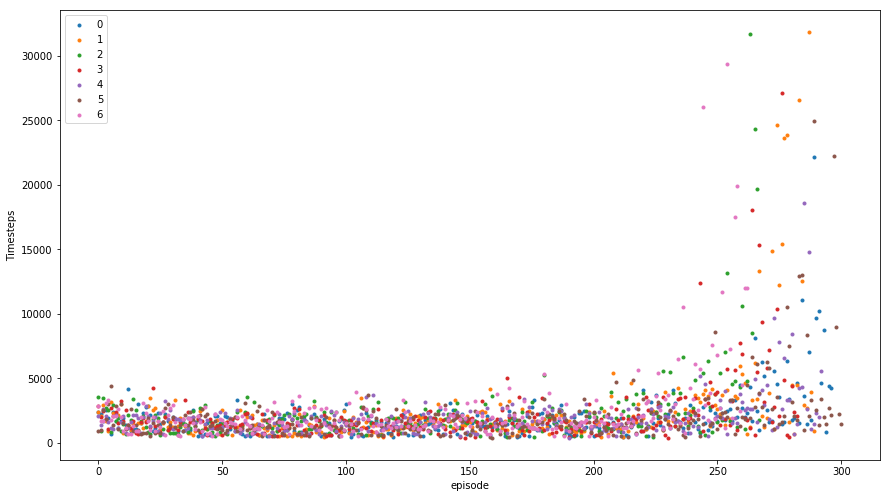

Success Scatter Plot


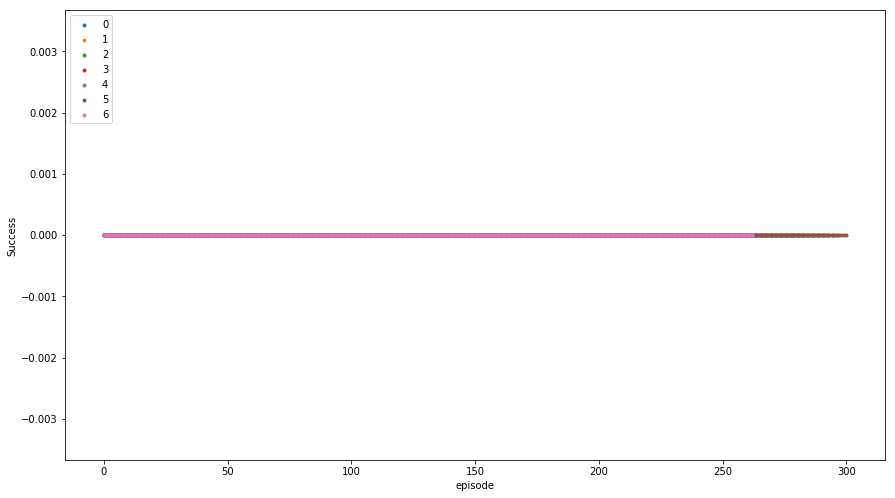

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


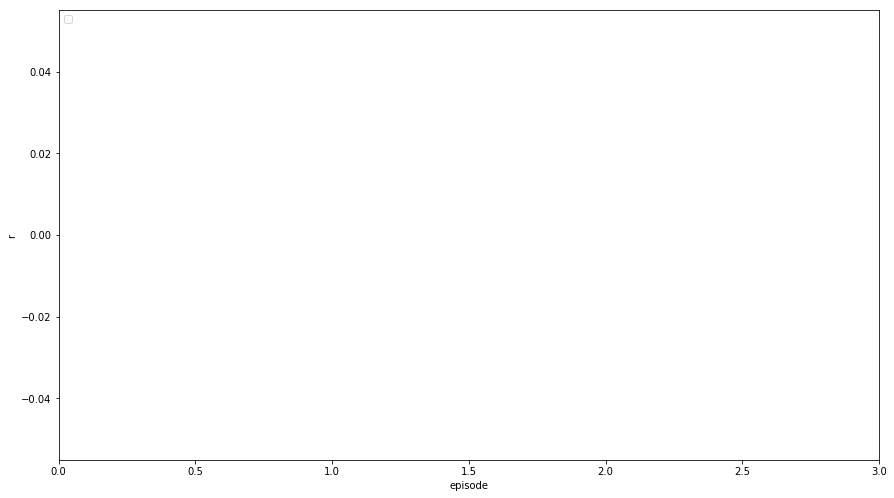

Rolling Plot l


No handles with labels found to put in legend.


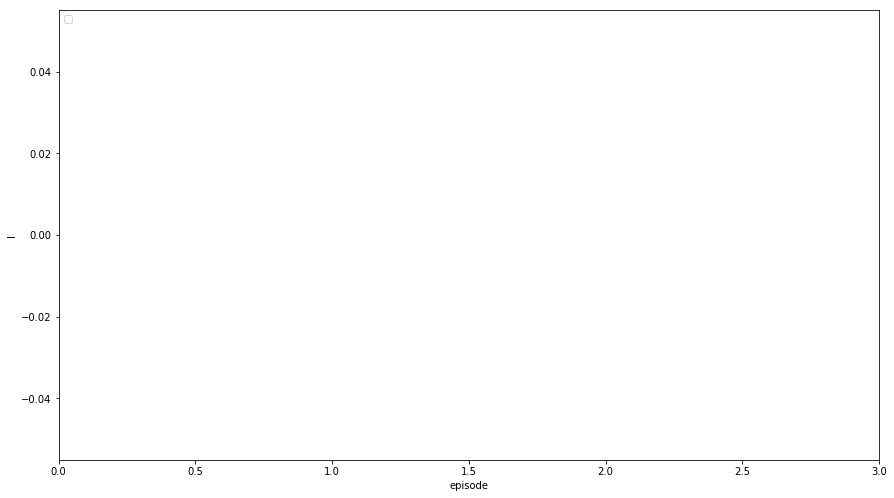

Rolling Plot success


No handles with labels found to put in legend.


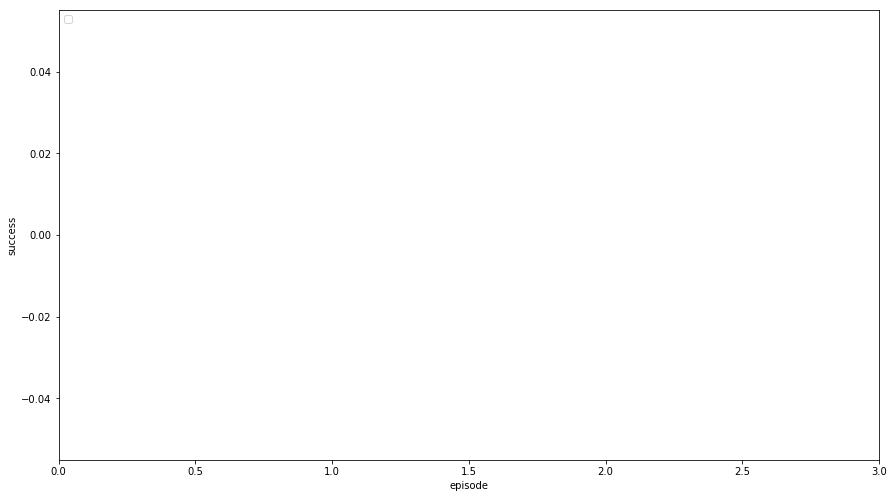

Rolling Plot sc_per_d


No handles with labels found to put in legend.


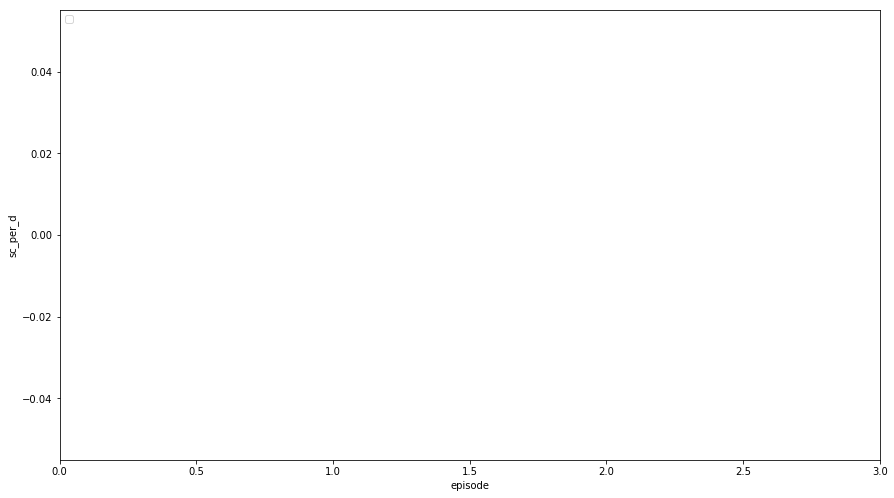

Reward Scatter Plot


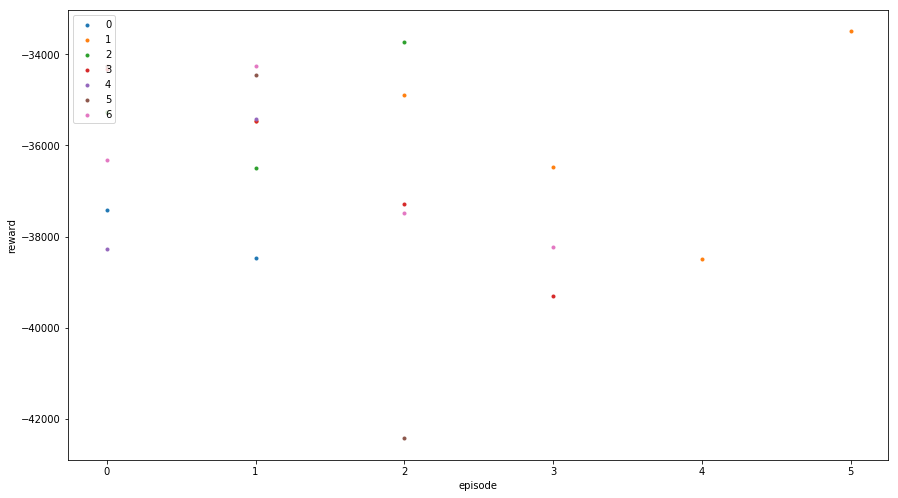

Timesteps Scatter Plot


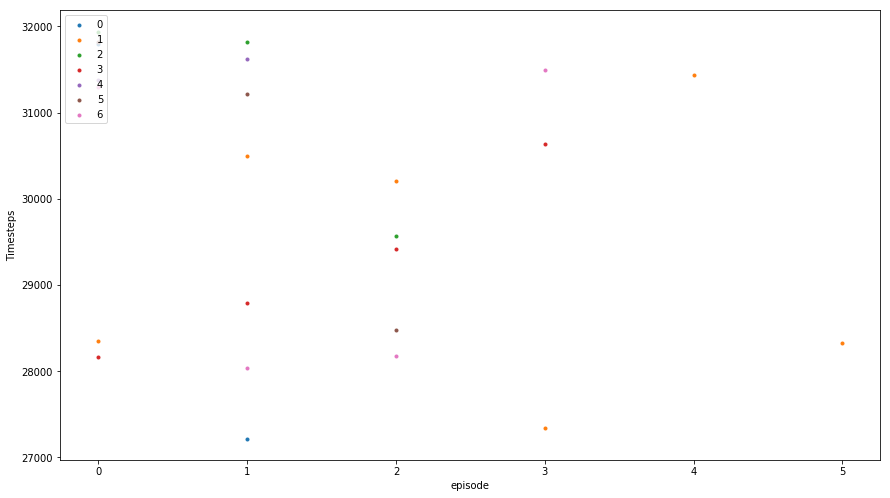

Success Scatter Plot


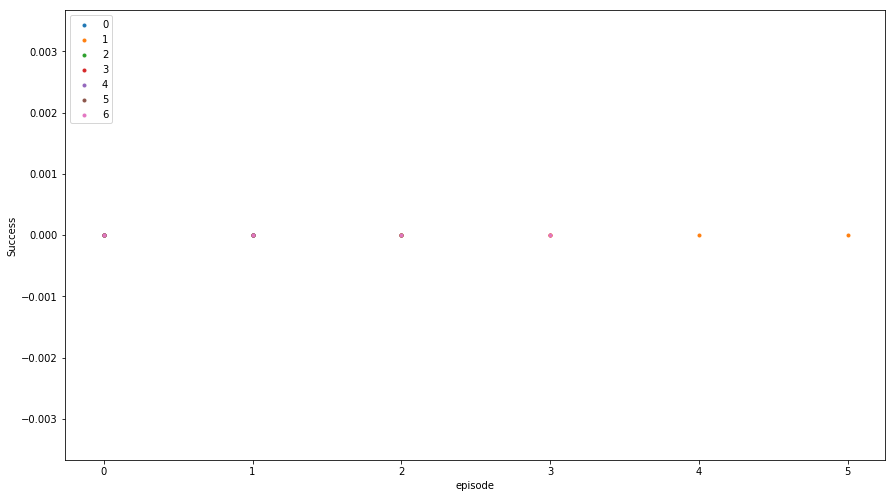

Doing rolling comparison for df mod 2
Rolling Plot r


No handles with labels found to put in legend.


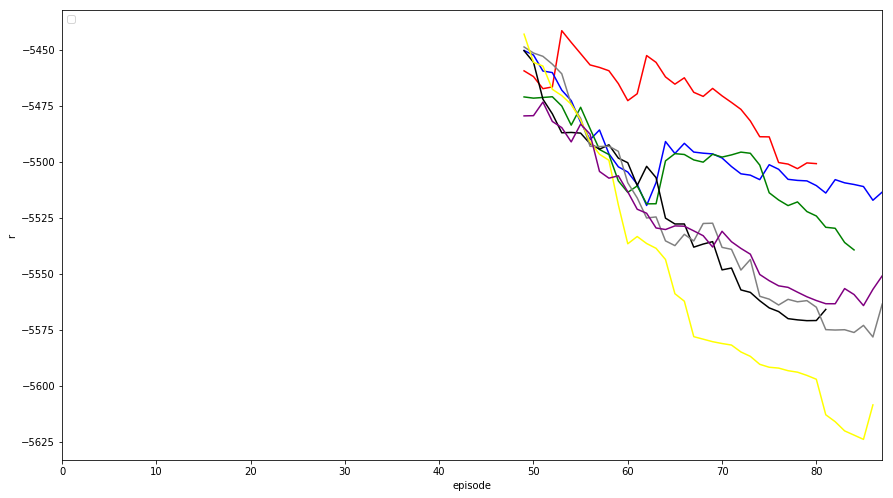

Rolling Plot l


No handles with labels found to put in legend.


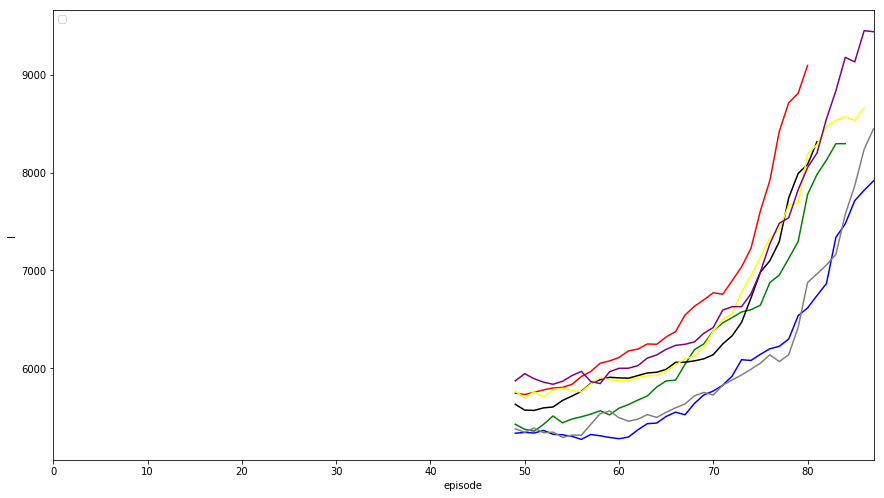

Rolling Plot success


No handles with labels found to put in legend.


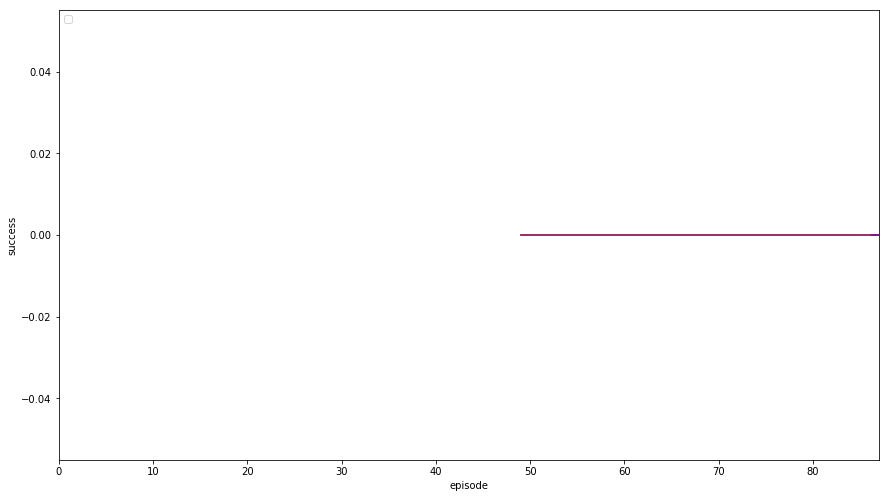

Rolling Plot sc_per_d


No handles with labels found to put in legend.


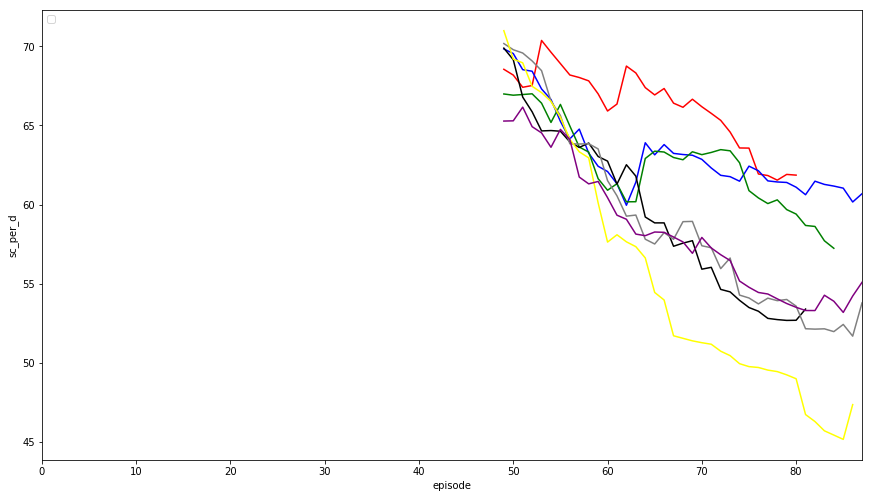

Reward Scatter Plot


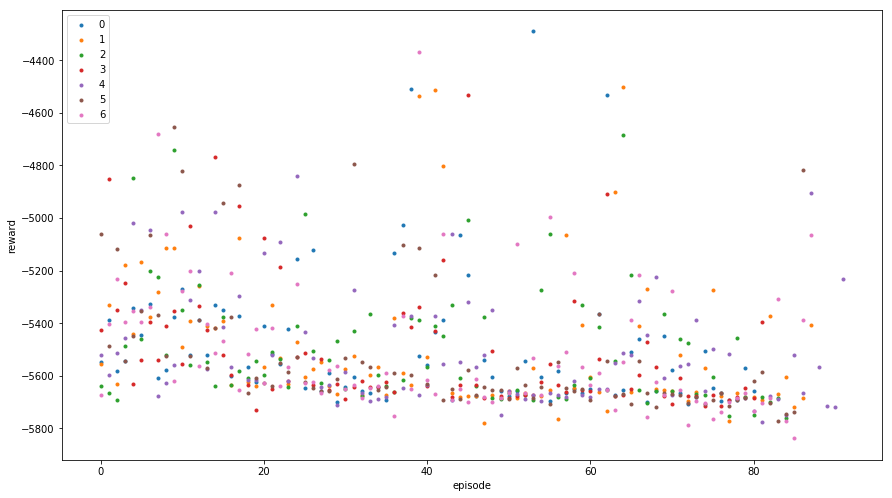

Timesteps Scatter Plot


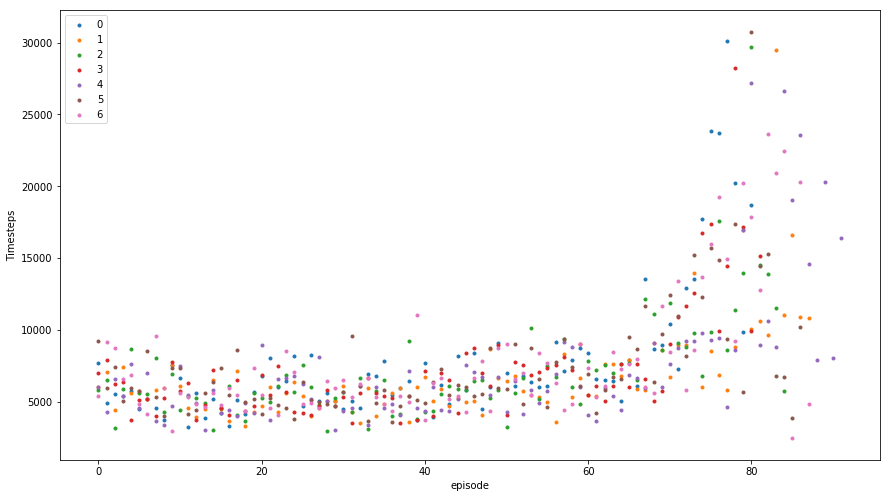

Success Scatter Plot


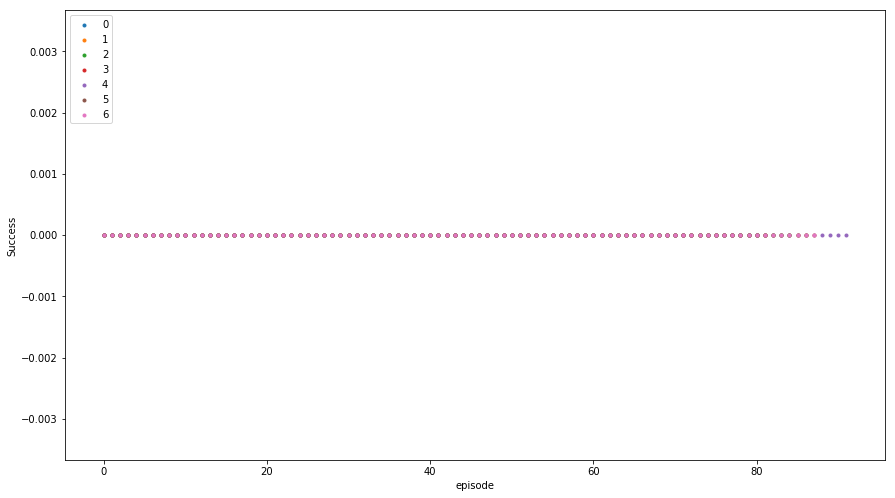

In [4]:
#test run 16
#/home/jim/projects/contra/logs/log_1542641711_17.monitor.csv

get_results(time_id=1542641711,base_dir='logs',df_mod=3)

logs/log_1542561239_0.monitor.csv
logs/log_1542561239_1.monitor.csv
logs/log_1542561239_2.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542561239_3.monitor.csv
logs/log_1542561239_4.monitor.csv
logs/log_1542561239_5.monitor.csv
logs/log_1542561239_6.monitor.csv
logs/log_1542561239_7.monitor.csv
logs/log_1542561239_8.monitor.csv
logs/log_1542561239_9.monitor.csv
logs/log_1542561239_10.monitor.csv
logs/log_1542561239_11.monitor.csv
logs/log_1542561239_12.monitor.csv
logs/log_1542561239_13.monitor.csv
logs/log_1542561239_14.monitor.csv
logs/log_1542561239_15.monitor.csv
logs/log_1542561239_16.monitor.csv
logs/log_1542561239_17.monitor.csv
logs/log_1542561239_18.monitor.csv
logs/log_1542561239_19.monitor.csv
logs/log_1542561239_20.monitor.csv
Mean Reward last 100 Episodes per env: 2406.0104152299996
Mean Reward last 100 Episodes per env: 24438.593774389992
Mean Reward last 100 Episodes per env: 6818.532794410001
Mean Reward last 100 Episodes per env: 2398.63020757
Mean Reward last 100 Episodes per env: 24457.415674549997
Mean Reward last 100 Episodes per env: 6700.072810400002
Mean Reward last 100 Episodes per en

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


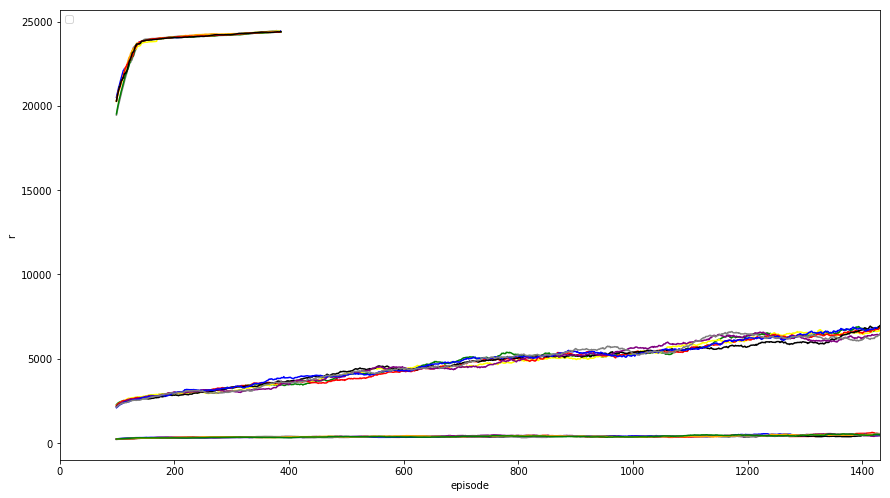

Rolling Plot l


No handles with labels found to put in legend.


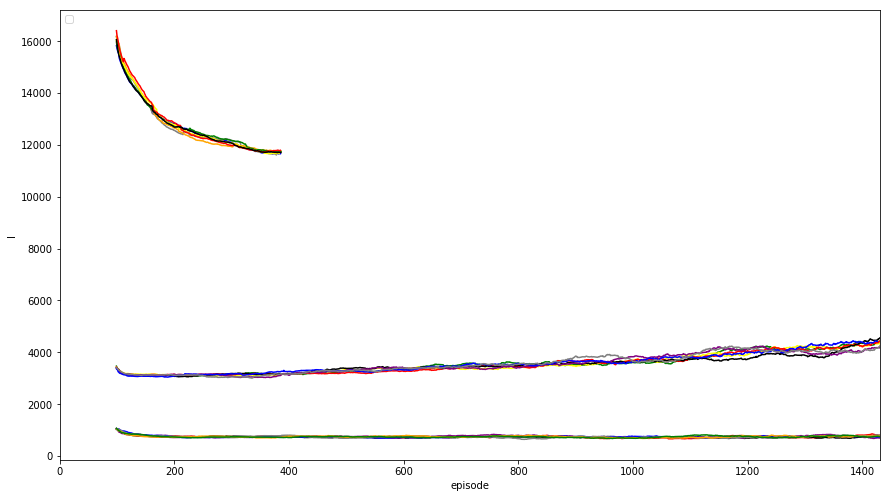

Rolling Plot success


No handles with labels found to put in legend.


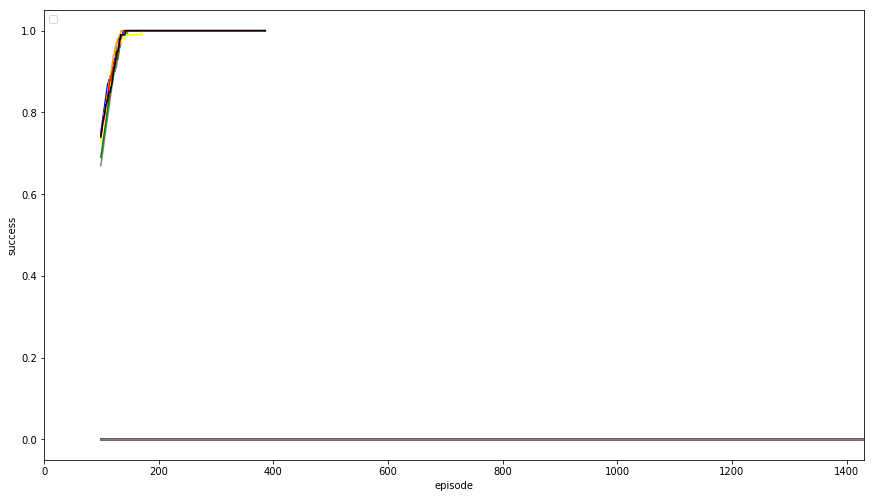

Rolling Plot sc_per_d


No handles with labels found to put in legend.


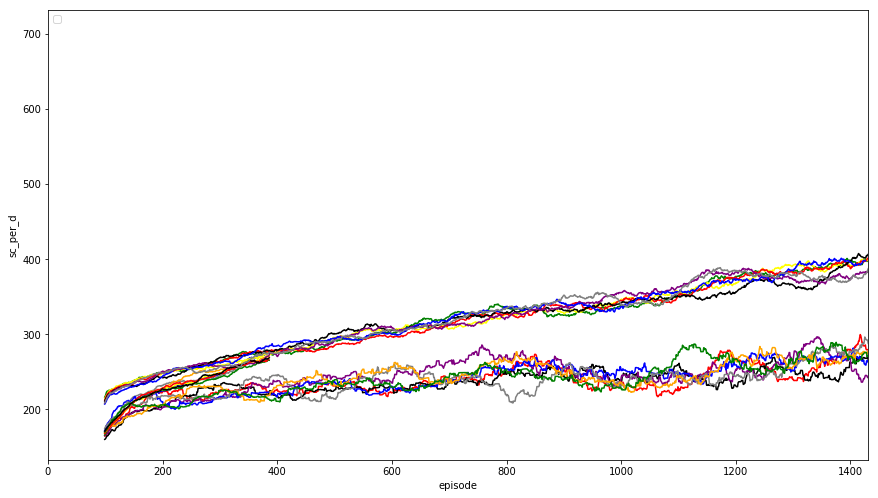

Reward Scatter Plot


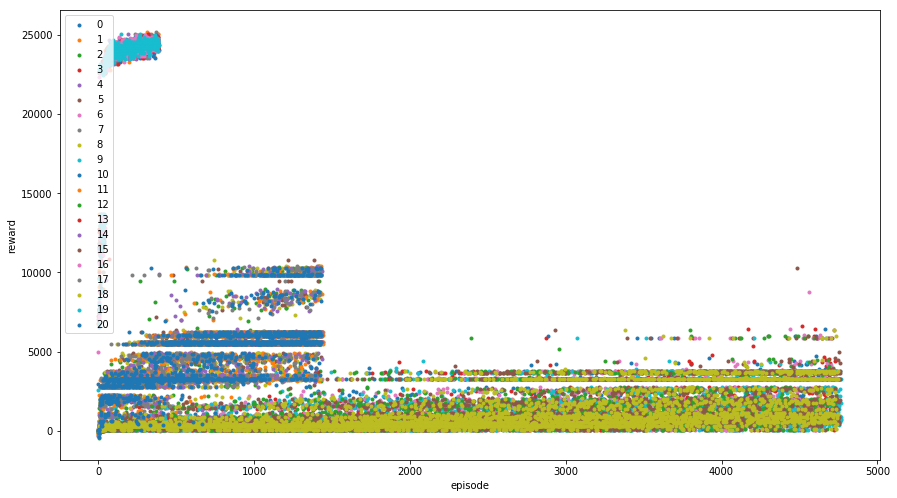

Timesteps Scatter Plot


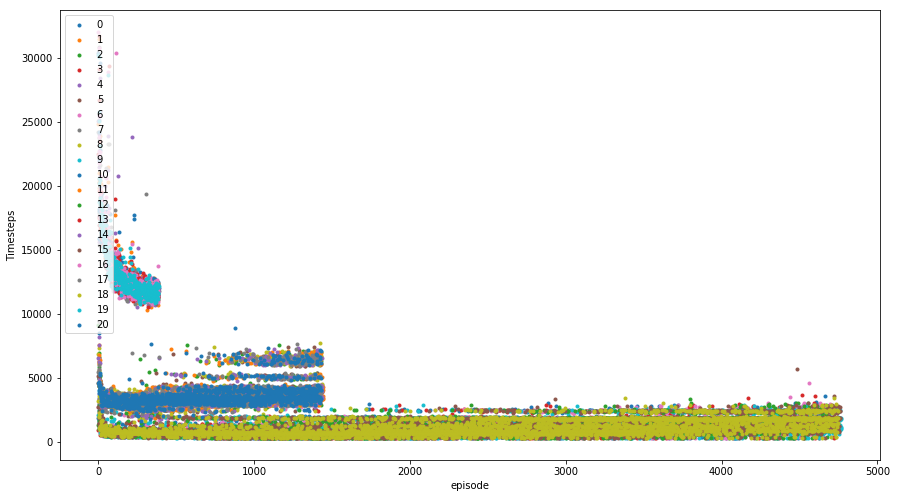

Success Scatter Plot


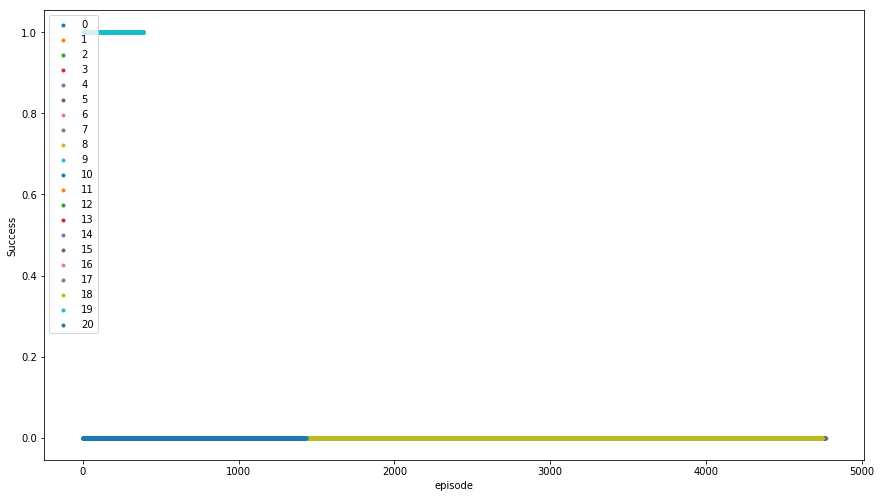

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


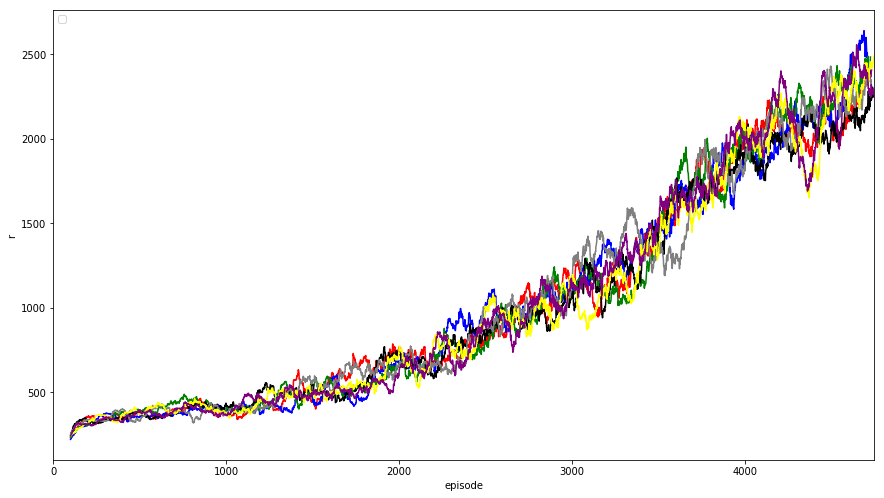

Rolling Plot l


No handles with labels found to put in legend.


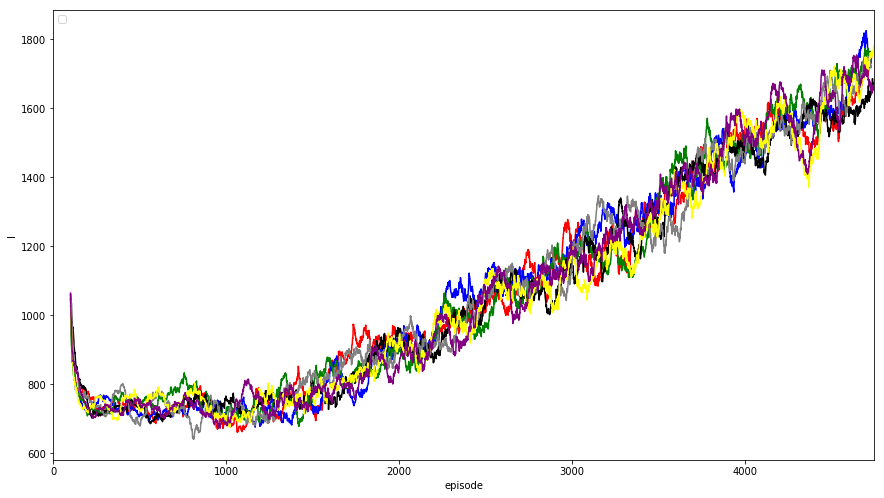

Rolling Plot success


No handles with labels found to put in legend.


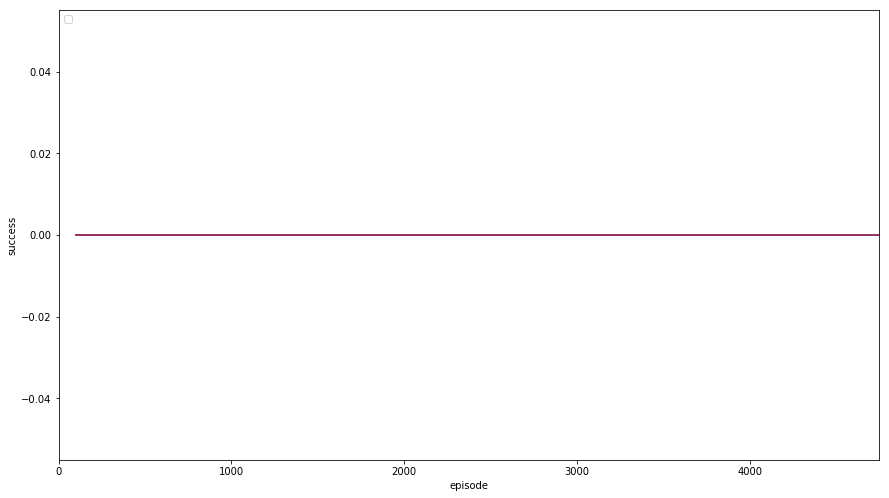

Rolling Plot sc_per_d


No handles with labels found to put in legend.


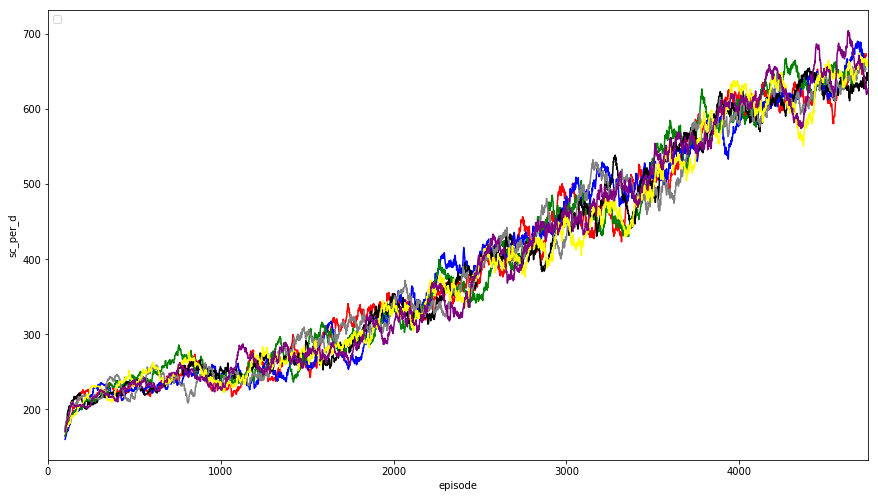

Reward Scatter Plot


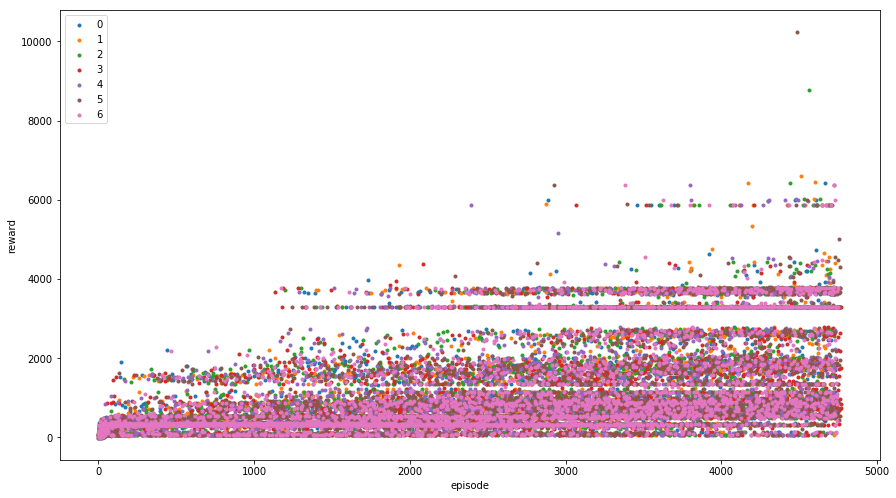

Timesteps Scatter Plot


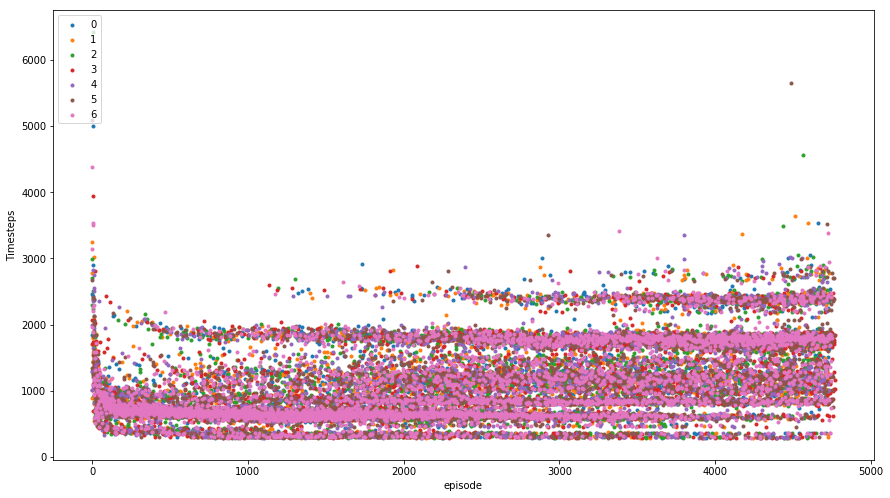

Success Scatter Plot


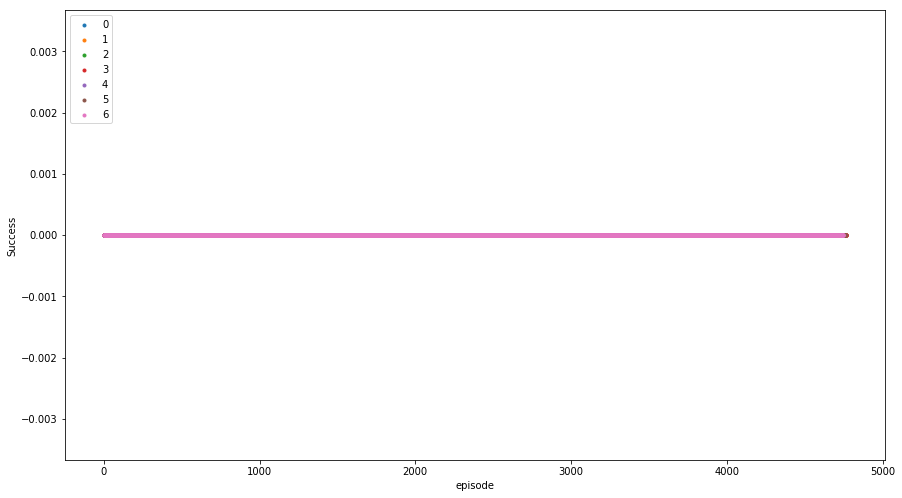

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


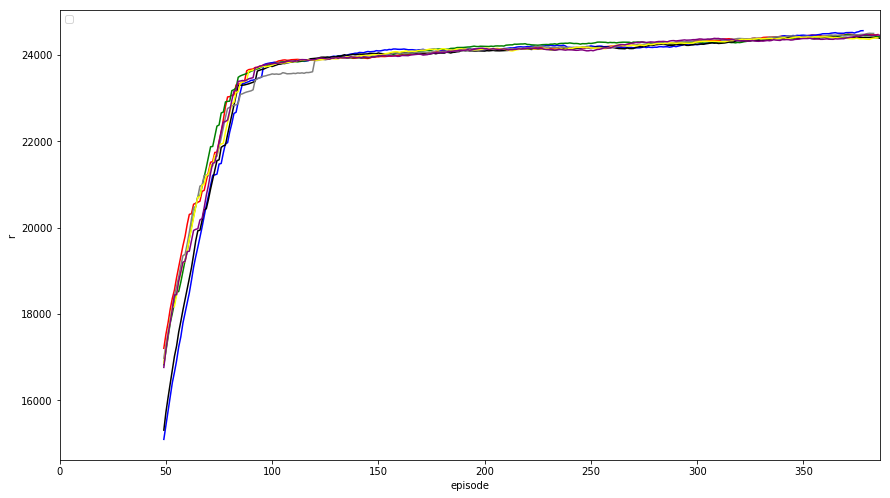

Rolling Plot l


No handles with labels found to put in legend.


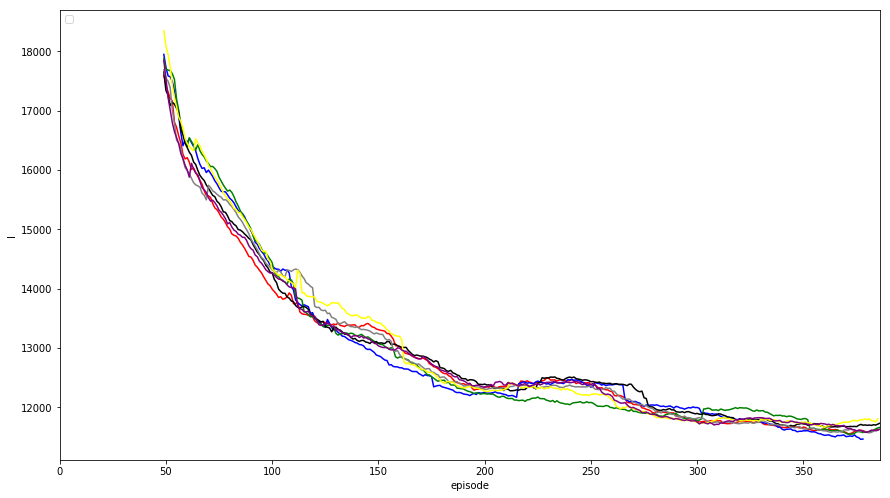

Rolling Plot success


No handles with labels found to put in legend.


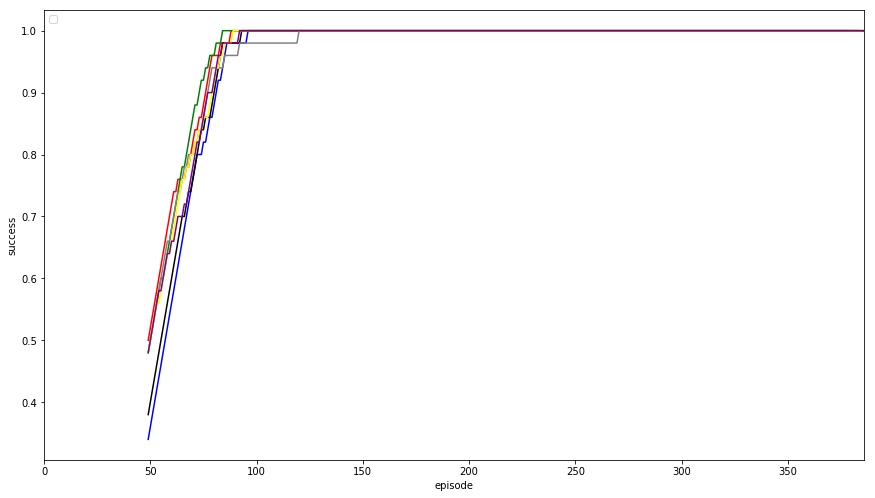

Rolling Plot sc_per_d


No handles with labels found to put in legend.


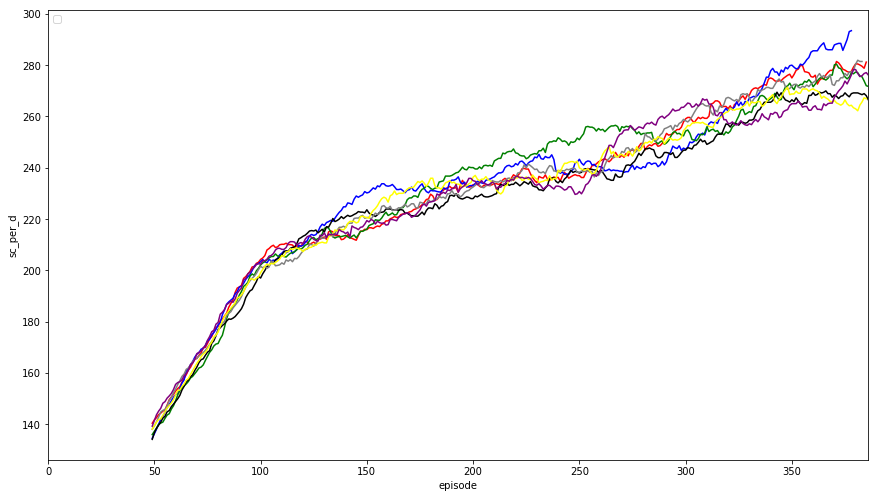

Reward Scatter Plot


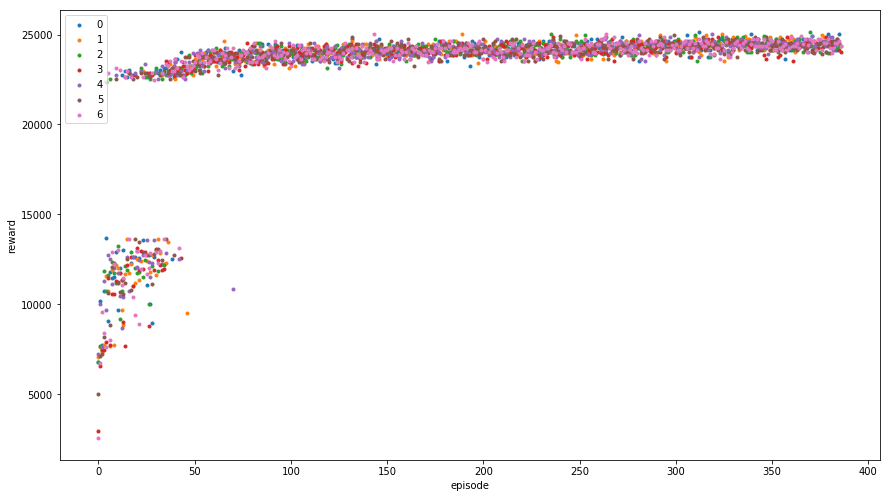

Timesteps Scatter Plot


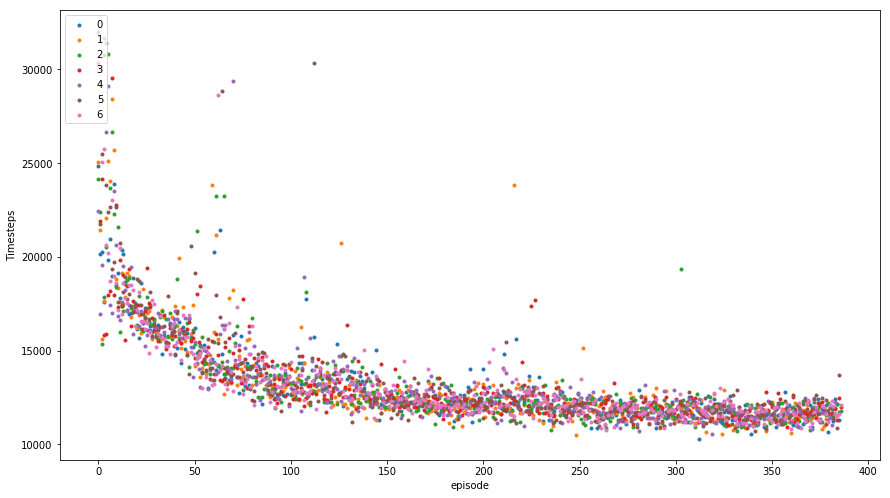

Success Scatter Plot


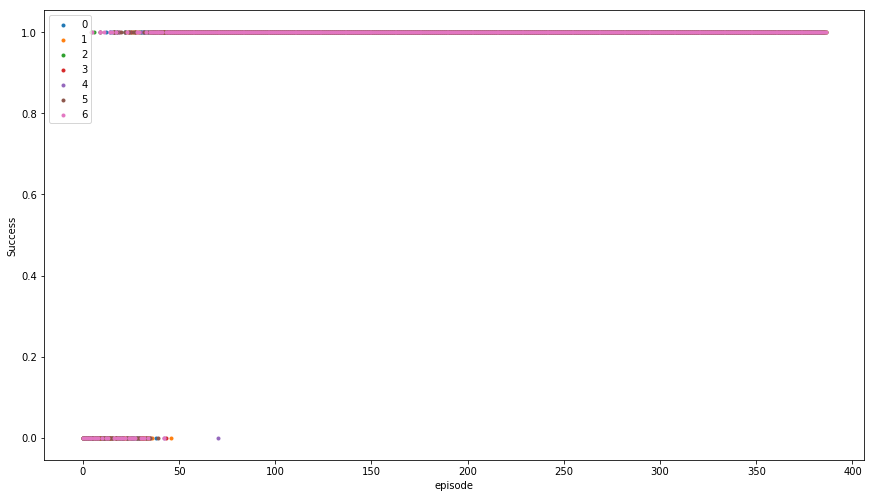

Doing rolling comparison for df mod 2
Rolling Plot r


No handles with labels found to put in legend.


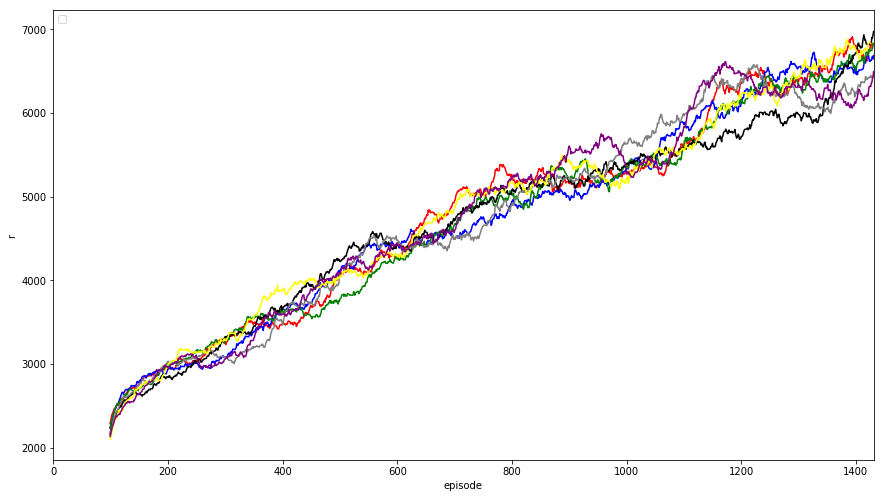

Rolling Plot l


No handles with labels found to put in legend.


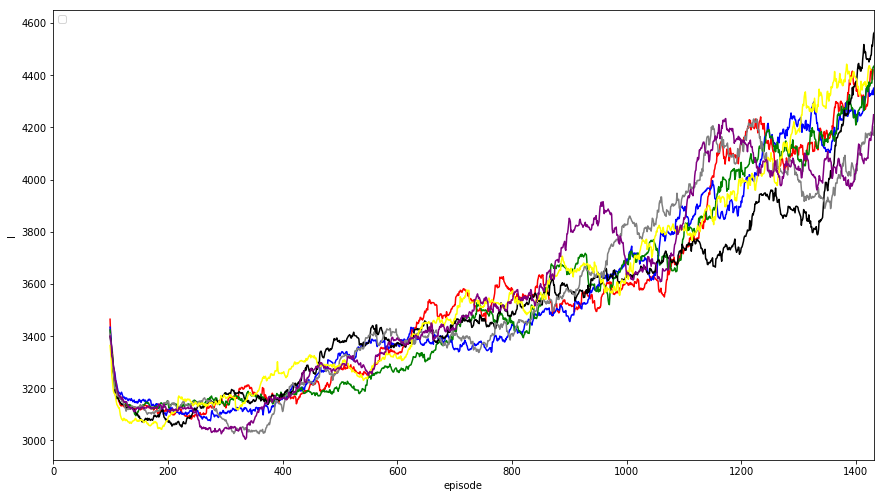

Rolling Plot success


No handles with labels found to put in legend.


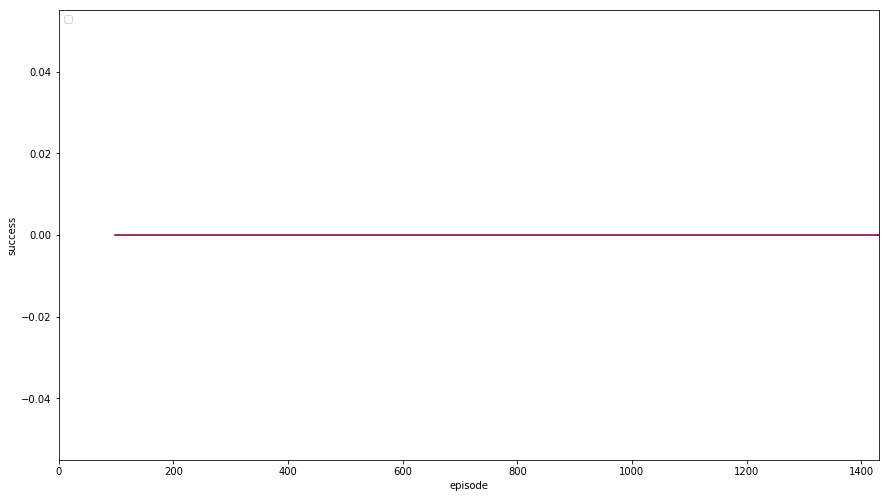

Rolling Plot sc_per_d


No handles with labels found to put in legend.


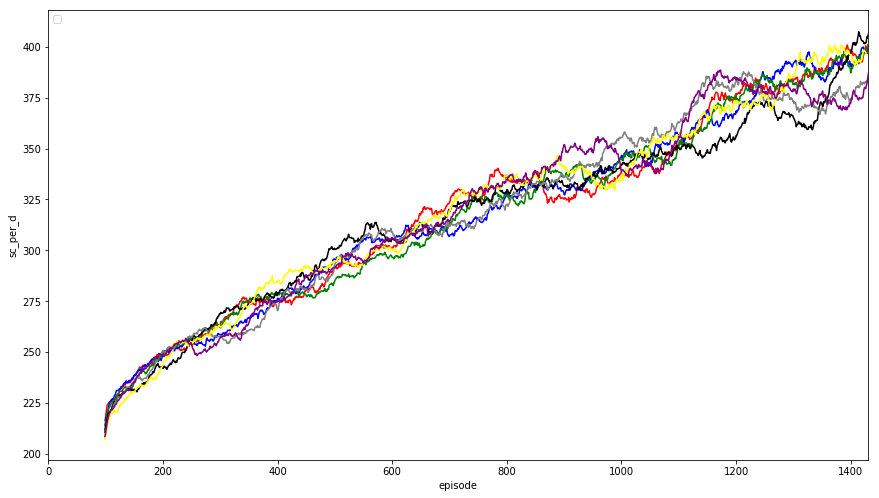

Reward Scatter Plot


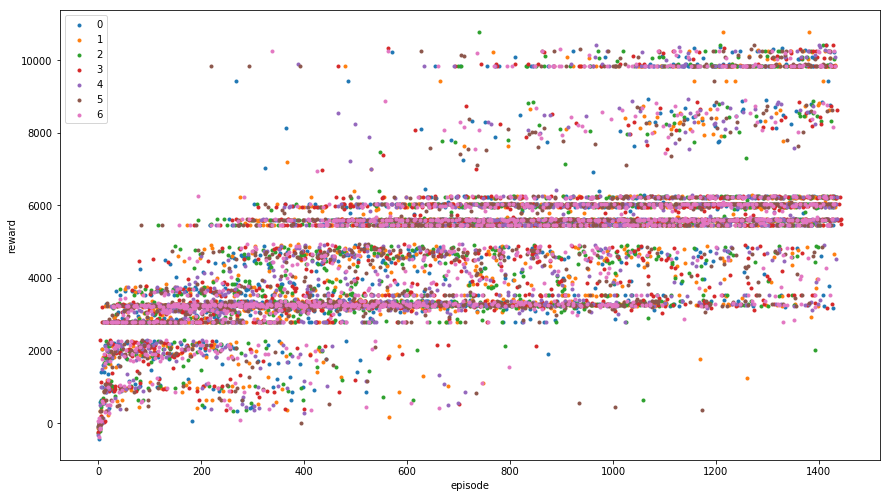

Timesteps Scatter Plot


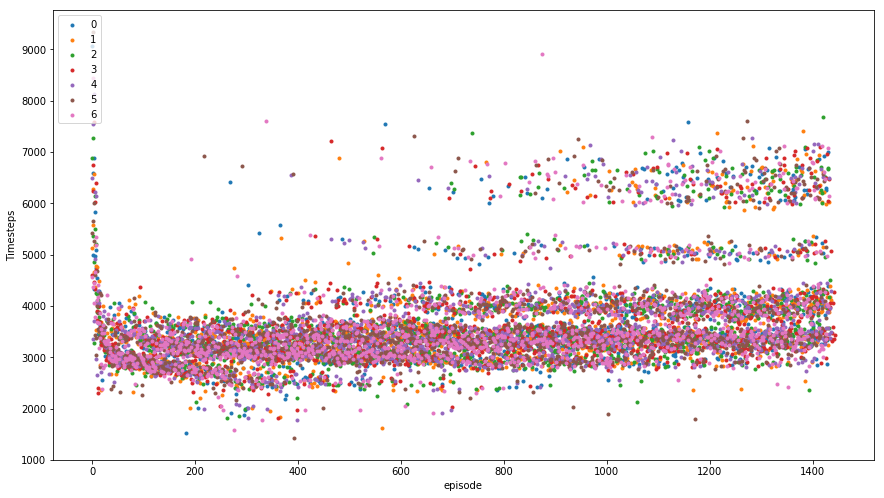

Success Scatter Plot


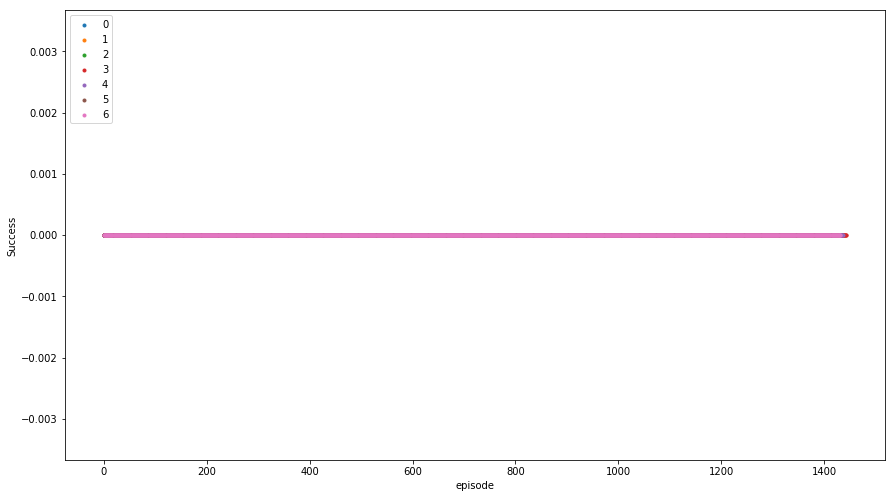

In [5]:
#test run 15
#/home/jim/projects/contra/logs/log_1542561239_6.monitor.csv
get_results(time_id=1542561239,base_dir='logs',df_mod=3)

logs/log_1542495791_0.monitor.csv
logs/log_1542495791_1.monitor.csv
logs/log_1542495791_2.monitor.csv
logs/log_1542495791_3.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542495791_4.monitor.csv
logs/log_1542495791_5.monitor.csv
logs/log_1542495791_6.monitor.csv
logs/log_1542495791_7.monitor.csv
logs/log_1542495791_8.monitor.csv
logs/log_1542495791_9.monitor.csv
logs/log_1542495791_10.monitor.csv
logs/log_1542495791_11.monitor.csv
logs/log_1542495791_12.monitor.csv
logs/log_1542495791_13.monitor.csv
logs/log_1542495791_14.monitor.csv
logs/log_1542495791_15.monitor.csv
logs/log_1542495791_16.monitor.csv
logs/log_1542495791_17.monitor.csv
logs/log_1542495791_18.monitor.csv
logs/log_1542495791_19.monitor.csv
logs/log_1542495791_20.monitor.csv
Mean Reward last 100 Episodes per env: -72.33997433
Mean Reward last 100 Episodes per env: 14418.458011061857
Mean Reward last 100 Episodes per env: -19.449881389999994
Mean Reward last 100 Episodes per env: -71.83997383
Mean Reward last 100 Episodes per env: 14158.947783822916
Mean Reward last 100 Episodes per env: -24.219886159999987
Mean Reward last 100 Episodes per env: -73.21997520999999
Mean Reward las

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


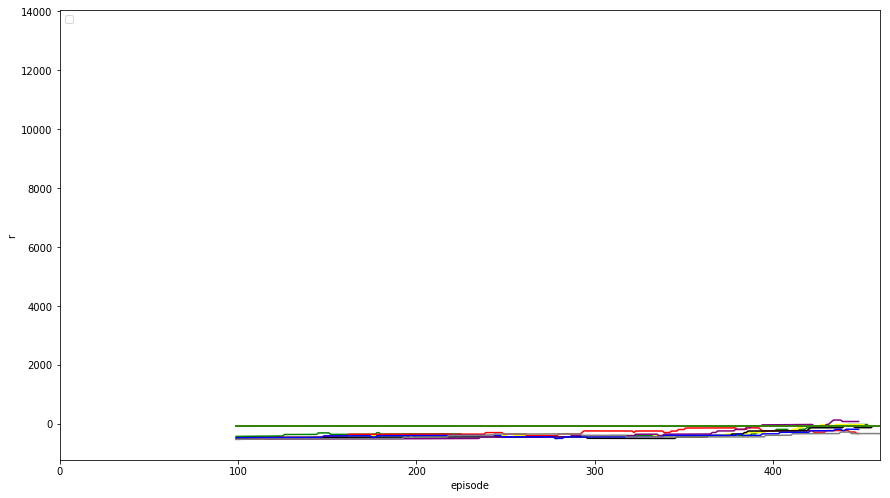

Rolling Plot l


No handles with labels found to put in legend.


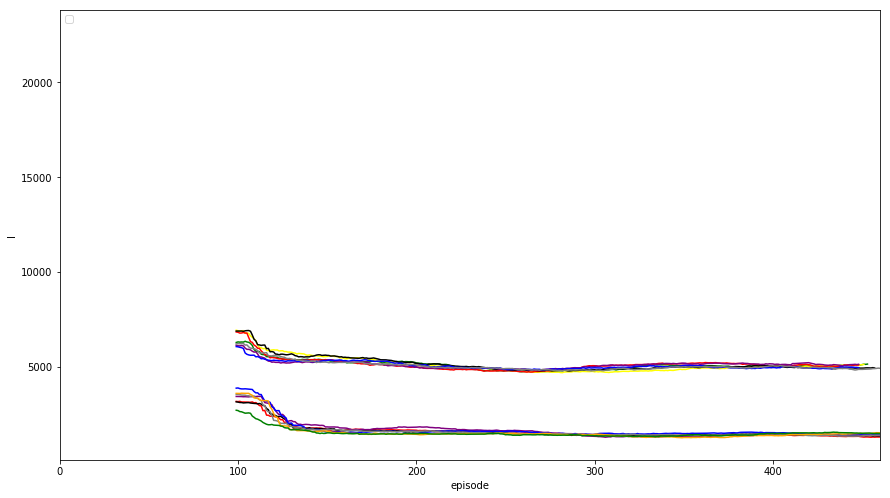

Rolling Plot success


No handles with labels found to put in legend.


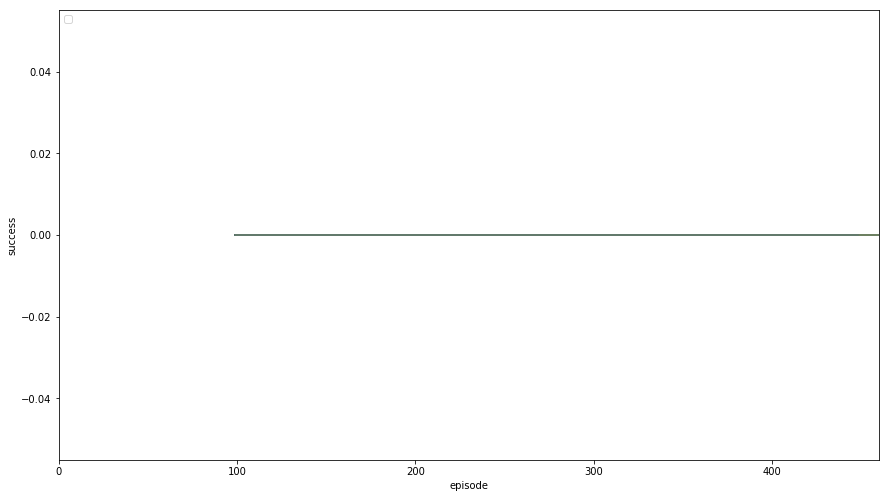

Rolling Plot sc_per_d


No handles with labels found to put in legend.


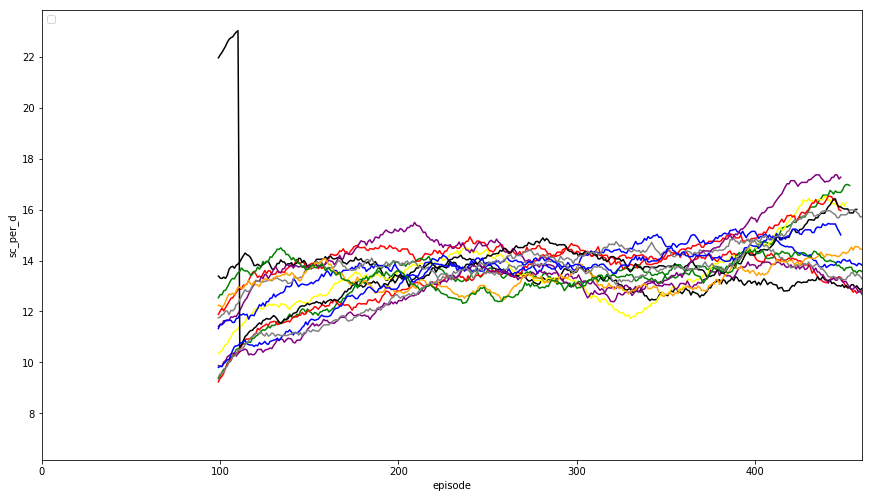

Reward Scatter Plot


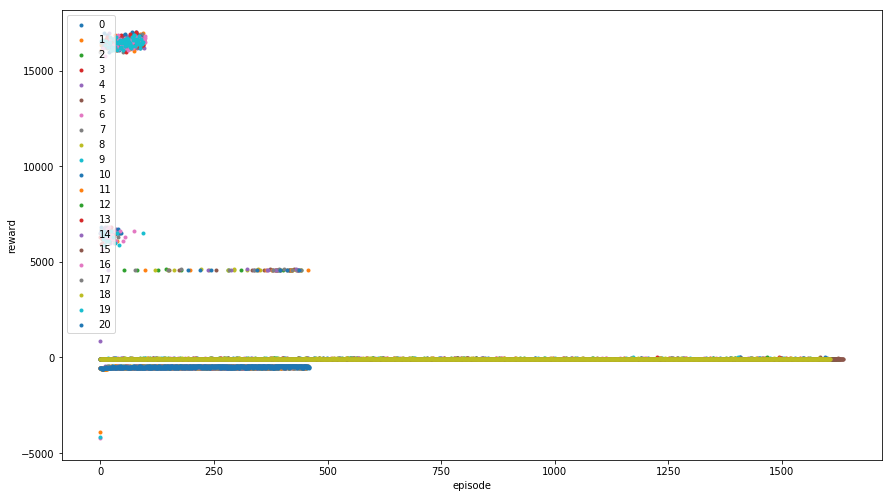

Timesteps Scatter Plot


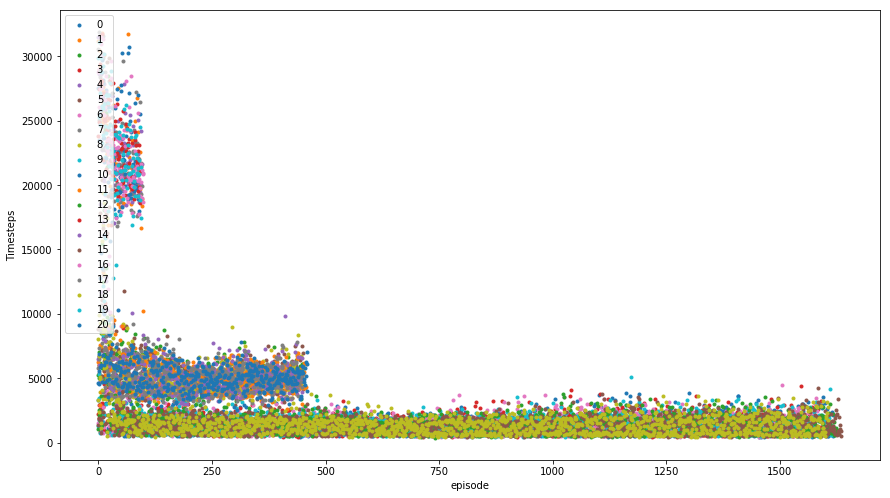

Success Scatter Plot


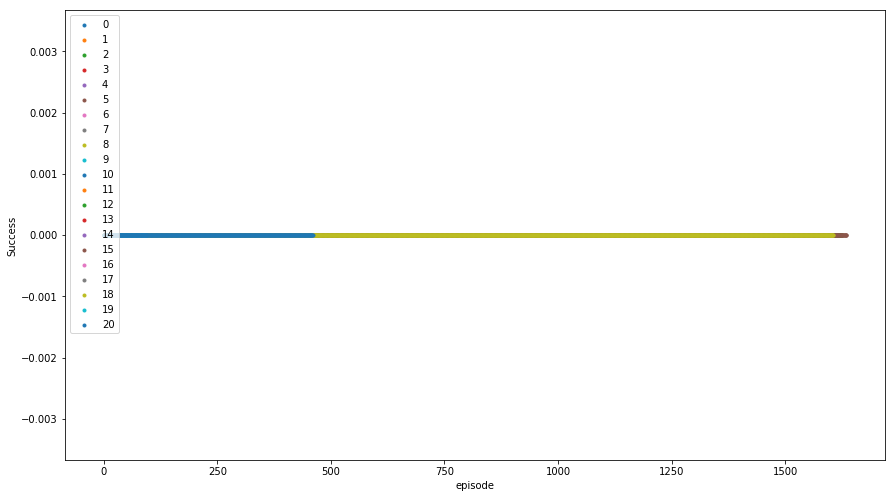

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


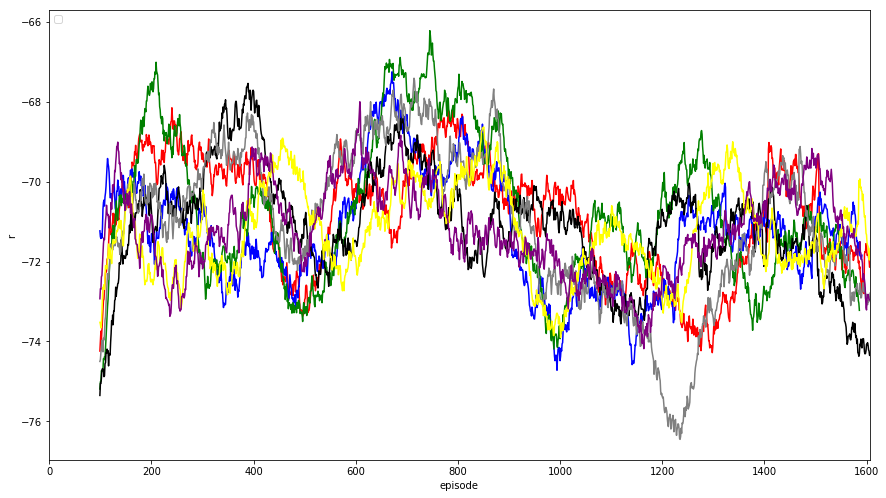

Rolling Plot l


No handles with labels found to put in legend.


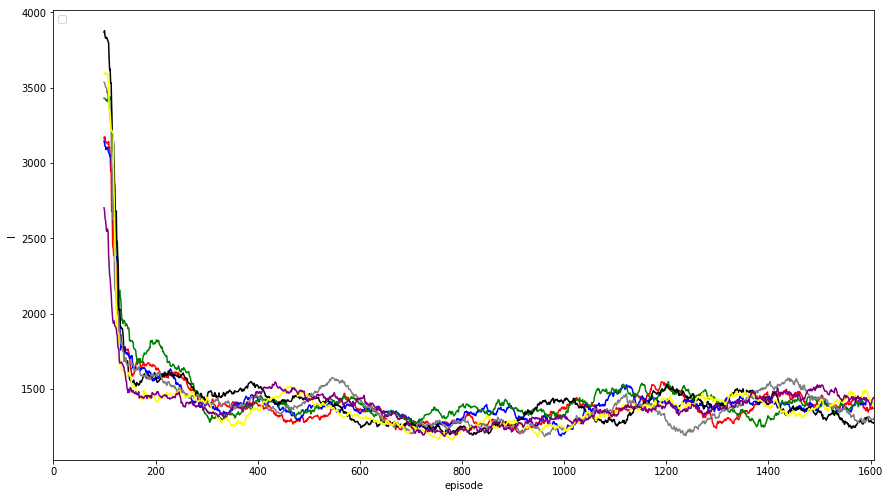

Rolling Plot success


No handles with labels found to put in legend.


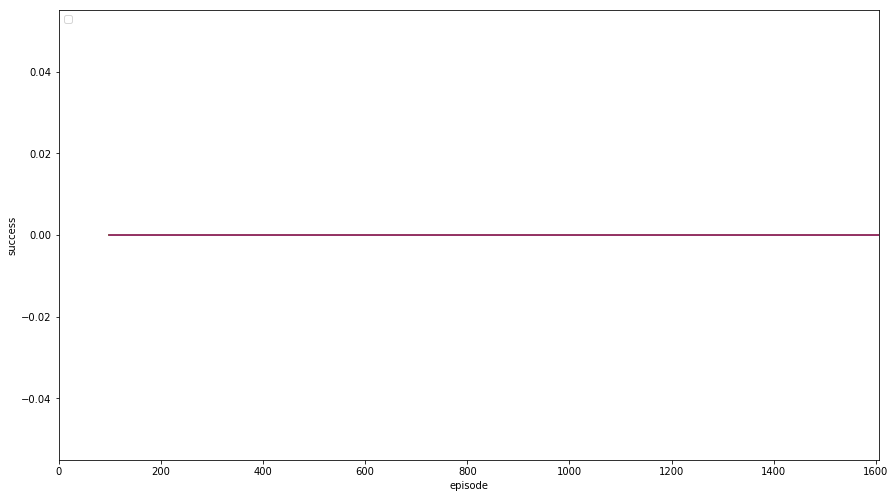

Rolling Plot sc_per_d


No handles with labels found to put in legend.


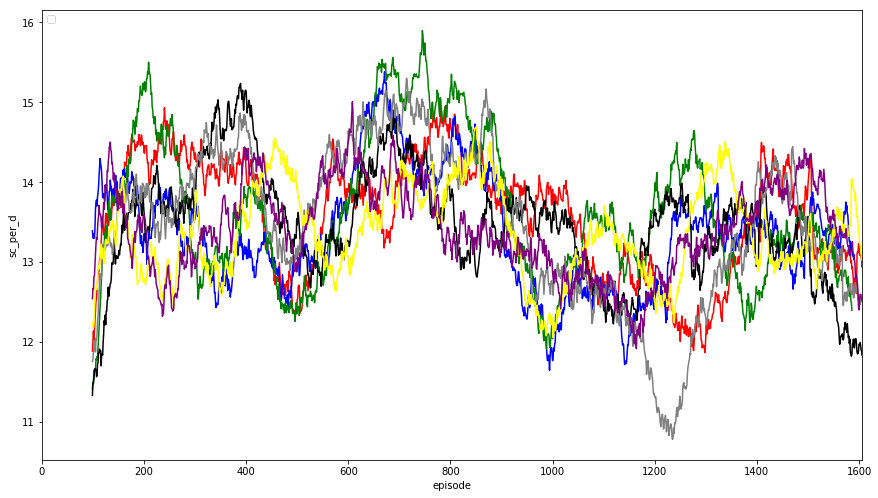

Reward Scatter Plot


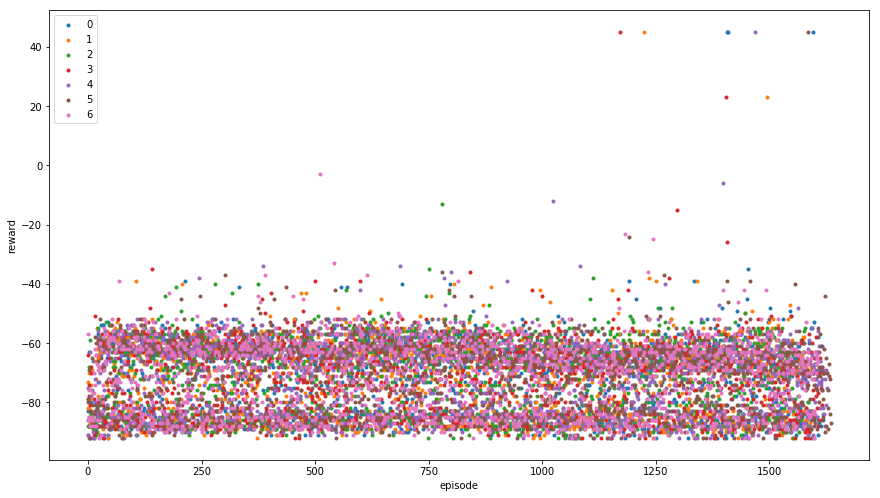

Timesteps Scatter Plot


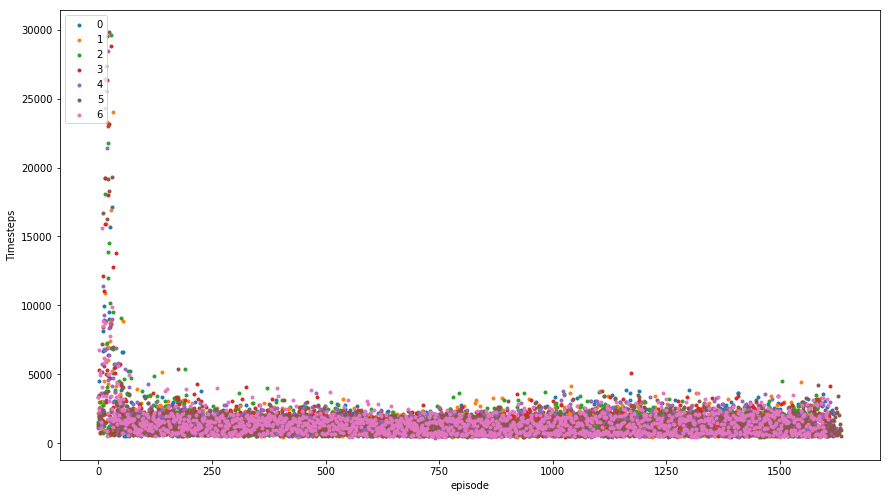

Success Scatter Plot


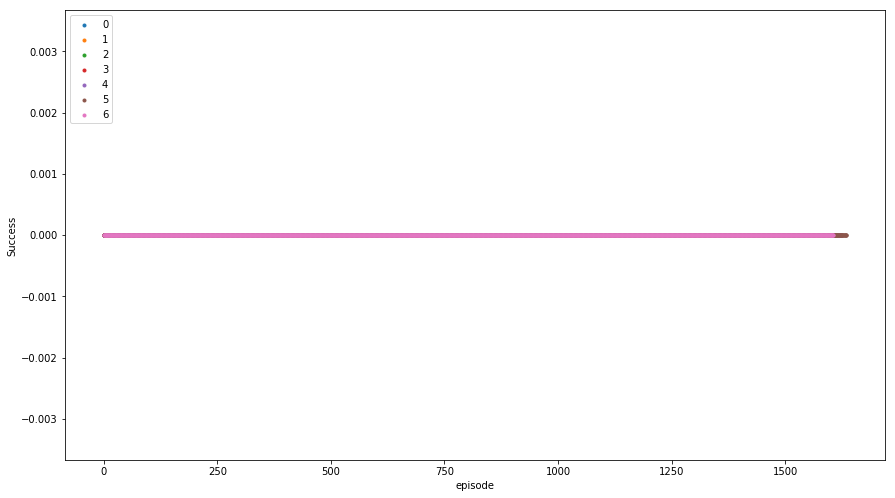

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


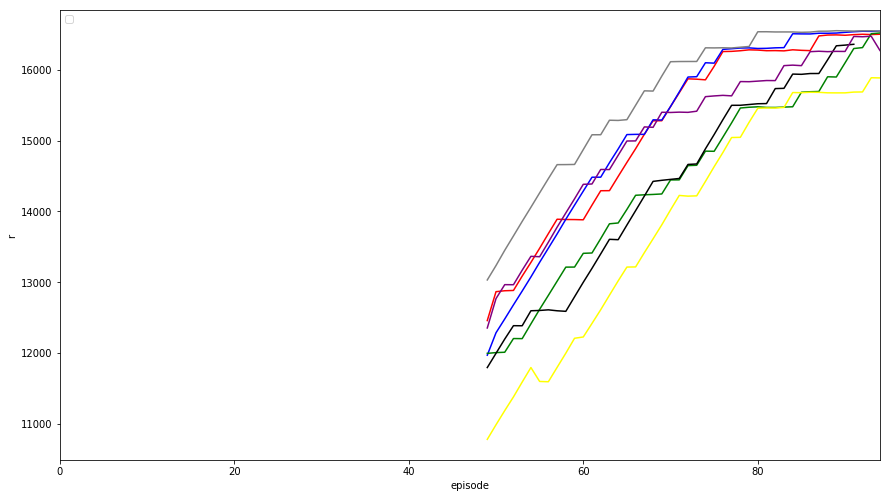

Rolling Plot l


No handles with labels found to put in legend.


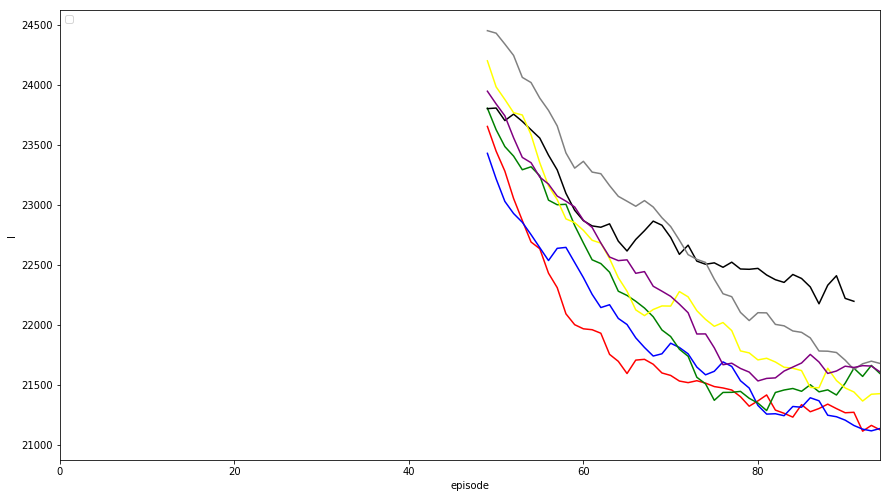

Rolling Plot success


No handles with labels found to put in legend.


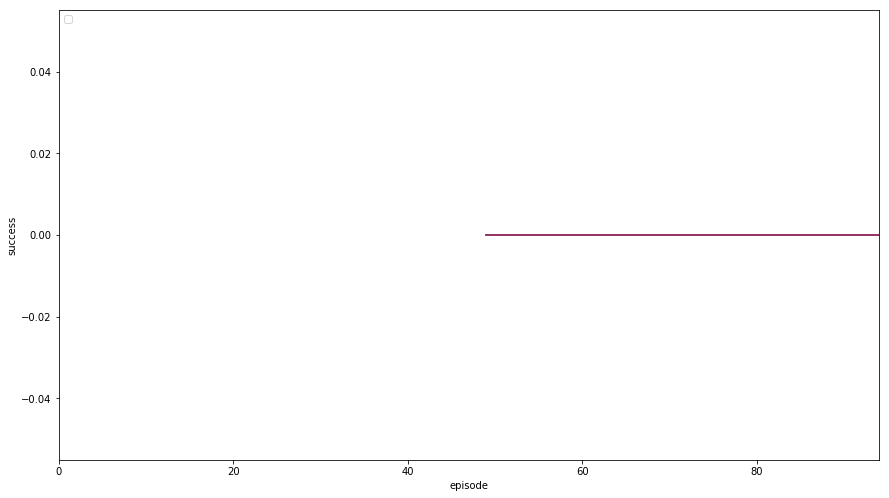

Rolling Plot sc_per_d


No handles with labels found to put in legend.


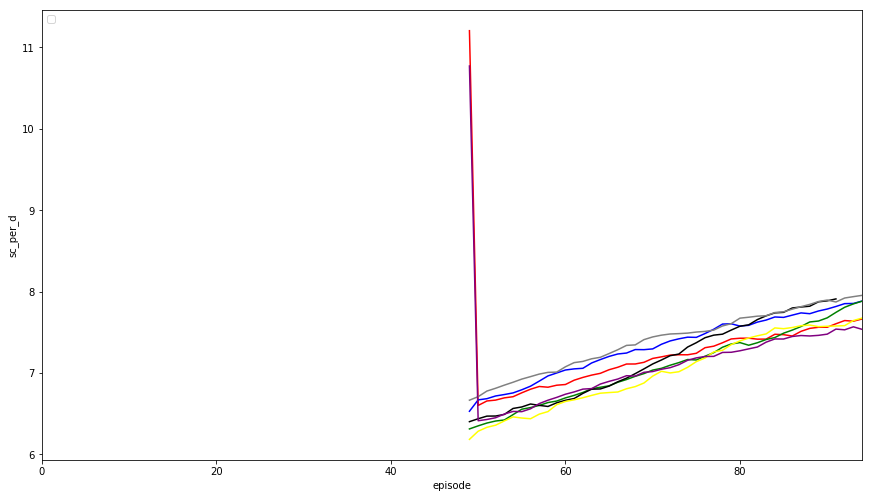

Reward Scatter Plot


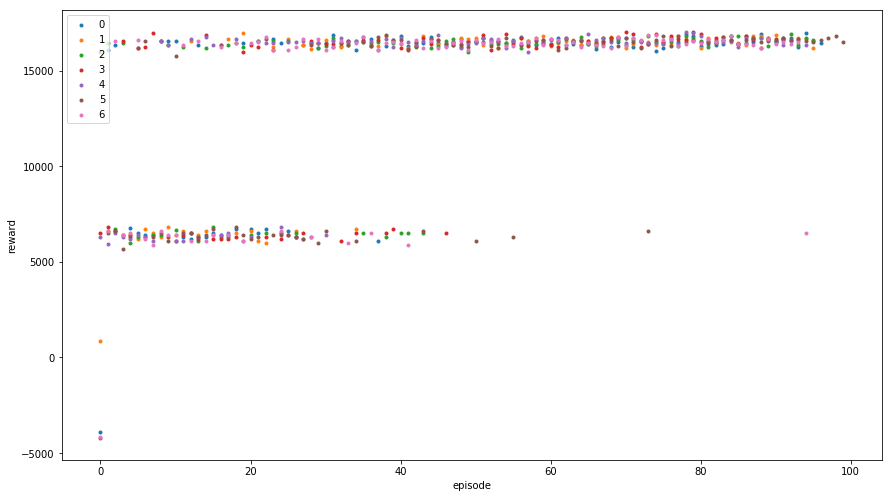

Timesteps Scatter Plot


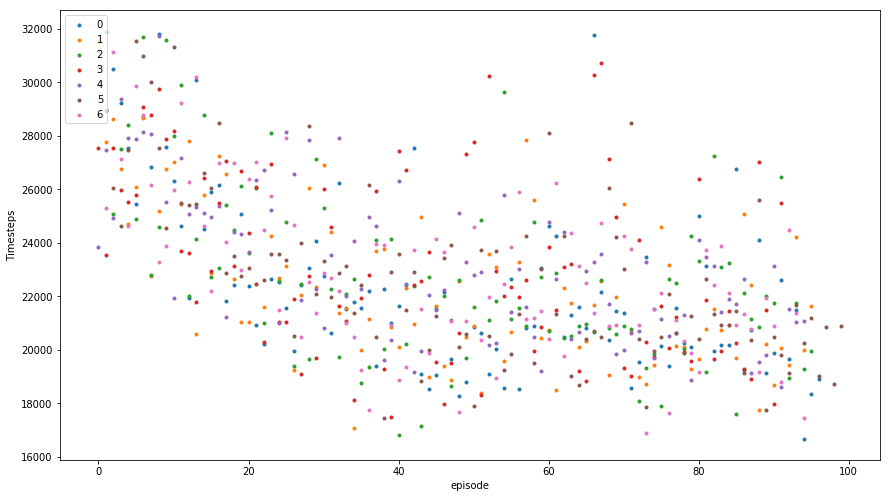

Success Scatter Plot


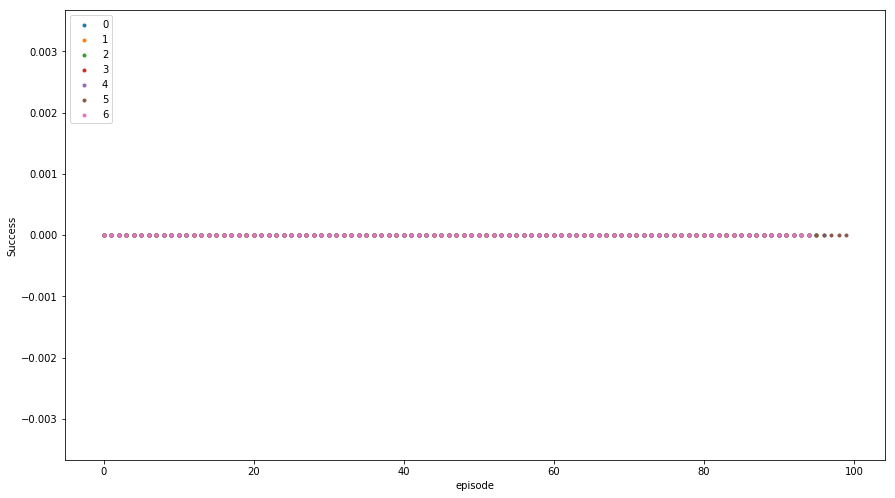

Doing rolling comparison for df mod 2
Rolling Plot r


No handles with labels found to put in legend.


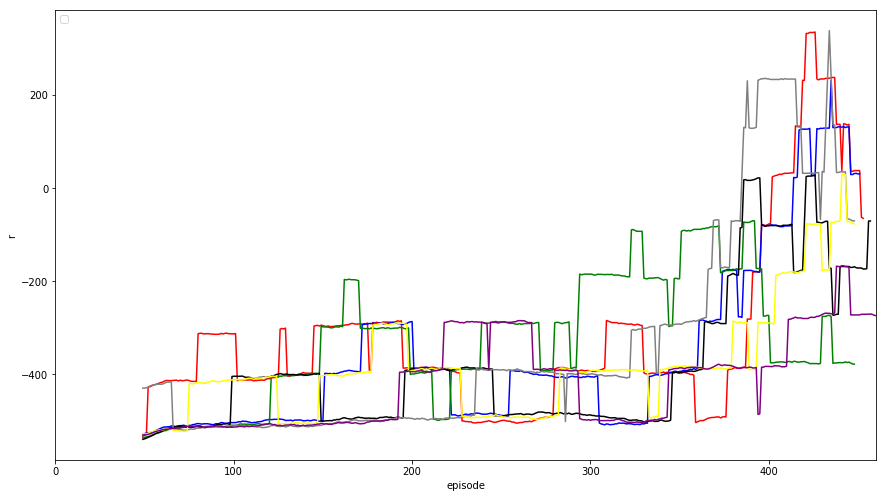

Rolling Plot l


No handles with labels found to put in legend.


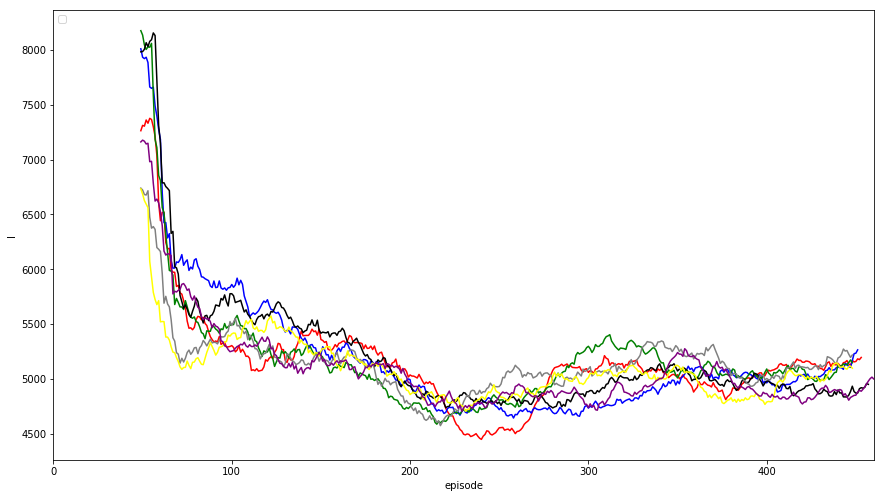

Rolling Plot success


No handles with labels found to put in legend.


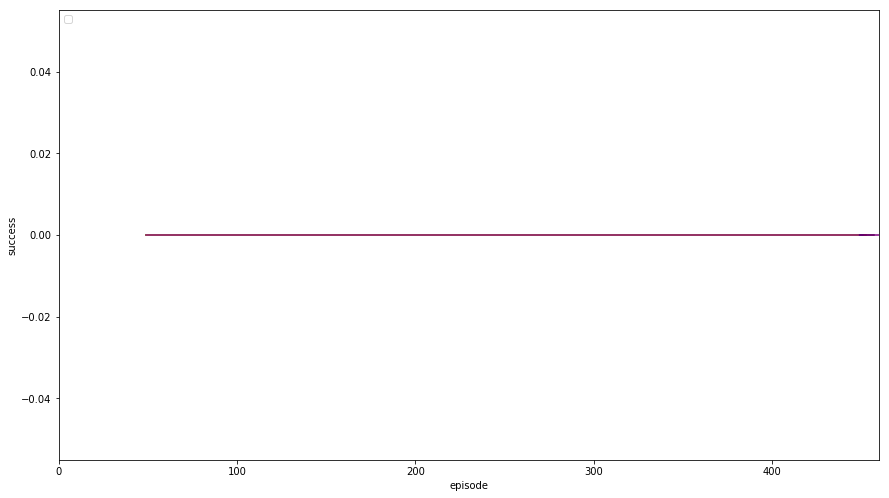

Rolling Plot sc_per_d


No handles with labels found to put in legend.


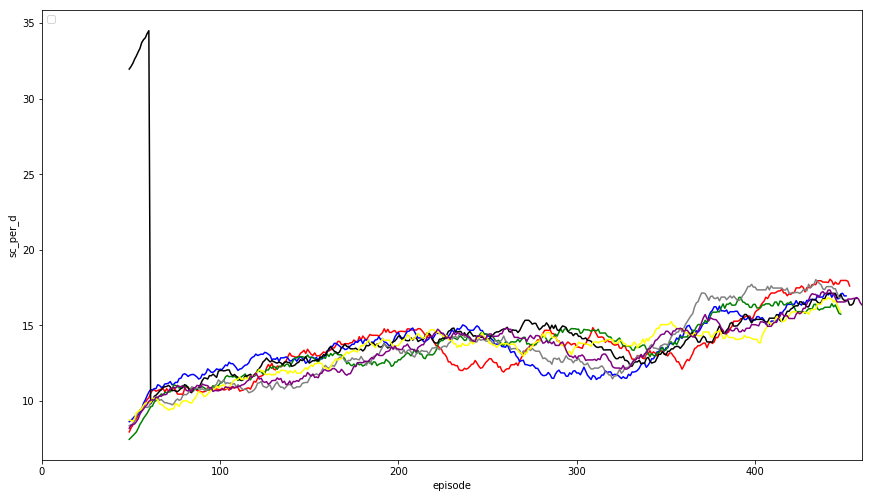

Reward Scatter Plot


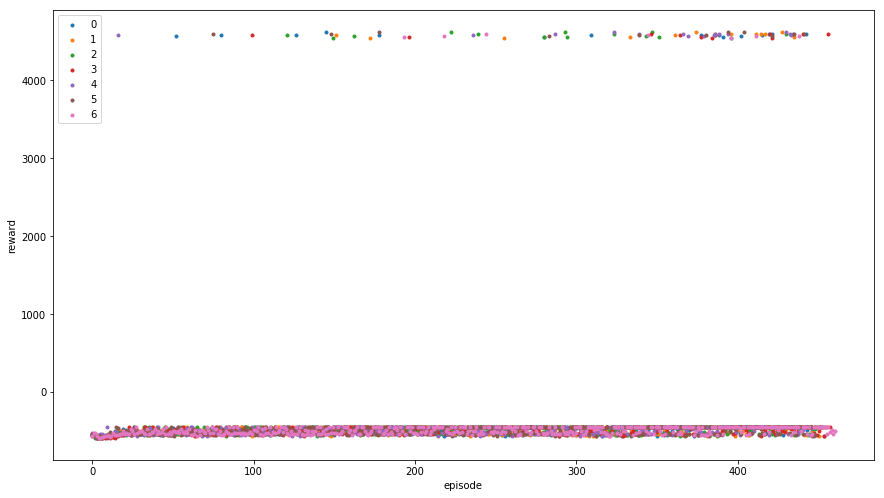

Timesteps Scatter Plot


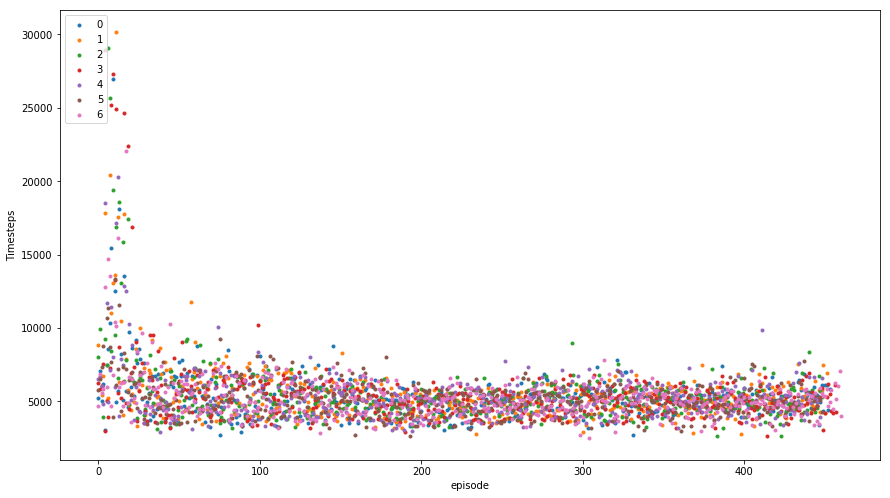

Success Scatter Plot


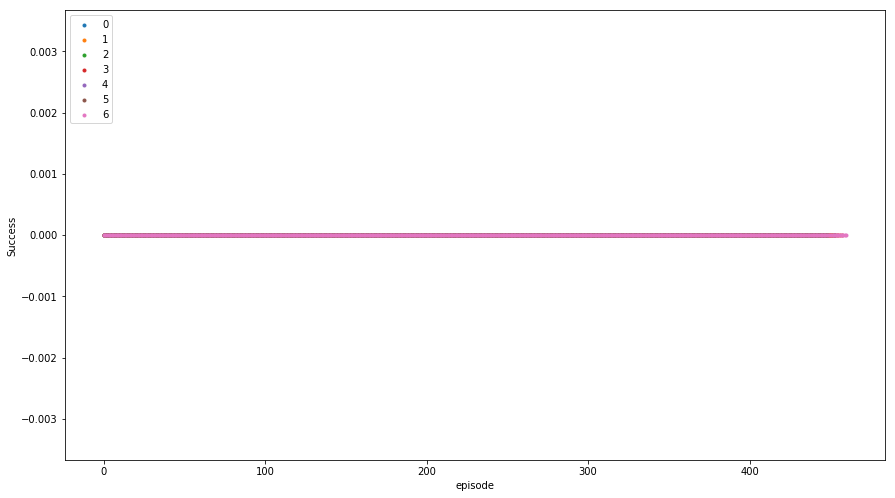

In [5]:
#test run 13
#/home/jim/projects/contra/logs/log_1542495791_9.monitor.csv
get_results(time_id=1542495791,base_dir='logs',df_mod=3)

logs/log_1542433164_0.monitor.csv
logs/log_1542433164_1.monitor.csv
logs/log_1542433164_2.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542433164_3.monitor.csv
logs/log_1542433164_4.monitor.csv
logs/log_1542433164_5.monitor.csv
logs/log_1542433164_6.monitor.csv
logs/log_1542433164_7.monitor.csv
logs/log_1542433164_8.monitor.csv
logs/log_1542433164_9.monitor.csv
logs/log_1542433164_10.monitor.csv
logs/log_1542433164_11.monitor.csv
logs/log_1542433164_12.monitor.csv
logs/log_1542433164_13.monitor.csv
logs/log_1542433164_14.monitor.csv
logs/log_1542433164_15.monitor.csv
logs/log_1542433164_16.monitor.csv
logs/log_1542433164_17.monitor.csv
logs/log_1542433164_18.monitor.csv
logs/log_1542433164_19.monitor.csv
Mean Reward last 100 Episodes per env: 1639.7706167699996
Mean Reward last 100 Episodes per env: 3601.75633649
Mean Reward last 100 Episodes per env: 1657.5907236799999
Mean Reward last 100 Episodes per env: 3566.98503624
Mean Reward last 100 Episodes per env: 1778.60051234
Mean Reward last 100 Episodes per env: 3616.4379372500007
Mean Reward last 100 Episodes per env: 1787.0507287899998
Mean Reward last 100 

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


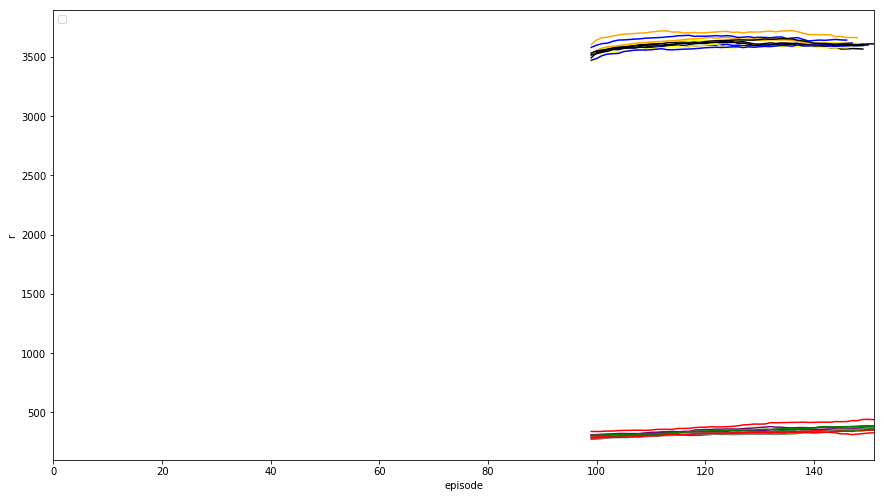

Rolling Plot l


No handles with labels found to put in legend.


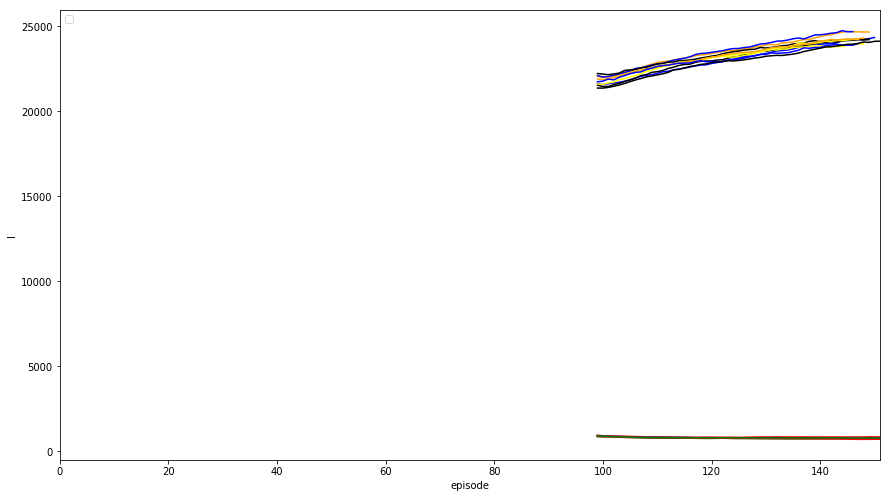

Rolling Plot success


No handles with labels found to put in legend.


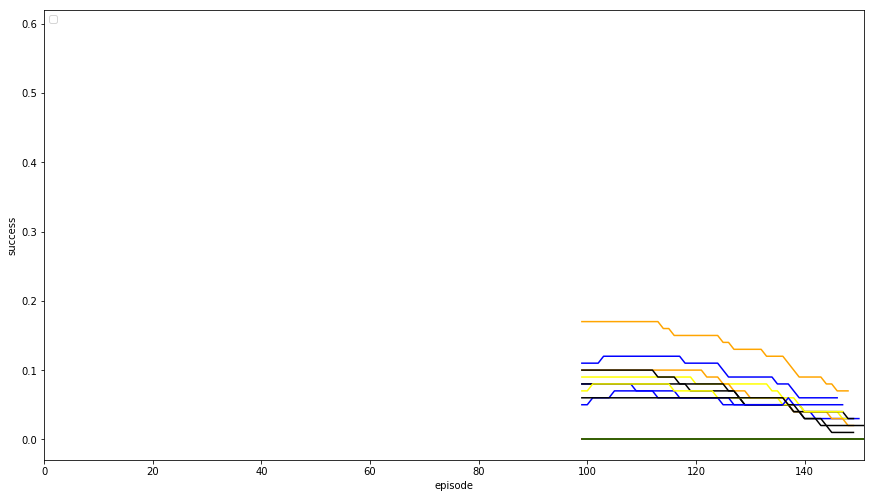

Rolling Plot sc_per_d


No handles with labels found to put in legend.


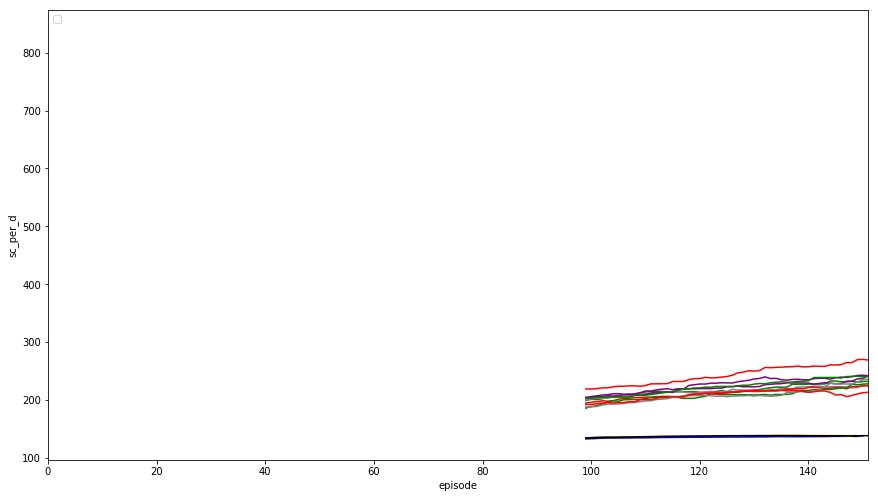

Reward Scatter Plot


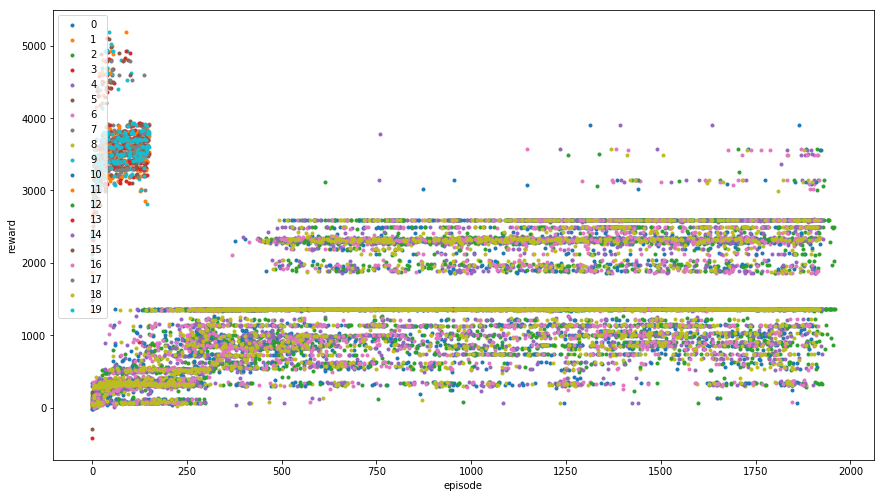

Timesteps Scatter Plot


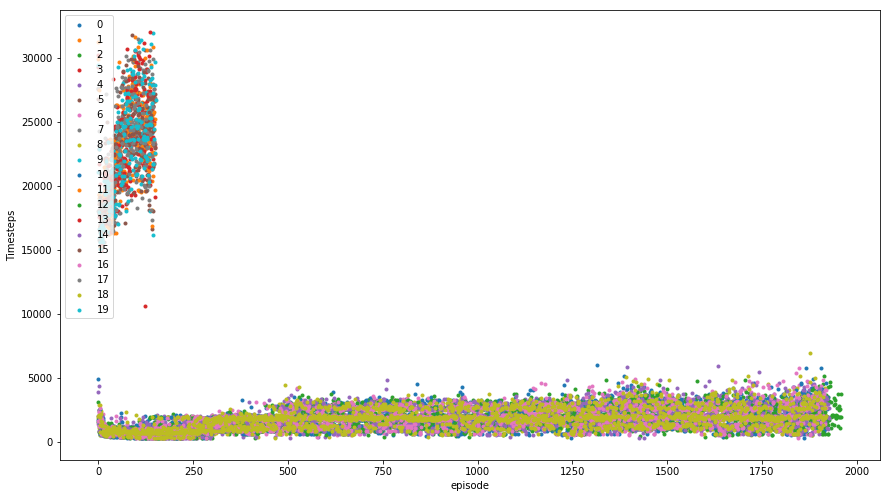

Success Scatter Plot


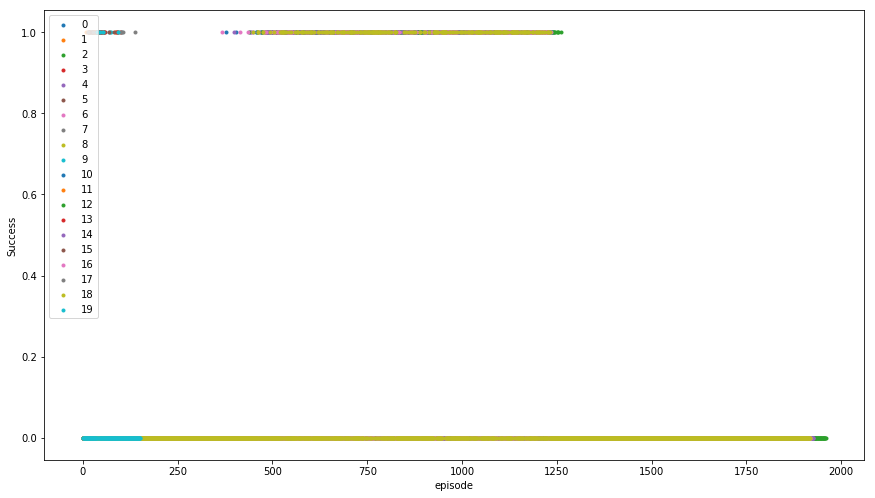

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


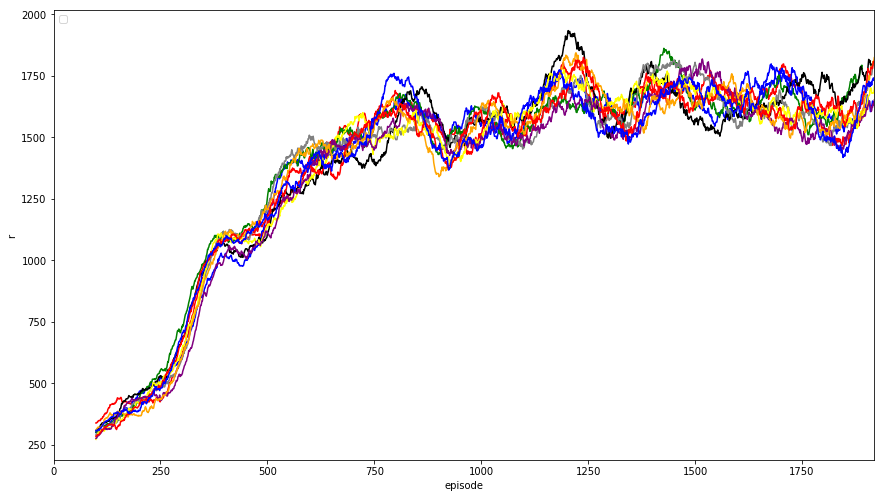

Rolling Plot l


No handles with labels found to put in legend.


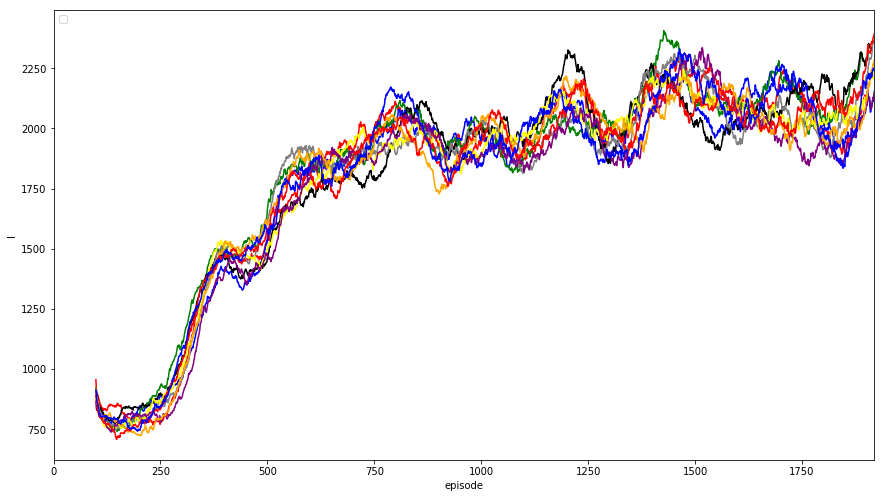

Rolling Plot success


No handles with labels found to put in legend.


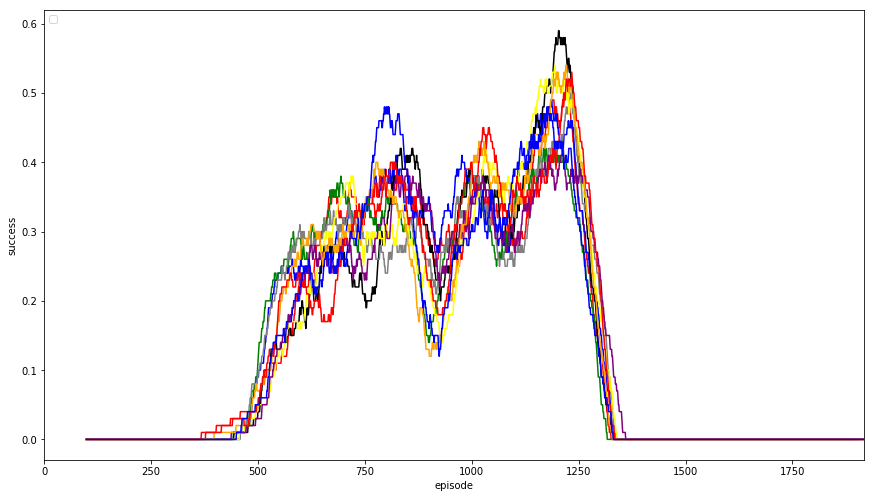

Rolling Plot sc_per_d


No handles with labels found to put in legend.


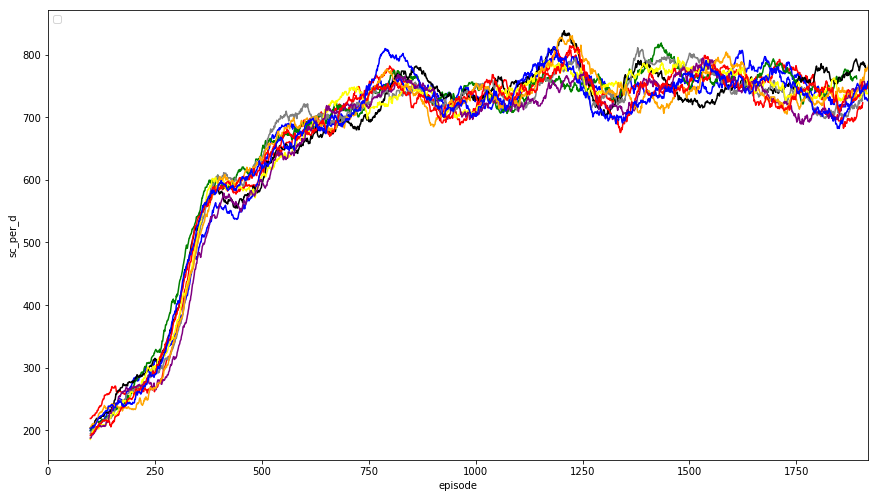

Reward Scatter Plot


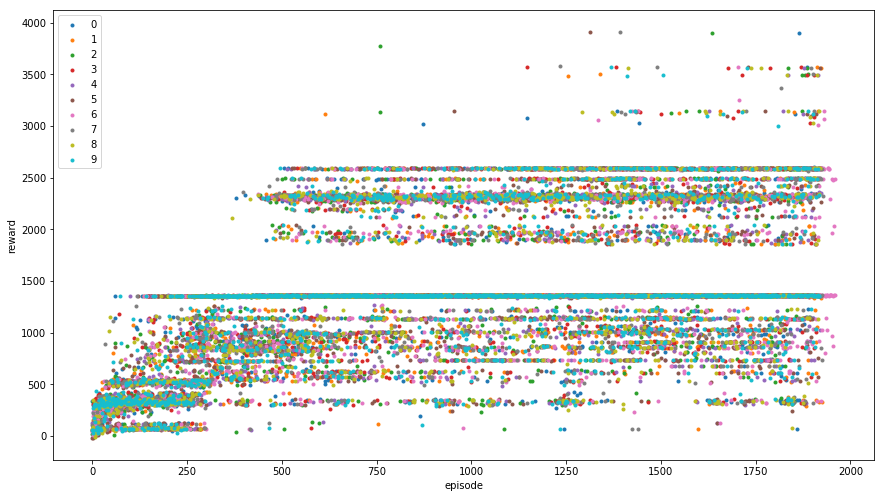

Timesteps Scatter Plot


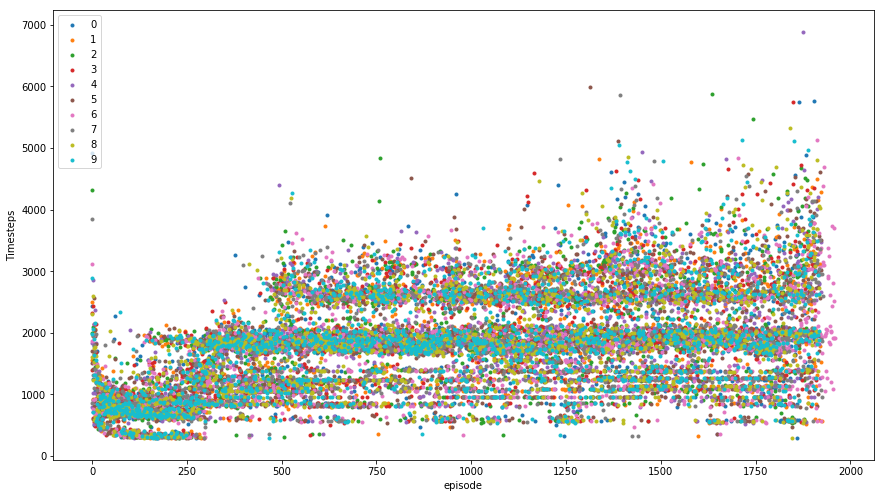

Success Scatter Plot


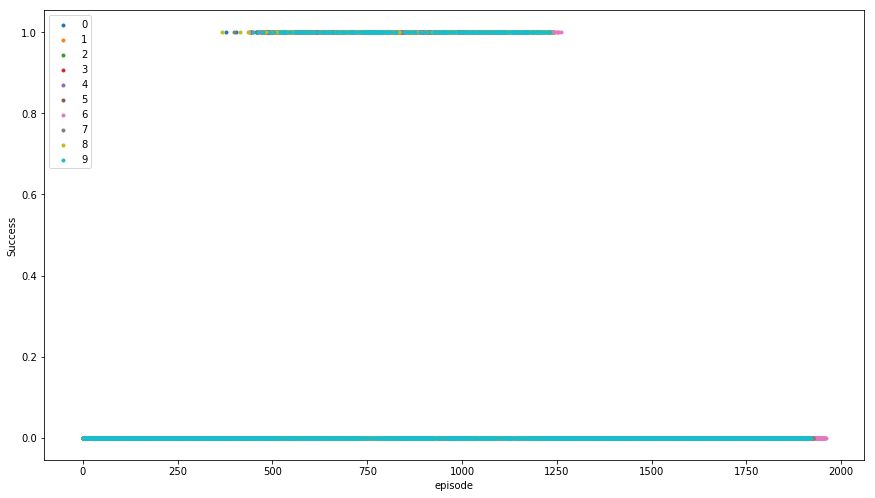

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


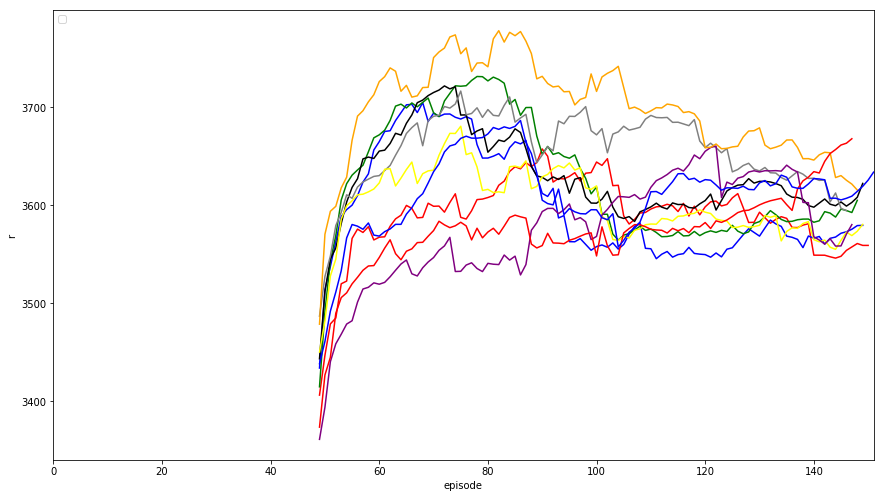

Rolling Plot l


No handles with labels found to put in legend.


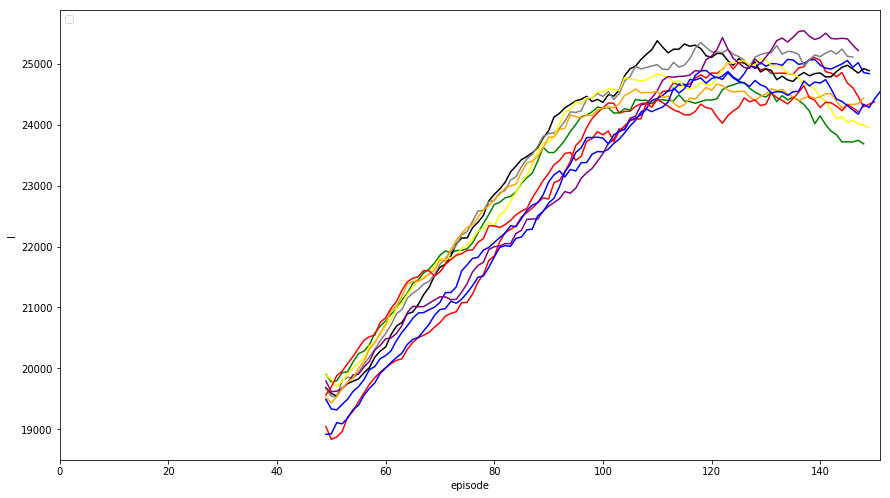

Rolling Plot success


No handles with labels found to put in legend.


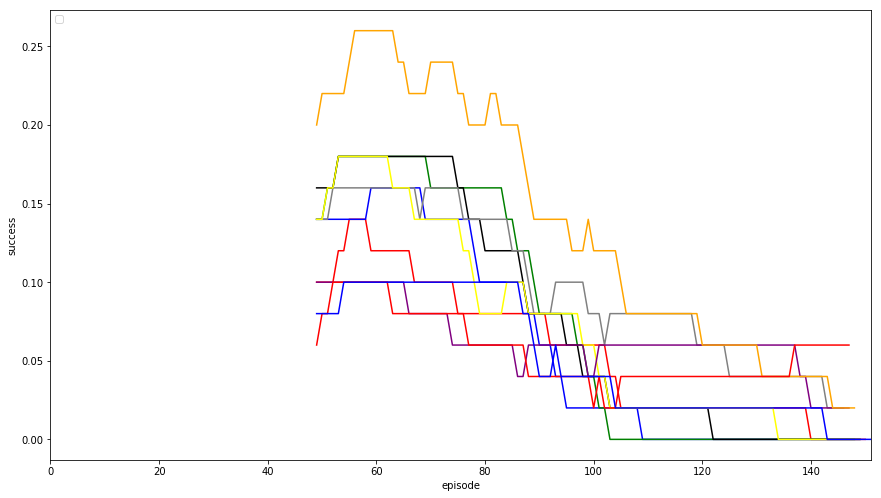

Rolling Plot sc_per_d


No handles with labels found to put in legend.


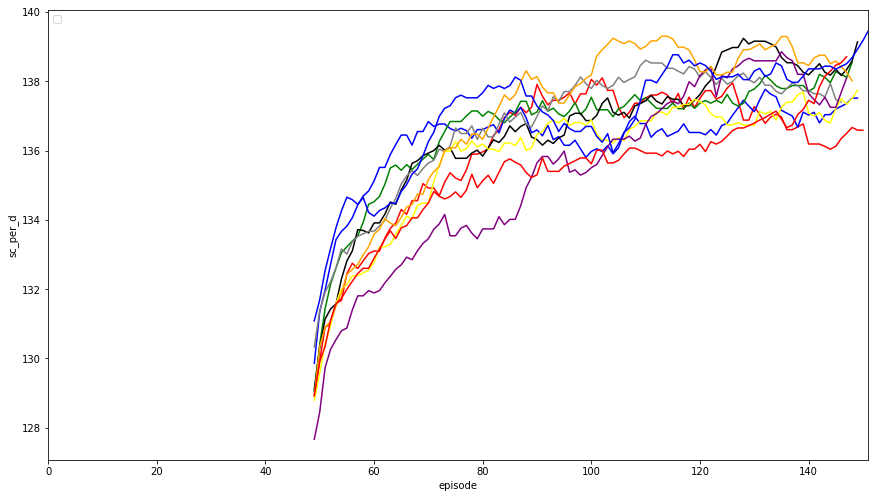

Reward Scatter Plot


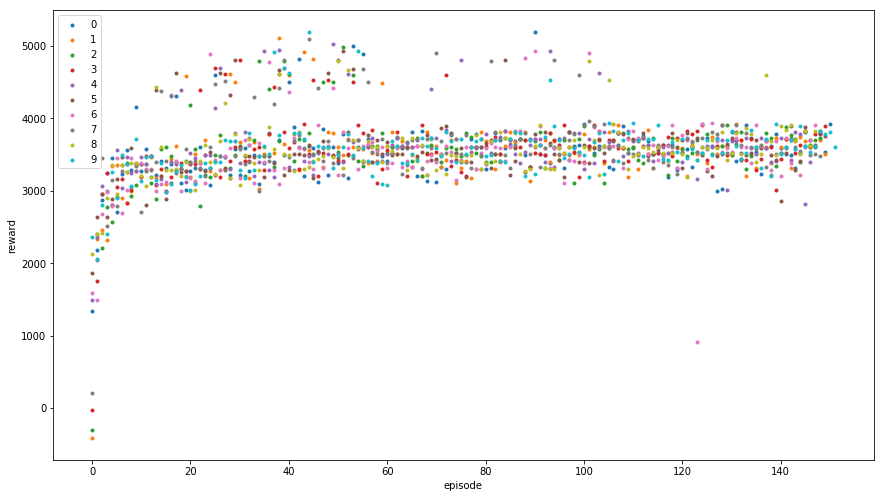

Timesteps Scatter Plot


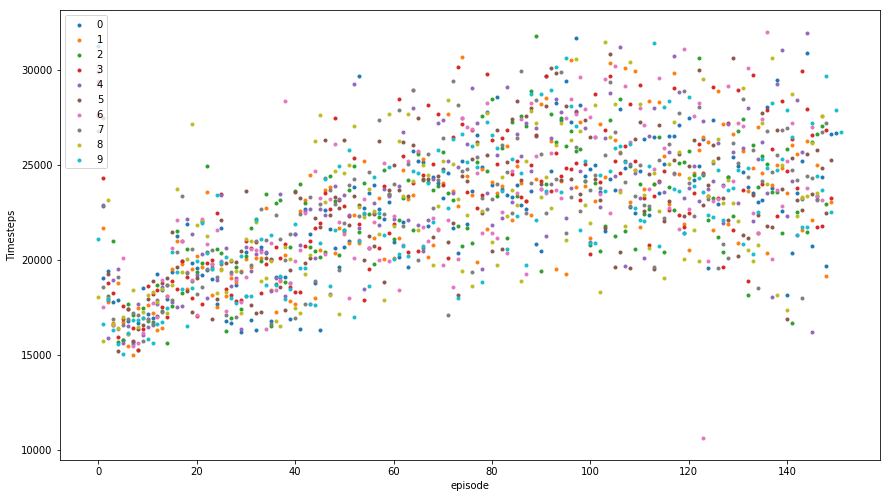

Success Scatter Plot


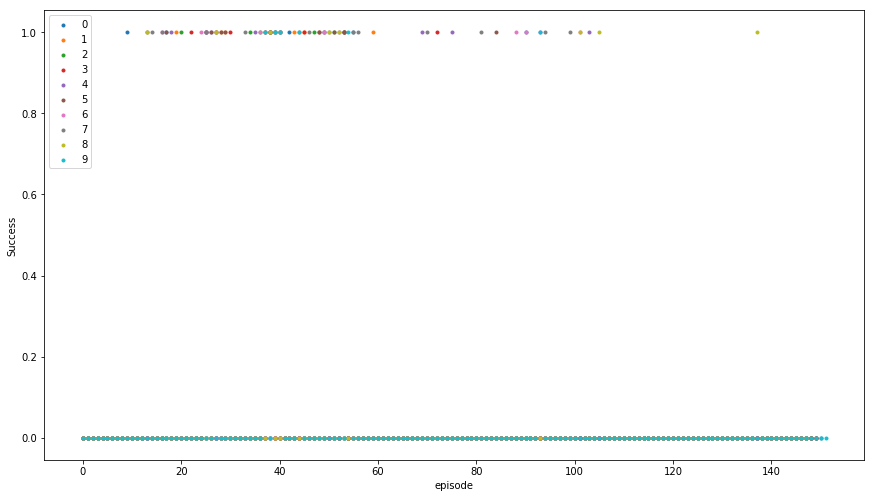

In [4]:
#test run 12
#/home/jim/projects/contra/logs/log_1542433164_16.monitor.csv
get_results(time_id=1542433164,base_dir='logs',df_mod=2)

logs/log_1542391705_0.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542391705_1.monitor.csv
logs/log_1542391705_2.monitor.csv
logs/log_1542391705_3.monitor.csv
logs/log_1542391705_4.monitor.csv
logs/log_1542391705_5.monitor.csv
logs/log_1542391705_6.monitor.csv
logs/log_1542391705_7.monitor.csv
logs/log_1542391705_8.monitor.csv
logs/log_1542391705_9.monitor.csv
logs/log_1542391705_10.monitor.csv
logs/log_1542391705_11.monitor.csv
logs/log_1542391705_12.monitor.csv
logs/log_1542391705_13.monitor.csv
logs/log_1542391705_14.monitor.csv
logs/log_1542391705_15.monitor.csv
logs/log_1542391705_16.monitor.csv
logs/log_1542391705_17.monitor.csv
logs/log_1542391705_18.monitor.csv
logs/log_1542391705_19.monitor.csv
Mean Reward last 100 Episodes per env: 1425.5596964300003
Mean Reward last 100 Episodes per env: 3096.776400840001
Mean Reward last 100 Episodes per env: 1427.1495947
Mean Reward last 100 Episodes per env: 3278.69961134
Mean Reward last 100 Episodes per env: 1440.8689107899997
Mean Reward last 100 Episodes per env: 3180.94800178
Mean Reward l

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


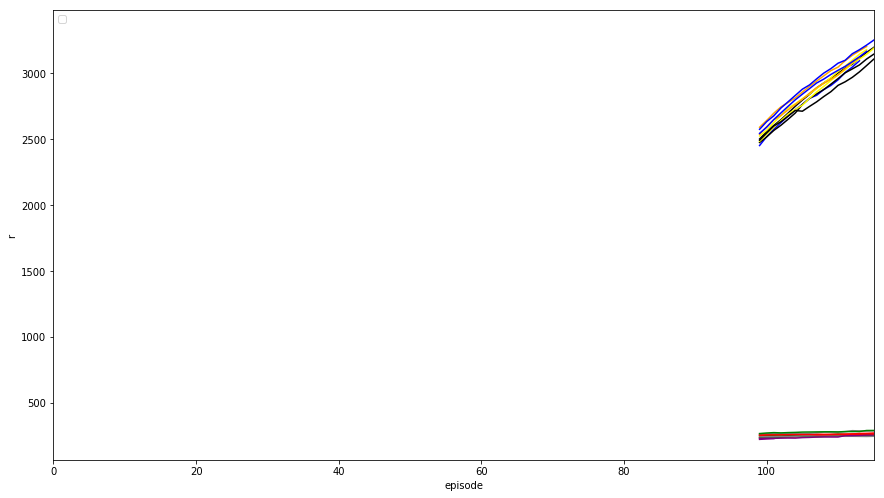

Rolling Plot l


No handles with labels found to put in legend.


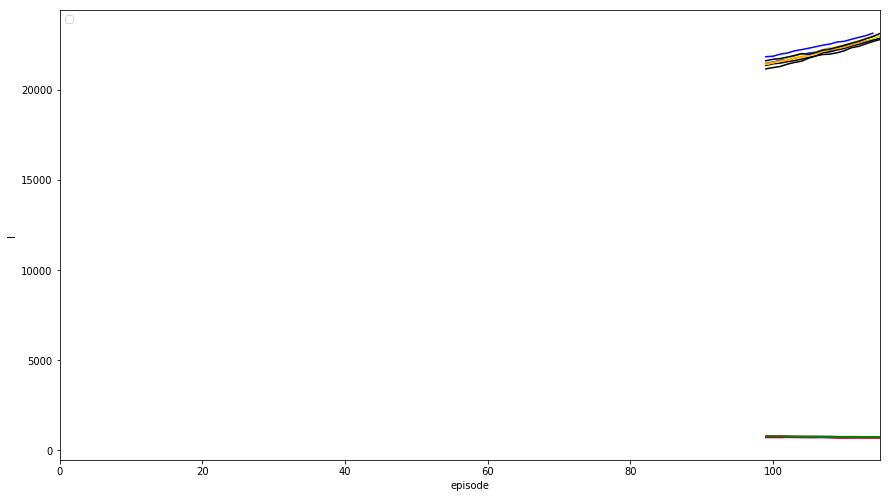

Rolling Plot success


No handles with labels found to put in legend.


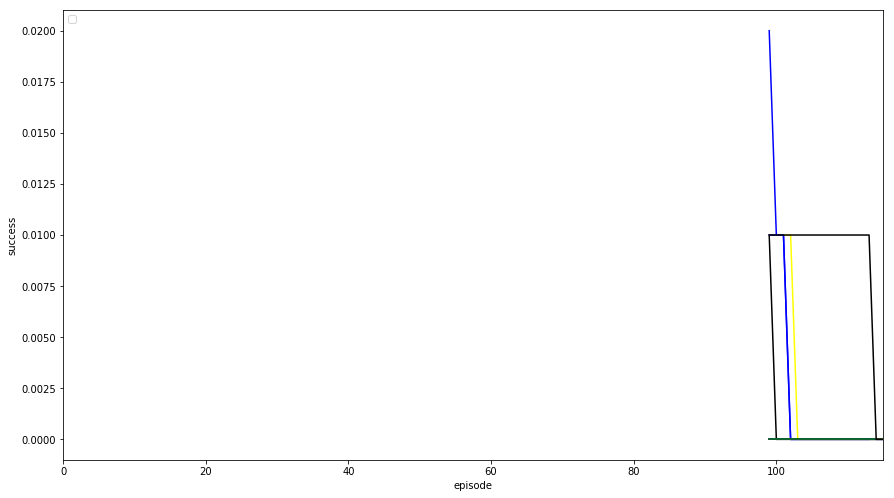

Rolling Plot sc_per_d


No handles with labels found to put in legend.


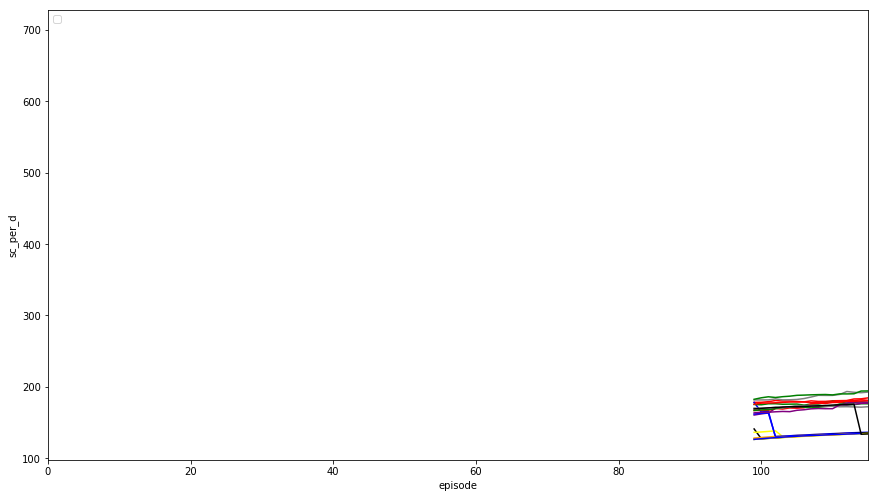

Reward Scatter Plot


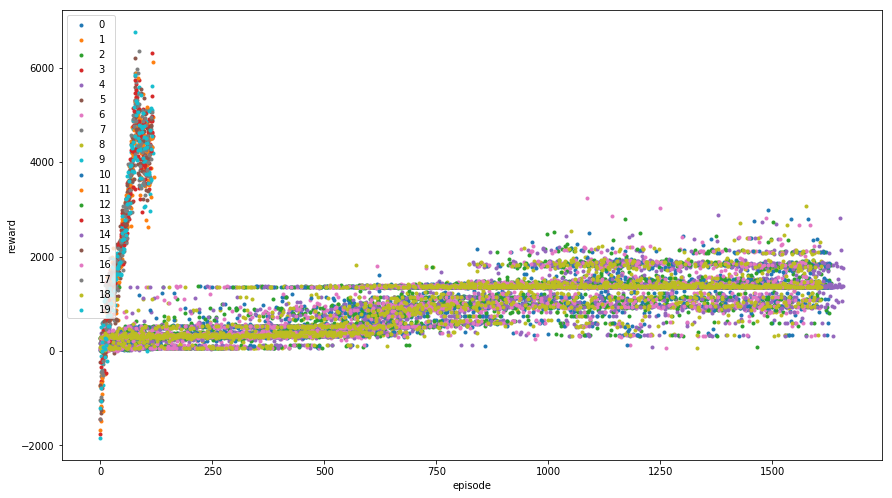

Timesteps Scatter Plot


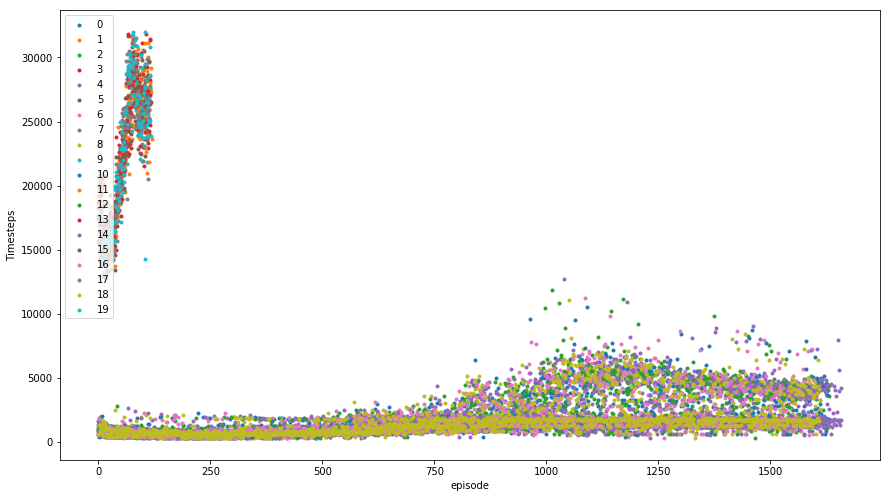

Success Scatter Plot


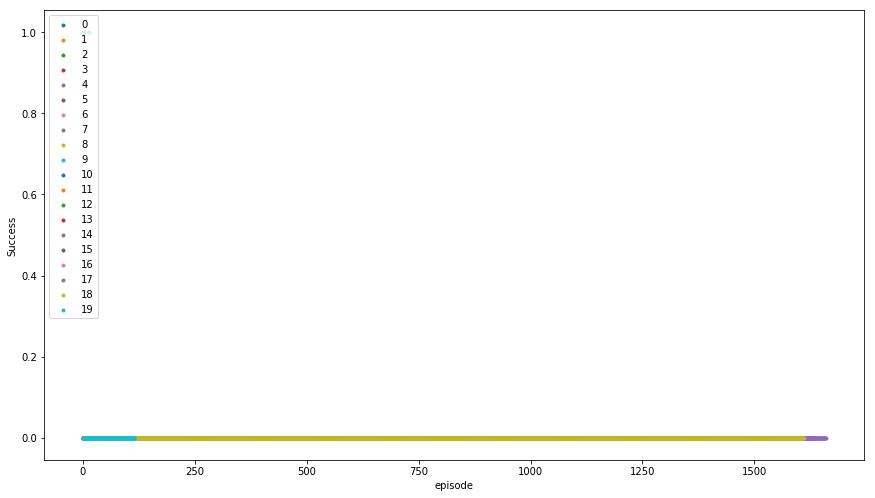

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


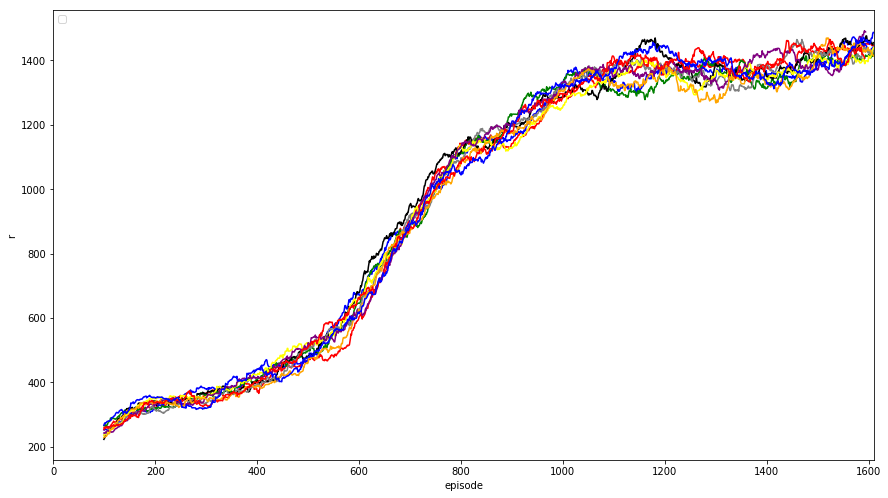

Rolling Plot l


No handles with labels found to put in legend.


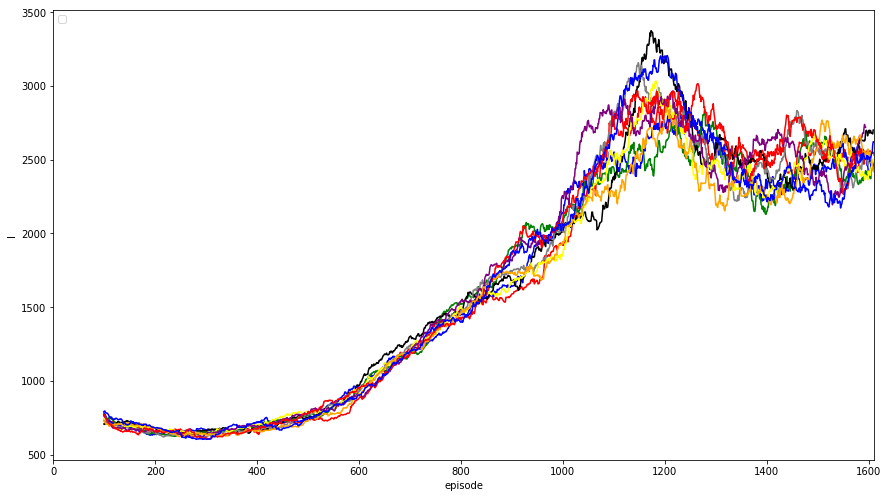

Rolling Plot success


No handles with labels found to put in legend.


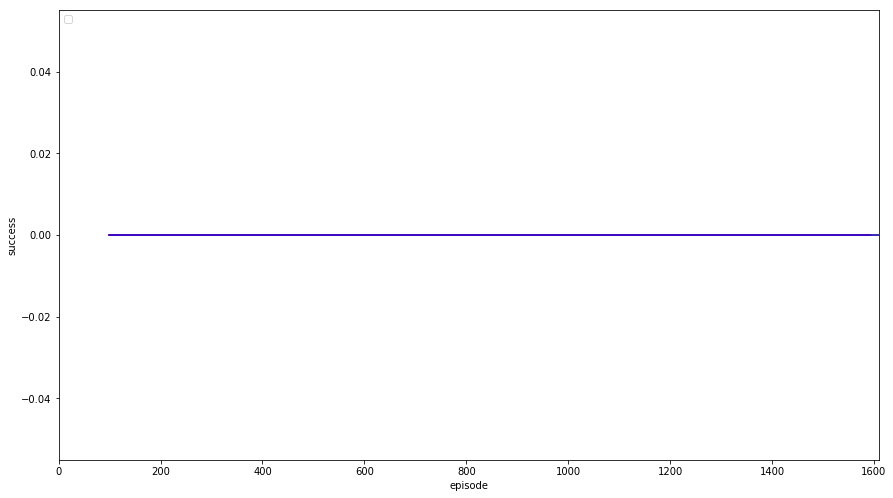

Rolling Plot sc_per_d


No handles with labels found to put in legend.


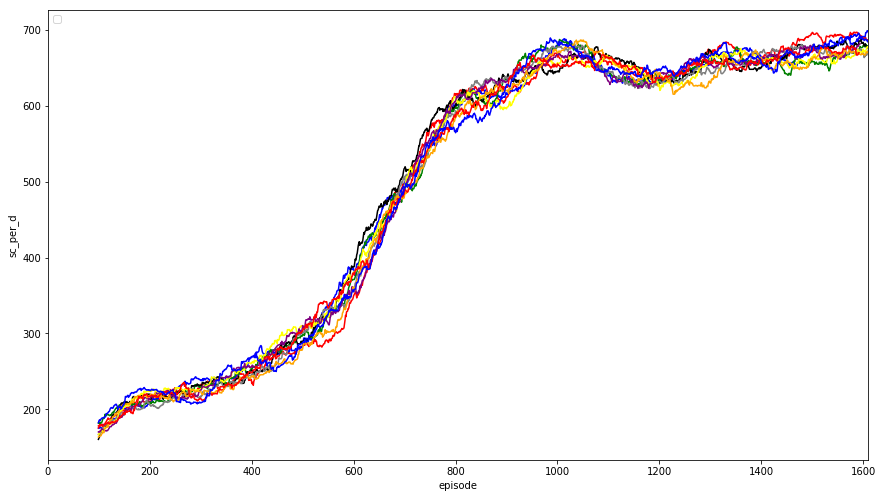

Reward Scatter Plot


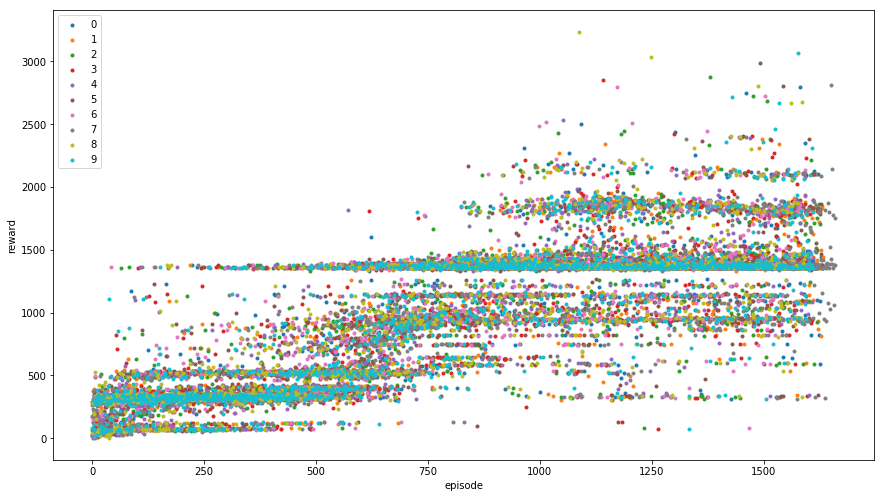

Timesteps Scatter Plot


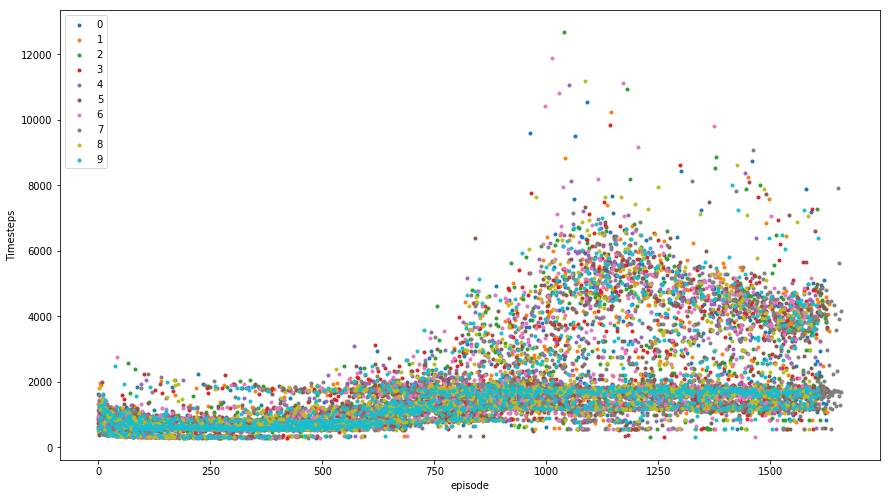

Success Scatter Plot


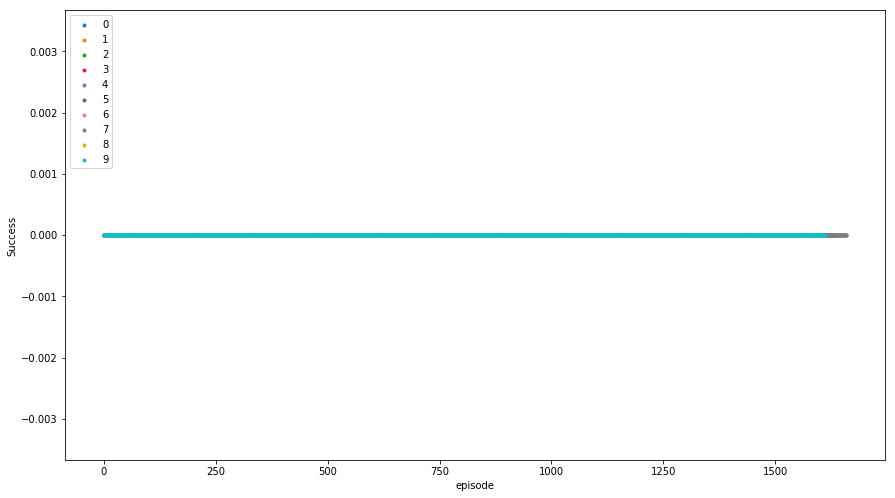

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


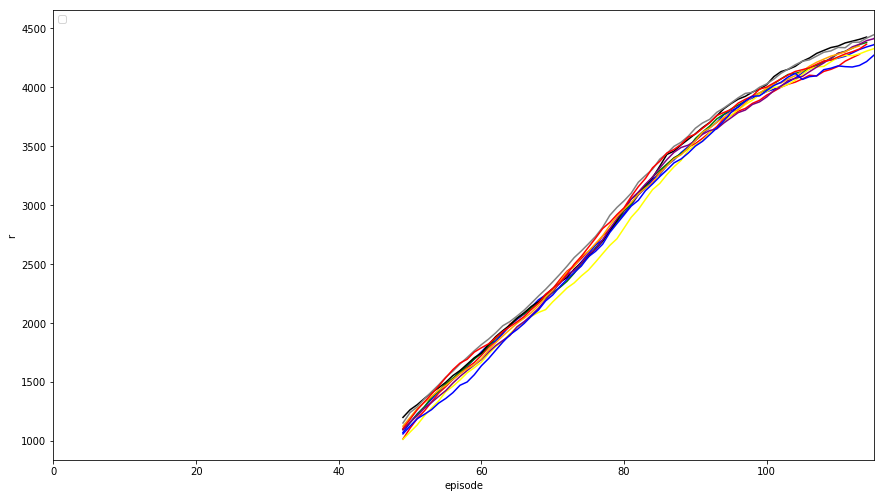

Rolling Plot l


No handles with labels found to put in legend.


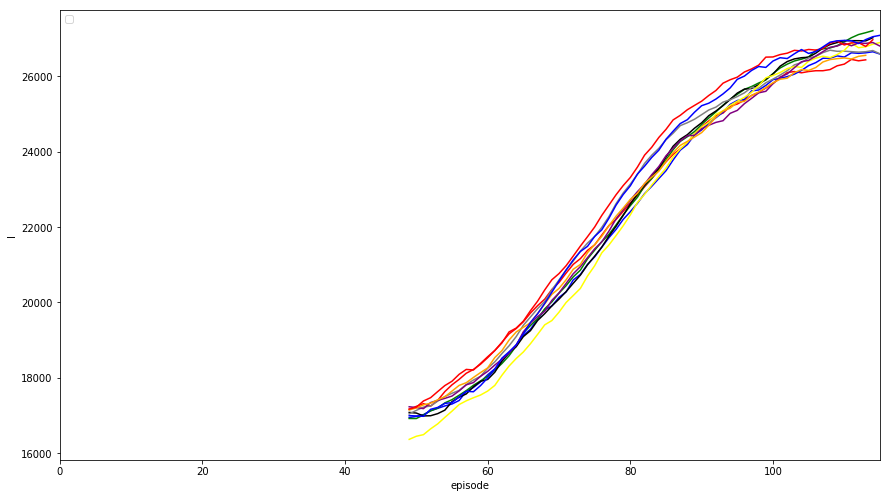

Rolling Plot success


No handles with labels found to put in legend.


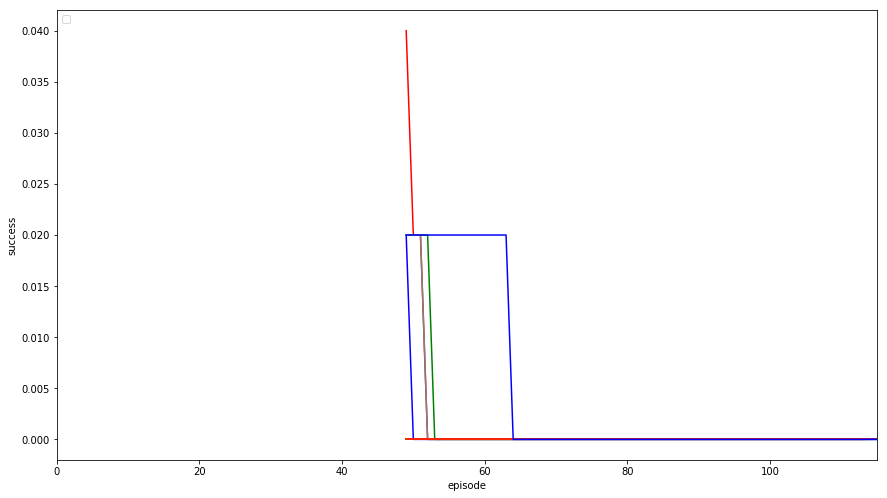

Rolling Plot sc_per_d


No handles with labels found to put in legend.


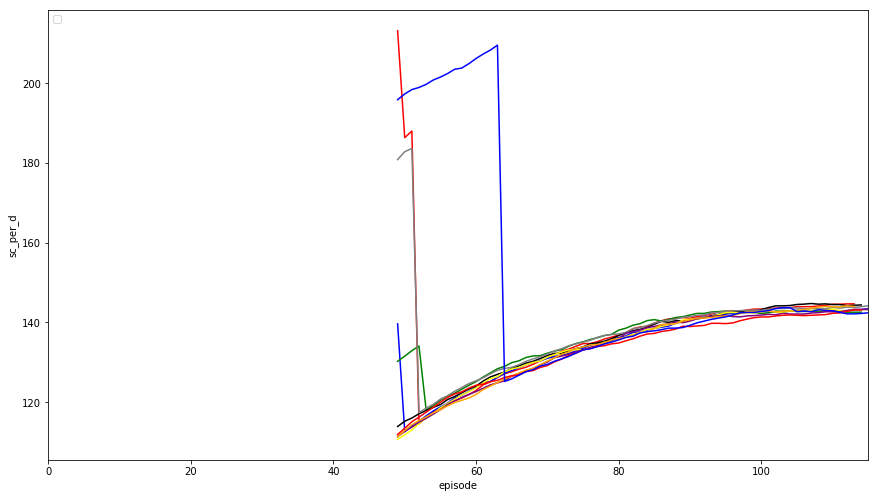

Reward Scatter Plot


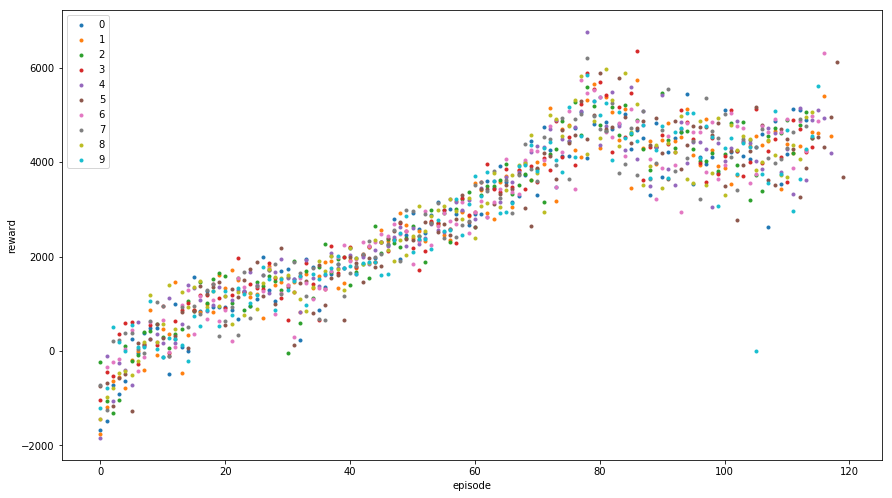

Timesteps Scatter Plot


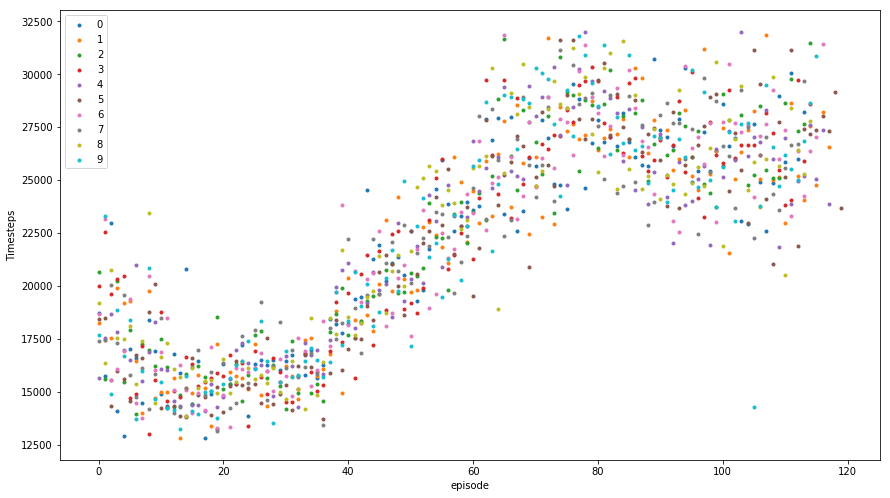

Success Scatter Plot


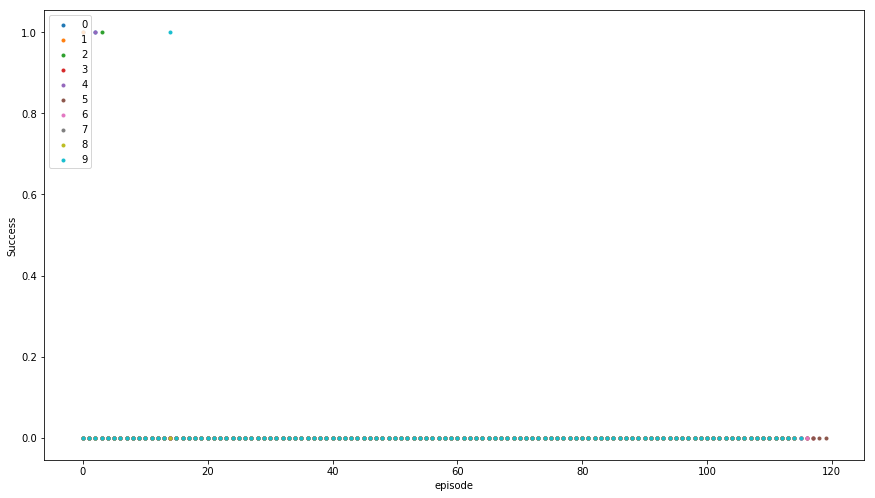

In [4]:
#test run 11
#/home/jim/projects/contra/logs/log_1542391705_8.monitor.csv
get_results(time_id=1542391705,base_dir='logs',df_mod=2)

logs/log_1542345271_0.monitor.csv
logs/log_1542345271_1.monitor.csv
logs/log_1542345271_2.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542345271_3.monitor.csv
logs/log_1542345271_4.monitor.csv
logs/log_1542345271_5.monitor.csv
logs/log_1542345271_6.monitor.csv
logs/log_1542345271_7.monitor.csv
logs/log_1542345271_8.monitor.csv
logs/log_1542345271_9.monitor.csv
logs/log_1542345271_10.monitor.csv
logs/log_1542345271_11.monitor.csv
logs/log_1542345271_12.monitor.csv
logs/log_1542345271_13.monitor.csv
logs/log_1542345271_14.monitor.csv
logs/log_1542345271_15.monitor.csv
logs/log_1542345271_16.monitor.csv
logs/log_1542345271_17.monitor.csv
logs/log_1542345271_18.monitor.csv
logs/log_1542345271_19.monitor.csv
Mean Reward last 100 Episodes per env: 1731.5166336799998
Mean Reward last 100 Episodes per env: 4184.377097389999
Mean Reward last 100 Episodes per env: 1700.1682861600002
Mean Reward last 100 Episodes per env: 4268.2002091
Mean Reward last 100 Episodes per env: 1758.7070579999993
Mean Reward last 100 Episodes per env: 4473.8941909899995
Mean Reward last 100 Episodes per env: 1750.3176437
Mean Reward last 10

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


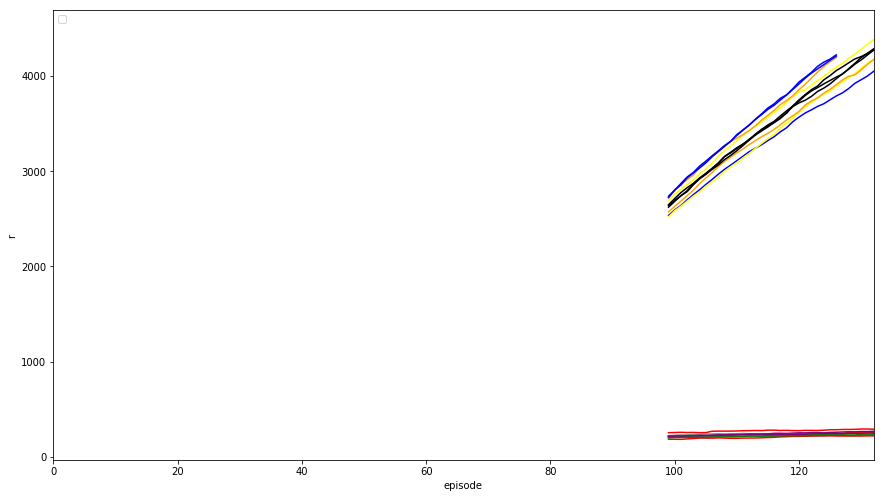

Rolling Plot l


No handles with labels found to put in legend.


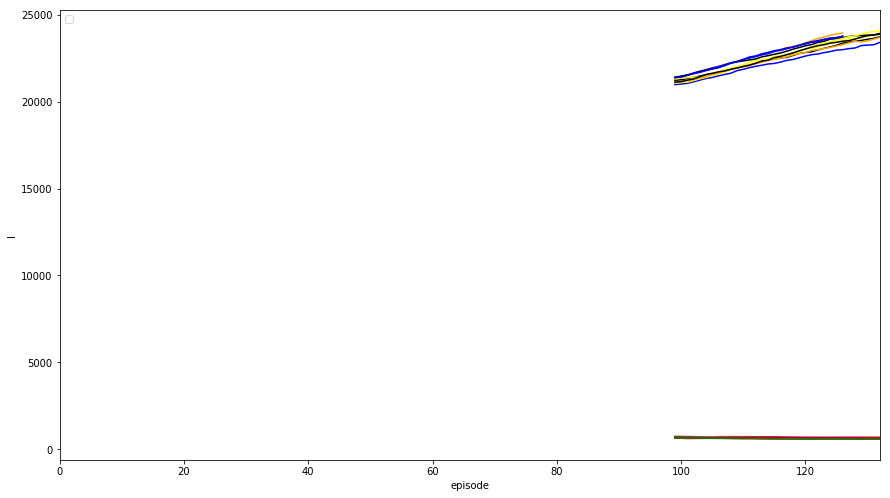

Rolling Plot success


No handles with labels found to put in legend.


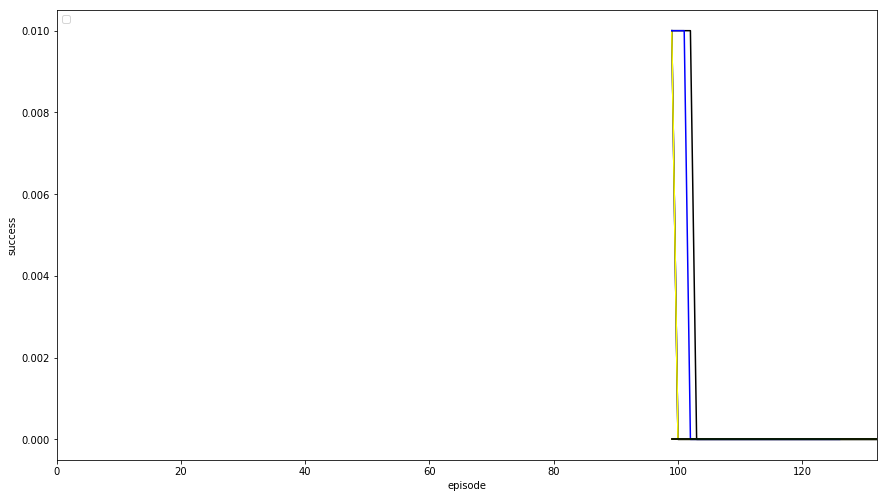

Rolling Plot sc_per_d


No handles with labels found to put in legend.


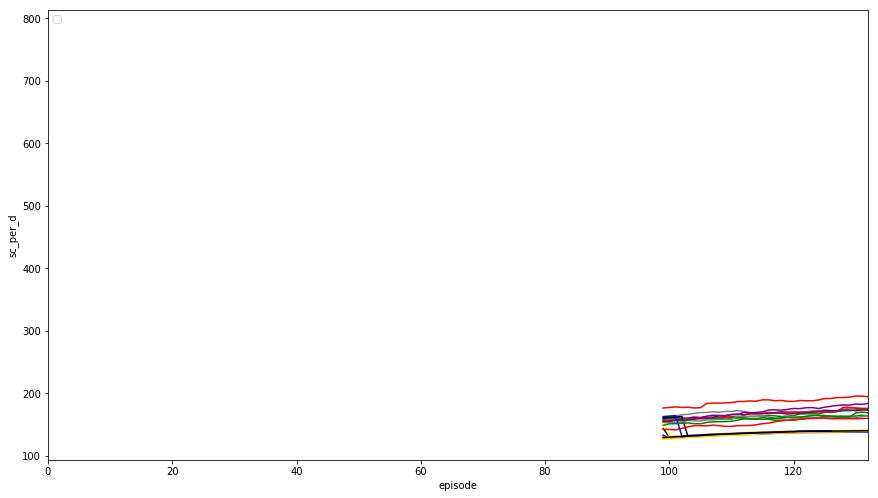

Reward Scatter Plot


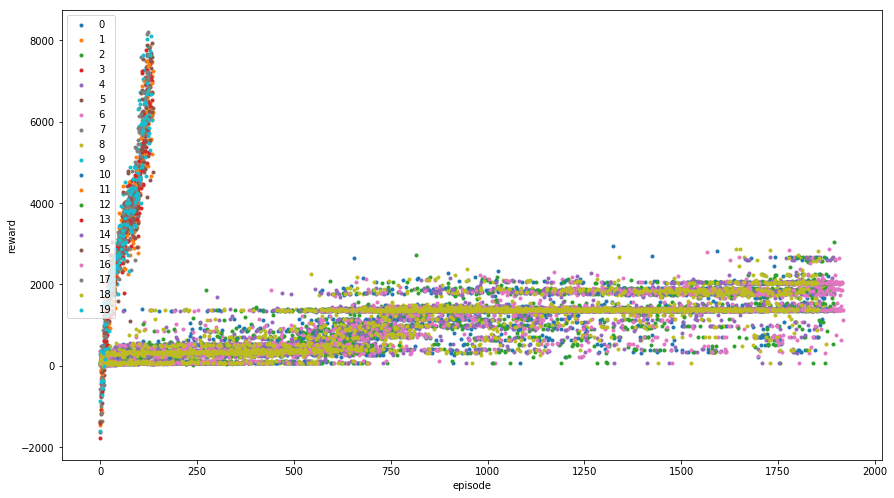

Timesteps Scatter Plot


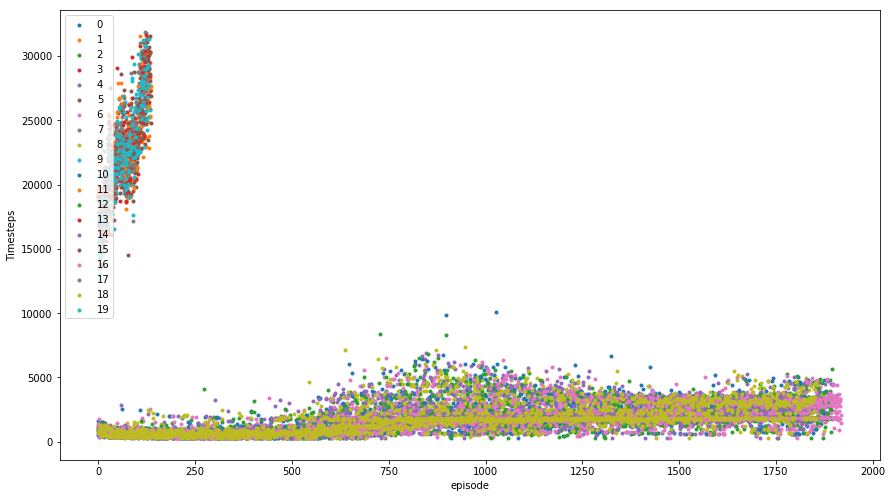

Success Scatter Plot


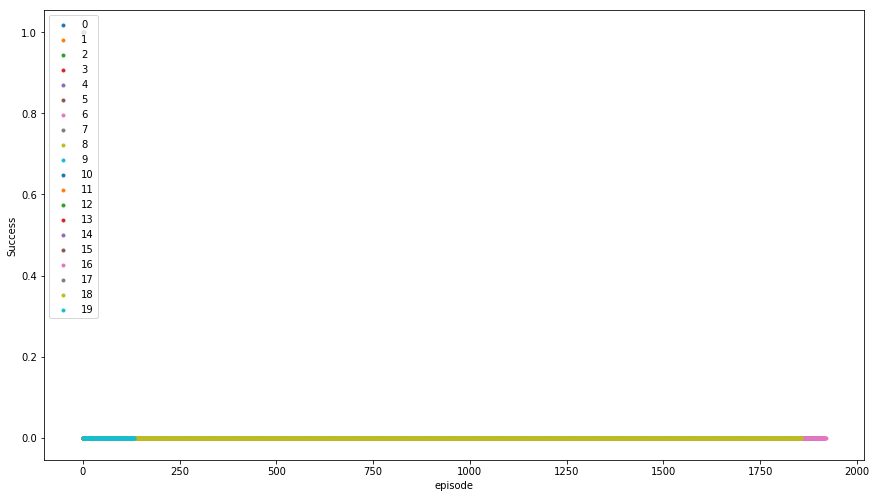

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


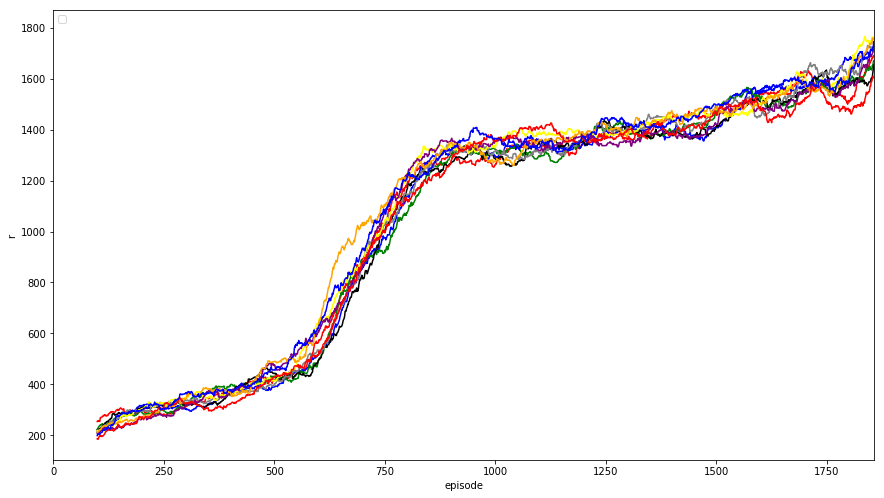

Rolling Plot l


No handles with labels found to put in legend.


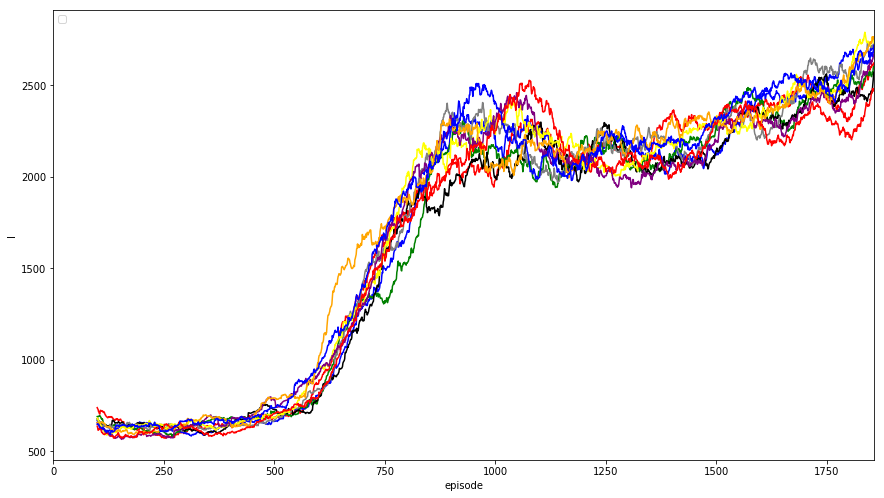

Rolling Plot success


No handles with labels found to put in legend.


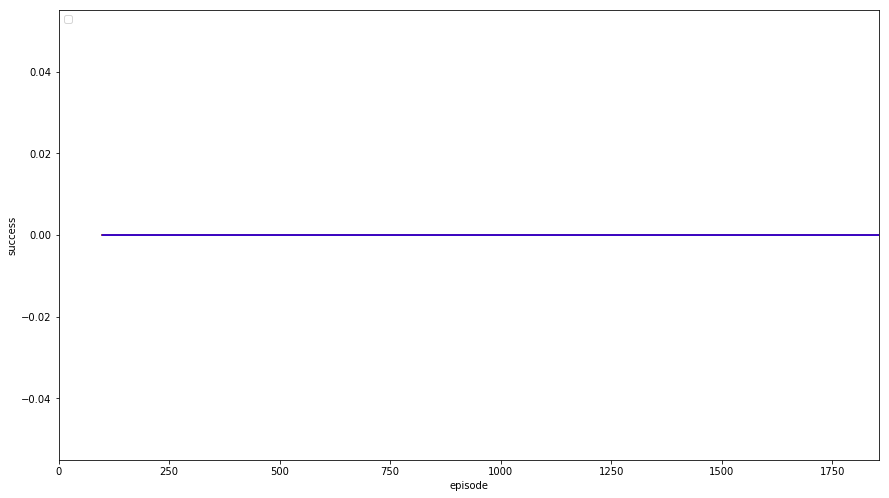

Rolling Plot sc_per_d


No handles with labels found to put in legend.


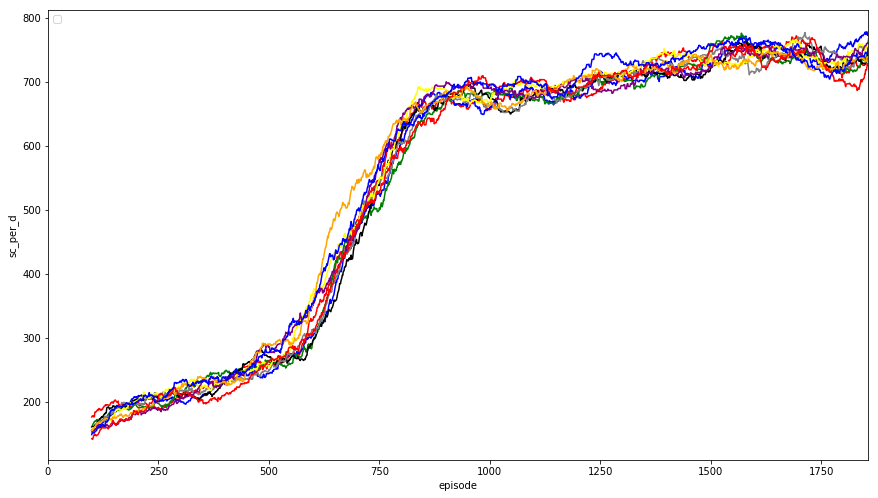

Reward Scatter Plot


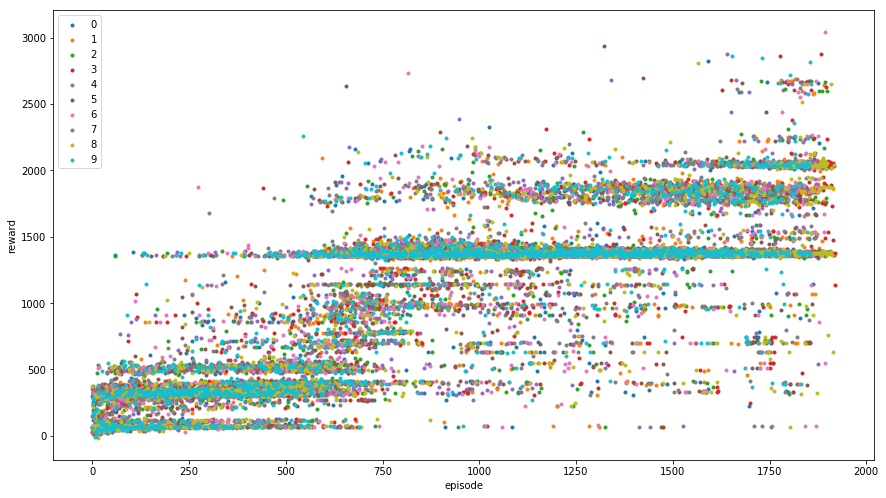

Timesteps Scatter Plot


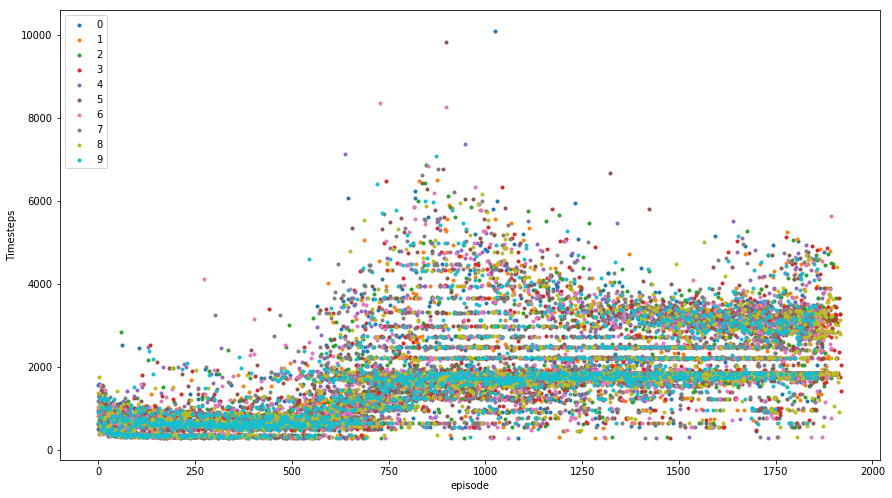

Success Scatter Plot


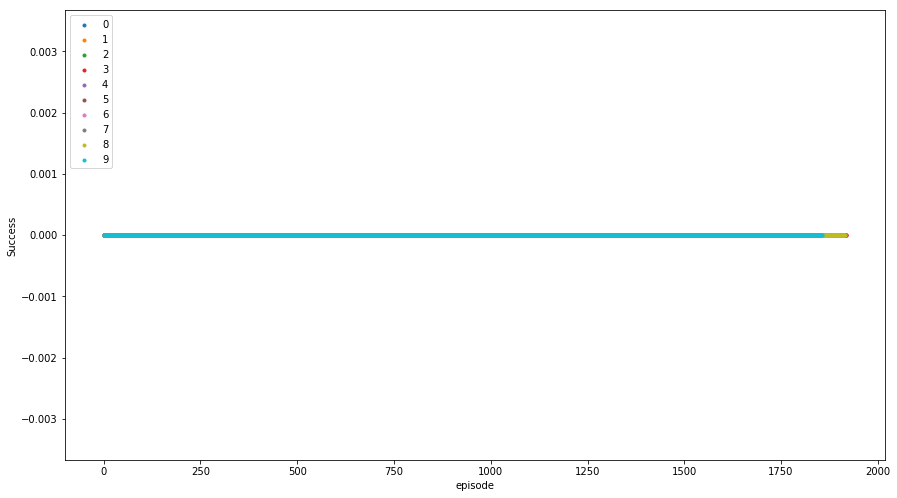

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


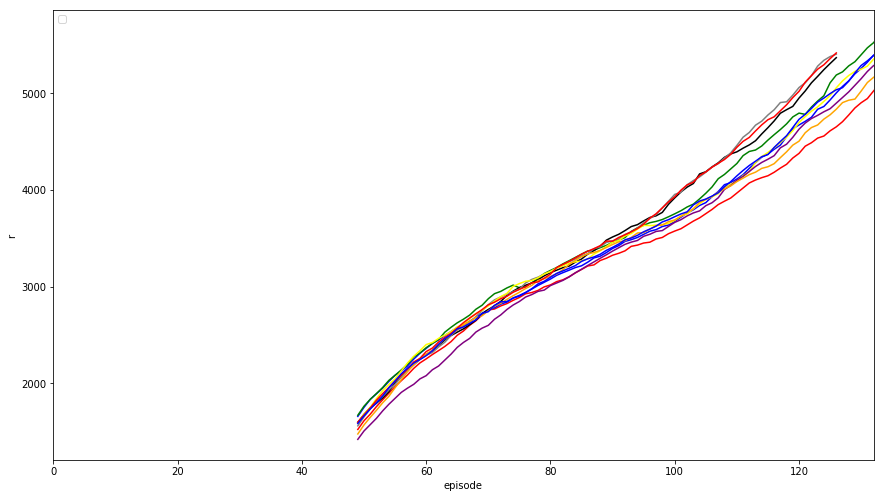

Rolling Plot l


No handles with labels found to put in legend.


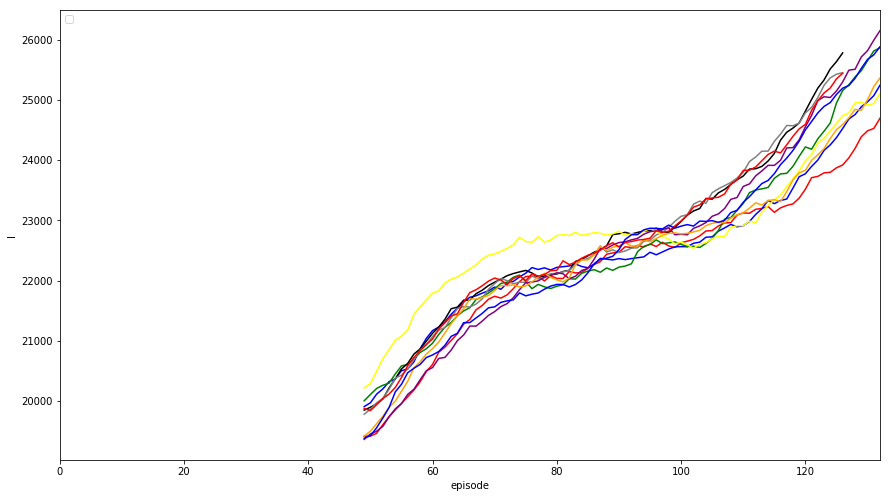

Rolling Plot success


No handles with labels found to put in legend.


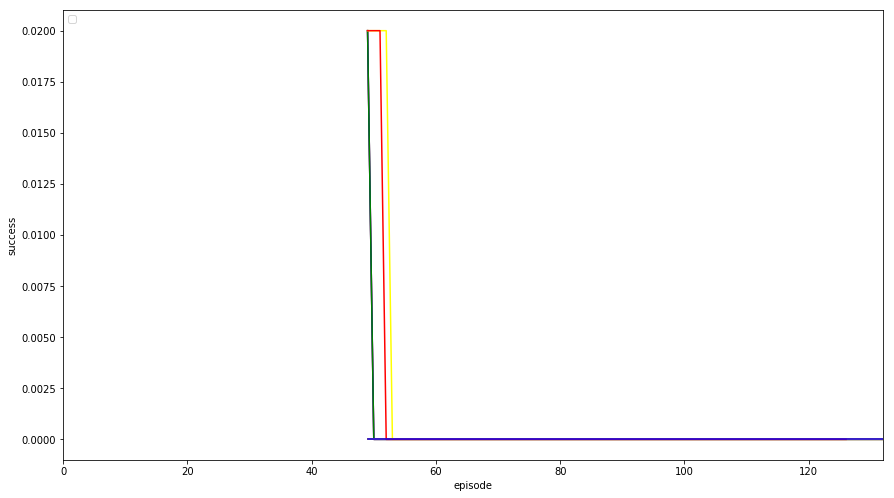

Rolling Plot sc_per_d


No handles with labels found to put in legend.


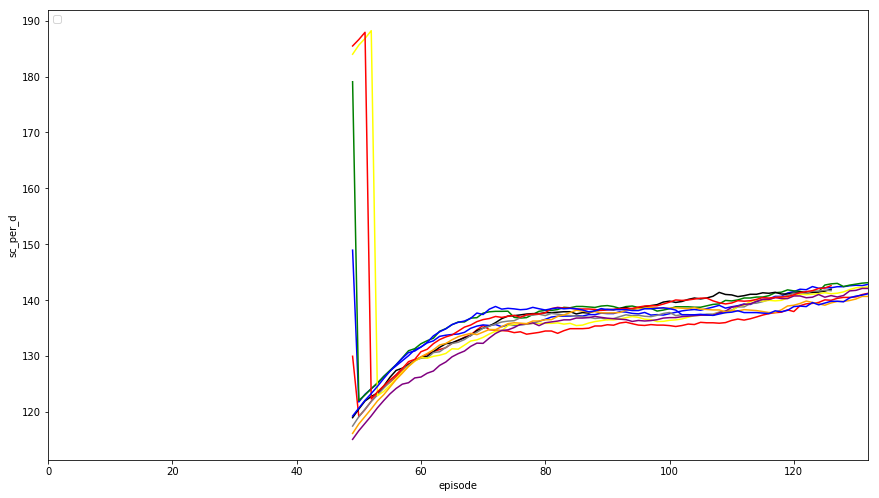

Reward Scatter Plot


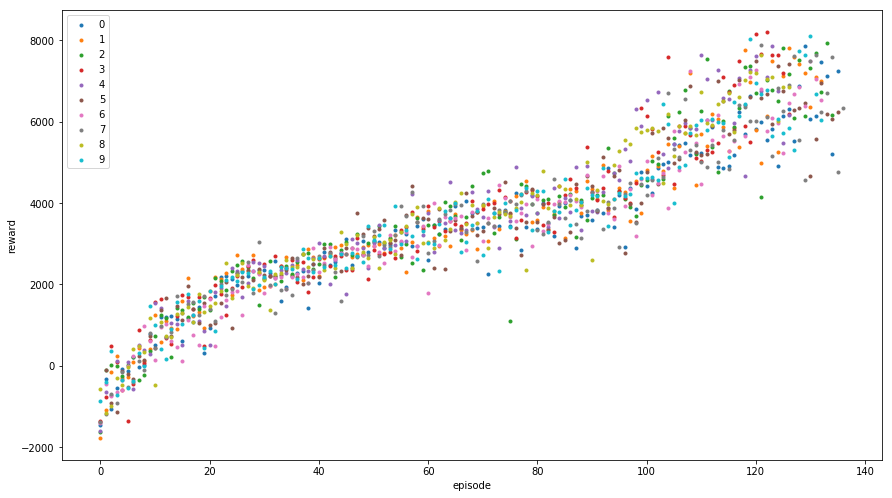

Timesteps Scatter Plot


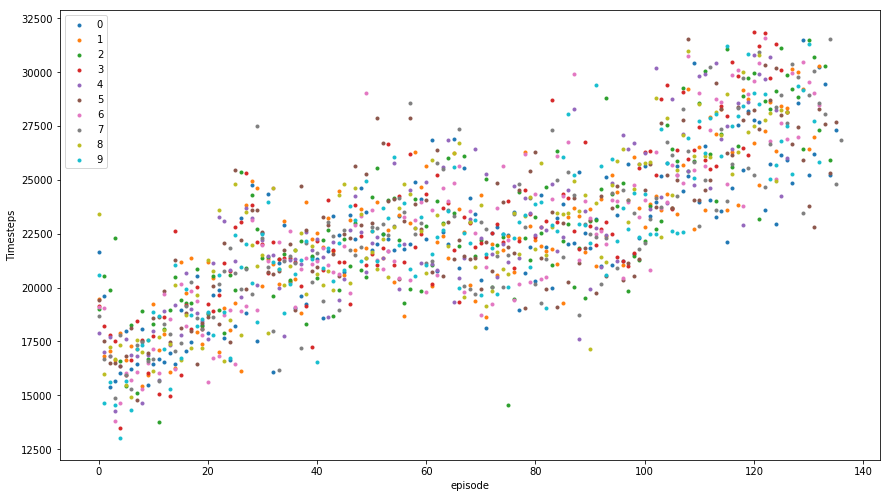

Success Scatter Plot


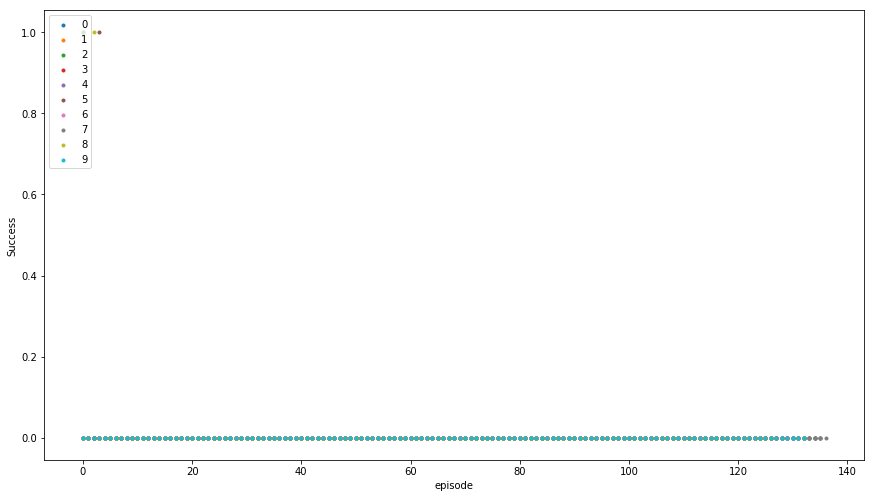

In [4]:
#test run 10
#/home/jim/projects/contra/videos/1542345271_18
get_results(time_id=1542345271,base_dir='logs',df_mod=2)

logs/log_1542318787_0.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542318787_1.monitor.csv
logs/log_1542318787_2.monitor.csv
logs/log_1542318787_3.monitor.csv
logs/log_1542318787_4.monitor.csv
logs/log_1542318787_5.monitor.csv
logs/log_1542318787_6.monitor.csv
logs/log_1542318787_7.monitor.csv
logs/log_1542318787_8.monitor.csv
logs/log_1542318787_9.monitor.csv
logs/log_1542318787_10.monitor.csv
logs/log_1542318787_11.monitor.csv
logs/log_1542318787_12.monitor.csv
logs/log_1542318787_13.monitor.csv
logs/log_1542318787_14.monitor.csv
logs/log_1542318787_15.monitor.csv
logs/log_1542318787_16.monitor.csv
logs/log_1542318787_17.monitor.csv
logs/log_1542318787_18.monitor.csv
logs/log_1542318787_19.monitor.csv
Mean Reward last 100 Episodes per env: 649.20074421
Mean Reward last 100 Episodes per env: 649.6647097083334
Mean Reward last 100 Episodes per env: 671.1507661599999
Mean Reward last 100 Episodes per env: 627.1438381739132
Mean Reward last 100 Episodes per env: 625.7807194799998
Mean Reward last 100 Episodes per env: 727.59143236
Mean Reward 

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


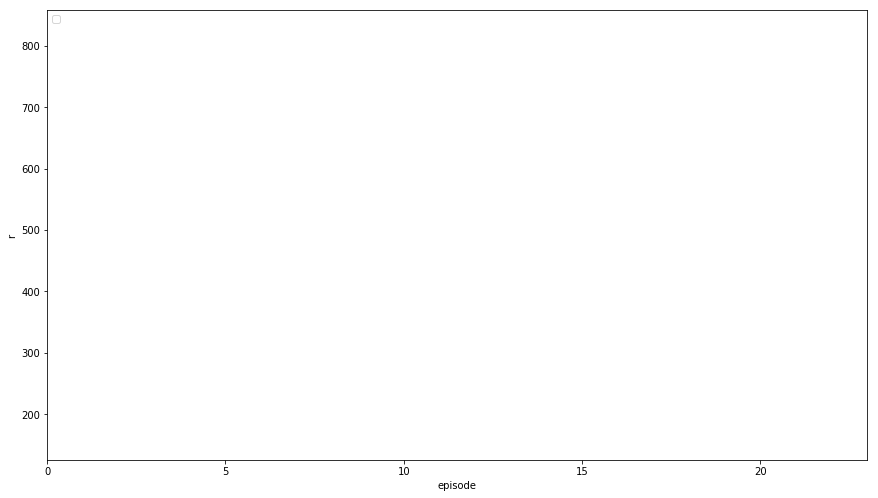

Rolling Plot l


No handles with labels found to put in legend.


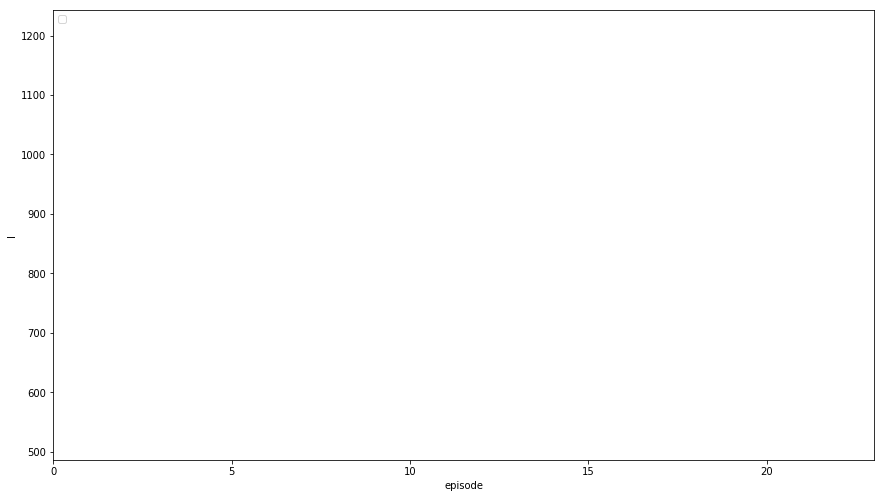

Rolling Plot success


No handles with labels found to put in legend.


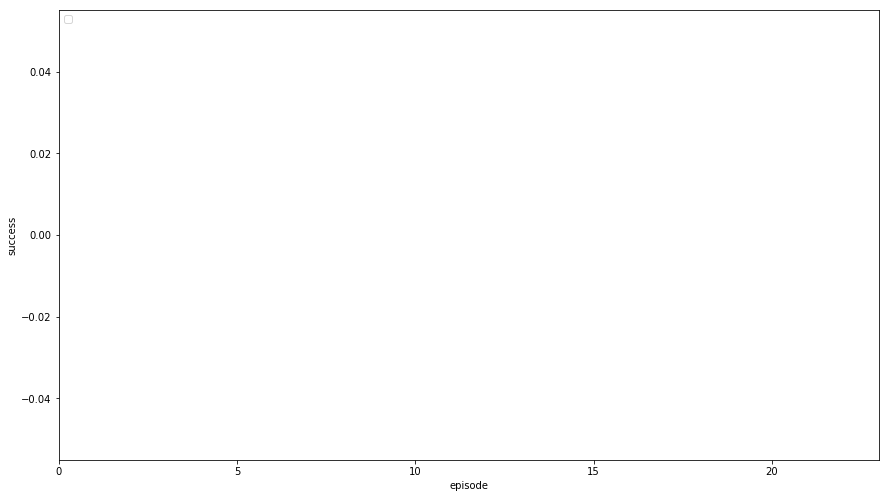

Rolling Plot sc_per_d


No handles with labels found to put in legend.


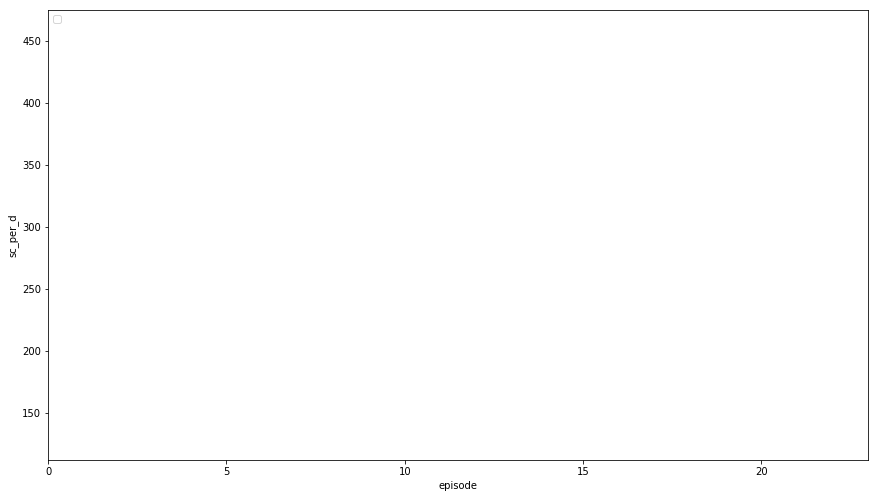

Reward Scatter Plot


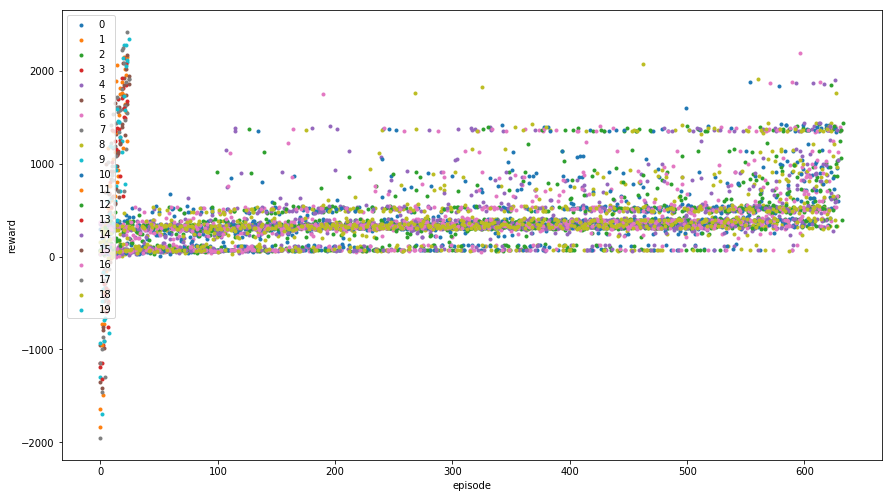

Timesteps Scatter Plot


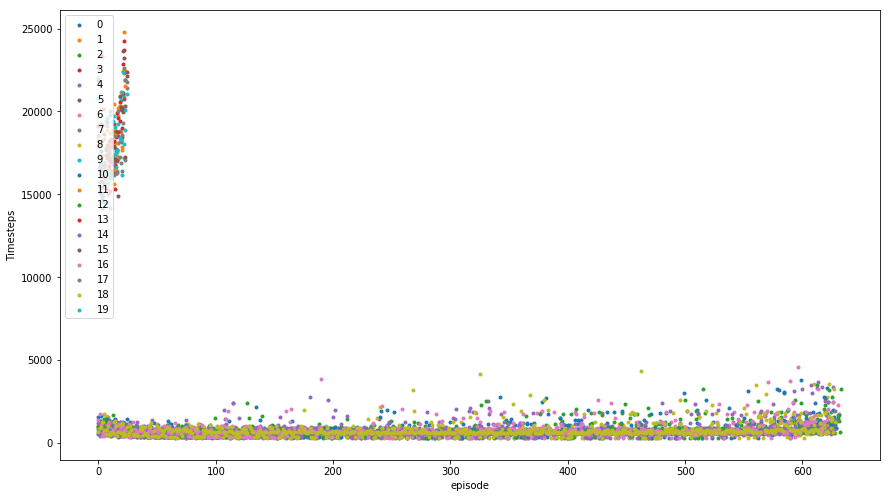

Success Scatter Plot


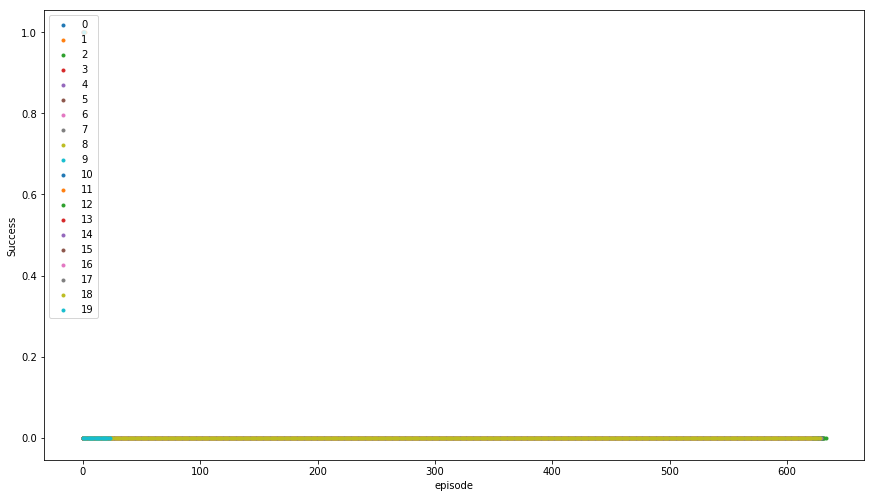

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


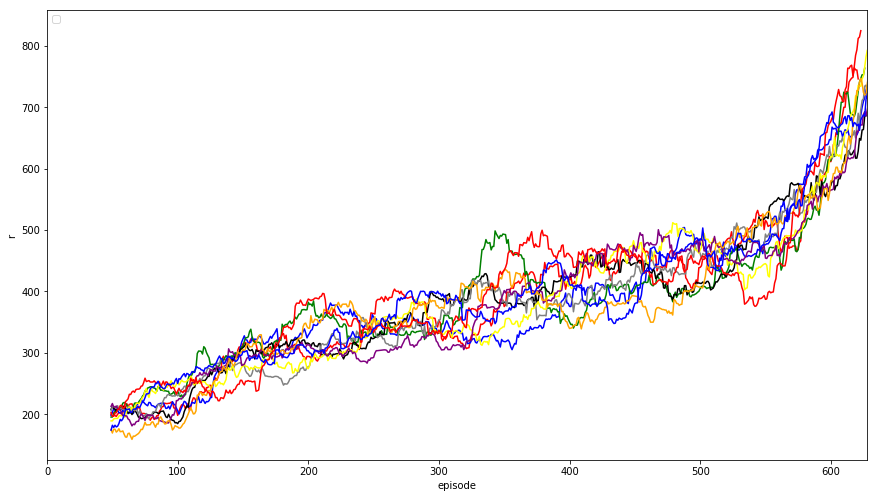

Rolling Plot l


No handles with labels found to put in legend.


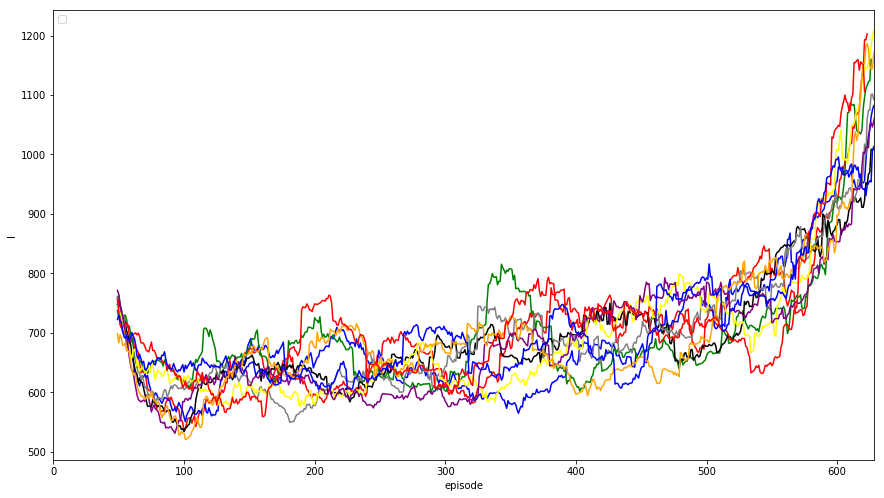

Rolling Plot success


No handles with labels found to put in legend.


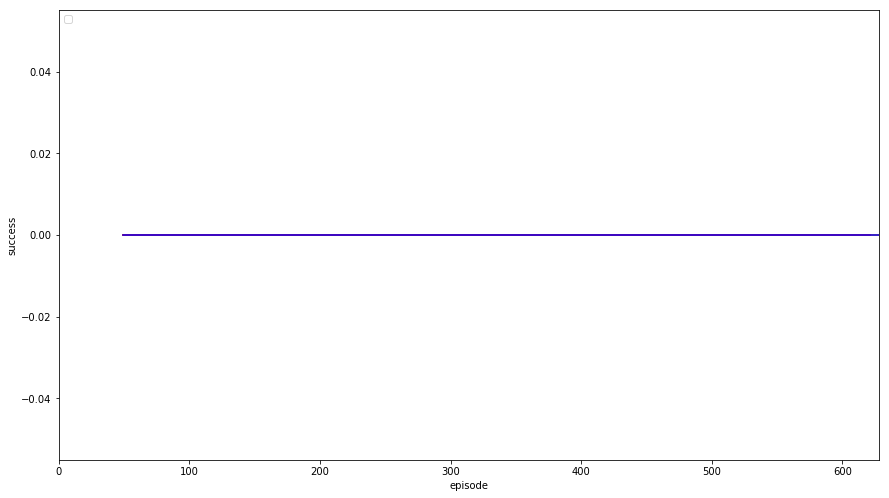

Rolling Plot sc_per_d


No handles with labels found to put in legend.


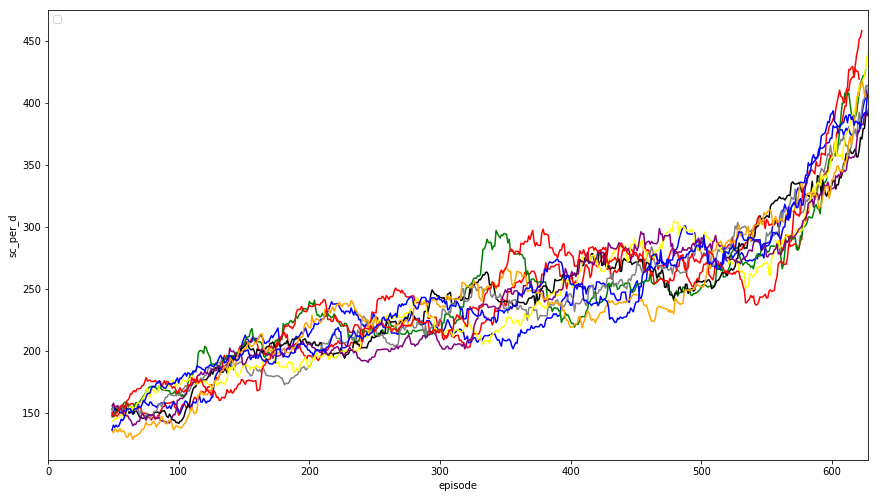

Reward Scatter Plot


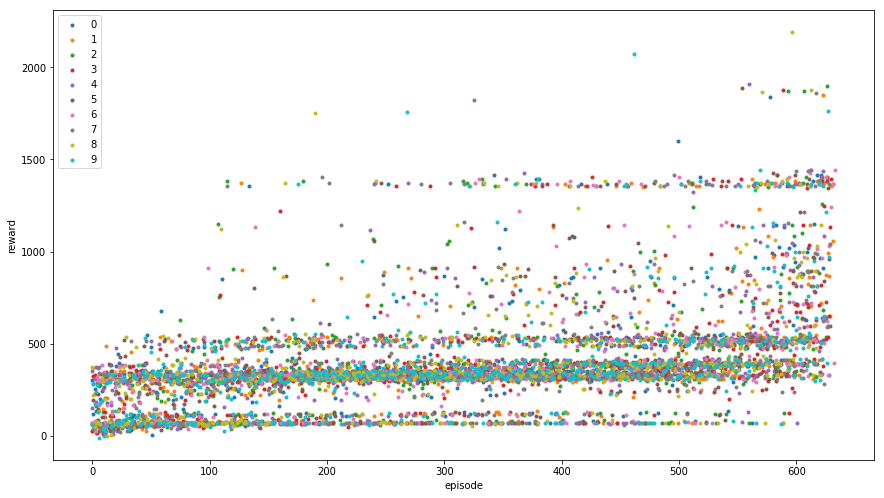

Timesteps Scatter Plot


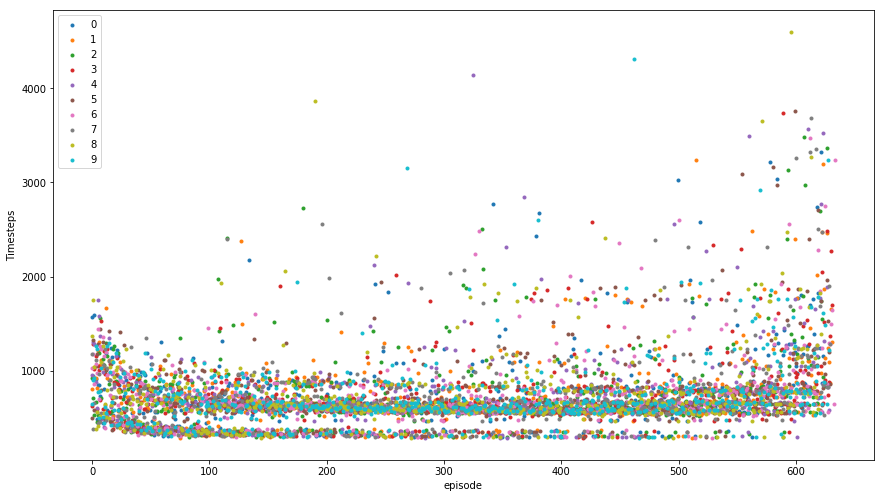

Success Scatter Plot


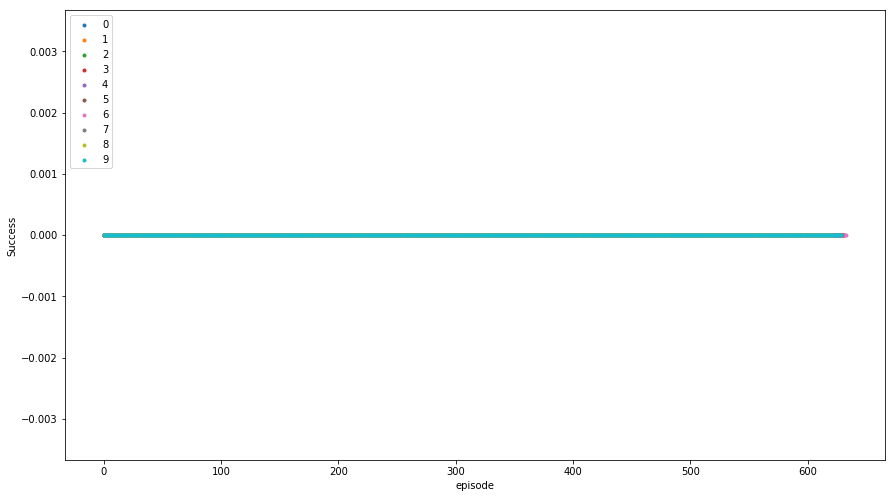

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


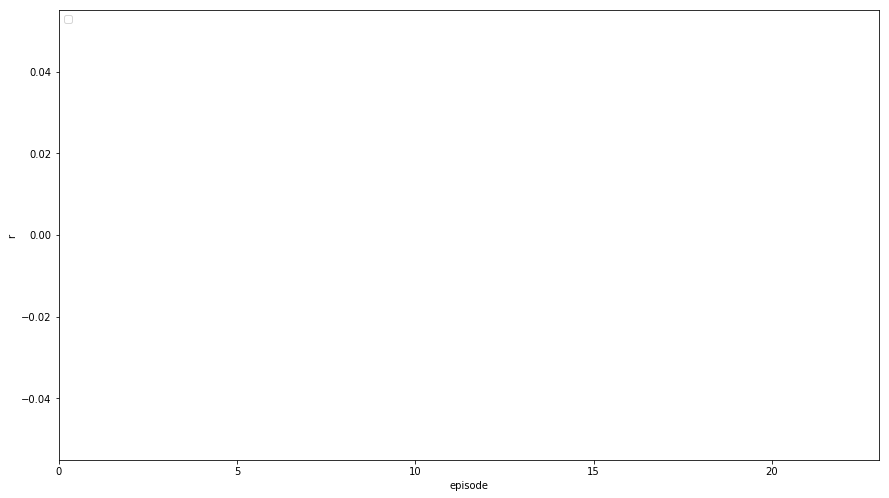

Rolling Plot l


No handles with labels found to put in legend.


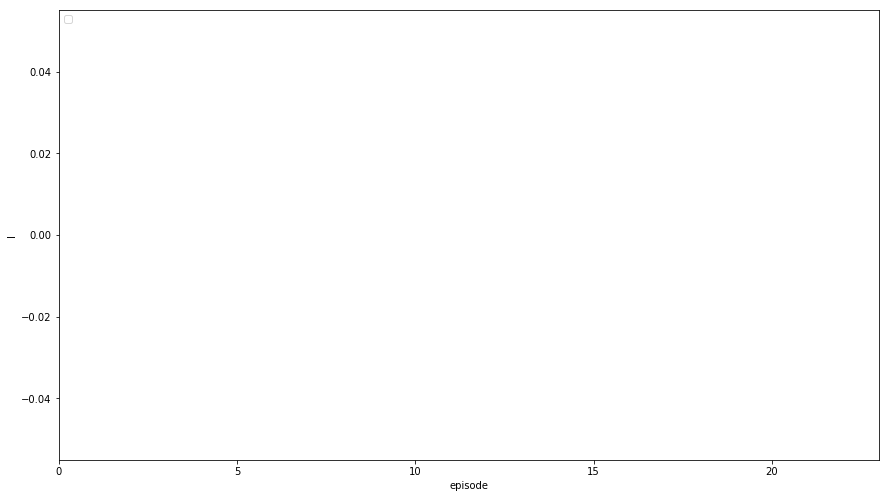

Rolling Plot success


No handles with labels found to put in legend.


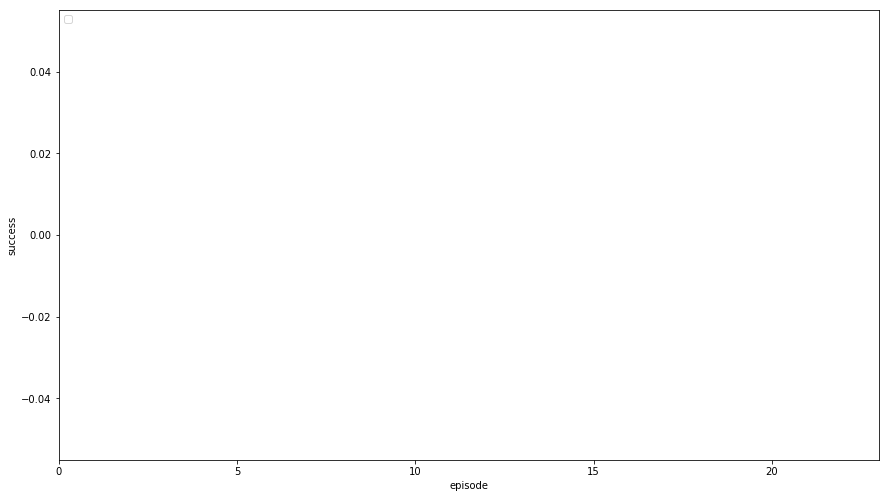

Rolling Plot sc_per_d


No handles with labels found to put in legend.


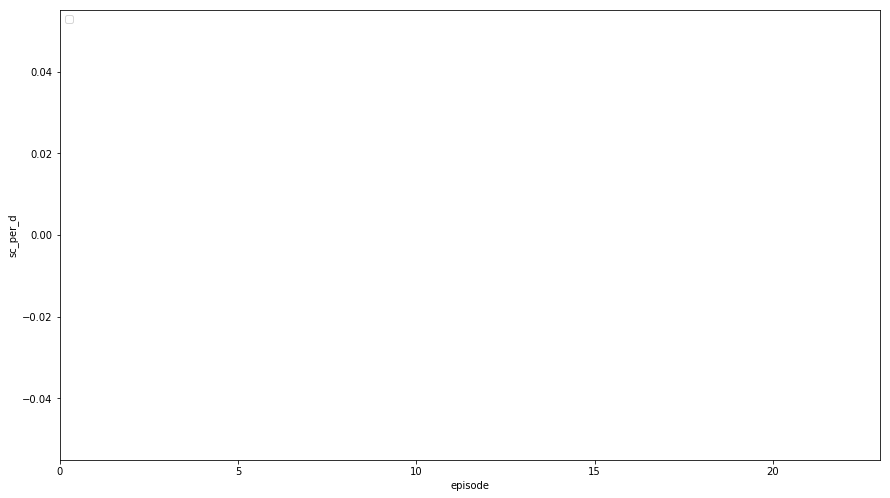

Reward Scatter Plot


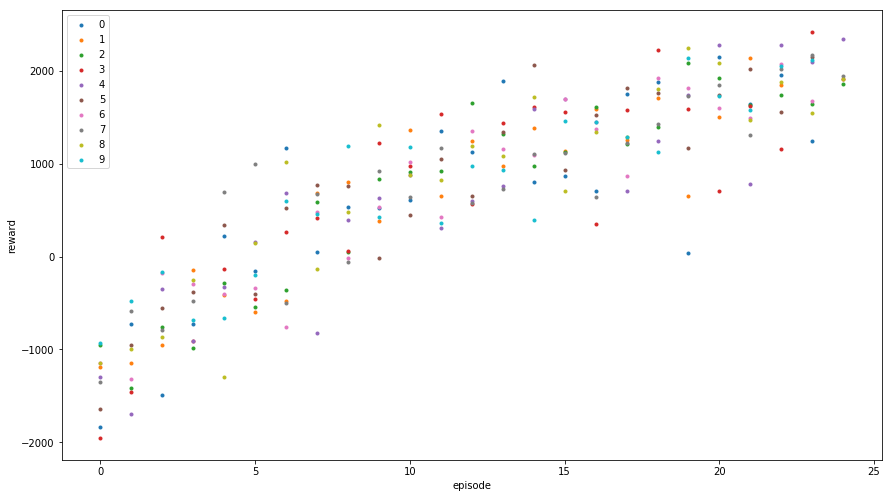

Timesteps Scatter Plot


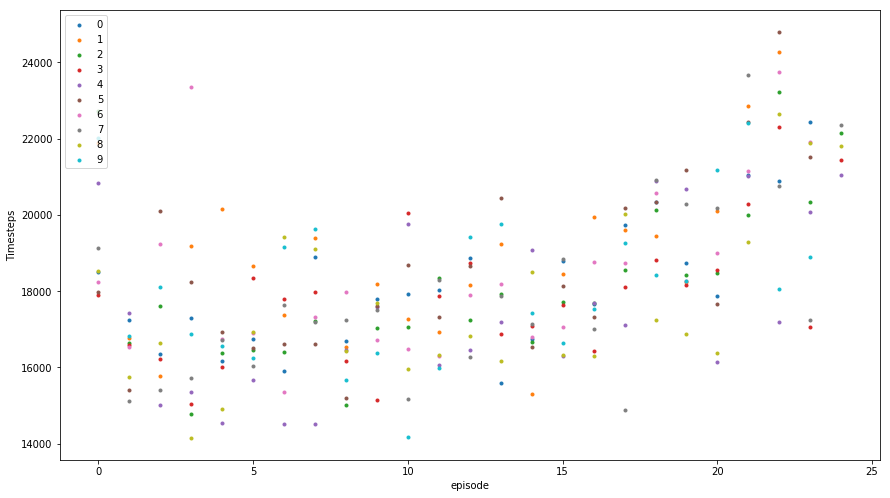

Success Scatter Plot


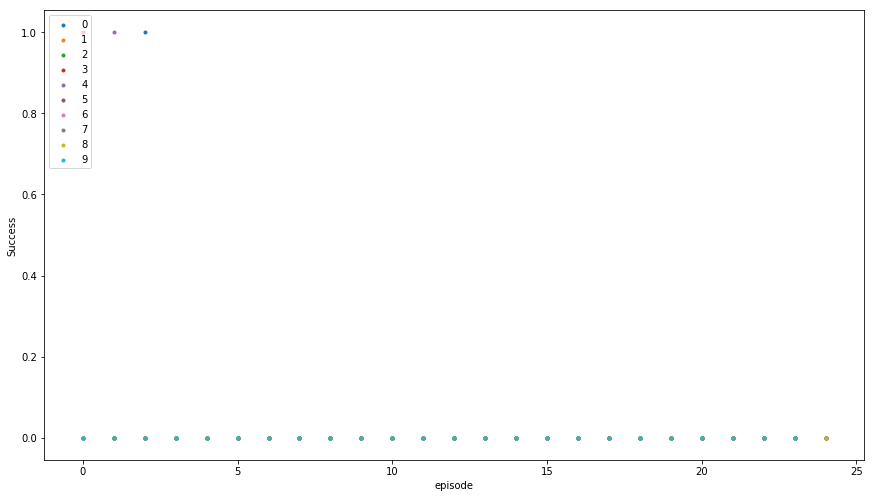

In [3]:
#/home/jim/projects/contra/videos/1542318787_0
#aborted run
get_results(time_id=1542318787,base_dir='logs',df_mod=2)

logs/log_1542224267_0.monitor.csv
logs/log_1542224267_1.monitor.csv
logs/log_1542224267_2.monitor.csv
logs/log_1542224267_3.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542224267_4.monitor.csv
logs/log_1542224267_5.monitor.csv
logs/log_1542224267_6.monitor.csv
logs/log_1542224267_7.monitor.csv
logs/log_1542224267_8.monitor.csv
logs/log_1542224267_9.monitor.csv
logs/log_1542224267_10.monitor.csv
logs/log_1542224267_11.monitor.csv
Mean Reward last 100 Episodes per env: 2683.5637942300004
Mean Reward last 100 Episodes per env: 3846.69388814
Mean Reward last 100 Episodes per env: 3665.426405619999
Mean Reward last 100 Episodes per env: 4846.35920995
Mean Reward last 100 Episodes per env: 2720.7338314200006
Mean Reward last 100 Episodes per env: 3897.3639388299994
Mean Reward last 100 Episodes per env: 3789.0480359299995
Mean Reward last 100 Episodes per env: 4858.63801002
Mean Reward last 100 Episodes per env: 2920.3033311400004
Mean Reward last 100 Episodes per env: 3903.4539453400002
Mean Reward last 100 Episodes per env: 3866.1054102900007
Mean Reward last 100 Episodes per env: 4858.1554098900015
Mod DataFrame Descriptions 0
                 

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


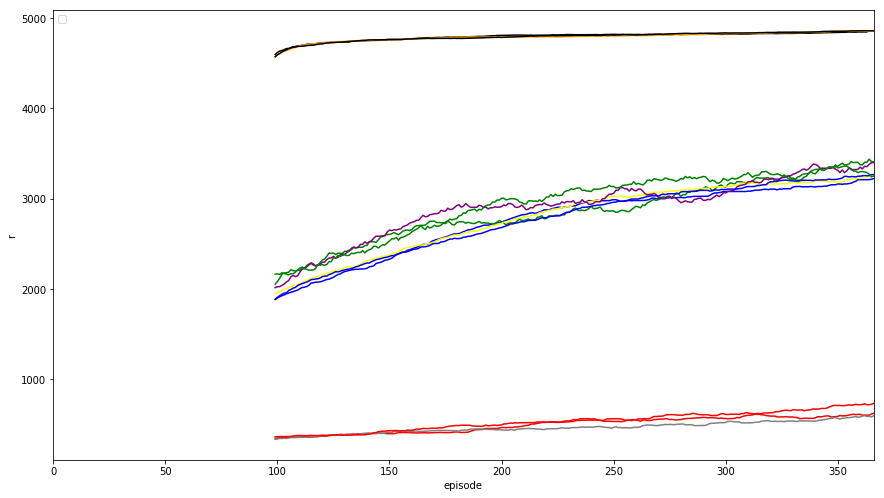

Rolling Plot l


No handles with labels found to put in legend.


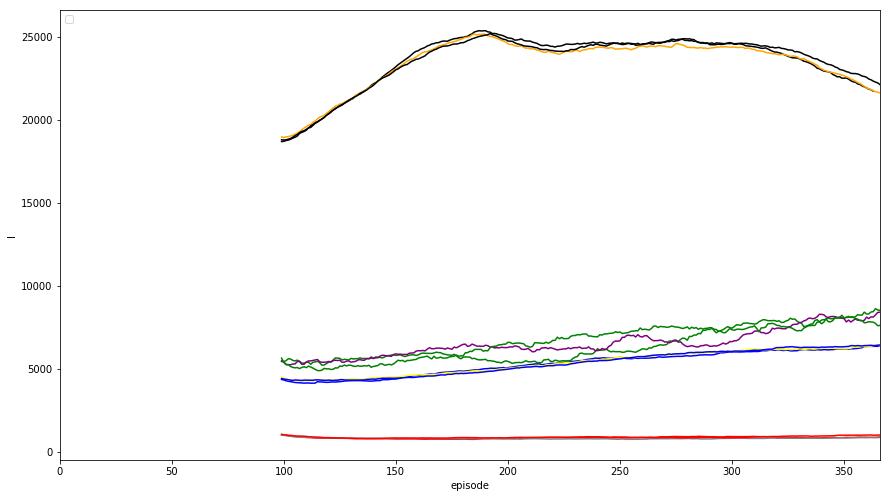

Rolling Plot success


No handles with labels found to put in legend.


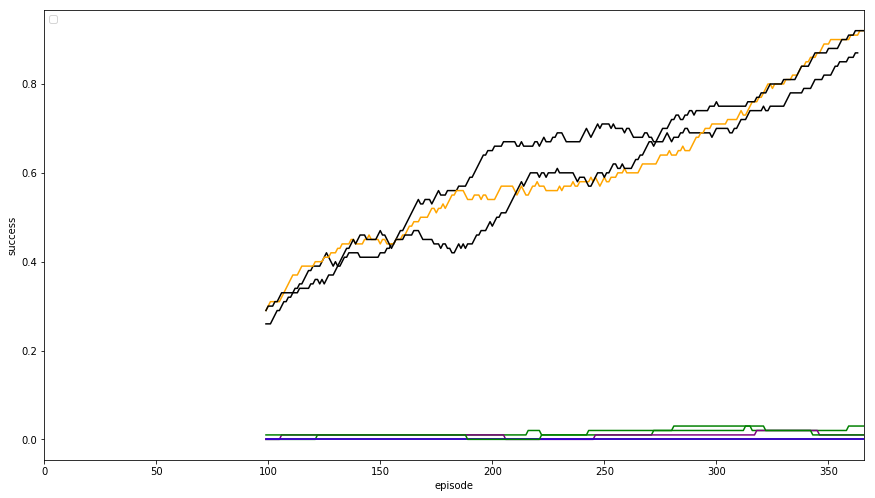

Rolling Plot sc_per_d


No handles with labels found to put in legend.


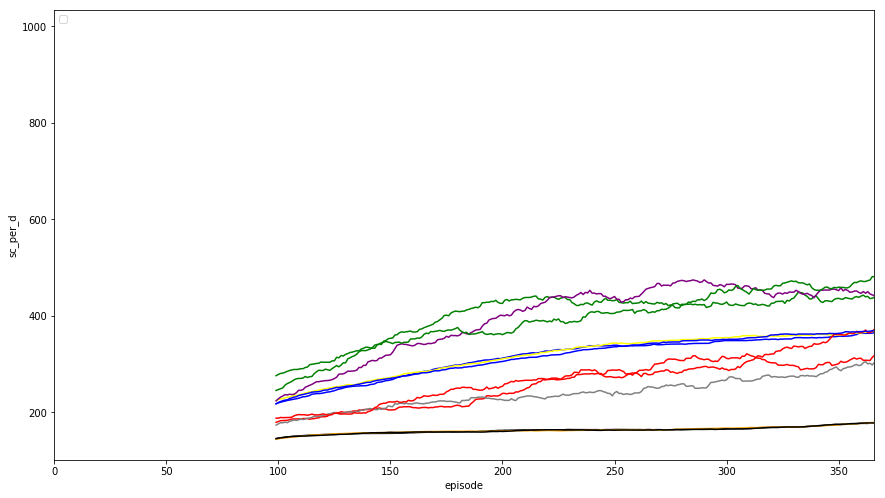

Reward Scatter Plot


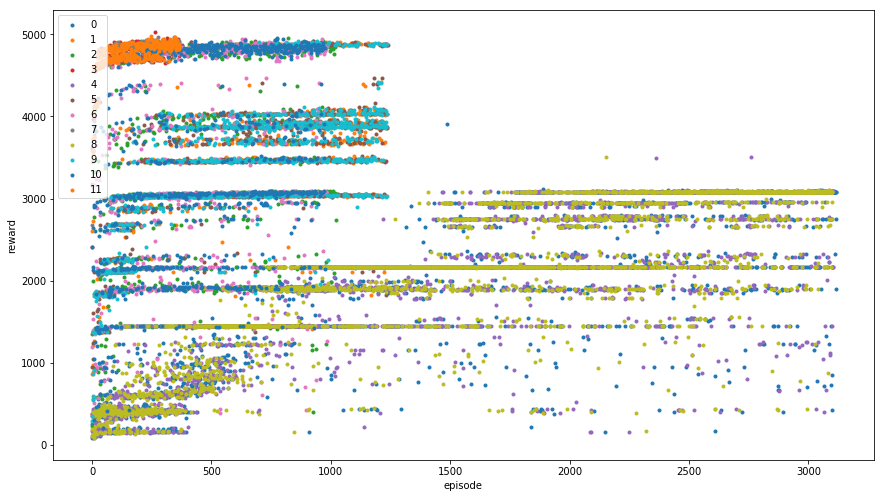

Timesteps Scatter Plot


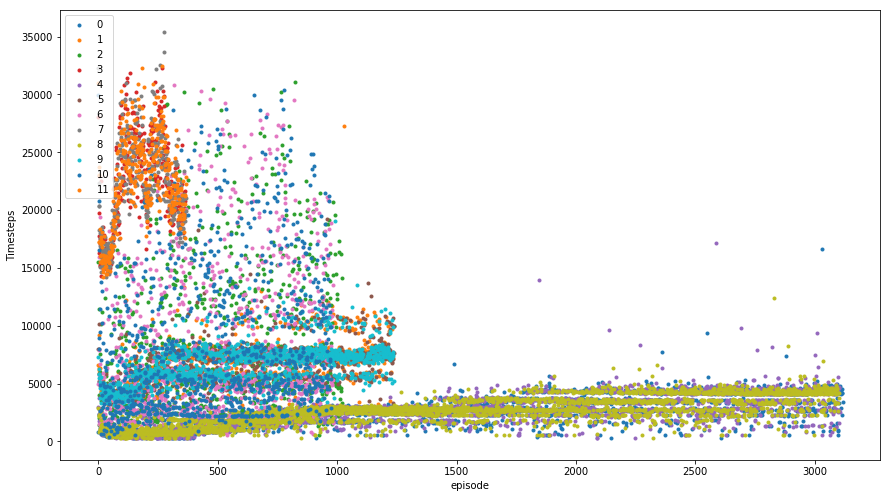

Success Scatter Plot


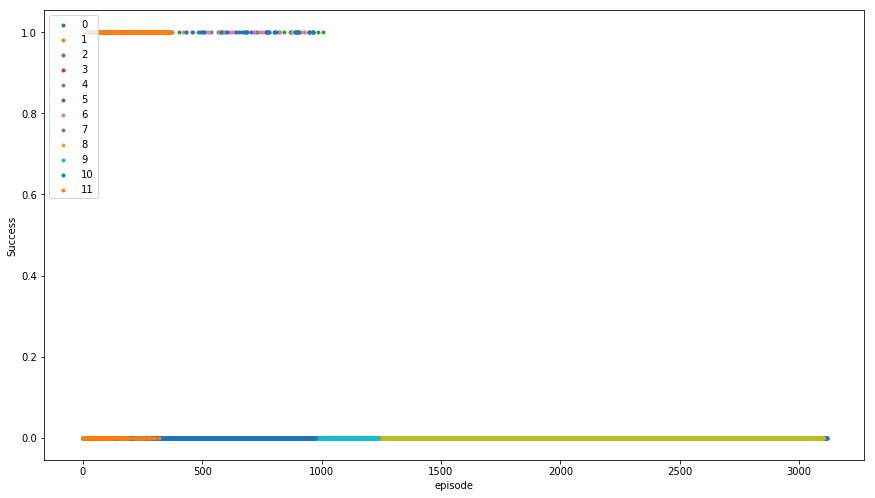

Doing rolling comparison for df mod 0
Rolling Plot r


No handles with labels found to put in legend.


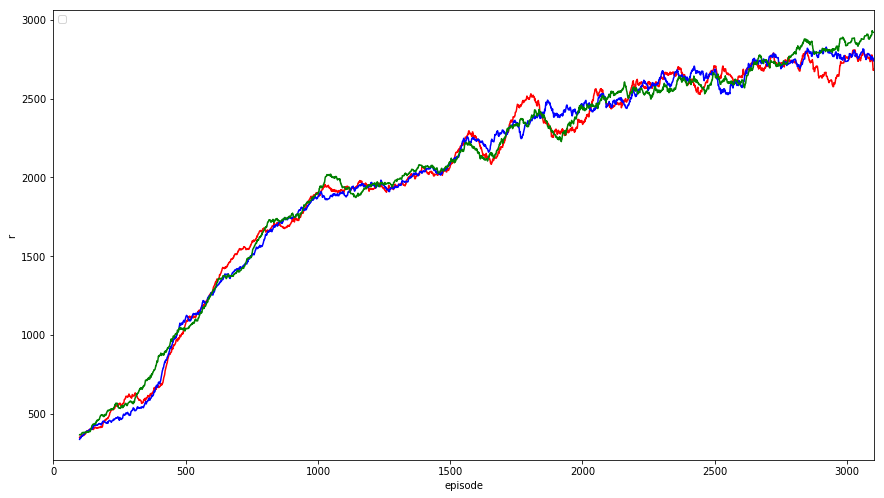

Rolling Plot l


No handles with labels found to put in legend.


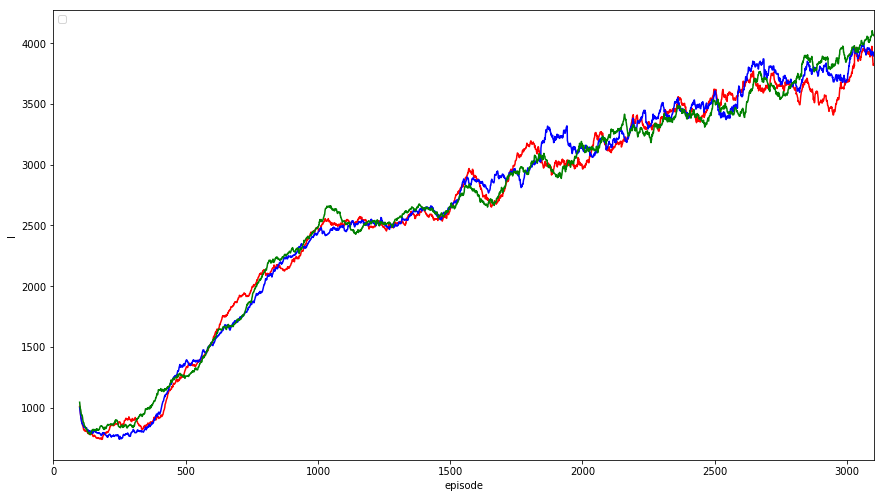

Rolling Plot success


No handles with labels found to put in legend.


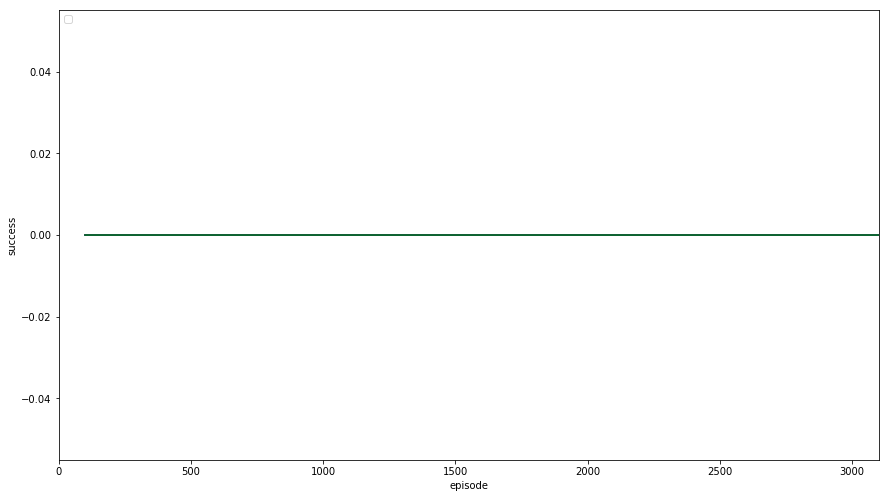

Rolling Plot sc_per_d


No handles with labels found to put in legend.


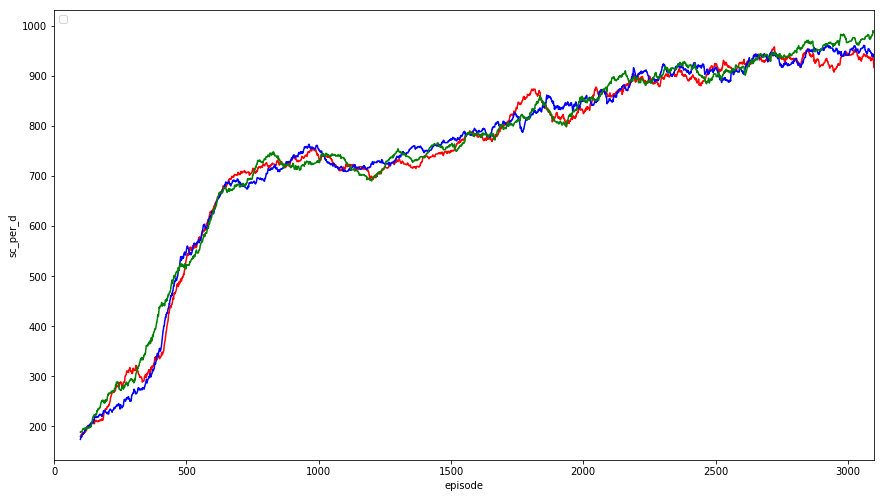

Reward Scatter Plot


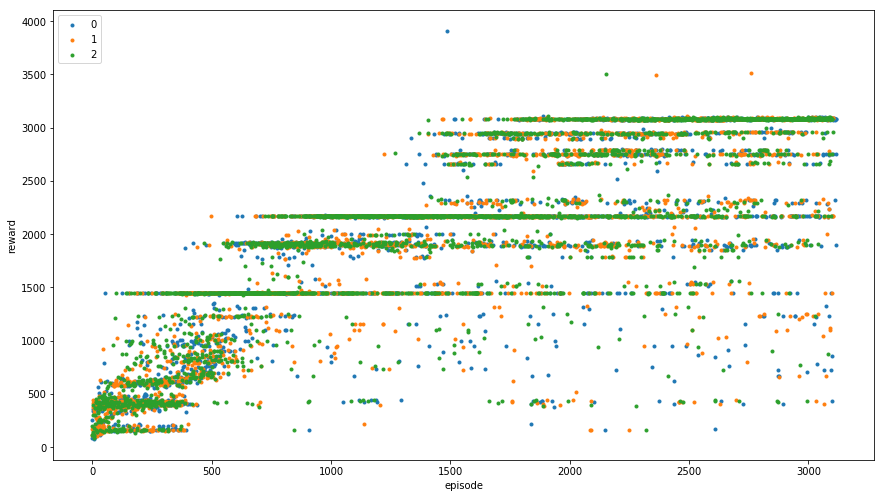

Timesteps Scatter Plot


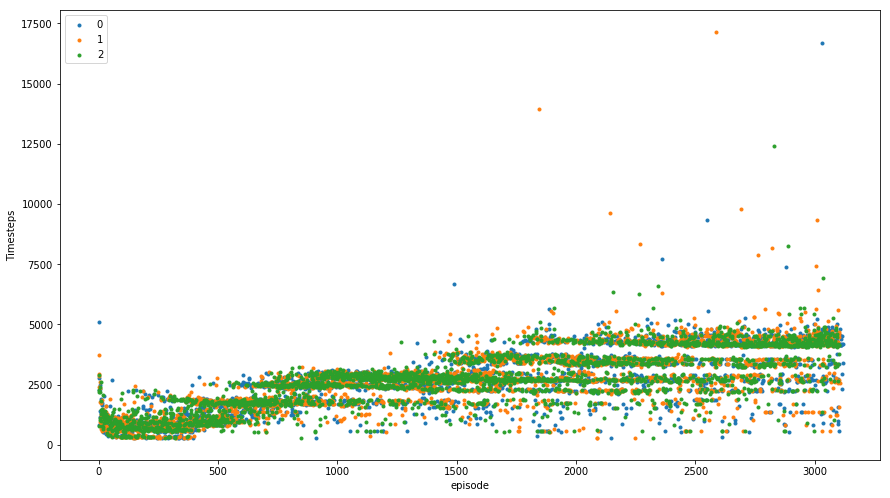

Success Scatter Plot


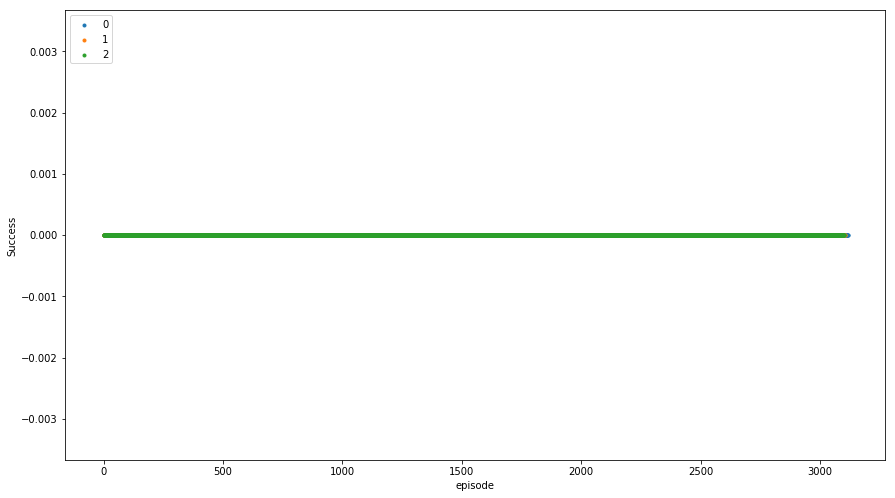

Doing rolling comparison for df mod 1
Rolling Plot r


No handles with labels found to put in legend.


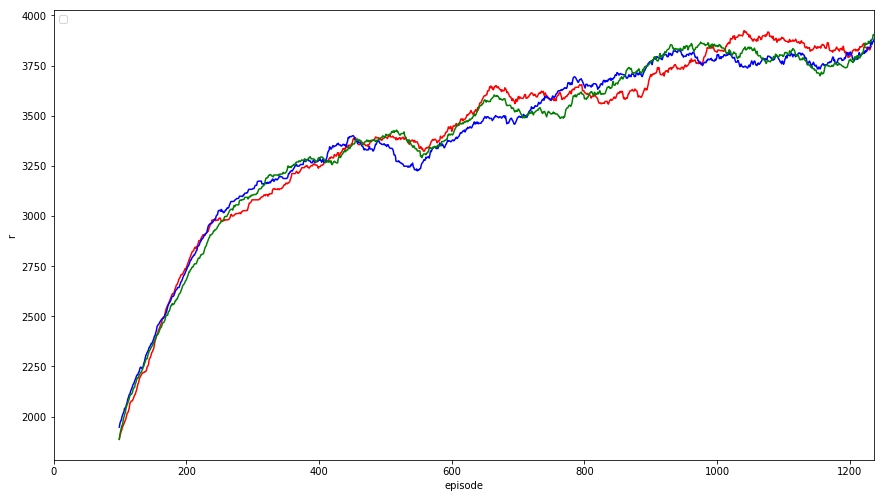

Rolling Plot l


No handles with labels found to put in legend.


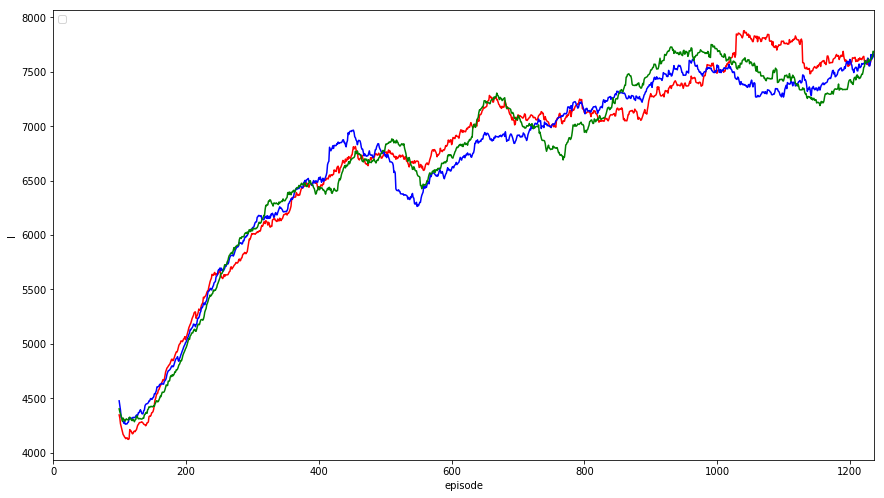

Rolling Plot success


No handles with labels found to put in legend.


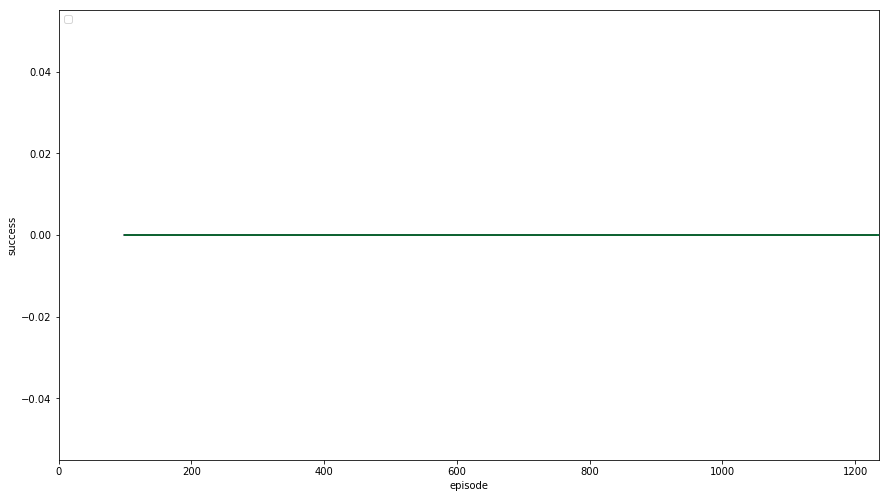

Rolling Plot sc_per_d


No handles with labels found to put in legend.


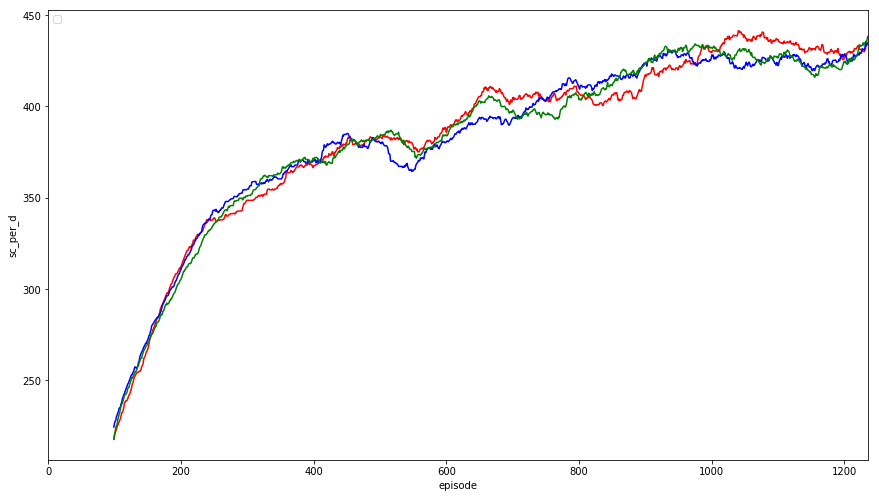

Reward Scatter Plot


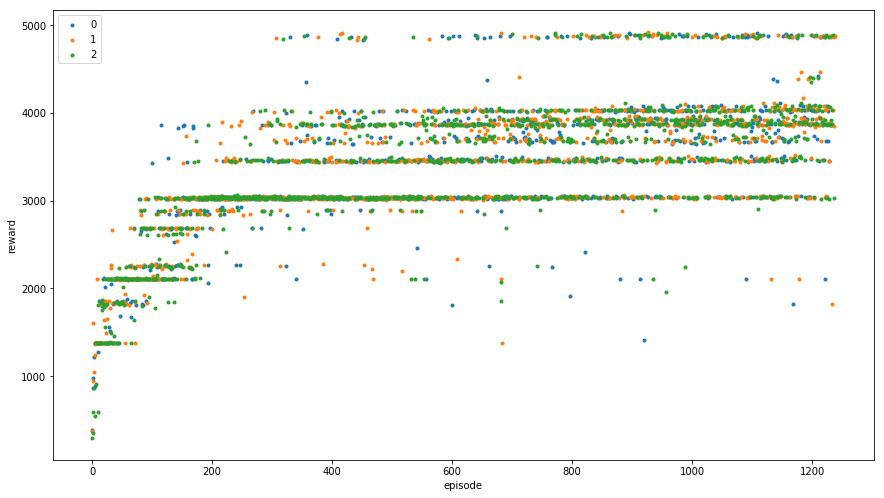

Timesteps Scatter Plot


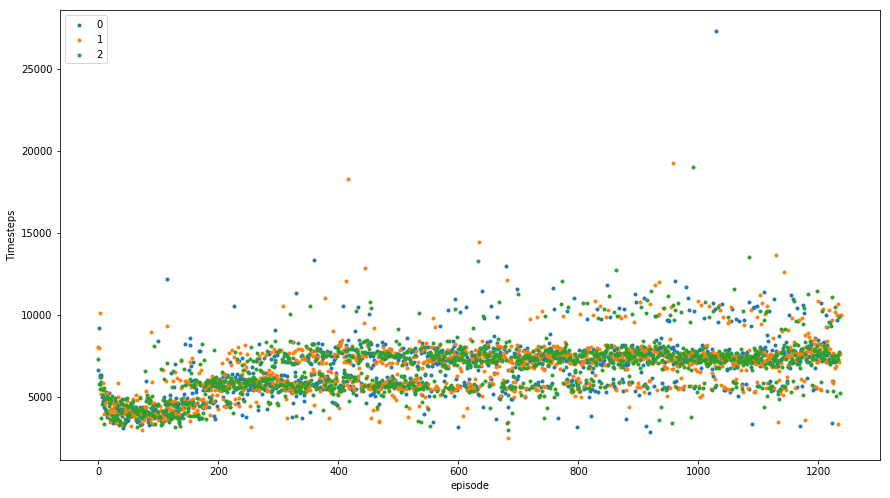

Success Scatter Plot


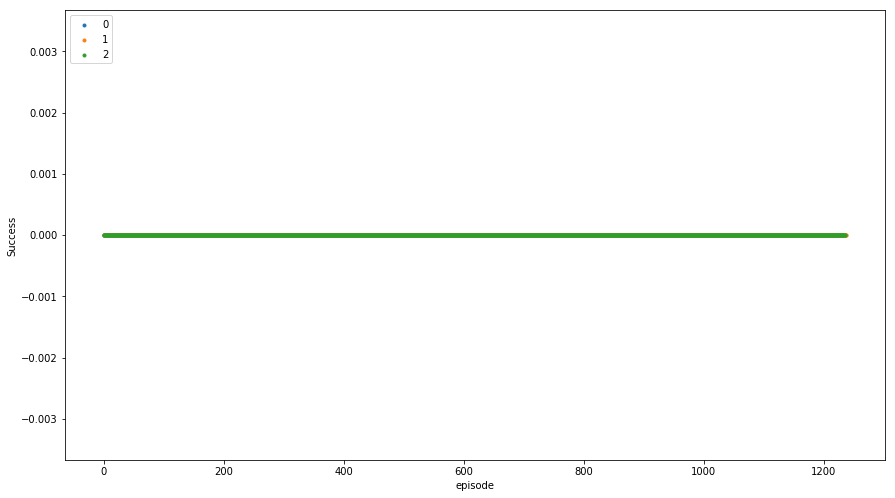

Doing rolling comparison for df mod 2
Rolling Plot r


No handles with labels found to put in legend.


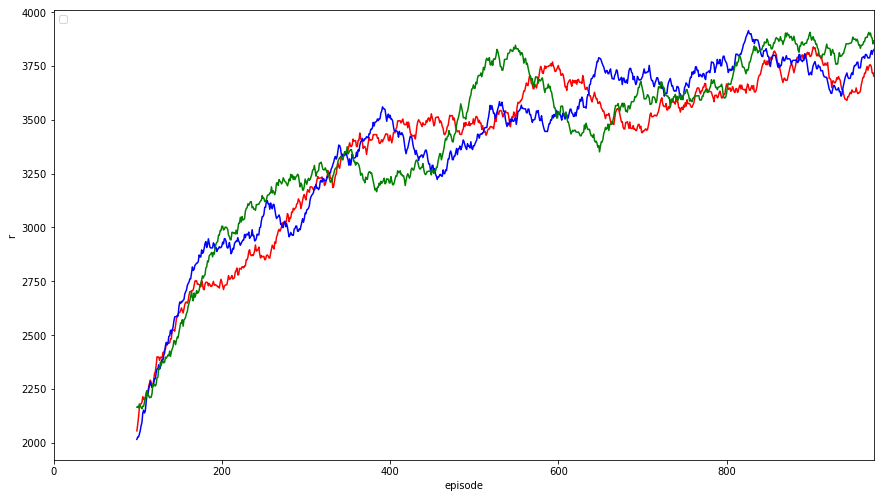

Rolling Plot l


No handles with labels found to put in legend.


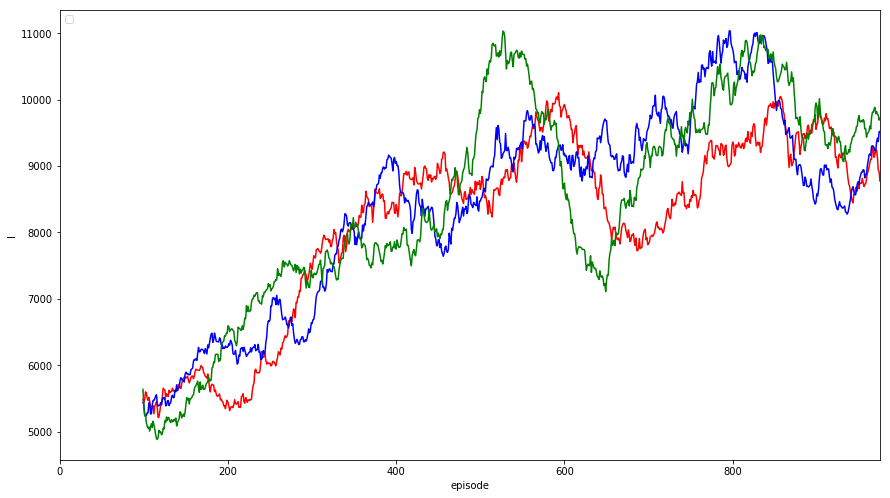

Rolling Plot success


No handles with labels found to put in legend.


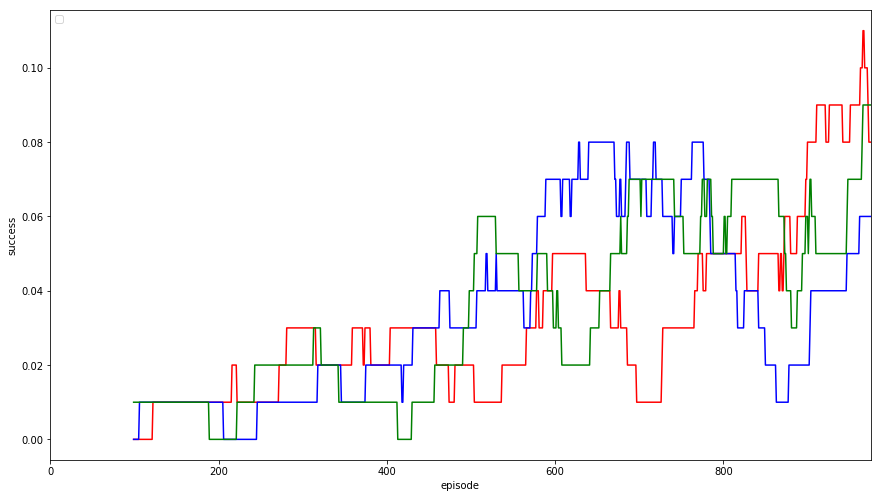

Rolling Plot sc_per_d


No handles with labels found to put in legend.


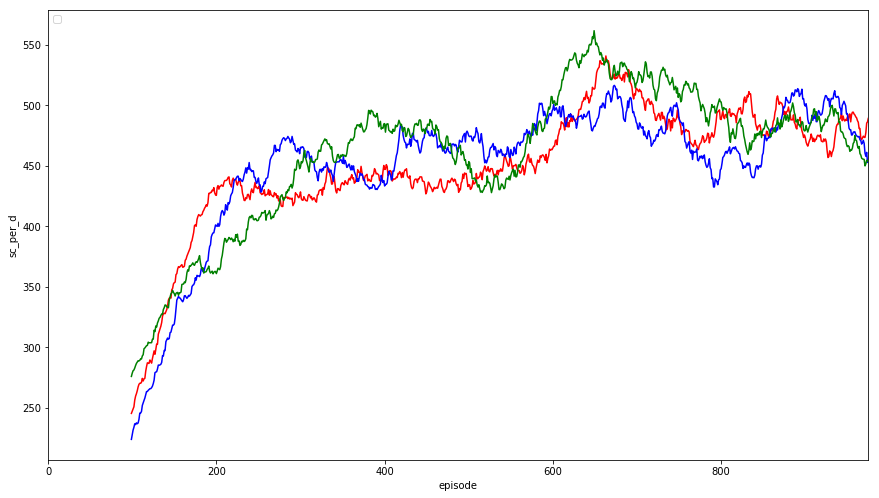

Reward Scatter Plot


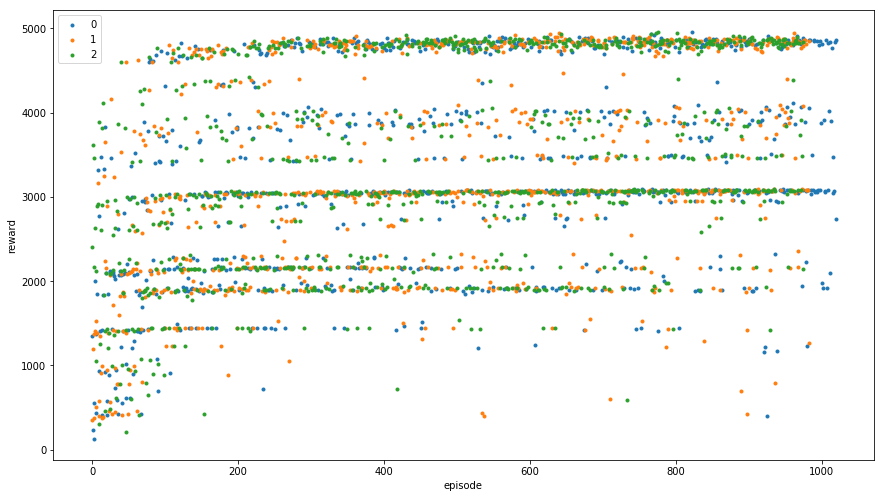

Timesteps Scatter Plot


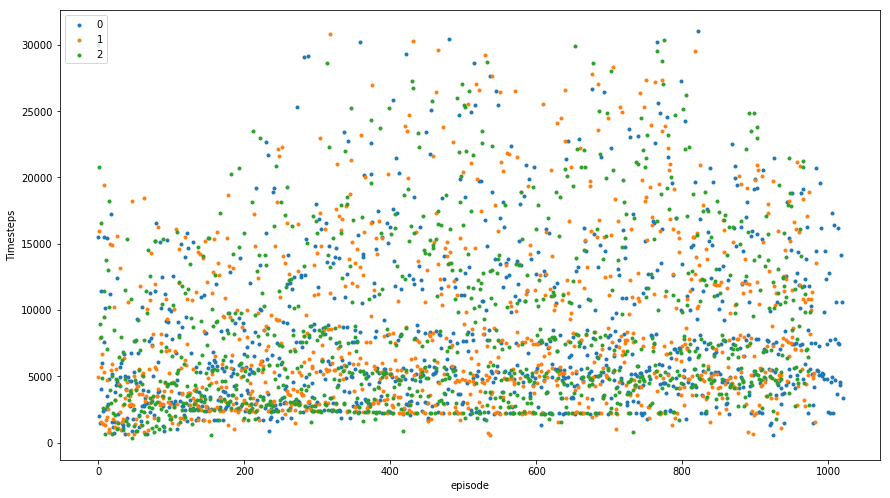

Success Scatter Plot


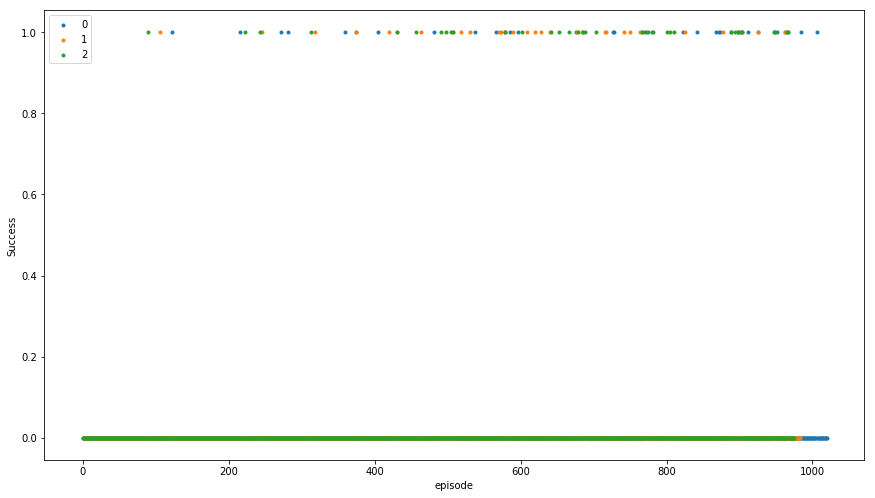

Doing rolling comparison for df mod 3
Rolling Plot r


No handles with labels found to put in legend.


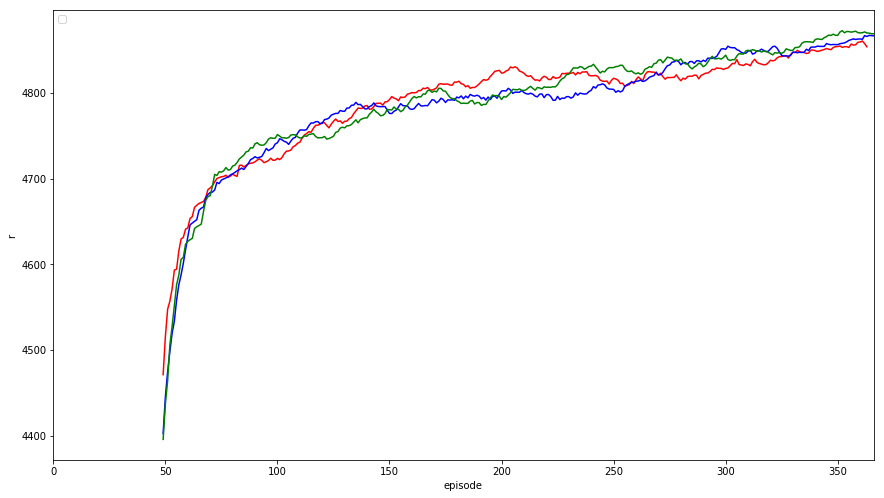

Rolling Plot l


No handles with labels found to put in legend.


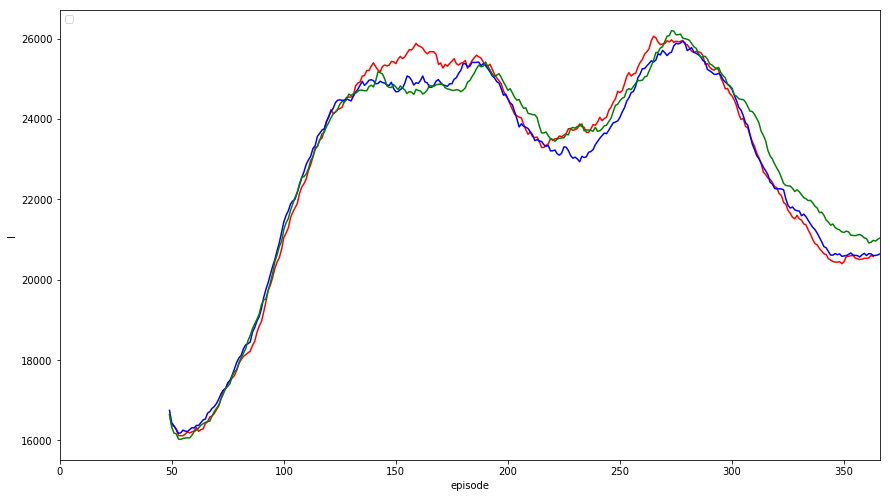

Rolling Plot success


No handles with labels found to put in legend.


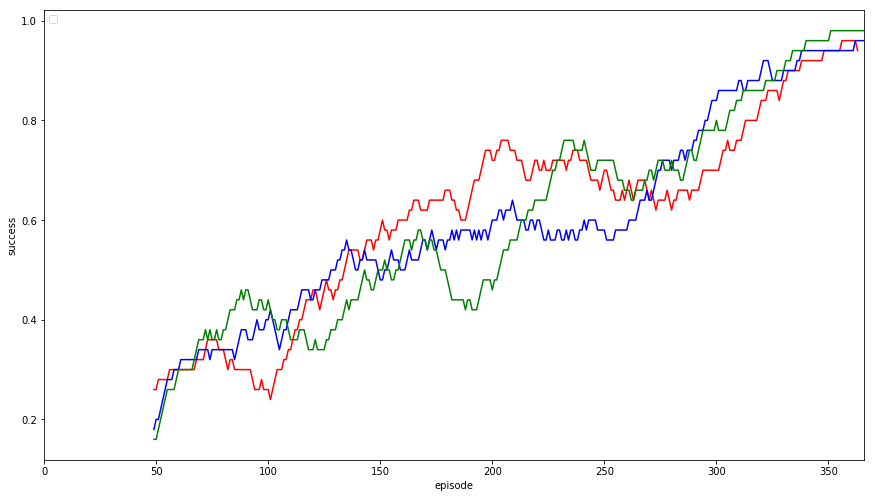

Rolling Plot sc_per_d


No handles with labels found to put in legend.


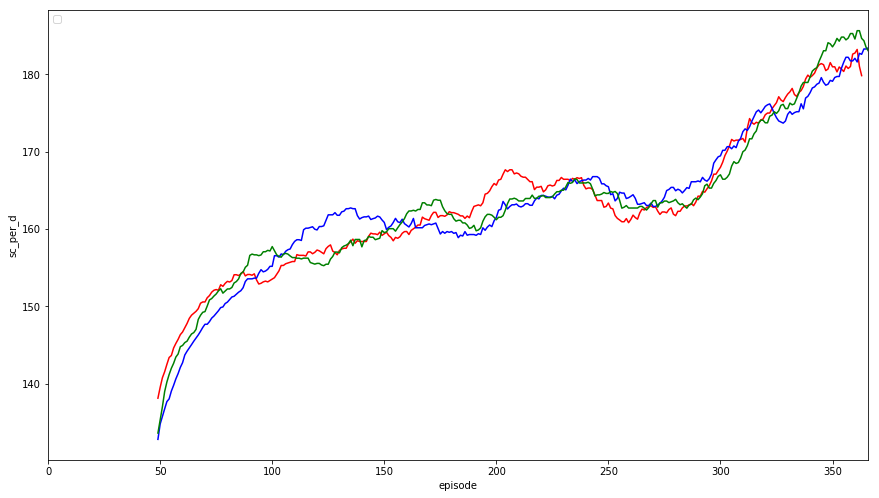

Reward Scatter Plot


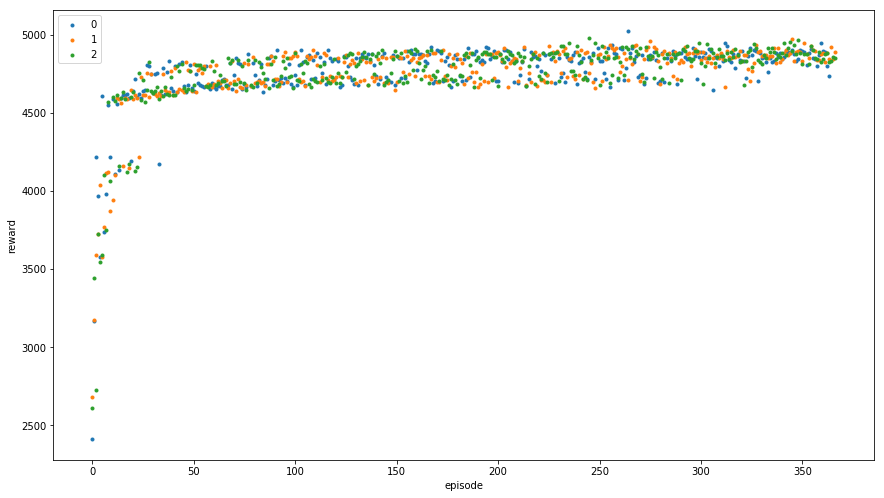

Timesteps Scatter Plot


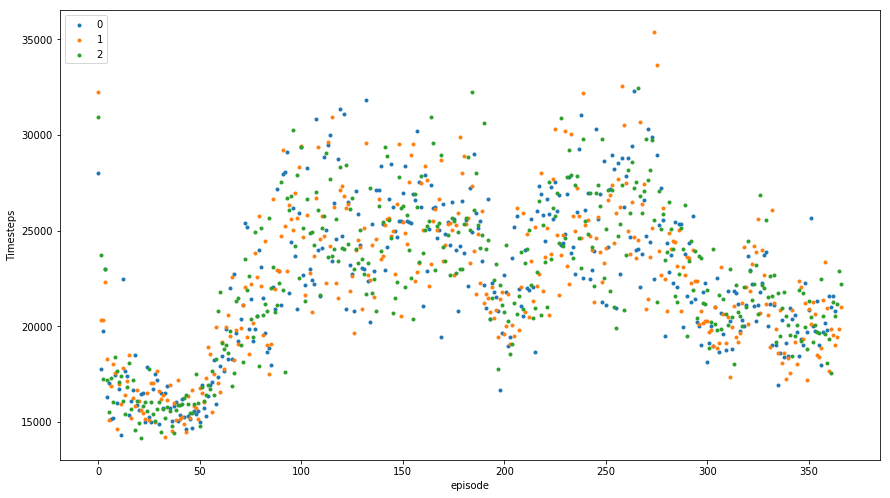

Success Scatter Plot


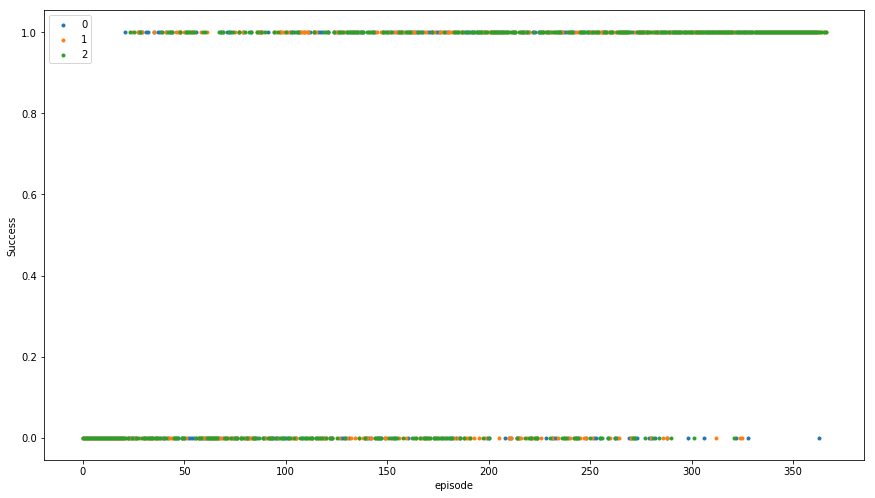

In [5]:
#/home/jim/projects/contra/logs/log_1542224267_1.monitor.csv
#test run 9
#half size images and color
get_results(time_id=1542224267,base_dir='logs',df_mod=4)

logs/log_1542147846_0.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


logs/log_1542147846_1.monitor.csv
logs/log_1542147846_2.monitor.csv
logs/log_1542147846_3.monitor.csv
logs/log_1542147846_4.monitor.csv
logs/log_1542147846_5.monitor.csv
logs/log_1542147846_6.monitor.csv
logs/log_1542147846_7.monitor.csv
logs/log_1542147846_8.monitor.csv
logs/log_1542147846_9.monitor.csv
logs/log_1542147846_10.monitor.csv
logs/log_1542147846_11.monitor.csv
Mean Reward last 100 Episodes per env: 1751.3674609100003
Mean Reward last 100 Episodes per env: 3247.9132985200004
Mean Reward last 100 Episodes per env: 3385.23605012
Mean Reward last 100 Episodes per env: 4791.75891044
Mean Reward last 100 Episodes per env: 1719.4476291699998
Mean Reward last 100 Episodes per env: 3255.183306379999
Mean Reward last 100 Episodes per env: 3438.7976079200002
Mean Reward last 100 Episodes per env: 4794.75921054
Mean Reward last 100 Episodes per env: 1780.5169906999995
Mean Reward last 100 Episodes per env: 3263.303312610001
Mean Reward last 100 Episodes per env: 3448.91141545
Mean Rew

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)
No handles with labels found to put in legend.


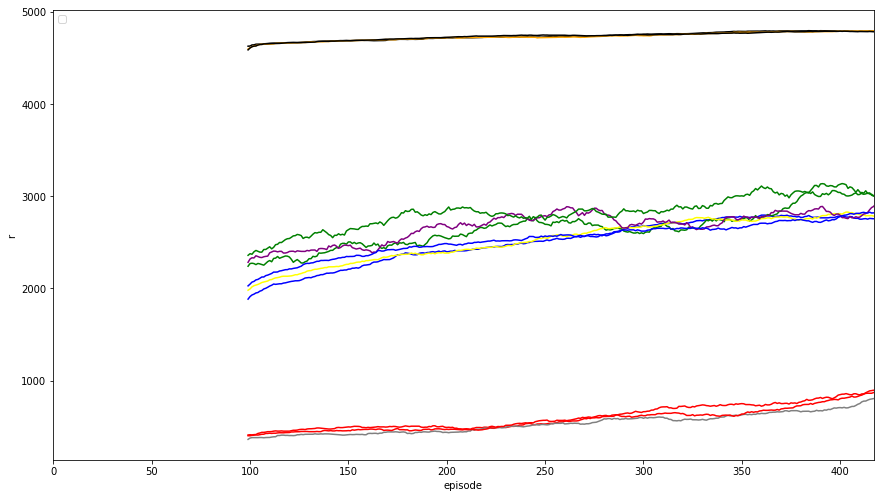

Rolling Plot l


No handles with labels found to put in legend.


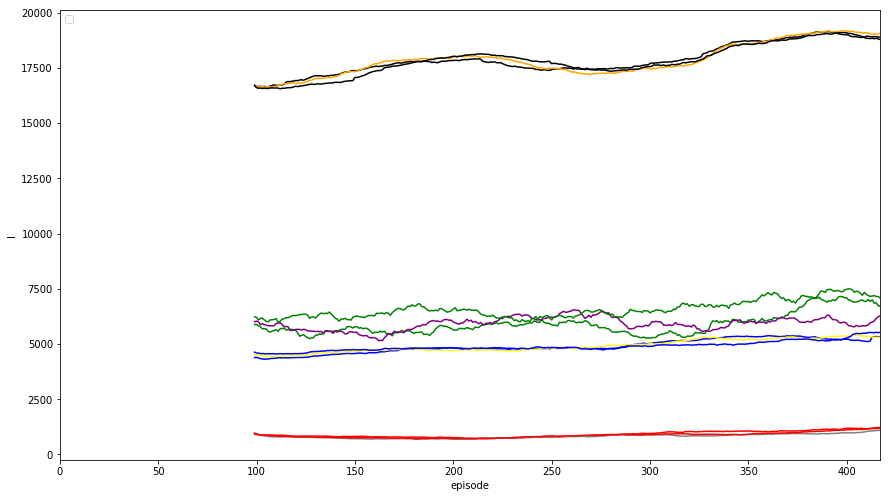

Rolling Plot success


No handles with labels found to put in legend.


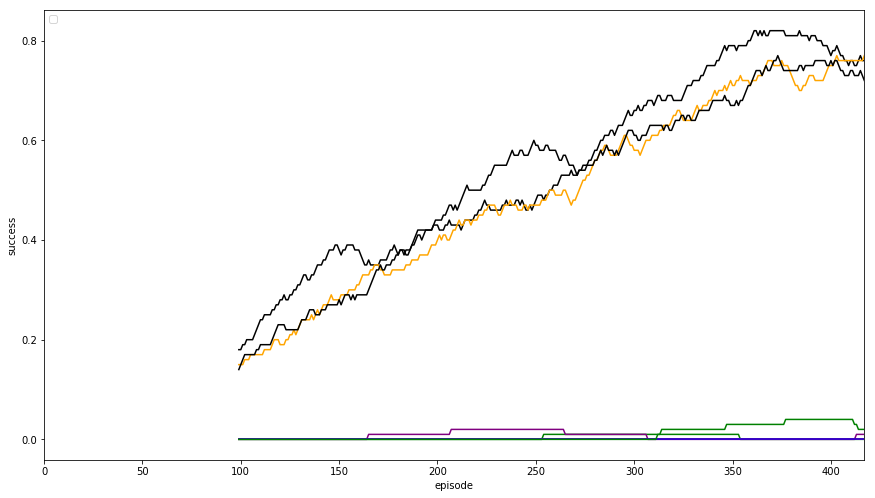

Rolling Plot sc_per_d


No handles with labels found to put in legend.


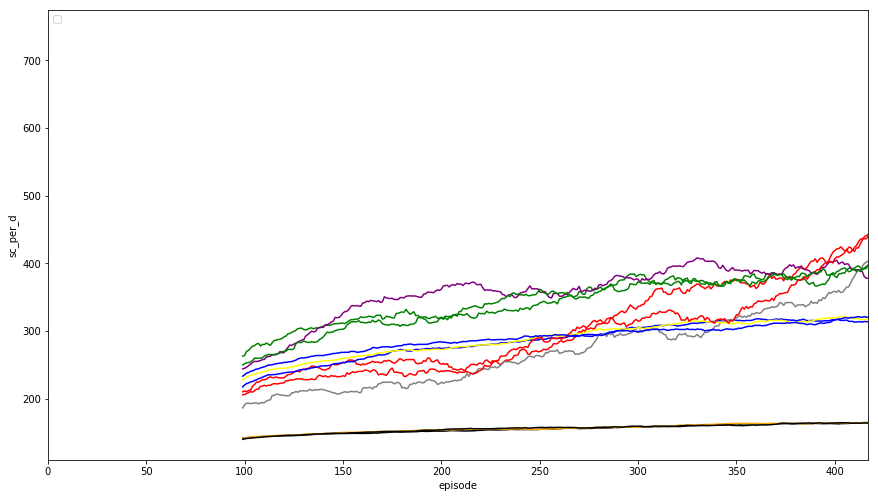

Reward Scatter Plot


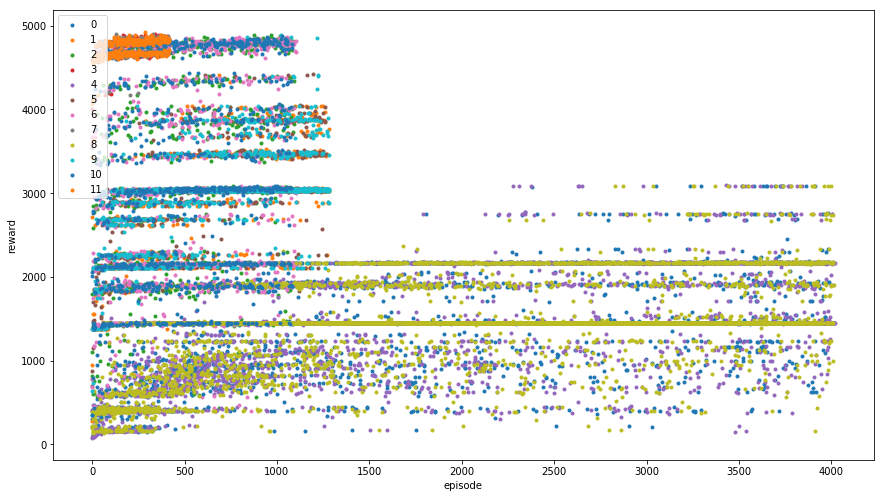

Timesteps Scatter Plot


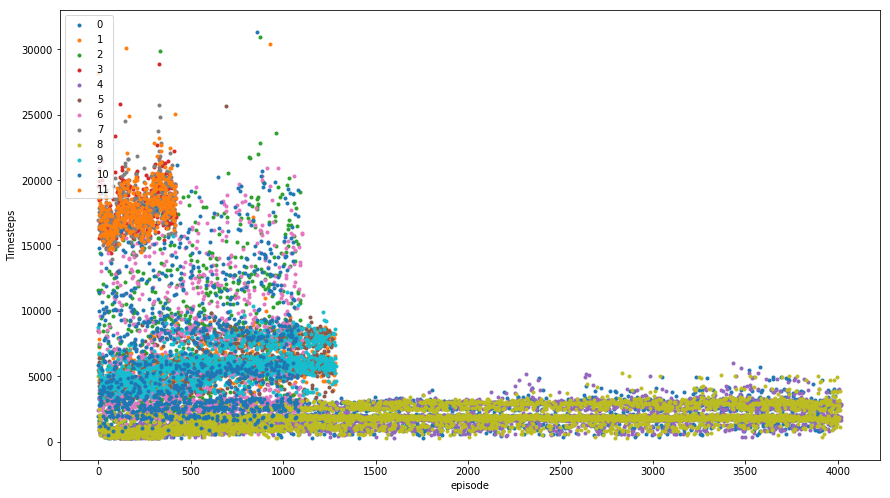

Success Scatter Plot


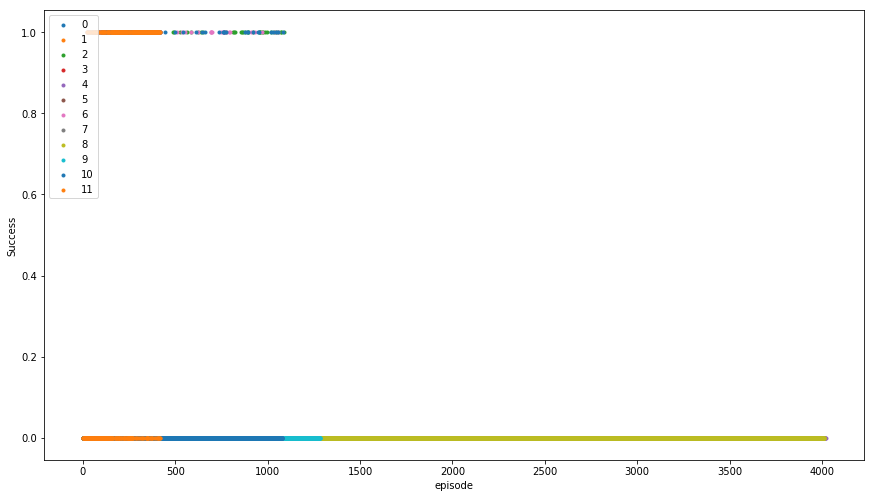

In [3]:
#/home/jim/projects/contra/logs/log_1542147846_10.monitor.csv
# test run 7, 4 different scripts
get_results(time_id=1542147846,base_dir='logs')

notes:
slight positive reward gain but not much
better sc per d, better rewards but successes are rare and none in the low life envs
percent of successes does go way up for the full runs

logs/log_1541977525_0.monitor.csv


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)


logs/log_1541977525_1.monitor.csv
logs/log_1541977525_2.monitor.csv
logs/log_1541977525_3.monitor.csv
Mean Reward last 100 Episodes per env: 2480.31466135
Mean Reward last 100 Episodes per env: 2627.68410755
Mean Reward last 100 Episodes per env: 2466.8418409900005
Mean Reward last 100 Episodes per env: 2450.94172582
                 r             l              t       t_diff       deaths  \
count  5622.000000   5622.000000    5622.000000  5618.000000  5622.000000   
mean   1963.967799   5221.169335   68988.846162   100.776096     9.757204   
std     926.678538   4065.142274   40357.369401    81.865269     8.870007   
min     128.990139    305.000000      91.502037     1.658157     1.000000   
25%    1406.951454   2325.250000   33715.456639    65.676954     3.000000   
50%    1900.951944   4075.000000   69198.161942    78.994140     7.000000   
75%    2348.974861   6837.000000  103054.636663   149.209165    13.000000   
max    4762.814909  28028.000000  141831.299930   547.911153    4

No handles with labels found to put in legend.


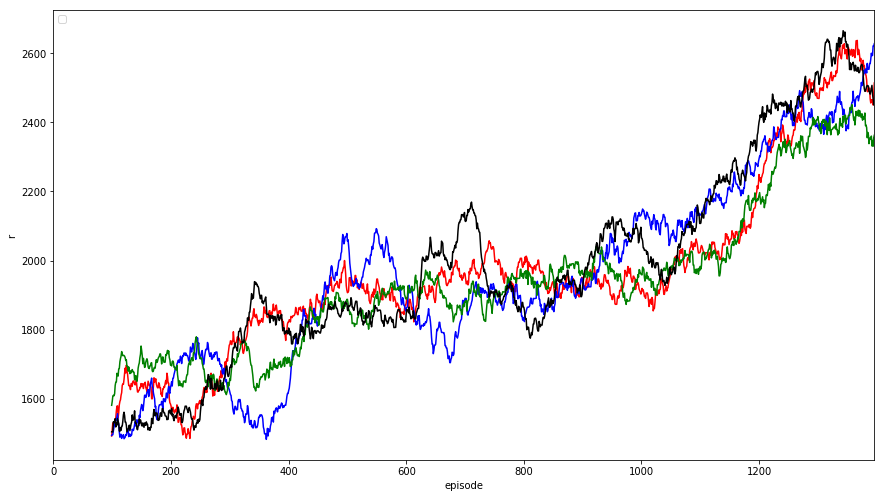

Rolling Plot l


No handles with labels found to put in legend.


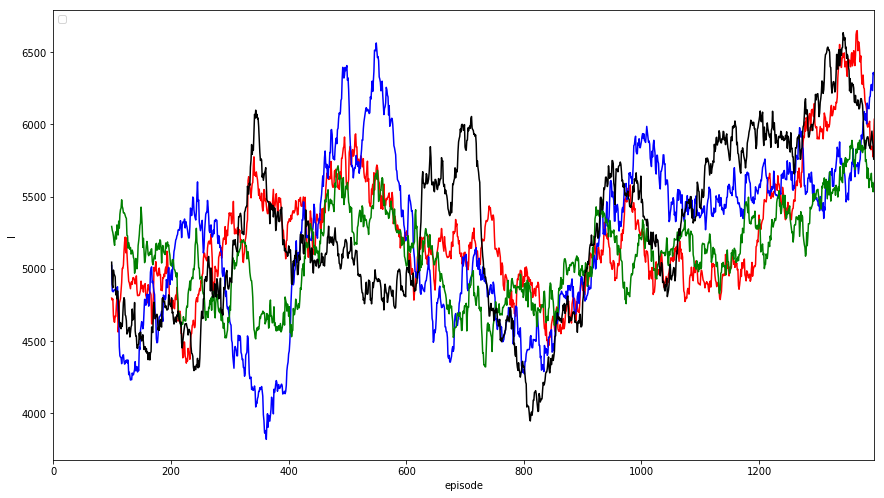

Rolling Plot success


No handles with labels found to put in legend.


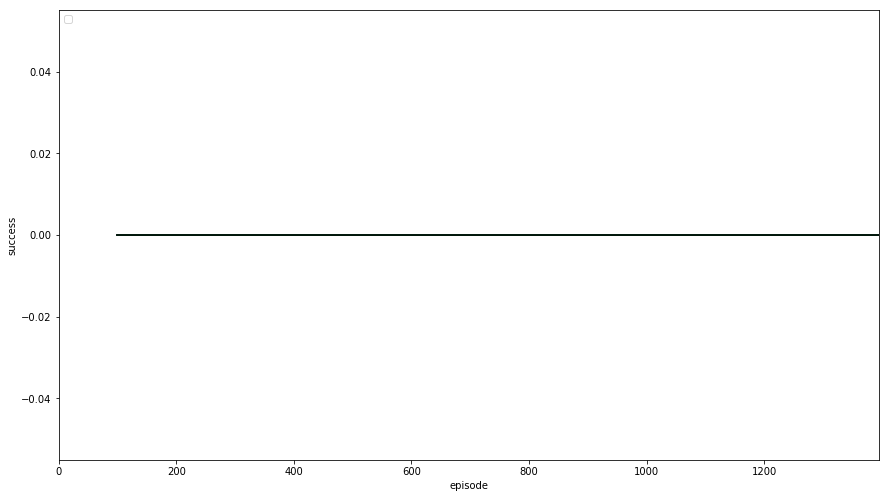

Rolling Plot sc_per_d


No handles with labels found to put in legend.


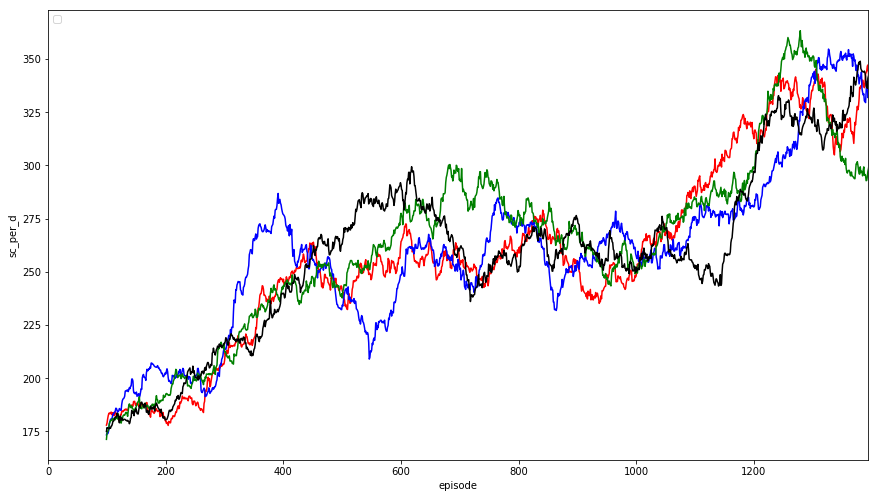

Reward Scatter Plot


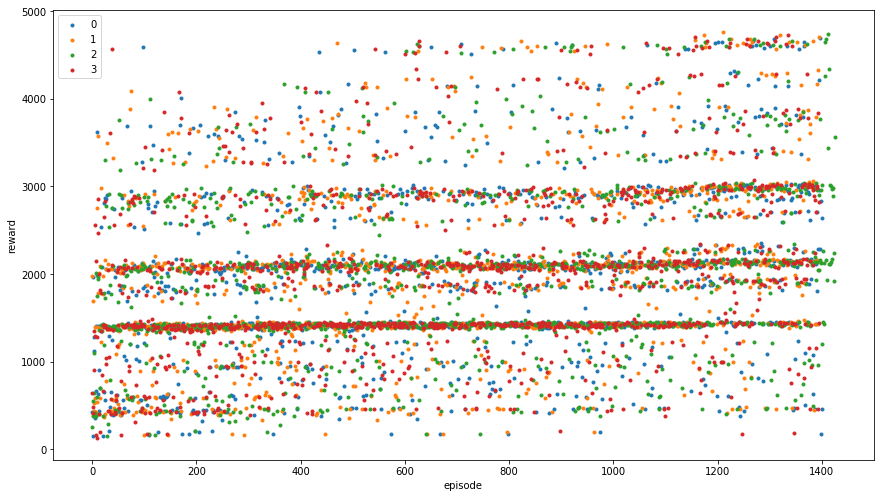

Timesteps Scatter Plot


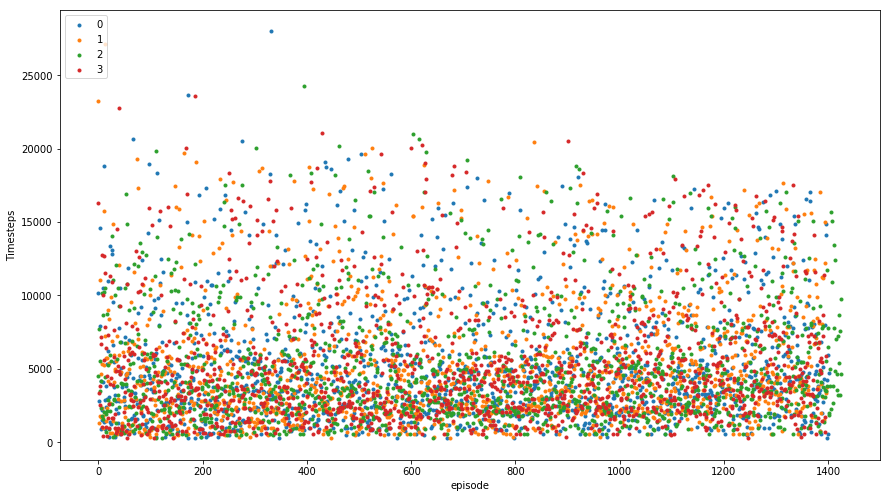

Success Scatter Plot


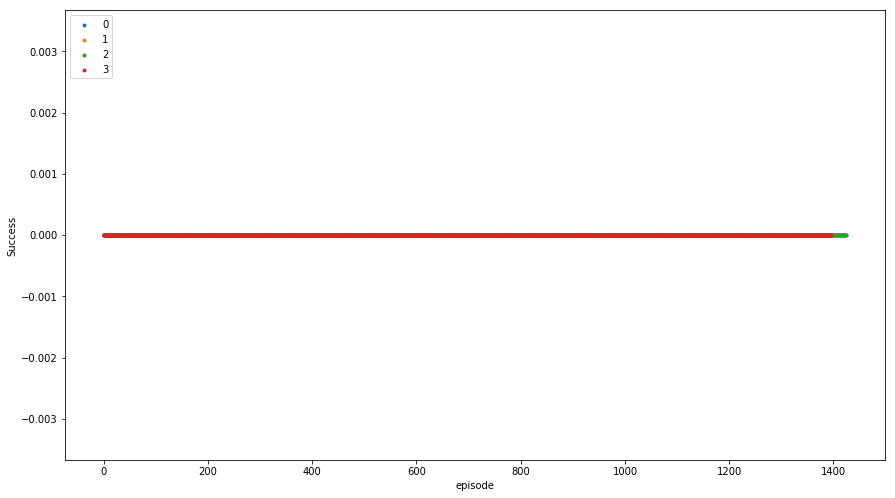

In [3]:
# /home/jim/projects/contra/logs/log_1541977525_0.monitor.csv
#test run 5 no grayscale or warp frame
get_results(time_id=1541977525,base_dir='logs')

logs
                 r             l             t       t_diff       deaths  \
count  2506.000000   2506.000000   2506.000000  2505.000000  2506.000000   
mean   3080.819650   8643.509577  15249.487912    12.817053    17.798085   
std    1417.437073   6022.411218   9181.647097     9.187549    12.055988   
min     235.980256    378.000000     25.521570     0.521512     1.000000   
25%    1876.201921   3265.250000   7172.636559     4.736951     7.000000   
50%    2969.868091   6969.500000  14703.850923    10.010941    15.000000   
75%    4612.632408  14368.250000  23221.963238    21.318969    29.000000   
max    4961.794911  30903.000000  32132.239149    51.113025    42.000000   

       success      scrolls     sc_per_d  
count   2506.0  2506.000000  2506.000000  
mean       0.0  3217.724661   199.883114  
std        0.0  1491.250523    61.950756  
min        0.0   246.000000    37.730769  
25%        0.0  1929.000000   153.181573  
50%        0.0  3091.000000   191.571429  
75%      

/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':


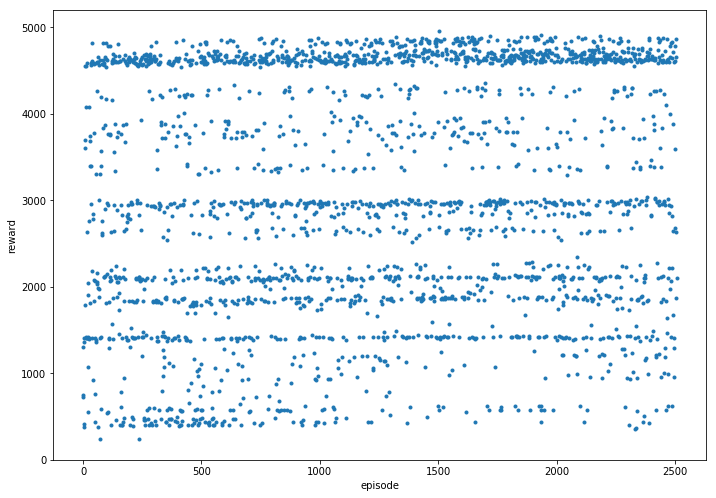

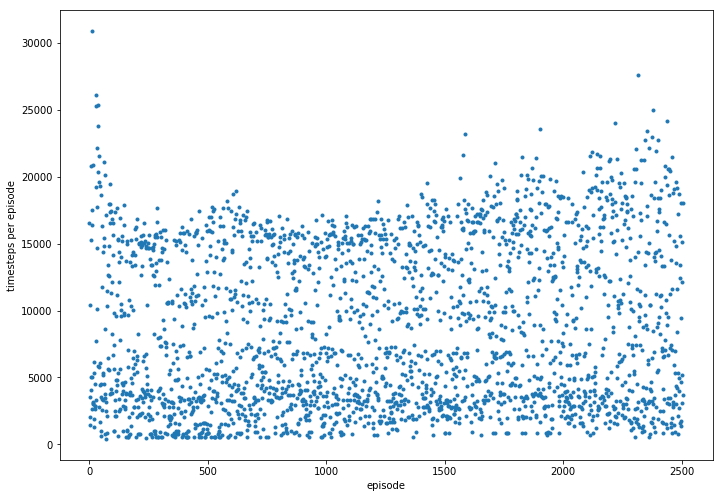

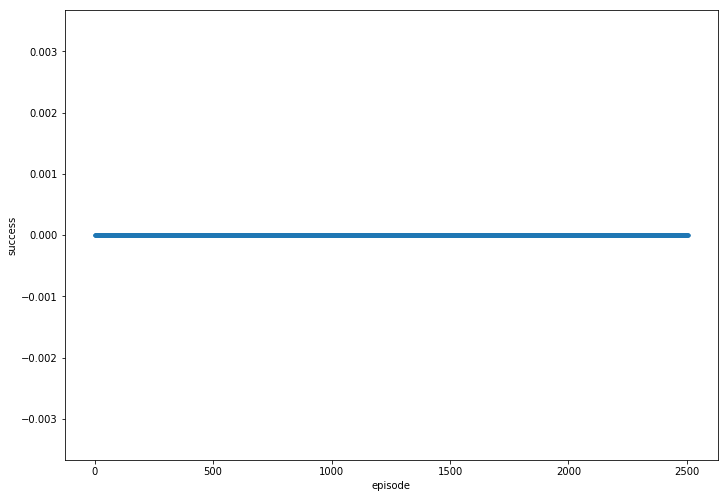

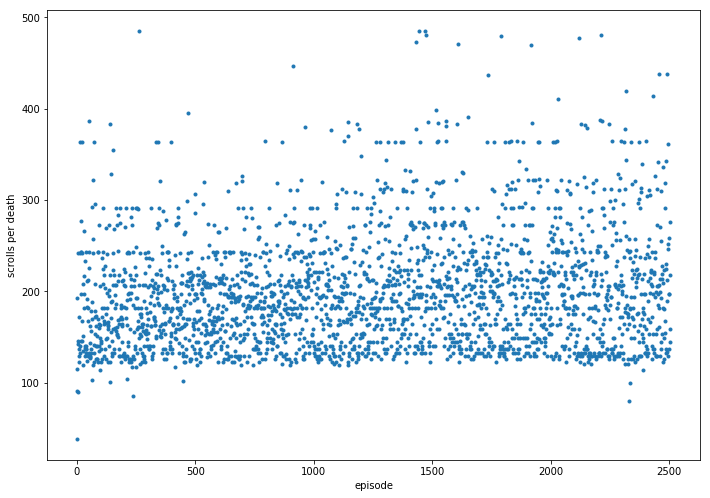

logs


/home/jim/anaconda3/envs/tf3/lib/python3.6/site-packages/seaborn/timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)


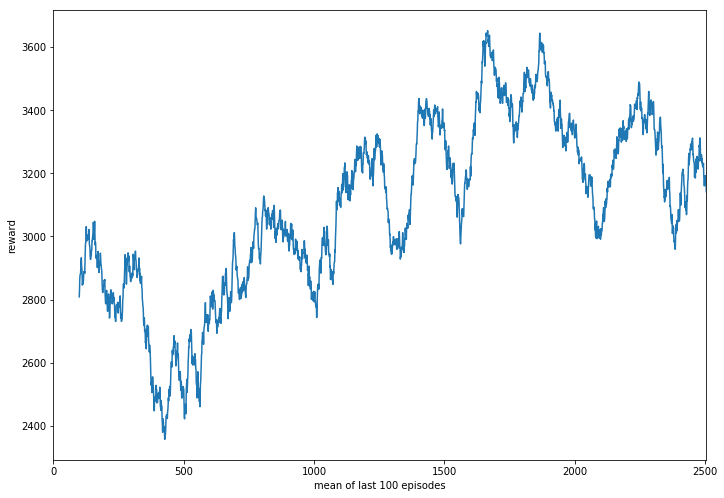

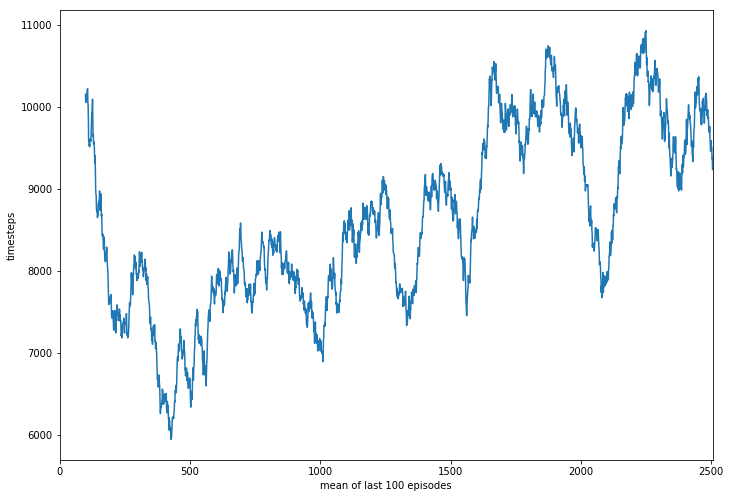

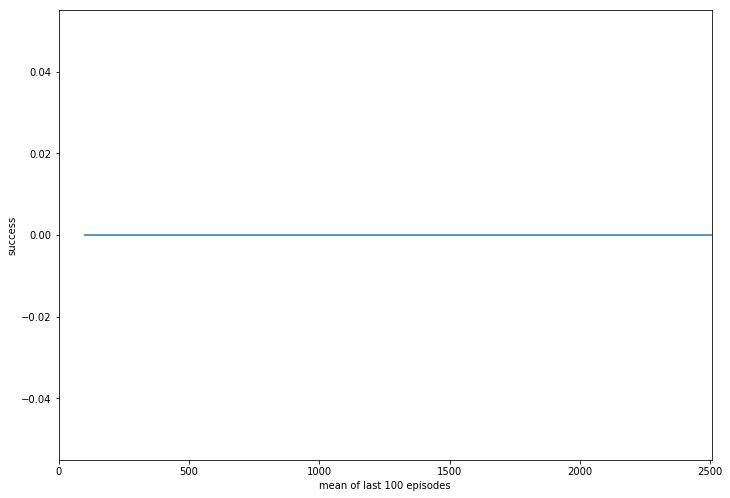

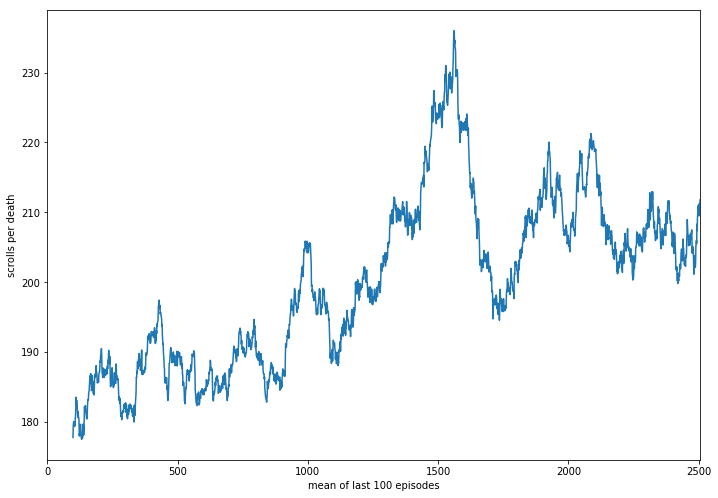

In [39]:
#/home/jim/projects/td3/logs/log_1541782259.monitor.csv
best_run_array = [
    'logs'
]

get_results(best_run_array,'1541782259')

logs
                 r             l             t       t_diff  success
count  1099.000000   1099.000000   1099.000000  1098.000000   1099.0
mean   2242.495307  22724.272066  15902.113762    30.971360      0.0
std     586.492621   6227.179577   9722.716661     8.508055      0.0
min     217.000000   6628.000000     38.327158     8.894346      0.0
25%    2229.194266  18933.000000   7434.761689    25.945804      0.0
50%    2304.904799  21581.000000  15544.659582    29.495476      0.0
75%    2454.146589  27882.000000  23899.990995    38.048031      0.0
max    3580.863491  32000.000000  34044.880583    48.631626      0.0
Mean Reward last 100 Episodes: 2908.945308315754
Max reward values:
1078    3580.863491
1082    3538.352356
912     3496.624874
1041    3490.613342
1083    3456.420901
1069    3446.079479
1081    3426.792114
1066    3423.261585
917     3420.639089
1040    3398.529141
Name: r, dtype: float64
Max l values:
639    32000
928    32000
925    32000
922    32000
475    32000
481

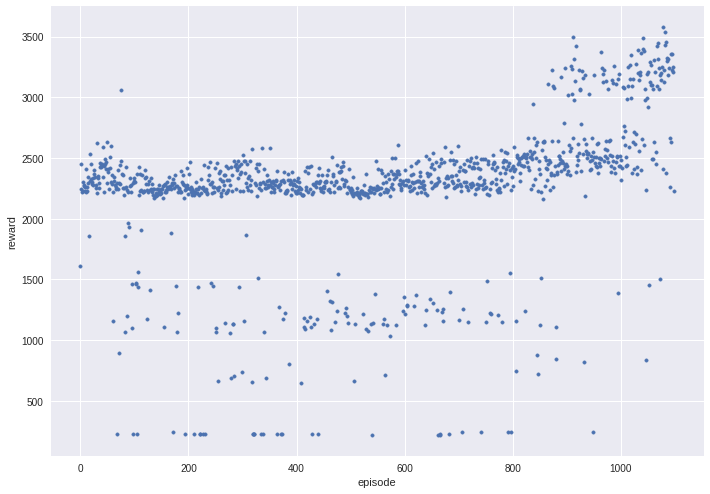

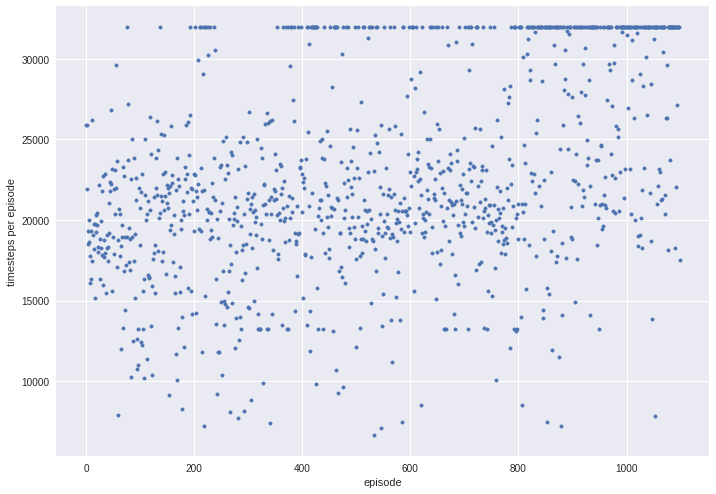

logs


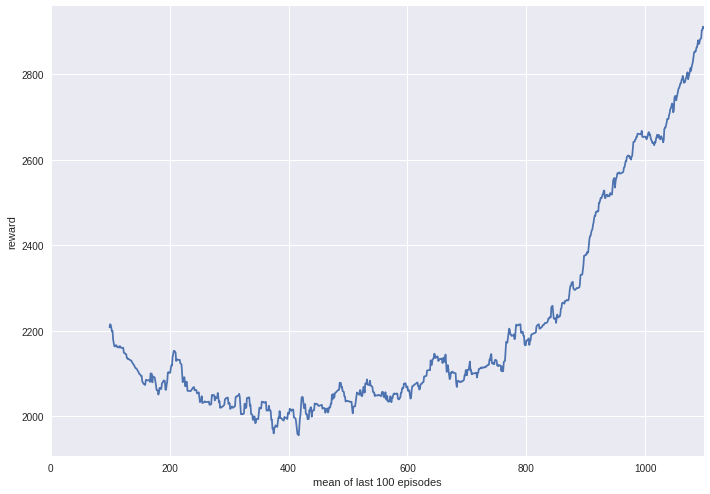

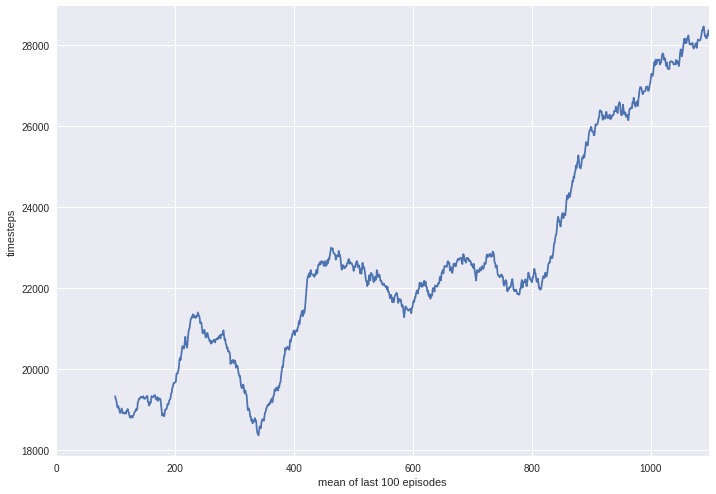

In [40]:
#/home/jim/projects/retroui/logs/monitor_1533667331.csv
#level 6 run 3 no negative rewards
#WOOT IT CLEARS IT! 13 lifes (maybe some better runs too)
best_run_array = [
    'logs'
]

get_results(best_run_array,'1533667331')

logs
                 r             l            t      t_diff  success
count   321.000000    321.000000   321.000000  320.000000    321.0
mean   1050.526405  20722.566978  4354.778698   28.017252      0.0
std     753.435041   5123.938266  2610.802144    6.970858      0.0
min   -1484.602992   8308.000000    37.827243   11.208268      0.0
25%     992.814004  17601.000000  2131.392429   23.968031      0.0
50%    1325.181619  20715.000000  4246.053626   28.060842      0.0
75%    1501.065225  23034.000000  6579.974994   31.287482      0.0
max    1714.299626  32000.000000  9003.348027   44.307319      0.0
Mean Reward last 100 Episodes: 1275.8987733284757
Max reward values:
4      1714.299626
256    1710.110356
185    1703.269130
112    1692.258166
21     1688.702585
45     1676.265388
169    1674.356572
37     1666.293723
209    1659.300267
246    1655.096697
Name: r, dtype: float64
Max l values:
300    32000
306    32000
278    32000
285    32000
259    32000
258    32000
256    32000
236 

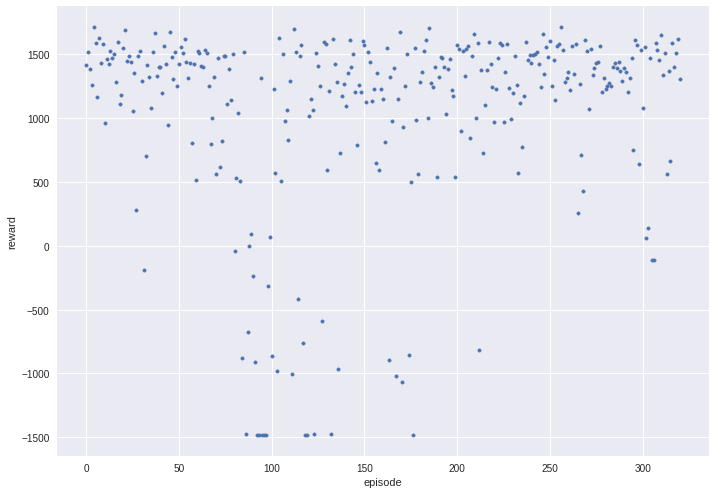

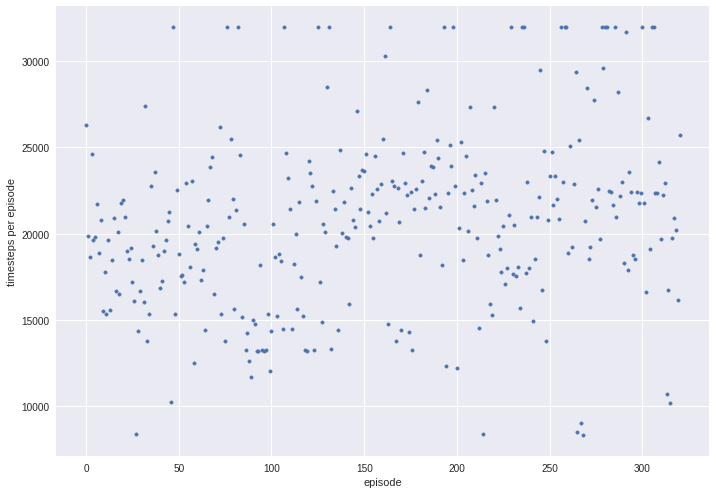

logs


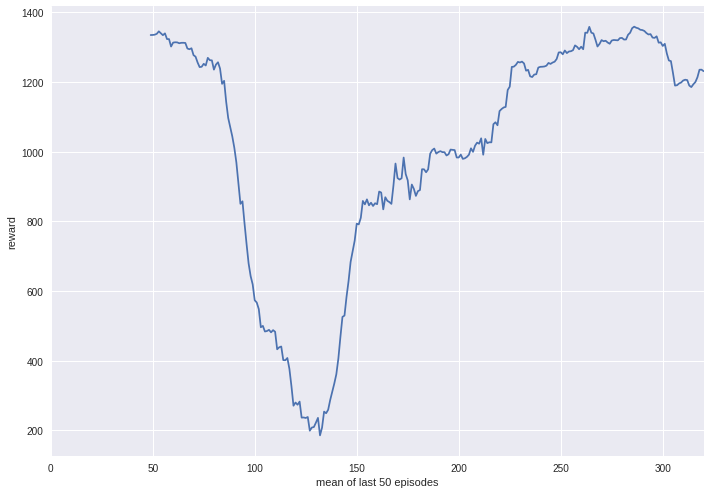

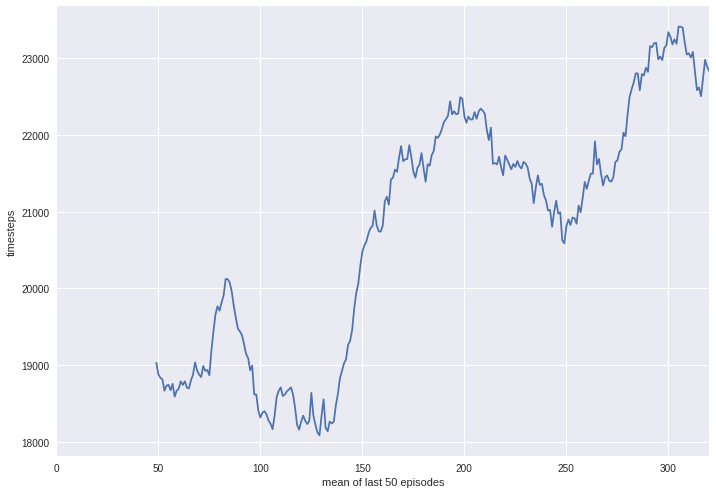

In [36]:
#/home/jim/projects/retroui/logs/monitor_1533658056.csv
#level 6 run 2
best_run_array = [
    'logs'
]

get_results(best_run_array,'1533658056')

logs
                 r             l             t       t_diff  success
count  1167.000000   1167.000000   1167.000000  1166.000000   1167.0
mean    137.665509  23696.181662  18017.033518    32.860680      0.0
std      92.920403   6090.609582  11391.088756     8.319303      0.0
min    -195.788775   7245.000000     45.436328     9.806617      0.0
25%      56.548536  19719.500000   7836.327427    27.514830      0.0
50%     163.255641  21874.000000  17149.140079    30.710150      0.0
75%     201.209406  32000.000000  27684.166129    42.285047      0.0
max     448.679339  32000.000000  38360.989390    46.071030      0.0
Mean Reward last 100 Episodes: 188.72877837698906
Max reward values:
900     448.679339
661     387.551449
904     382.724754
1031    372.590946
654     368.744691
655     366.754822
732     358.548552
918     345.785188
752     343.359870
847     325.966030
Name: r, dtype: float64
Max l values:
583    32000
962    32000
639    32000
945    32000
946    32000
947    32000

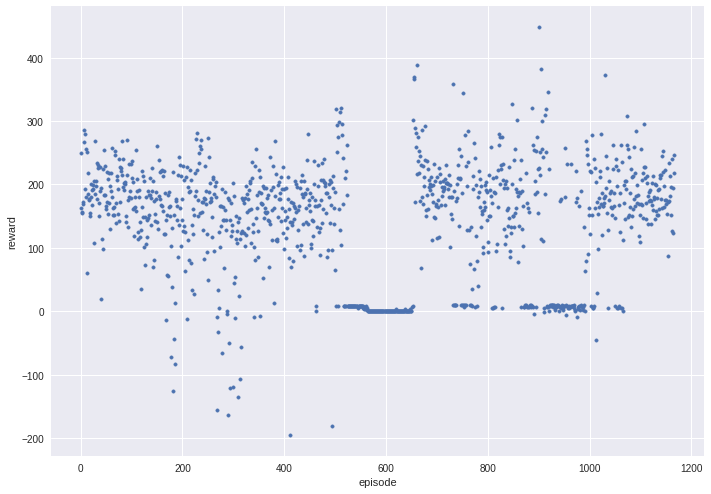

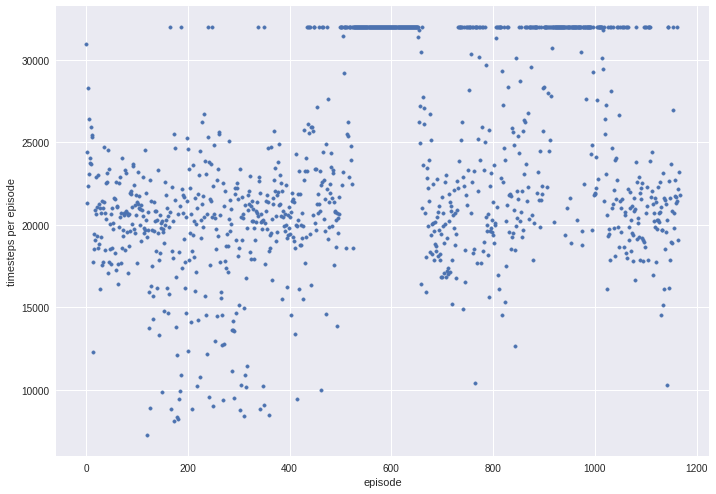

logs


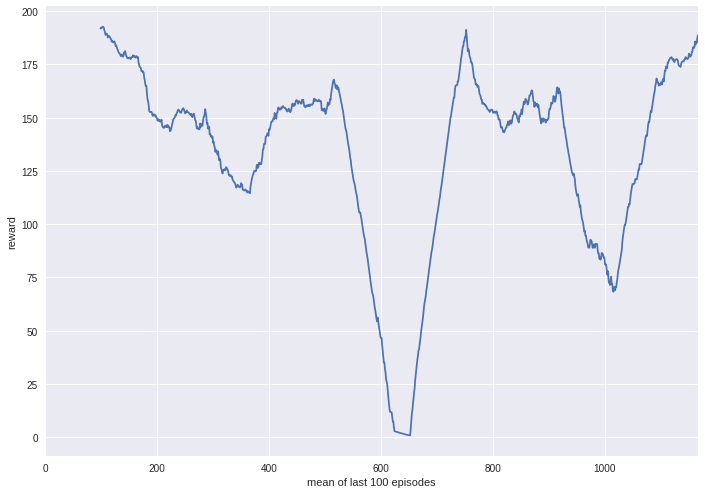

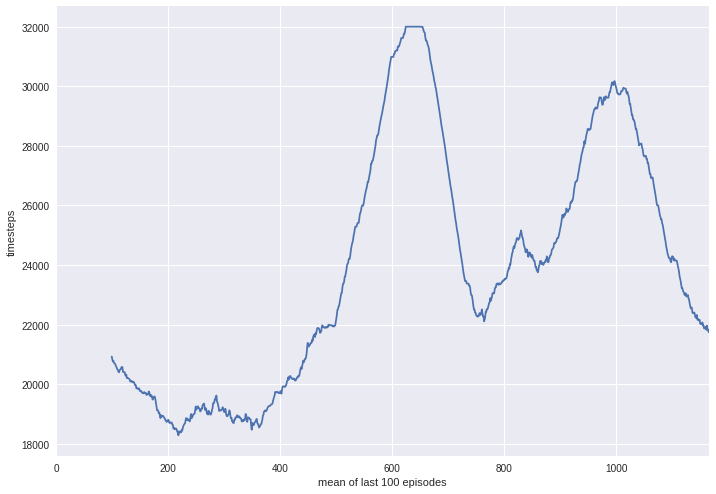

In [32]:
#level 6 run 1
#/home/jim/projects/retroui/logs/monitor_1533618754.csv
best_run_array = [
    'logs'
]

get_results(best_run_array,'1533618754')

logs
                 r             l             t       t_diff  success
count  1213.000000   1213.000000   1213.000000  1212.000000   1213.0
mean   7351.263828  25349.137675  21275.256785    36.983324      0.0
std     902.001614   4365.728654  13287.433382     6.819235      0.0
min    -308.503856  11582.000000     45.230008    15.157443      0.0
25%    7334.984316  22545.000000   9165.933463    32.567646      0.0
50%    7502.061632  25534.000000  21008.281813    37.261321      0.0
75%    7637.811346  28694.000000  32658.823674    42.071856      0.0
max    8278.636913  32000.000000  44869.019055    57.821775      0.0
Mean Reward last 100 Episodes: 6502.405276650488
Max reward values:
561     8278.636913
617     8254.709238
505     8254.013071
623     8194.001342
535     8175.139081
1053    8153.744145
795     8132.186649
616     8097.632635
128     8095.377699
1049    8090.635676
Name: r, dtype: float64
Max l values:
1212    32000
887     32000
959     32000
947     32000
934     3200

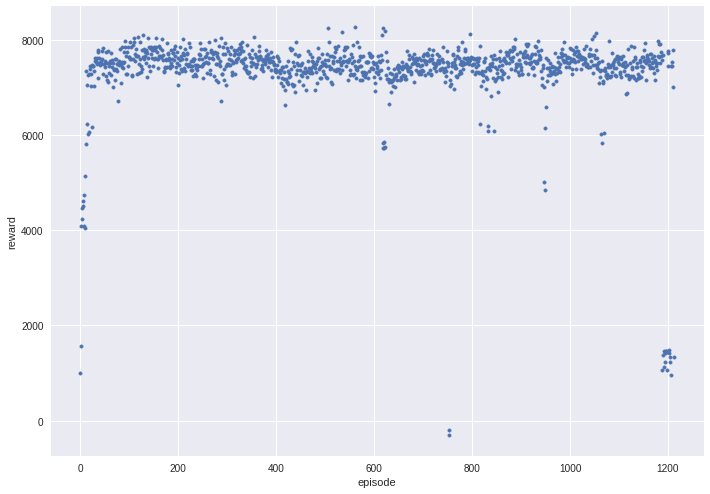

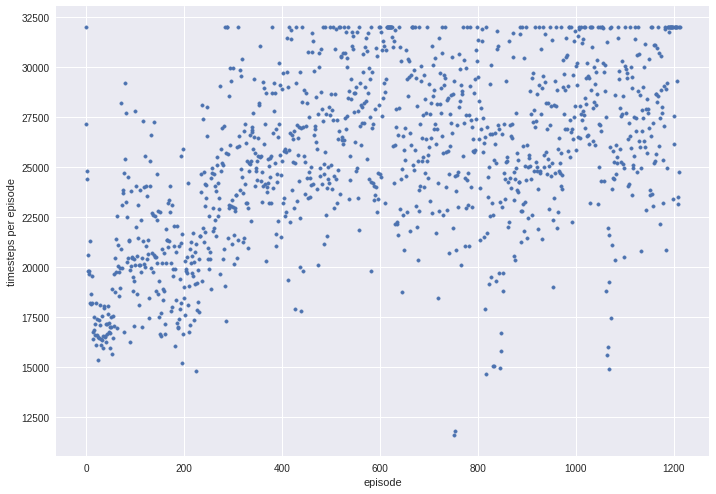

logs


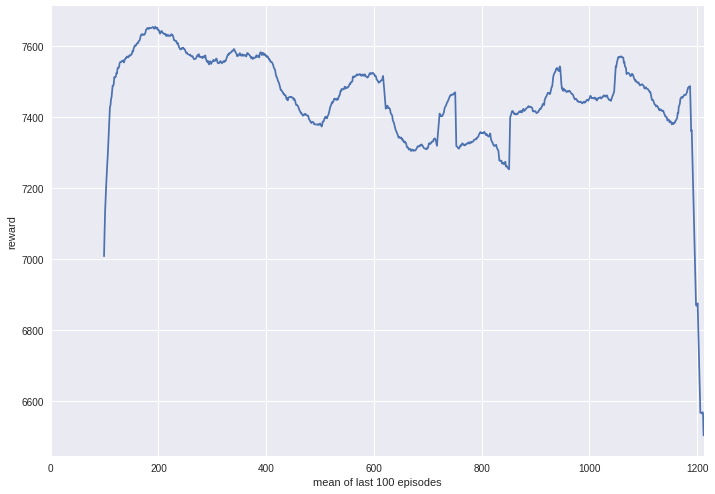

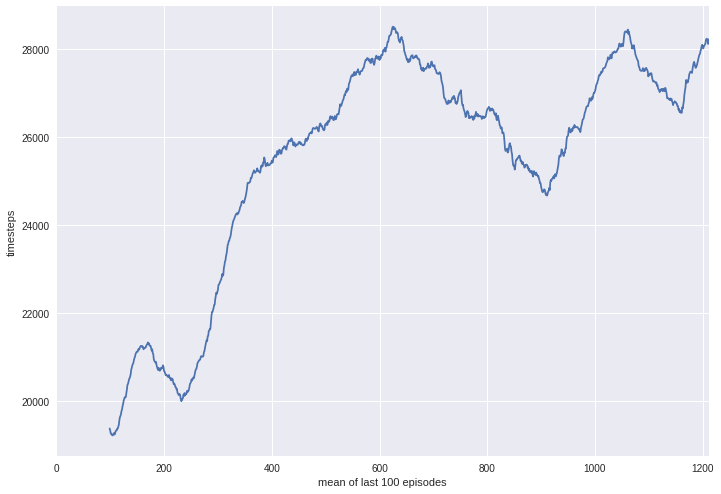

In [26]:
#/home/jim/projects/retroui/logs/monitor_1533570316.csv
#existence penalty
#level 1 run 8
best_run_array = [
    'logs'
]

get_results(best_run_array,'1533570316')

logs
                 r             l             t       t_diff      success
count  1039.000000   1039.000000   1039.000000  1038.000000  1039.000000
mean   7968.824454  25054.034649  17440.910121    34.879146     0.063523
std     711.622944   5263.238790  10572.968065     6.341831     0.244018
min     626.730188  13131.000000     47.454966    17.106865     0.000000
25%    7716.374747  20845.500000   8051.222090    29.963362     0.000000
50%    7904.101779  23731.000000  17353.112186    34.346520     0.000000
75%    8204.473253  32000.000000  26495.341373    41.737048     0.000000
max    9726.574297  32000.000000  36252.008604    47.540292     1.000000
Mean Reward last 100 Episodes: 8275.657085049152
Max reward values:
279     9726.574297
903     9455.404656
404     9423.790664
901     9412.762379
985     9411.618368
764     9406.045919
307     9403.613188
1006    9383.722699
271     9353.433145
300     9348.314287
Name: r, dtype: float64
Max l values:
0      32000
273    32000
343   

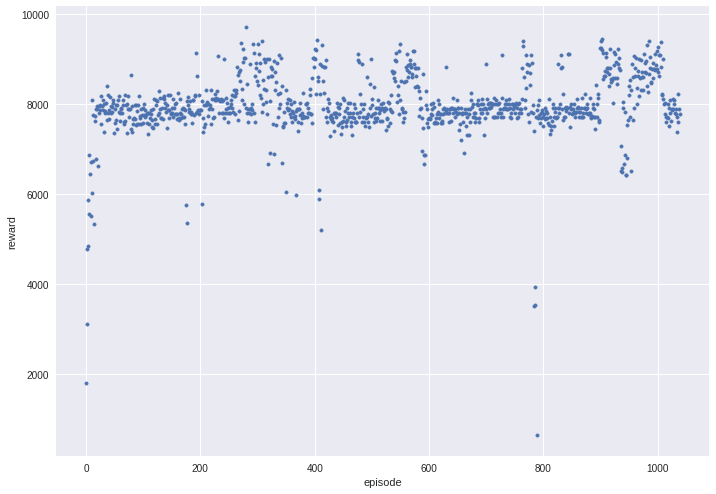

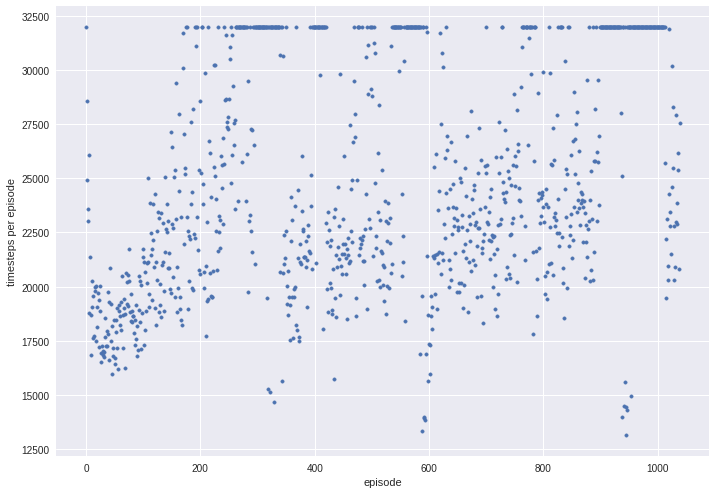

logs


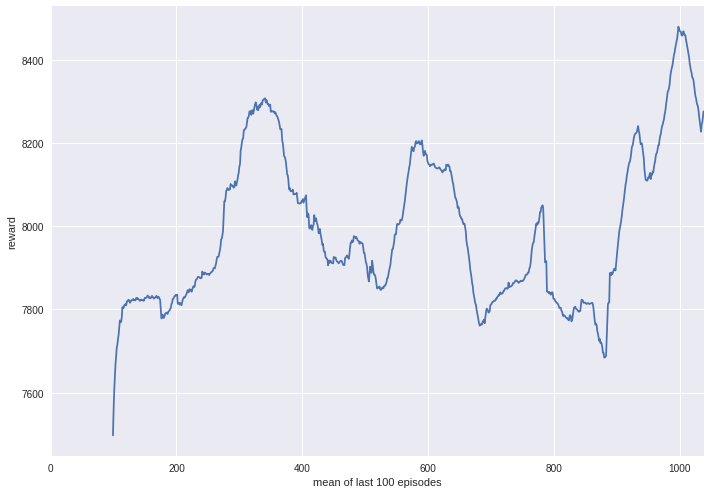

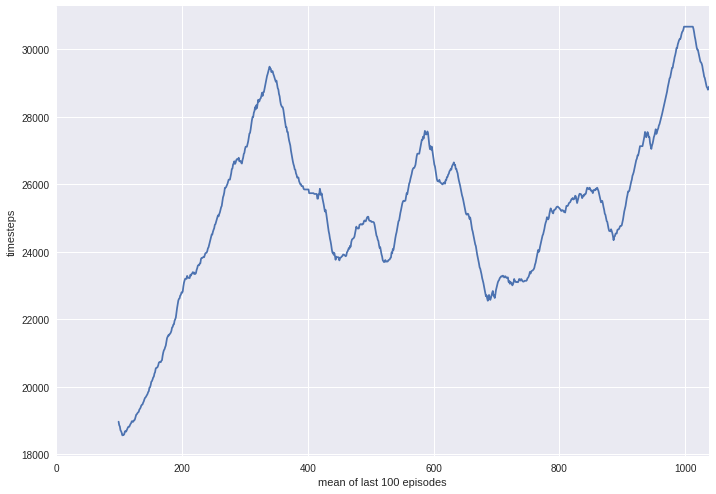

In [18]:
#/home/jim/projects/retroui/logs/log_1533533118.csv
#stops improving as becomes afraid to fight boss
best_run_array = [
    'logs'
]

get_results(best_run_array,'1533533118')

logs
                  r             l            t      t_diff     success
count    268.000000    268.000000   268.000000  267.000000  268.000000
mean   11379.995725  20051.115672  3715.072186   28.446930    0.992537
std      406.294824   2717.589706  2178.004809    4.129028    0.086225
min     6376.017436  15665.000000    44.469409   21.970755    0.000000
25%    11415.267228  17939.500000  1774.146467   25.105759    1.000000
50%    11431.414658  19491.000000  3736.953054   27.768615    1.000000
75%    11452.511179  21732.000000  5499.011922   31.131930    1.000000
max    11550.900561  32000.000000  7639.799663   45.013857    1.000000
Mean Reward last 100 Episodes: 11433.484810686112
Max values:
42     11550.900561
116    11532.243502
121    11527.252538
132    11526.134892
54     11525.862082
115    11522.885106
70     11522.082542
58     11521.082290
31     11516.284481
53     11515.598518
Name: r, dtype: float64
logs


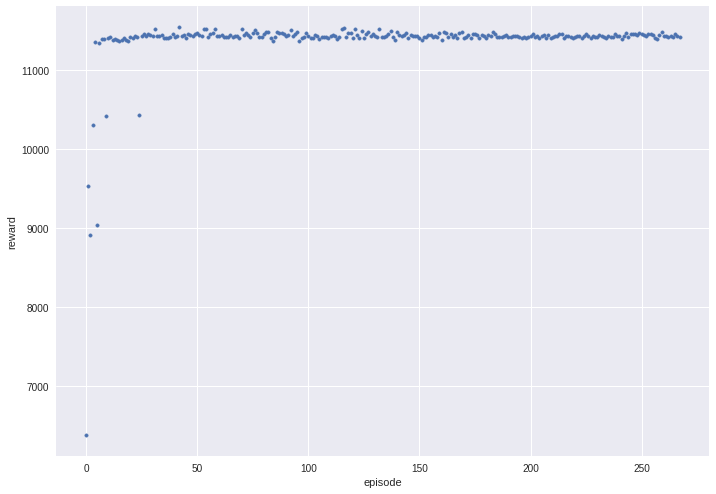

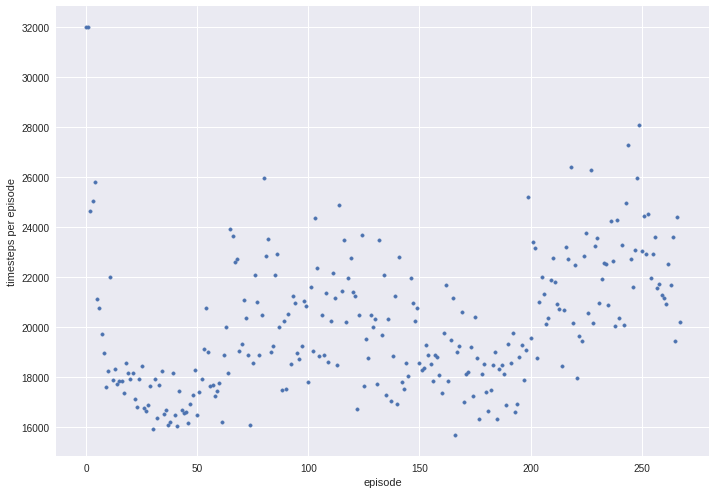

logs


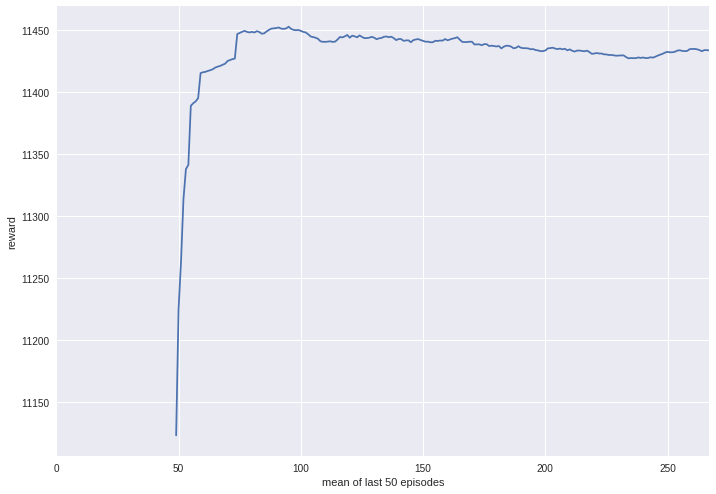

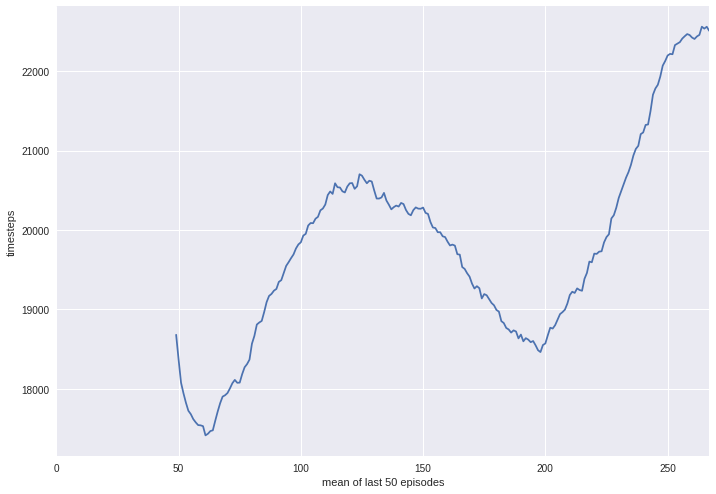

In [10]:
#successful runs but no death penalty
#/home/jim/projects/retroui/logs/log_1533524487.csv
best_run_array = [
    'logs'
]

get_results(best_run_array,'1533524487')

logs
                 r            l            t       t_diff  success
count  3184.000000  3184.000000  3184.000000  3183.000000   3184.0
mean   3160.463713   860.516018  1711.317101     1.193605      0.0
std    1733.281785   424.326901  1022.874368     0.601282      0.0
min      25.770826   289.000000     1.784388     0.395394      0.0
25%    1943.905113   564.000000   860.213474     0.754730      0.0
50%    2146.064675   678.500000  1615.144844     0.964754      0.0
75%    3996.373128  1063.250000  2506.410617     1.508936      0.0
max    8793.915985  6101.000000  3801.029927     8.365963      0.0
Mean Reward last 100 Episodes: 5438.2364016063975
Max values:
2629    8793.915985
3179    7548.756406
3160    7503.286463
3178    7465.539147
3165    7414.707415
3173    7329.443907
3159    7298.947153
2826    7241.086047
3170    7220.927769
3137    7217.318650
Name: r, dtype: float64
logs


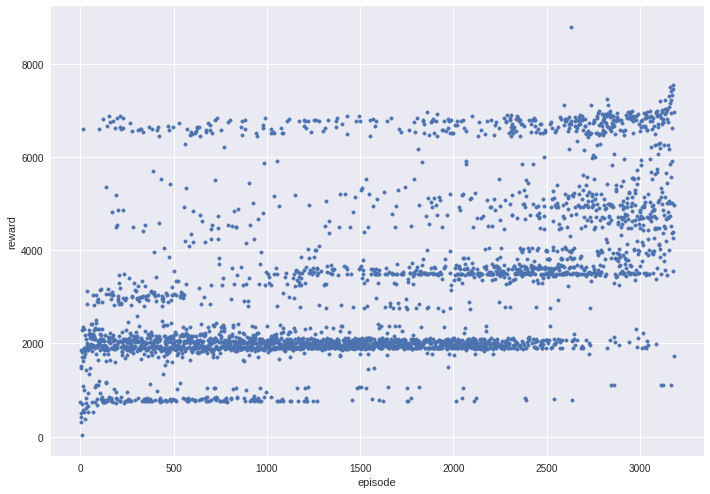

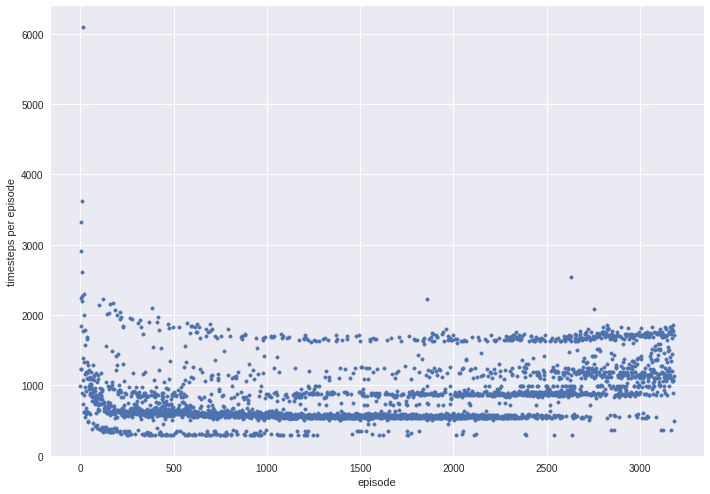

logs


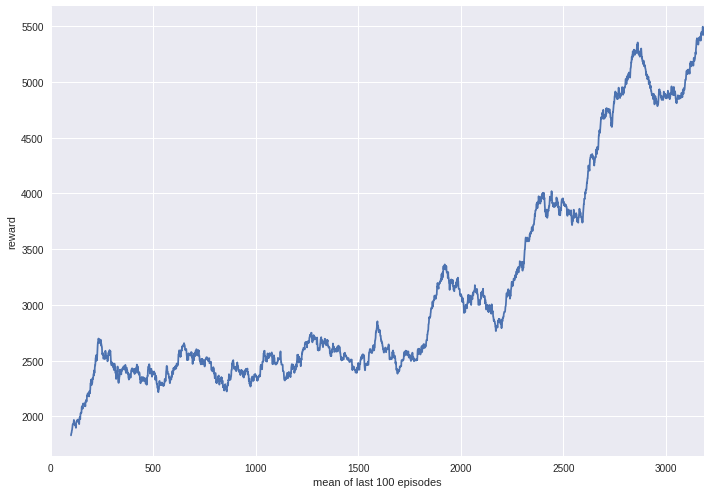

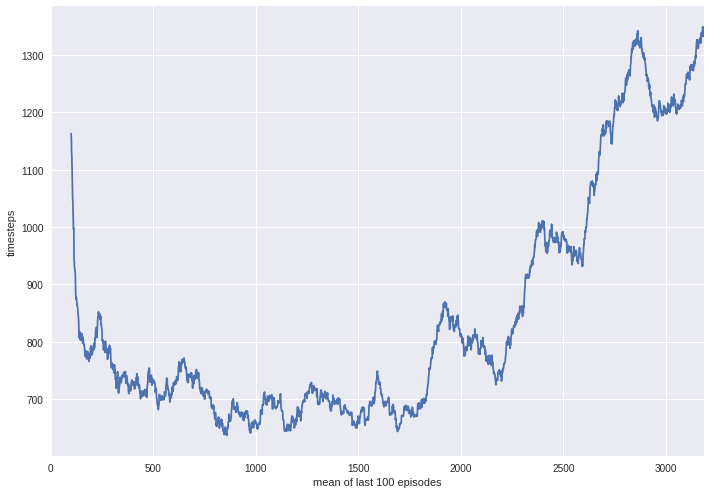

In [9]:
#1533355992
best_run_array = [
    'logs'
]

get_results(best_run_array,'1533362292')

logs
                  r             l            t       t_diff      success
count   4278.000000   4278.000000  4278.000000  4277.000000  4278.000000
mean    5381.770788   1411.419589  2182.867913     1.886003     0.041374
std    14314.121319   3333.282887  1393.501774     4.298796     0.199178
min    -7993.438840    294.000000     5.460882     0.410366     0.000000
25%     2102.606689    592.000000  1092.671137     0.794430     0.000000
50%     2319.268032    644.000000  2049.940094     0.872382     0.000000
75%     3193.681792    855.750000  3121.402401     1.181970     0.000000
max    82662.146890  18000.000000  8071.895469    24.123820     1.000000
Mean Reward last 100 Episodes: 66209.17306904605
Max values:
4114    82662.146890
4118    82652.631347
4147    82632.662979
4127    82623.019414
4148    82615.040249
4146    82613.710489
4134    82613.045519
4156    82595.432737
4154    82595.165767
4130    82593.979979
Name: r, dtype: float64
logs


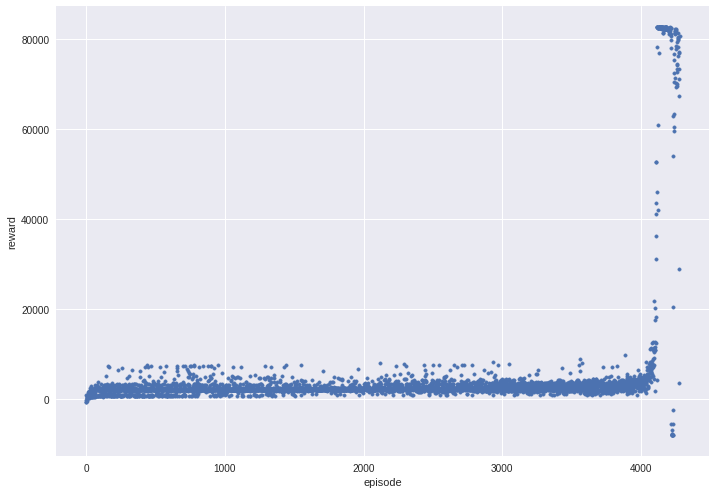

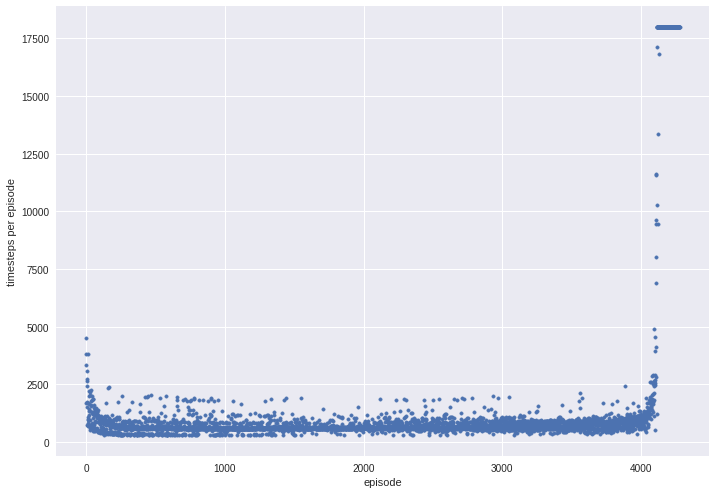

logs


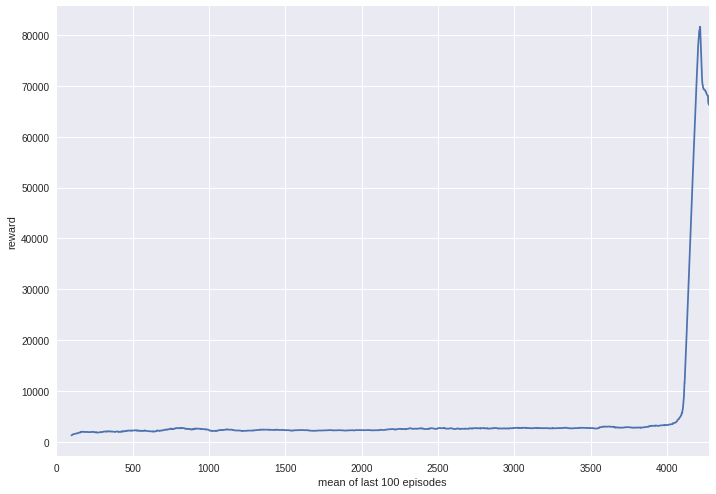

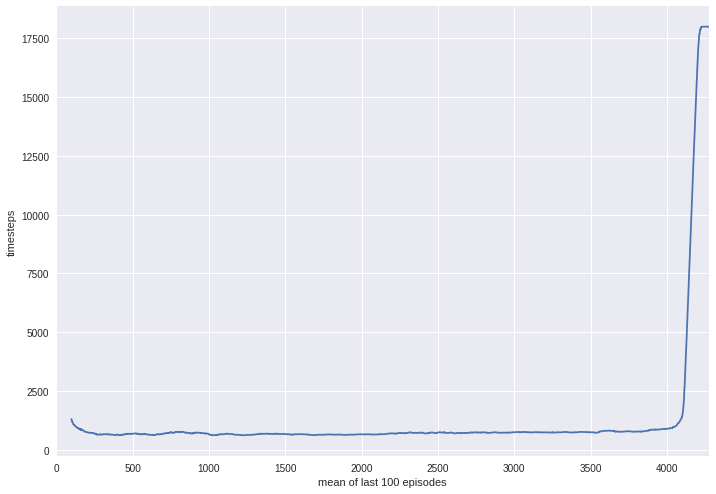

In [7]:
best_run_array = [
    'logs'
]

get_results(best_run_array,'1533347359')

logs
                  r             l            t       t_diff      success
count   1458.000000   1458.000000  1458.000000  1457.000000  1458.000000
mean    3376.459911    969.030864   875.292292     1.338880     0.019204
std     5944.078521   1327.050535   448.652804     1.770919     0.137290
min    -2407.793800    306.000000     5.689956     0.437891     0.000000
25%     2191.393064    638.000000   506.330837     0.867228     0.000000
50%     2500.222998    722.000000   879.747546     0.997817     0.000000
75%     3259.723203    938.000000  1241.364286     1.319259     0.000000
max    82643.602168  18000.000000  1956.438011    26.328800     1.000000
Mean Reward last 100 Episodes: 13413.05767769074
Max values:
1449    82643.602168
1455    82621.855195
1454    82361.153505
1457    82012.937276
1451    81705.095344
1441    62547.045308
1447    61593.863627
1452    55190.720480
1453    44111.573736
1438    39278.956248
Name: r, dtype: float64
logs


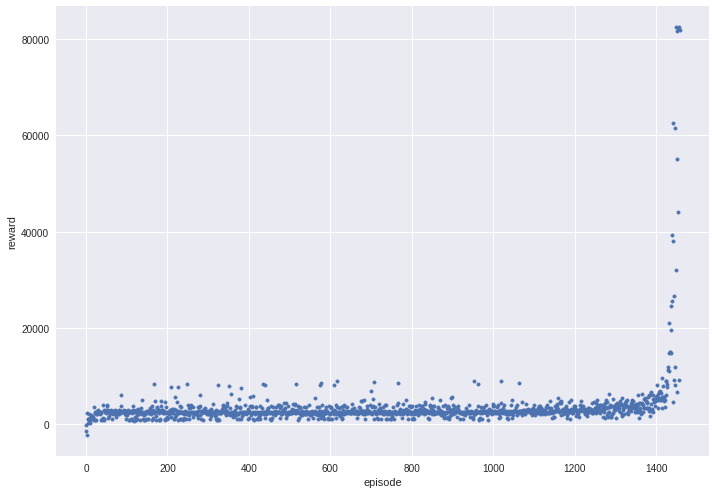

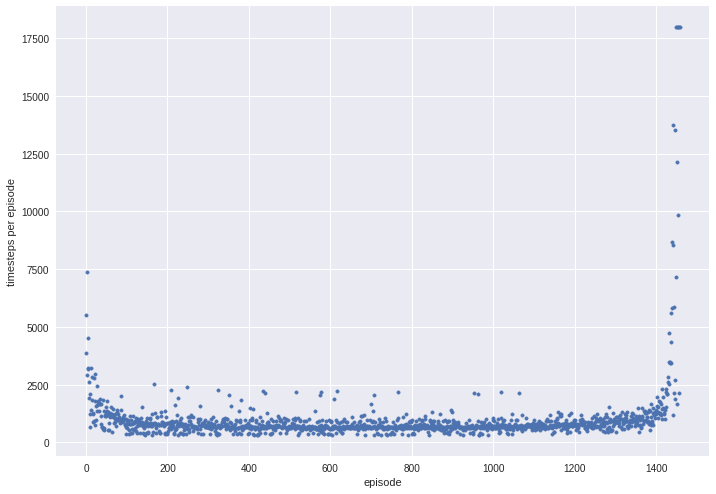

logs


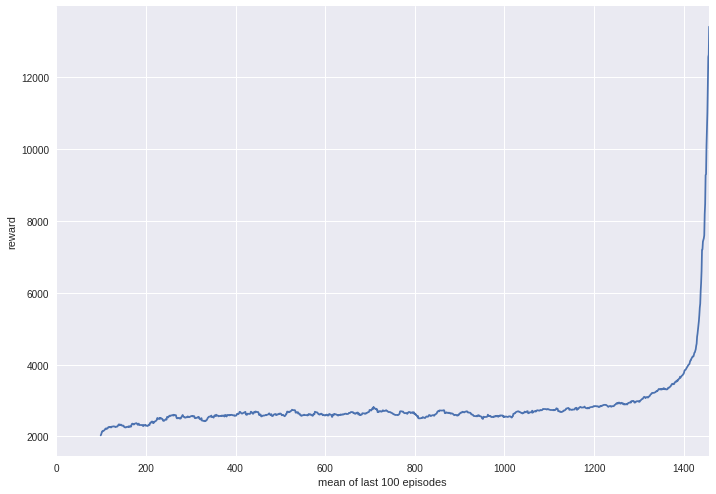

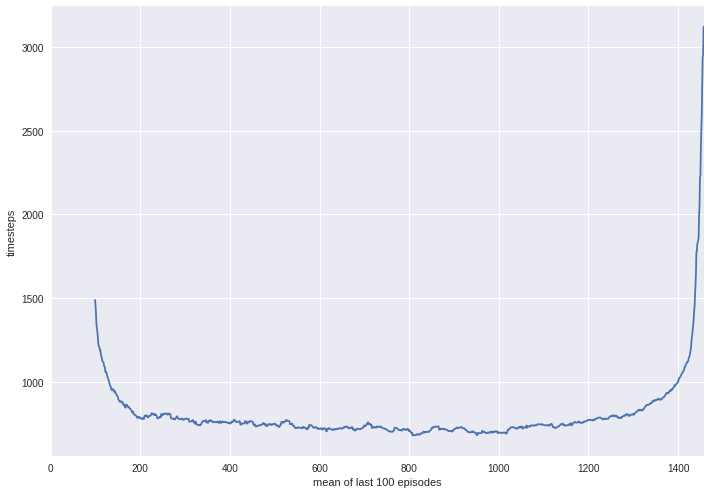

In [3]:
best_run_array = [
    'logs'
]

get_results(best_run_array,'1533345012')

